# Network embedding 

---

## 0. Environmental setup

We load all required libraries.

In [1]:
import pandas as pd
import networkx as nx
import numpy as np
import seaborn as sns
import sys
import os
import random
import torch
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import community as community_louvain
from torch_geometric.data import Data
from torch import LongTensor, FloatTensor
from node2vec import Node2Vec
from torch_geometric.nn import GAE
from torch_geometric.utils import train_test_split_edges, from_networkx
import torch_geometric.transforms as T
from torch_geometric.nn import InnerProductDecoder
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler, normalize
import scanpy as sc
from sklearn.cluster import AgglomerativeClustering, KMeans
from sklearn.metrics import adjusted_mutual_info_score
from scipy.stats import spearmanr, pearsonr
from sklearn.cluster import KMeans
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import KElbowVisualizer
from collections import Counter, OrderedDict
from sklearn.decomposition import PCA

from scipy.spatial.distance import pdist, squareform
import scipy.spatial as sp, scipy.cluster.hierarchy as hc

from IPython.display import Image

sys.path.append("../../../")

from src.utils.torch.network import *
from src.utils.notebooks.ppi.embedding import *
from src.models.clf import LatentClassifier
from src.models.regressor import FeatureDecoder
from src.utils.basic.io import get_genesets_from_gmt_file
from src.models.ae import GCNEncoder
import matplotlib as mpl

seed = 1234

plt.style.use("default")
mpl.rcParams["figure.dpi"] = 600


%load_ext nb_black

<IPython.core.display.Javascript object>

---

## 1. Read in data

We next load the previously inferred gene-gene interactome.

In [2]:
spearman_interactome = nx.read_gpickle(
    "../../../data/ppi/inference_results/cv/spearman_sol_cv.pkl"
)
print(spearman_interactome)

Graph named 'spearman_sol' with 249 nodes and 526 edges


<IPython.core.display.Javascript object>

The network consists of 249 nodes and 526 edges.

Next, we load the single-cell gene expression data which we will use as node features in order to encode functional relationships in the control setting which we expect to partially conserved even in the overexpression settings.

In [3]:
gex_adata = sc.read("../../../data/gex/scrnaseq/fucci_adata.h5")
gex_adata.var_names_make_unique()
gex_data = pd.DataFrame(
    gex_adata.X, columns=gex_adata.var_names, index=gex_adata.obs_names
)
gex_data.columns = [c.upper() for c in gex_data.columns]
gex_data = gex_data.loc[
    :, set(spearman_interactome.nodes()).intersection(gex_data.columns)
]

<IPython.core.display.Javascript object>

We also load two types of cluster information: a) clusters obtained by hierarchically clustering the L1000 gene signatures in the corresponding OE conditions using cosine distances and complete linkage and b) clusters obtained when clustering the physical space. For the latter those clusters depend on the individual physical space that was inferred which differs according to which target was left out during training. Thus, we load a number of cluster solutions for the physical space that correspond to those.

In [4]:
cmap_clusters = pd.read_csv(
    "../../../data/other/mean_cmap_sig_clusters.csv", index_col=0
)

<IPython.core.display.Javascript object>

In [5]:
phy_oe_emb_dir = (
    "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings"
)
oe_targets = os.listdir(phy_oe_emb_dir)
oe_targets = sorted(oe_targets)
physical_cluster_dict = {}
for target in oe_targets:
    physical_cluster_dict[target] = pd.read_csv(
        os.path.join(phy_oe_emb_dir, target, "train_phy_mean_clusters.csv"), index_col=0
    )

<IPython.core.display.Javascript object>

In [6]:
physical_full_cluster_dict = {}
for target in oe_targets:
    physical_full_cluster_dict[target] = pd.read_csv(
        os.path.join(phy_oe_emb_dir, target, "phy_mean_full_clusters.csv"), index_col=0
    )

<IPython.core.display.Javascript object>

Finally, we read in a number of descriptive gene sets. Out of those especially the Hallmark gene set has been previously successfully used as a node feature to encode protein-protein interactomes and thus will be also used in our study.

In [7]:
hallmark_geneset_dict = get_genesets_from_gmt_file(
    "../../../data/other/genesets/h.all.v7.4.symbols.gmt"
)

l1000_genes = set(
    list(
        pd.read_csv(
            "../../../data/other/genesets/l1000.txt", index_col=0, header=None
        ).index
    )
)


<IPython.core.display.Javascript object>

---
---

## 2. Preprocessing

We will now set the respective node and edge attributes computed based on the previously loaded information. Note, that the single-cell gene expression data is min-max-scaled.

### 2.1. Attribute setting

In [8]:
gex_data_z = pd.DataFrame(
    MinMaxScaler().fit_transform(gex_data.transpose()),
    index=gex_data.transpose().index,
    columns=gex_data.transpose().columns,
).transpose()

<IPython.core.display.Javascript object>

As mentioned above the cluster setting differs for each inferred physical space, we thus construct a number of interactomes, where we set the a corresponding node attribute to the clustering structure for each target that was held-out.

In [9]:
def plot_pca_embs(
    latents,
    ax,
    target,
    target_size=12,
    reg_size=8,
    target_label_size=12,
    reg_label_size=10,
    label_points=None,
    random_state=1234,
):
    embs = PCA(n_components=2, random_state=random_state).fit_transform(latents)
    embs = pd.DataFrame(embs, columns=["pc_0", "pc_1"], index=latents.index)
    ax.scatter(
        np.array(embs.loc[:, "pc_0"]), np.array(embs.loc[:, "pc_1"]), c="b", s=reg_size
    )
    ax.scatter(
        np.array(embs.loc[target, "pc_0"]),
        np.array(embs.loc[target, "pc_1"]),
        c="r",
        s=target_size,
    )
    if label_points is not None:
        to_label_embs = embs.loc[embs.index.isin(label_points)]
        label_point(
            np.array(to_label_embs.loc[:, "pc_0"]),
            np.array(to_label_embs.loc[:, "pc_1"]),
            np.array(to_label_embs.index).astype("str"),
            ax=ax,
            reg_size=reg_label_size,
            highlight=target,
            highlight_size=target_label_size,
        )
    return ax

<IPython.core.display.Javascript object>

In [10]:
def label_point(
    x, y, val, ax, reg_size=10, highlight_size=10, highlight=None, highlight_other=None
):
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()
    for i in range(len(x)):
        if highlight is not None and val[i] == highlight:
            c = "r"
            weight = "bold"
            size = highlight_size
        elif highlight_other is not None and val[i] in highlight_other:
            c = "b"
            weight = "bold"
        else:
            c = "k"
            weight = "normal"
            size = reg_size
        if x[i] > xmin and x[i] < xmax and y[i] > ymin and y[i] < ymax:
            ax.text(x[i] + 0.02, y[i], val[i], {"size": size, "c": c, "weight": weight})

<IPython.core.display.Javascript object>

In [11]:
def run_reg_space_loto_exp(
    root_output_dir,
    oe_targets,
    interactome,
    physical_cluster_dict,
    physical_full_cluster_dict,
    cmap_clusters,
    cluster_opt,
    graph_opt,
    alpha=1,
    beta=0,
    gamma=1,
    n_classes=10,
    seed=1234,
    node_feature_key="sc_gex_hallmark",
    input_dim=1176,
    latent_dim=1024,
    early_stopping=100,
    neg_edge_ratio=1,
    lr=0.00001,
    n_epochs=10000,
):
    graph_dict = get_graph_dict(
        oe_targets,
        interactome,
        physical_cluster_dict,
        physical_full_cluster_dict,
        cmap_clusters,
        cluster_opt,
    )
    print(graph_dict.keys())
    for oe_target in oe_targets:

        output_dir = os.path.join(root_output_dir, oe_target, interactome.name)
        output_dir = os.path.join(
            output_dir,
            "gae_exp_a{}_b{}_g{}_{}_{}".format(
                alpha, beta, gamma, graph_opt, cluster_opt
            ),
        )
        os.makedirs(output_dir, exist_ok=True)

        if cluster_opt == "physical":
            clusters = physical_cluster_dict[oe_target].copy()
            clusters.loc[oe_target] = -1
        elif cluster_opt == "cmap":
            clusters = cmap_clusters.copy()
            clusters.loc[oe_target] = -1
        elif cluster_opt == "cmap_full":
            clusters = cmap_clusters.copy()
        else:
            clusters = physical_full_cluster_dict[oe_target].copy()

        clusters = get_colored_clusters(clusters)

        graph = graph_dict[oe_target]
        latents_dict, loss_hist_dict, graph_data = run_loto_inference(
            graph=graph,
            oe_target=oe_target,
            output_dir=output_dir,
            cluster_opt=cluster_opt,
            alpha=alpha,
            beta=beta,
            gamma=gamma,
            n_classes=n_classes,
            node_feature_key=node_feature_key,
            input_dim=input_dim,
            latent_dim=latent_dim,
            graph_opt=graph_opt,
            seed=seed,
            lr=lr,
            early_stopping=early_stopping,
            neg_edge_ratio=neg_edge_ratio,
            n_epochs=n_epochs,
            device="cpu",
        )

        latents = latents_dict[seed]
        node_names = getattr(graph_data, "name")
        st_memberships = getattr(graph_data, "spec_target")
        latents = pd.DataFrame(latents, index=node_names)

        save_and_visualize_latents(
            latents=latents,
            output_dir=output_dir,
            clusters=clusters,
            oe_targets=oe_targets,
            st_memberships=st_memberships,
            random_state=seed,
        )
        latents.to_csv(
            os.path.join(
                output_dir,
                "node_embs.csv",
            )
        )

<IPython.core.display.Javascript object>

In [12]:
def get_graph_dict(
    oe_targets,
    interactome,
    physical_cluster_dict,
    physical_full_cluster_dict,
    cmap_clusters,
    cluster_opt="physical",
):
    graph_dict = {}
    for target in oe_targets:
        graph = interactome.copy()
        physical_clusters = physical_cluster_dict[target]
        physical_full_clusters = physical_full_cluster_dict[target]
        for node in graph.nodes(data=True):
            node[-1]["sc_gex"] = np.array(gex_data_z.loc[:, node[0]])
            node[-1]["sc_gex"] = node[-1]["sc_gex"]
            if cluster_opt == "cmap_full":
                if node[0] in cmap_clusters.index:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "cmap":
                if node[0] in cmap_clusters.index and node[0] != target:
                    node[-1]["label"] = cmap_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "physical":
                if node[0] in physical_clusters.index and node[0] != target:
                    node[-1]["label"] = physical_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            if cluster_opt == "physical_full":
                if node[0] in physical_full_clusters.index:
                    node[-1]["label"] = physical_full_clusters.loc[node[0], "cluster"]
                    node[-1]["label_mask"] = True
                else:
                    node[-1]["label"] = -1
                    node[-1]["label_mask"] = False

            node[-1]["name"] = node[0]
            node[-1]["spec_target"] = node[0] in oe_targets

            gene_memberships = []
            for geneset in hallmark_geneset_dict.values():
                if node[0] in geneset:
                    gene_memberships.append(1.0)
                else:
                    gene_memberships.append(0.0)

            node[-1]["hallmark"] = np.array(gene_memberships)
            node[-1]["sc_gex_hallmark"] = np.concatenate(
                [node[-1]["sc_gex"], node[-1]["hallmark"]]
            )
        graph_dict[target] = graph
    return graph_dict

<IPython.core.display.Javascript object>

In [13]:
def get_colored_clusters(clusters):
    colored_clusters = clusters.copy()
    lut = dict(
        zip(
            list(np.unique(colored_clusters)),
            [
                "tab:blue",
                "tab:red",
                "tab:green",
                "gold",
                "tab:orange",
                "tab:cyan",
                "tab:purple",
                "tab:pink",
                "tab:olive",
                "olivedrab",
                "tab:brown",
            ],
        )
    )
    colored_clusters.loc[:, "color"] = colored_clusters.loc[:, "cluster"].map(lut)
    return colored_clusters

<IPython.core.display.Javascript object>

In [14]:
def run_loto_inference(
    graph,
    oe_target,
    output_dir,
    cluster_opt,
    alpha,
    beta,
    gamma,
    n_classes=10,
    node_feature_key="sc_gex_hallmark",
    input_dim=1176,
    latent_dim=1024,
    graph_opt="split_graph",
    seed=1234,
    lr=0.00001,
    early_stopping=200,
    neg_edge_ratio=1,
    n_epochs=10000,
    device="cpu",
):
    print(oe_target)

    device = torch.device(device)
    graph_data = from_networkx(graph)
    graph_data.id = torch.FloatTensor(np.identity(len(graph)))
    graph_data = T.ToDevice(
        device,
        attrs=[
            "id",
            "sc_gex",
            "label",
            "label_mask",
            "hallmark",
            "sc_gex_hallmark",
        ],
    )(graph_data)

    class_weights = None

    gae = GAE(
        GCNEncoder(
            in_channels=input_dim, out_channels=latent_dim, hidden_dim=latent_dim
        )
    )
    feature_decoder = FeatureDecoder(
        latent_dim=latent_dim,
        hidden_dims=[latent_dim],
        output_dim=input_dim,
        loss_fct=torch.nn.L1Loss(),
    )
    latent_classifier = LatentClassifier(
        latent_dim=latent_dim,
        hidden_dims=None,
        n_classes=n_classes,
        loss_fct=None,
        class_weights=class_weights,
    )

    seeds = [seed]
    use_graph = graph_opt
    edge_weight_key = None
    latents_dict, loss_hist_dict = get_gae_latents_for_seed(
        graph_data=graph_data,
        gae=gae,
        seeds=seeds,
        node_feature_key=node_feature_key,
        edge_weight_key=edge_weight_key,
        feature_decoder=feature_decoder,
        latent_classifier=latent_classifier,
        n_epochs=n_epochs,
        lr=lr,
        split_type="link",
        alpha=alpha,
        beta=beta,
        gamma=gamma,
        plot_loss=True,
        early_stopping=early_stopping,
        use_full_graph=use_graph == "full_graph",
        neg_edge_ratio=neg_edge_ratio,
    )
    torch.save(gae, os.path.join(output_dir, "gae.pt"))
    torch.save(feature_decoder, os.path.join(output_dir, "feature_decoder.pt"))
    torch.save(latent_classifier, os.path.join(output_dir, "latent_classifier.pt"))
    return latents_dict, loss_hist_dict, graph_data

<IPython.core.display.Javascript object>

In [15]:
def save_and_visualize_latents(
    latents, output_dir, clusters, oe_targets, st_memberships, random_state=1234
):
    embs = TSNE(
        random_state=1234,
        perplexity=int(np.sqrt(len(latents))) + 1,
        init="pca",
        learning_rate="auto",
    ).fit_transform(latents)
    embs = pd.DataFrame(embs, columns=["tsne_0", "tsne_1"], index=latents.index)
    embs["spec_target"] = st_memberships.cpu().numpy()

    fig, ax = plt.subplots(figsize=[20, 10])
    ax = sns.scatterplot(
        data=embs, x="tsne_0", y="tsne_1", cmap="viridis", hue="spec_target"
    )
    label_point(
        np.array(embs.loc[:, "tsne_0"]),
        np.array(embs.loc[:, "tsne_1"]),
        np.array(embs.index).astype("str"),
        ax=ax,
    )
    ax.set_title("Visualization of the inferred embedding space")
    plt.savefig(
        os.path.join(
            output_dir,
            "tsne_embs.png",
        ),
        bbox_inches="tight",
    )
    plt.close()

    ax = sns.clustermap(
        latents.loc[set(oe_targets).intersection(latents.index)],
        figsize=[6, 12],
        metric="cosine",
        method="complete",
        cmap="seismic",
        row_colors=np.array(
            clusters.loc[set(oe_targets).intersection(latents.index), "color"]
        ).ravel(),
    )
    ax.ax_heatmap.set_yticklabels(
        ax.ax_heatmap.get_ymajorticklabels(),
        fontsize=15,
        fontweight="bold",
    )
    plt.savefig(
        os.path.join(
            output_dir,
            "reg_clustering.png",
        ),
        bbox_inches="tight",
    )
    plt.close()

<IPython.core.display.Javascript object>

In [16]:
def read_in_loto_embs(
    root_dir,
    exp_dir,
    gae_exp,
    avg_phy_embs=True,
    normalize_reg_embs=True,
    exclude_ctrl=True,
):
    oe_targets = sorted(os.listdir(root_dir))

    phy_embs_dict = {}
    reg_embs_dict = {}
    for oe_target in tqdm(oe_targets):
        target_dir = os.path.join(root_dir, oe_target)
        phy_embs = pd.read_hdf(os.path.join(target_dir, "phy_embs.h5"))
        if exclude_ctrl:
            phy_embs = phy_embs.loc[phy_embs.labels != "EMPTY"]
        if avg_phy_embs:
            phy_embs_dict[oe_target] = phy_embs.groupby("labels").mean()
        else:
            phy_embs_dict[oe_target] = phy_embs

        reg_embs = pd.read_csv(
            os.path.join(target_dir, exp_dir, gae_exp, "node_embs.csv"), index_col=0
        )
        if normalize_reg_embs:
            reg_embs = pd.DataFrame(
                normalize(reg_embs), index=reg_embs.index, columns=reg_embs.columns
            )
        reg_embs_dict[oe_target] = reg_embs
    return phy_embs_dict, reg_embs_dict

<IPython.core.display.Javascript object>

----

In [14]:
root_output_dir = (
    "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings"
)
interactome = spearman_interactome
cluster_opt = "physical"
graph_opt = "split_graph"

alpha_beta_gamma_opts = [
    (1, 0, 0),
    (0, 0, 1),
    (1, 0, 1),
    (1, 1, 1),
    (1, 0, 2),
    (1, 0, 5),
    (1, 2, 1),
    (1, 5, 1),
]

<IPython.core.display.Javascript object>

dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 13%|█▎        | 1297/10000 [00:29<03:17, 44.05it/s]


Training stopped after 1298 epochs
Best model found at epoch 1196
------------------------------------------------------------
TEST AUC: 0.8330158730158729 AP: 0.8478976186197921
TRAIN loss: 0.9276226758956909
VAL loss: 1.0172768831253052
TEST loss: 1.0854499340057373
TEST AUC: 0.8330158730158729 	 AP: 0.8478976186197921


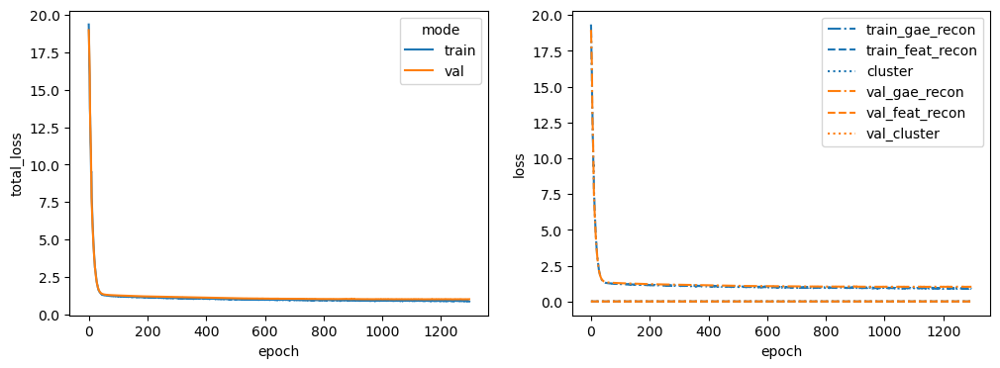

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


  9%|▊         | 873/10000 [00:19<03:20, 45.53it/s]


Training stopped after 874 epochs
Best model found at epoch 772
------------------------------------------------------------
TEST AUC: 0.823673469387755 AP: 0.8360252973869249
TRAIN loss: 0.9401204586029053
VAL loss: 1.044100284576416
TEST loss: 1.103288173675537
TEST AUC: 0.823673469387755 	 AP: 0.8360252973869249


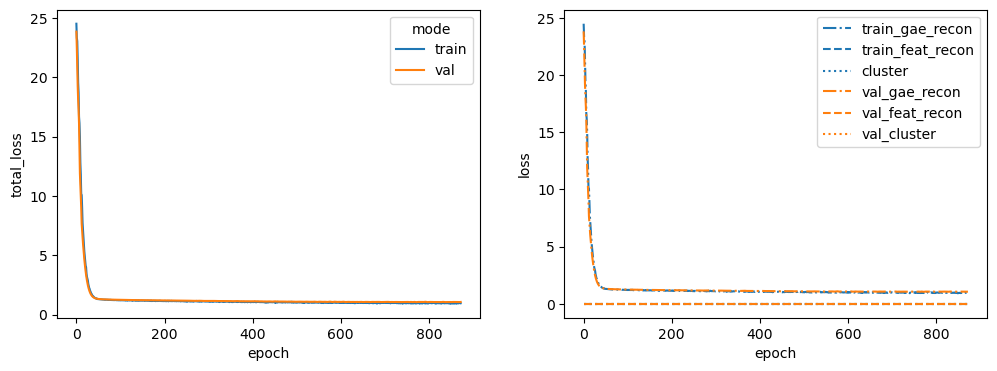

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


  9%|▉         | 930/10000 [00:20<03:15, 46.29it/s]


Training stopped after 931 epochs
Best model found at epoch 829
------------------------------------------------------------
TEST AUC: 0.8048072562358276 AP: 0.8400295227762831
TRAIN loss: 0.9706583619117737
VAL loss: 0.9593765139579773
TEST loss: 1.1540353298187256
TEST AUC: 0.8048072562358276 	 AP: 0.8400295227762831


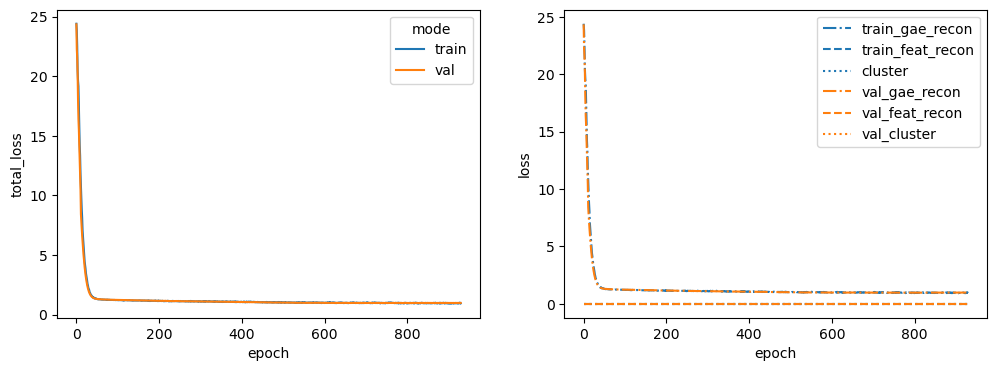

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


  8%|▊         | 765/10000 [00:16<03:17, 46.70it/s]


Training stopped after 766 epochs
Best model found at epoch 664
------------------------------------------------------------
TEST AUC: 0.812063492063492 AP: 0.8183873276333088
TRAIN loss: 0.9581475257873535
VAL loss: 1.0530588626861572
TEST loss: 1.1427268981933594
TEST AUC: 0.812063492063492 	 AP: 0.8183873276333088


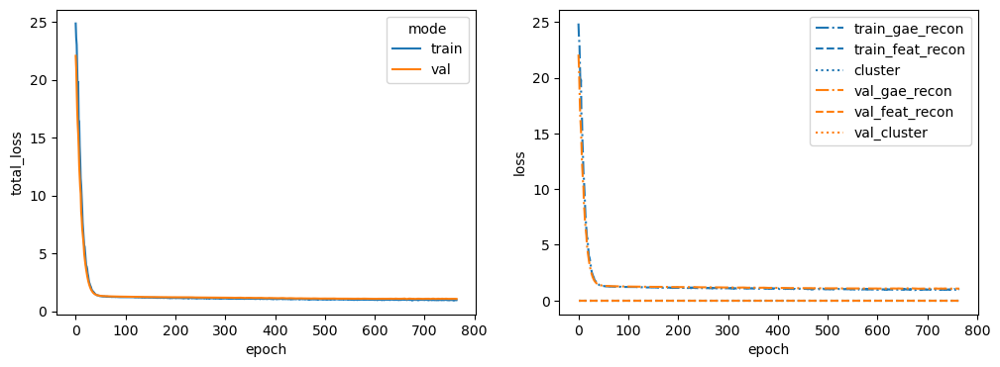

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 10%|█         | 1014/10000 [00:22<03:18, 45.33it/s]


Training stopped after 1015 epochs
Best model found at epoch 913
------------------------------------------------------------
TEST AUC: 0.7948299319727892 AP: 0.8148429410663652
TRAIN loss: 0.9434869289398193
VAL loss: 0.9936926960945129
TEST loss: 1.1754827499389648
TEST AUC: 0.7948299319727892 	 AP: 0.8148429410663652


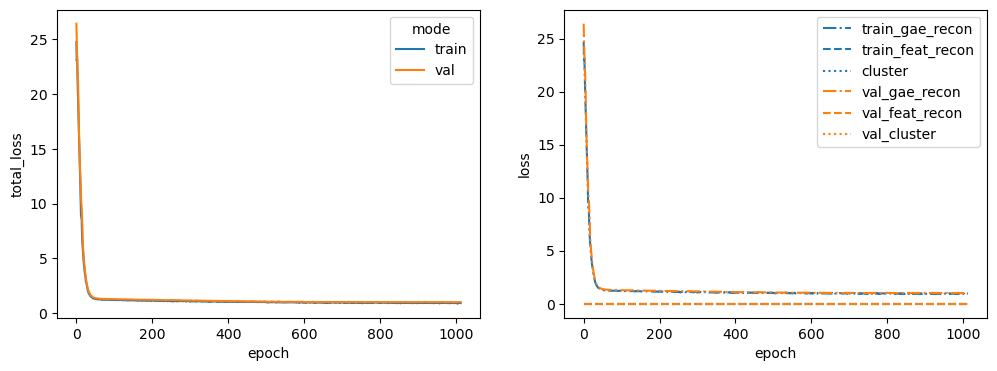

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 10%|▉         | 993/10000 [00:22<03:20, 44.88it/s]


Training stopped after 994 epochs
Best model found at epoch 892
------------------------------------------------------------
TEST AUC: 0.8429931972789115 AP: 0.8786029101197026
TRAIN loss: 0.9197499752044678
VAL loss: 1.0307650566101074
TEST loss: 1.0545940399169922
TEST AUC: 0.8429931972789115 	 AP: 0.8786029101197026


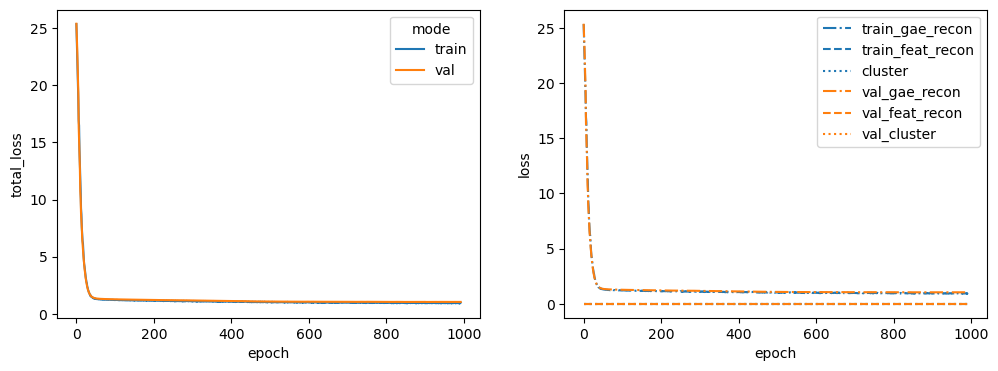

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 11%|█         | 1099/10000 [00:23<03:11, 46.57it/s]


Training stopped after 1100 epochs
Best model found at epoch 998
------------------------------------------------------------
TEST AUC: 0.8111564625850339 AP: 0.8373898957554624
TRAIN loss: 0.9564284086227417
VAL loss: 1.0077465772628784
TEST loss: 1.137416958808899
TEST AUC: 0.8111564625850339 	 AP: 0.8373898957554624


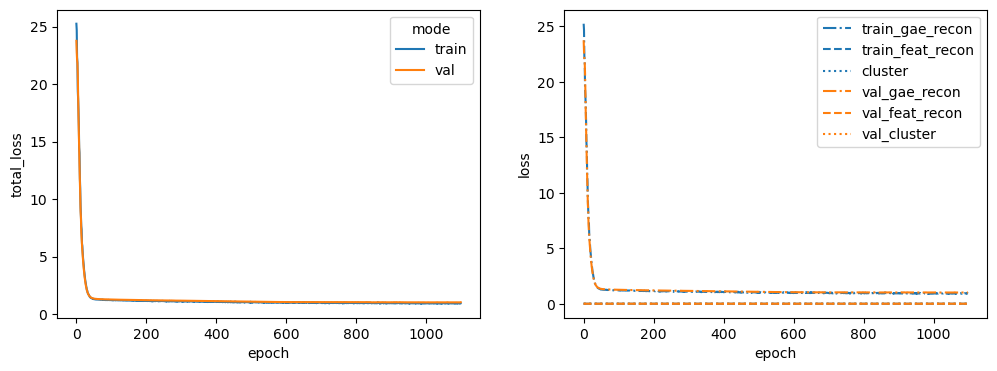

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 15%|█▌        | 1547/10000 [00:34<03:05, 45.49it/s]


Training stopped after 1548 epochs
Best model found at epoch 1446
------------------------------------------------------------
TEST AUC: 0.8335600907029479 AP: 0.86758711147796
TRAIN loss: 0.9252762794494629
VAL loss: 0.9919767379760742
TEST loss: 1.0765331983566284
TEST AUC: 0.8335600907029479 	 AP: 0.86758711147796


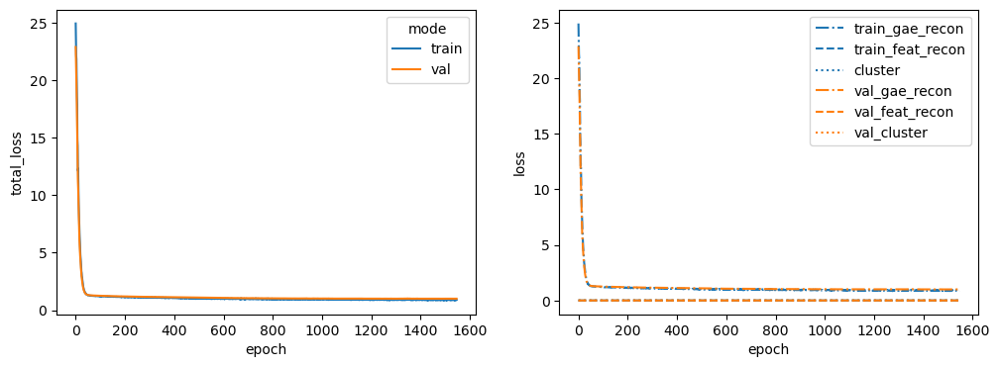

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 10%|▉         | 978/10000 [00:21<03:20, 44.90it/s]


Training stopped after 979 epochs
Best model found at epoch 877
------------------------------------------------------------
TEST AUC: 0.7865759637188209 AP: 0.8056148246009787
TRAIN loss: 0.9620665311813354
VAL loss: 1.074135184288025
TEST loss: 1.195297360420227
TEST AUC: 0.7865759637188209 	 AP: 0.8056148246009787


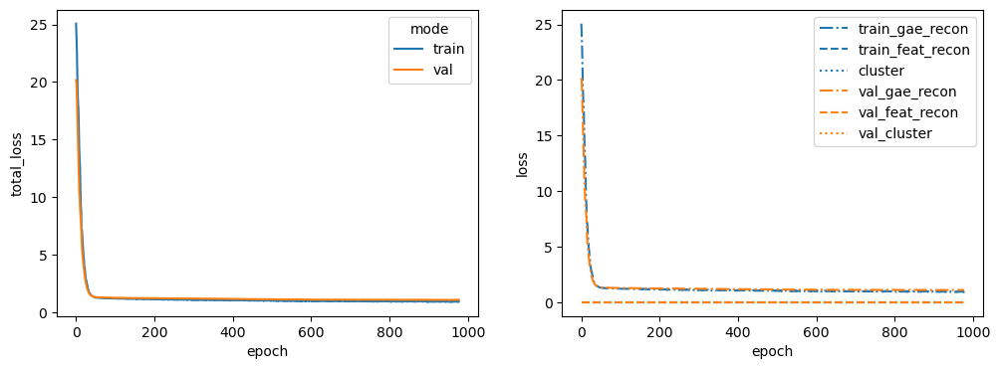

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 12%|█▏        | 1173/10000 [00:24<03:06, 47.44it/s]


Training stopped after 1174 epochs
Best model found at epoch 1072
------------------------------------------------------------
TEST AUC: 0.7982766439909297 AP: 0.7897863141145753
TRAIN loss: 0.9466831684112549
VAL loss: 1.1659200191497803
TEST loss: 1.1766917705535889
TEST AUC: 0.7982766439909297 	 AP: 0.7897863141145753


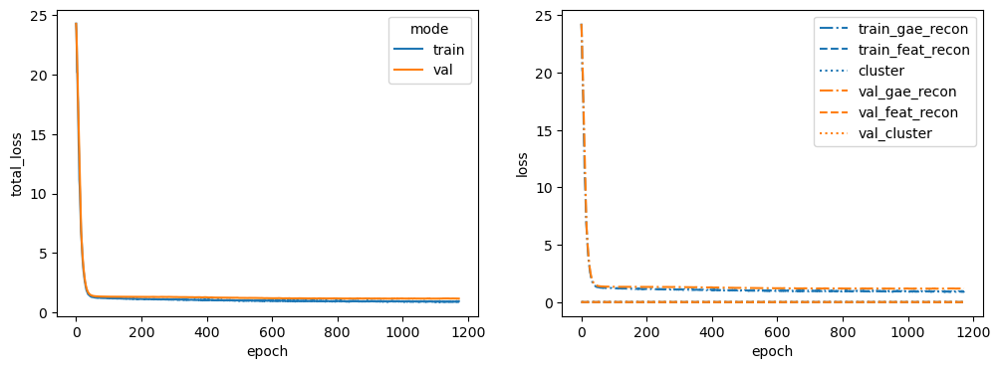

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


  8%|▊         | 810/10000 [00:18<03:25, 44.76it/s]


Training stopped after 811 epochs
Best model found at epoch 709
------------------------------------------------------------
TEST AUC: 0.7842176870748301 AP: 0.8283630526399037
TRAIN loss: 0.9672777652740479
VAL loss: 1.1516714096069336
TEST loss: 1.205797791481018
TEST AUC: 0.7842176870748301 	 AP: 0.8283630526399037


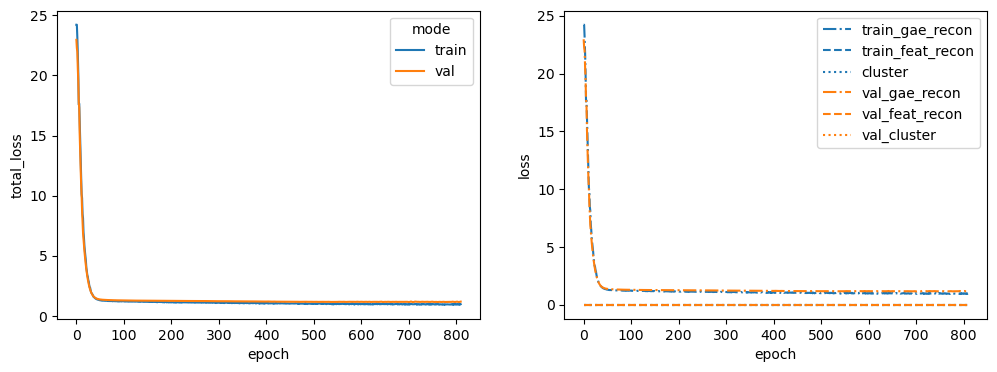

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


  9%|▉         | 944/10000 [00:20<03:19, 45.30it/s]


Training stopped after 945 epochs
Best model found at epoch 843
------------------------------------------------------------
TEST AUC: 0.8214965986394558 AP: 0.8124377675985892
TRAIN loss: 0.9678130149841309
VAL loss: 1.0230156183242798
TEST loss: 1.1272563934326172
TEST AUC: 0.8214965986394558 	 AP: 0.8124377675985892


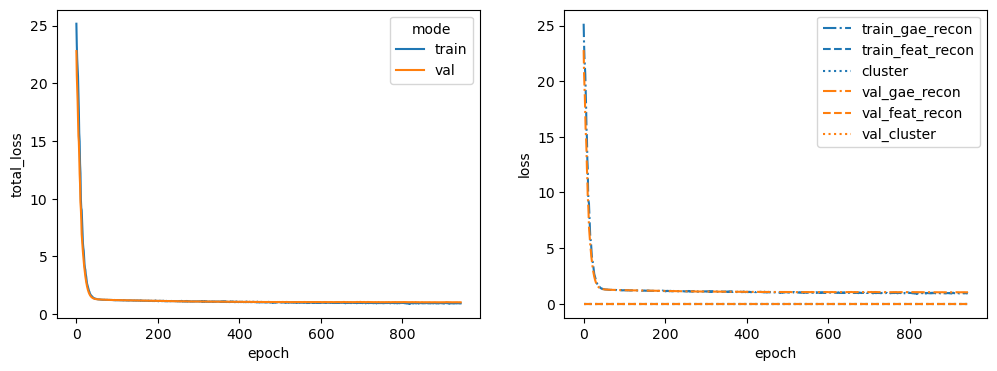

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 18%|█▊        | 1829/10000 [00:40<03:00, 45.32it/s]


Training stopped after 1830 epochs
Best model found at epoch 1728
------------------------------------------------------------
TEST AUC: 0.8351020408163266 AP: 0.8648334583397541
TRAIN loss: 0.8503434658050537
VAL loss: 0.9825553297996521
TEST loss: 1.0617927312850952
TEST AUC: 0.8351020408163266 	 AP: 0.8648334583397541


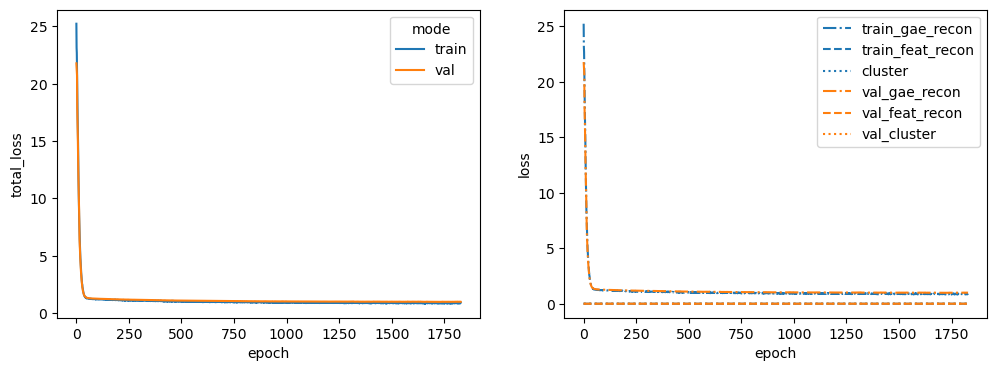

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 11%|█         | 1067/10000 [00:23<03:14, 45.82it/s]


Training stopped after 1068 epochs
Best model found at epoch 966
------------------------------------------------------------
TEST AUC: 0.7908390022675738 AP: 0.7784760961740311
TRAIN loss: 0.9329916834831238
VAL loss: 1.0592702627182007
TEST loss: 1.1911871433258057
TEST AUC: 0.7908390022675738 	 AP: 0.7784760961740311


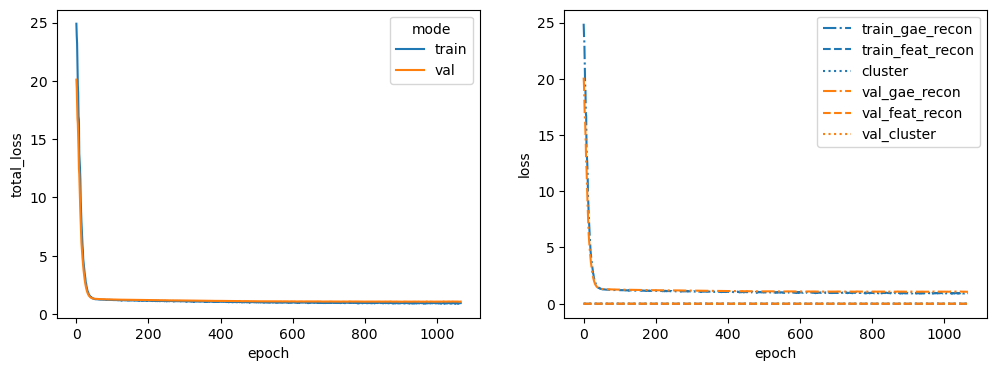

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 12%|█▏        | 1246/10000 [00:27<03:10, 45.85it/s]


Training stopped after 1247 epochs
Best model found at epoch 1145
------------------------------------------------------------
TEST AUC: 0.8076190476190477 AP: 0.826975480266066
TRAIN loss: 0.8994896411895752
VAL loss: 1.0763773918151855
TEST loss: 1.1446876525878906
TEST AUC: 0.8076190476190477 	 AP: 0.826975480266066


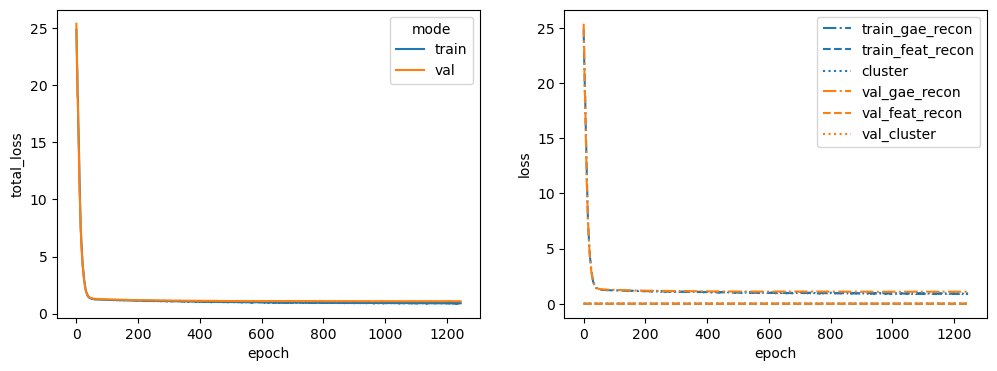

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 16%|█▋        | 1641/10000 [00:36<03:04, 45.40it/s]


Training stopped after 1642 epochs
Best model found at epoch 1540
------------------------------------------------------------
TEST AUC: 0.8049886621315193 AP: 0.803572979470187
TRAIN loss: 0.8625605702400208
VAL loss: 0.9705604314804077
TEST loss: 1.160243272781372
TEST AUC: 0.8049886621315193 	 AP: 0.803572979470187


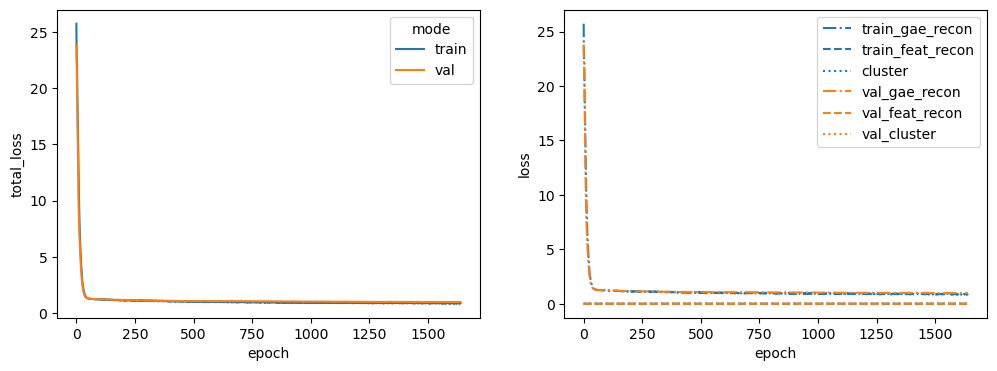

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


  9%|▉         | 931/10000 [00:20<03:23, 44.58it/s]


Training stopped after 932 epochs
Best model found at epoch 830
------------------------------------------------------------
TEST AUC: 0.8439002267573695 AP: 0.8578123296629167
TRAIN loss: 0.9471042156219482
VAL loss: 1.0264317989349365
TEST loss: 1.0652105808258057
TEST AUC: 0.8439002267573695 	 AP: 0.8578123296629167


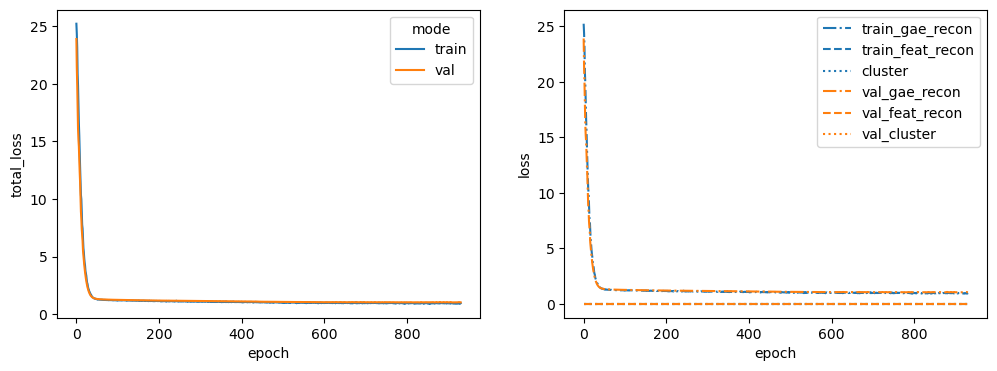

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 18%|█▊        | 1837/10000 [00:39<02:56, 46.16it/s]


Training stopped after 1838 epochs
Best model found at epoch 1736
------------------------------------------------------------
TEST AUC: 0.7796825396825396 AP: 0.8036148255946961
TRAIN loss: 0.8747729063034058
VAL loss: 0.9581192135810852
TEST loss: 1.2244856357574463
TEST AUC: 0.7796825396825396 	 AP: 0.8036148255946961


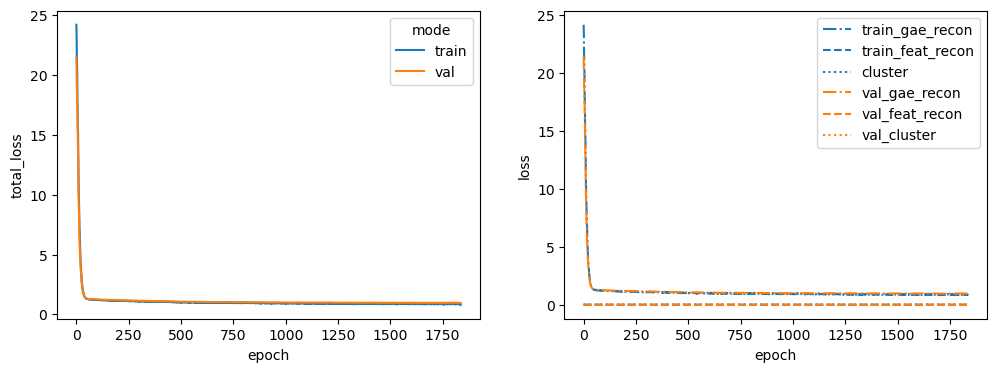

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 20%|█▉        | 1986/10000 [00:42<02:53, 46.31it/s]


Training stopped after 1987 epochs
Best model found at epoch 1885
------------------------------------------------------------
TEST AUC: 0.8603174603174603 AP: 0.8983510879641964
TRAIN loss: 0.8847472667694092
VAL loss: 0.9773294925689697
TEST loss: 0.9784512519836426
TEST AUC: 0.8603174603174603 	 AP: 0.8983510879641964


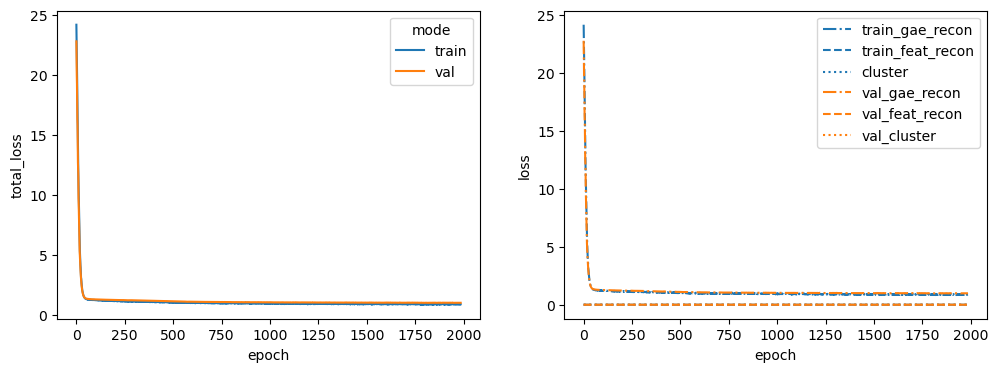

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 14%|█▍        | 1412/10000 [00:31<03:10, 45.05it/s]


Training stopped after 1413 epochs
Best model found at epoch 1311
------------------------------------------------------------
TEST AUC: 0.8313832199546484 AP: 0.8454758820597179
TRAIN loss: 0.9122031927108765
VAL loss: 1.0693001747131348
TEST loss: 1.0794371366500854
TEST AUC: 0.8313832199546484 	 AP: 0.8454758820597179


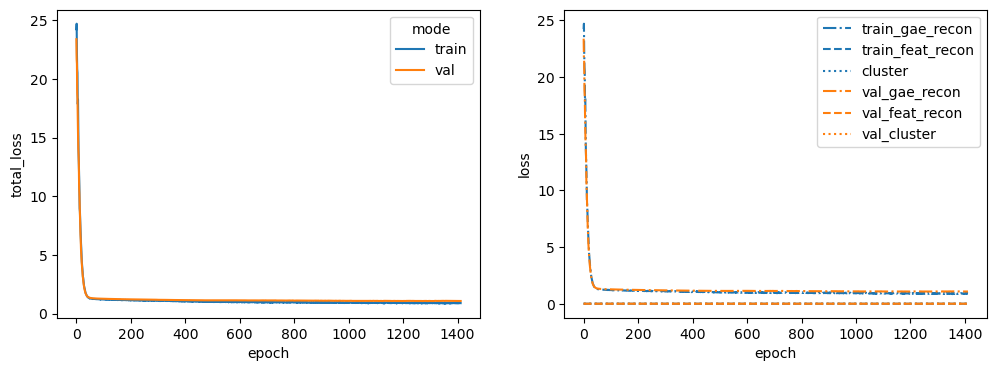

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 16%|█▌        | 1554/10000 [00:34<03:09, 44.66it/s]


Training stopped after 1555 epochs
Best model found at epoch 1453
------------------------------------------------------------
TEST AUC: 0.8089795918367346 AP: 0.8470163992476939
TRAIN loss: 0.8897897601127625
VAL loss: 1.0700243711471558
TEST loss: 1.140998125076294
TEST AUC: 0.8089795918367346 	 AP: 0.8470163992476939


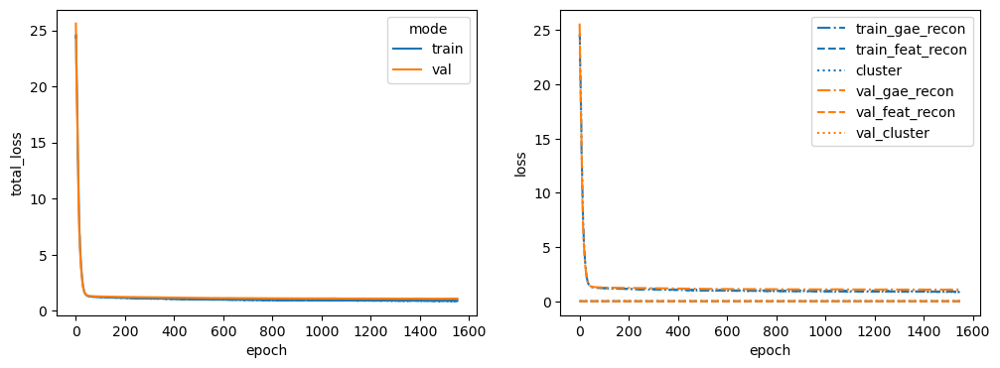

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 11%|█         | 1051/10000 [00:22<03:15, 45.75it/s]


Training stopped after 1052 epochs
Best model found at epoch 950
------------------------------------------------------------
TEST AUC: 0.8084353741496598 AP: 0.8233022403544269
TRAIN loss: 0.9602197408676147
VAL loss: 1.0125595331192017
TEST loss: 1.1407204866409302
TEST AUC: 0.8084353741496598 	 AP: 0.8233022403544269


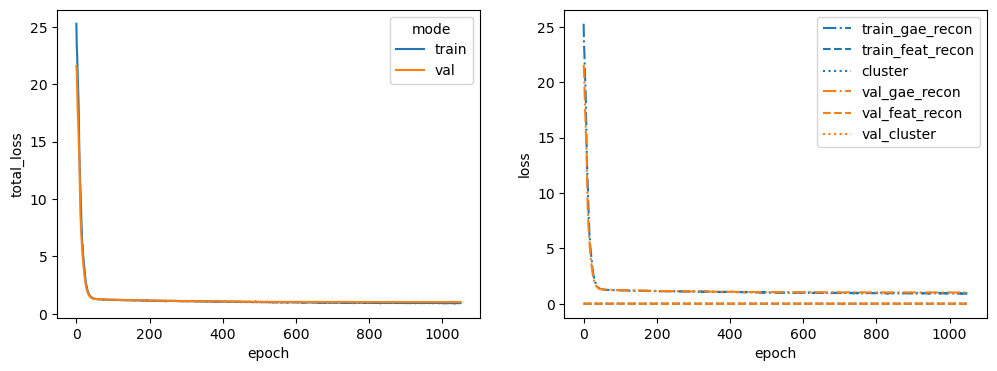

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


  7%|▋         | 723/10000 [00:15<03:23, 45.62it/s]


Training stopped after 724 epochs
Best model found at epoch 622
------------------------------------------------------------
TEST AUC: 0.7939229024943312 AP: 0.8183787432306062
TRAIN loss: 1.0082703828811646
VAL loss: 1.1079691648483276
TEST loss: 1.1704792976379395
TEST AUC: 0.7939229024943312 	 AP: 0.8183787432306062


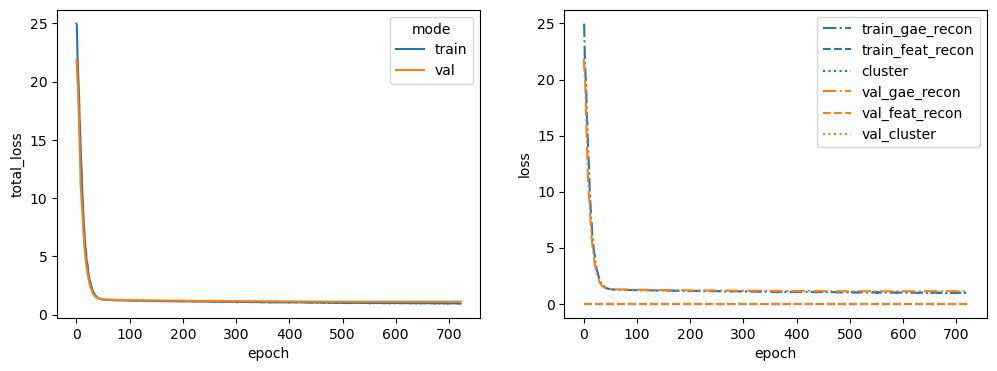

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


  6%|▌         | 598/10000 [00:13<03:30, 44.77it/s]


Training stopped after 599 epochs
Best model found at epoch 497
------------------------------------------------------------
TEST AUC: 0.788390022675737 AP: 0.7762208806984661
TRAIN loss: 1.0294510126113892
VAL loss: 1.1505903005599976
TEST loss: 1.1909348964691162
TEST AUC: 0.788390022675737 	 AP: 0.7762208806984661


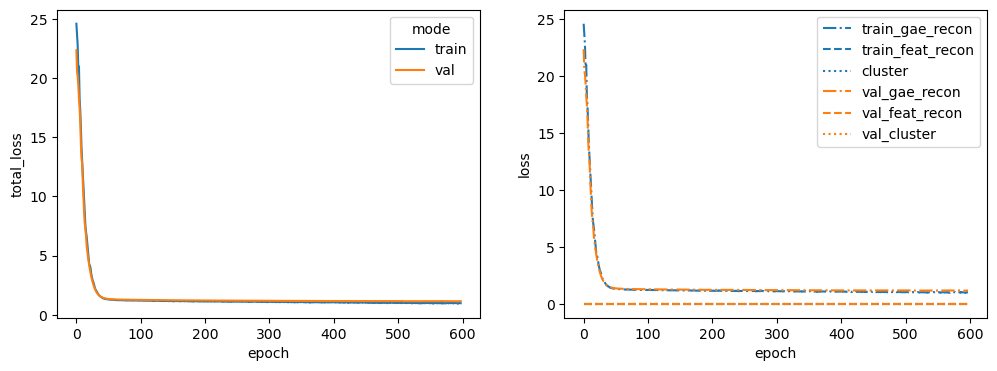

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 11%|█         | 1101/10000 [00:24<03:20, 44.30it/s]


Training stopped after 1102 epochs
Best model found at epoch 1000
------------------------------------------------------------
TEST AUC: 0.8010884353741496 AP: 0.8245758185822958
TRAIN loss: 0.9274190068244934
VAL loss: 1.0911409854888916
TEST loss: 1.1626050472259521
TEST AUC: 0.8010884353741496 	 AP: 0.8245758185822958


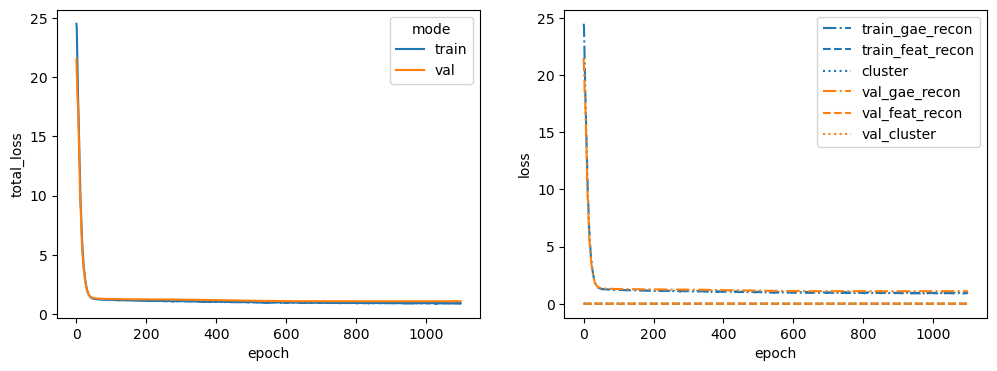

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


  9%|▉         | 877/10000 [00:19<03:21, 45.20it/s]


Training stopped after 878 epochs
Best model found at epoch 776
------------------------------------------------------------
TEST AUC: 0.8139682539682539 AP: 0.8322458313534005
TRAIN loss: 0.9568418264389038
VAL loss: 0.9928955435752869
TEST loss: 1.1467783451080322
TEST AUC: 0.8139682539682539 	 AP: 0.8322458313534005


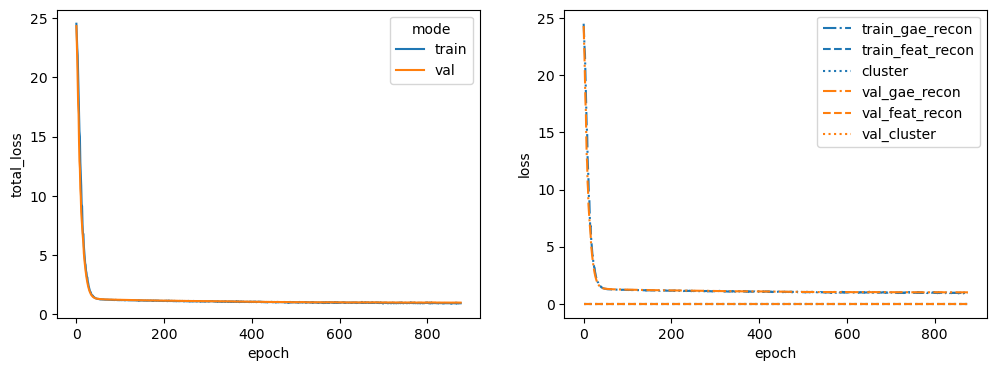

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 13%|█▎        | 1261/10000 [00:27<03:07, 46.56it/s]


Training stopped after 1262 epochs
Best model found at epoch 1160
------------------------------------------------------------
TEST AUC: 0.8296598639455781 AP: 0.8629665697541805
TRAIN loss: 0.9077225923538208
VAL loss: 1.1626689434051514
TEST loss: 1.0896614789962769
TEST AUC: 0.8296598639455781 	 AP: 0.8629665697541805


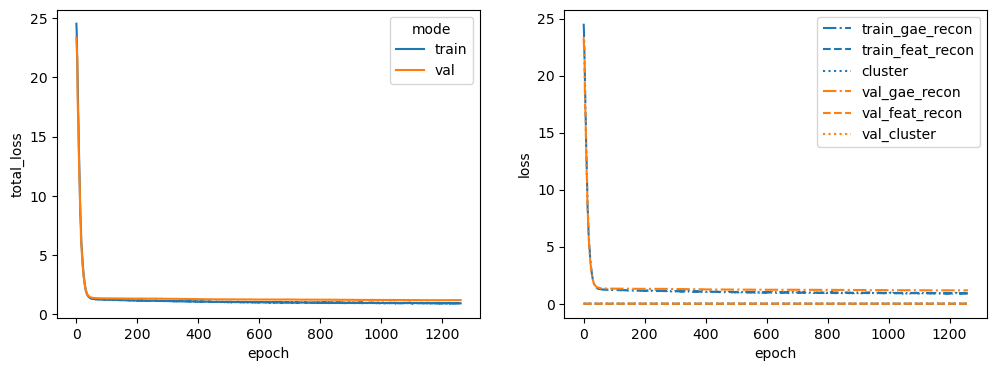

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


  8%|▊         | 785/10000 [00:17<03:27, 44.39it/s]


Training stopped after 786 epochs
Best model found at epoch 684
------------------------------------------------------------
TEST AUC: 0.8395464852607709 AP: 0.8390921034276674
TRAIN loss: 0.9739733934402466
VAL loss: 1.0818133354187012
TEST loss: 1.0859285593032837
TEST AUC: 0.8395464852607709 	 AP: 0.8390921034276674


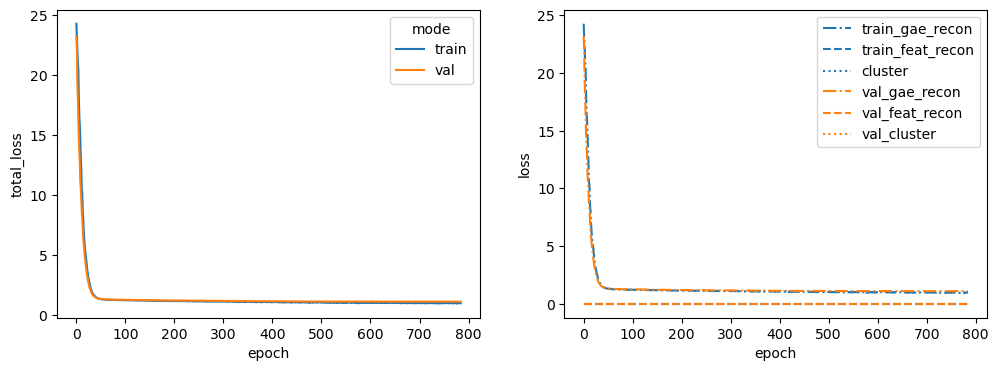

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


  9%|▉         | 881/10000 [00:17<03:04, 49.33it/s]


Training stopped after 882 epochs
Best model found at epoch 780
------------------------------------------------------------
TEST AUC: 0.8134240362811792 AP: 0.8441766619873021
TRAIN loss: 0.9564229249954224
VAL loss: 1.1285921335220337
TEST loss: 1.1256847381591797
TEST AUC: 0.8134240362811792 	 AP: 0.8441766619873021


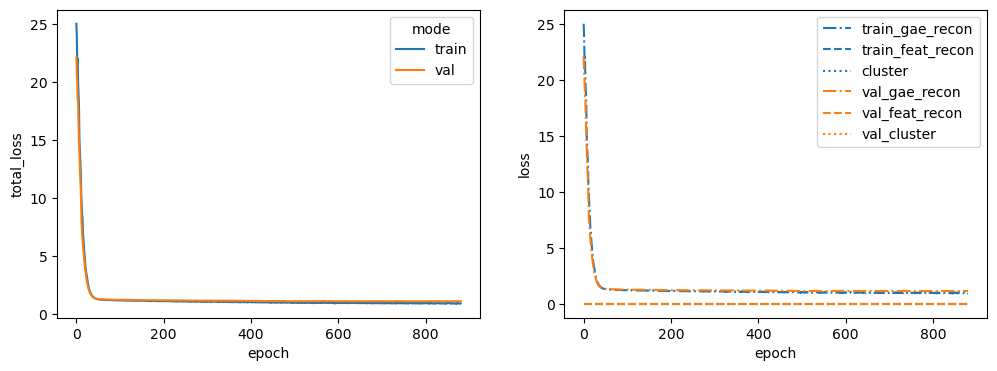

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 10%|█         | 1006/10000 [00:21<03:09, 47.37it/s]


Training stopped after 1007 epochs
Best model found at epoch 905
------------------------------------------------------------
TEST AUC: 0.7976417233560091 AP: 0.7744223773058221
TRAIN loss: 0.9353858828544617
VAL loss: 1.0240155458450317
TEST loss: 1.180777907371521
TEST AUC: 0.7976417233560091 	 AP: 0.7744223773058221


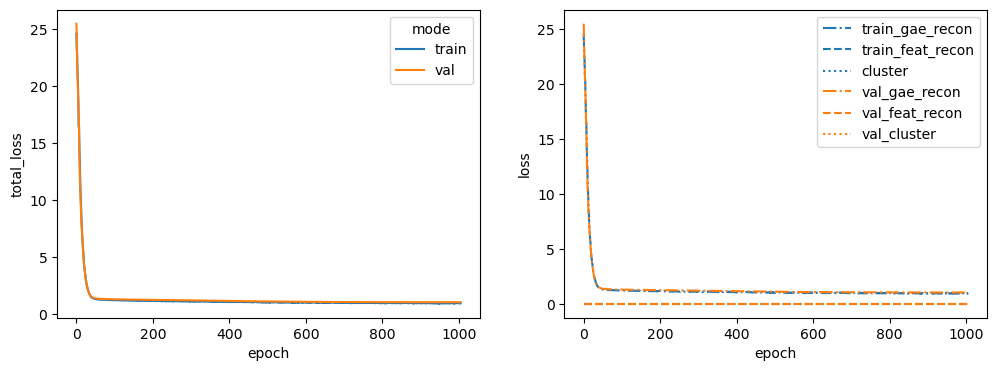

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


  9%|▉         | 880/10000 [00:18<03:11, 47.66it/s]


Training stopped after 881 epochs
Best model found at epoch 779
------------------------------------------------------------
TEST AUC: 0.800453514739229 AP: 0.8184454011302991
TRAIN loss: 0.9833000302314758
VAL loss: 0.9319156408309937
TEST loss: 1.1704742908477783
TEST AUC: 0.800453514739229 	 AP: 0.8184454011302991


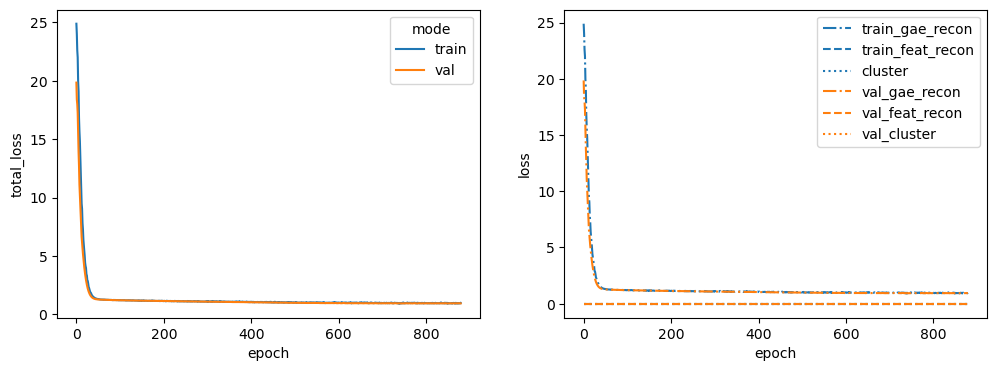

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 10%|█         | 1032/10000 [00:20<03:01, 49.45it/s]


Training stopped after 1033 epochs
Best model found at epoch 931
------------------------------------------------------------
TEST AUC: 0.8126984126984127 AP: 0.844247382020696
TRAIN loss: 0.9585528373718262
VAL loss: 1.0290175676345825
TEST loss: 1.1219717264175415
TEST AUC: 0.8126984126984127 	 AP: 0.844247382020696


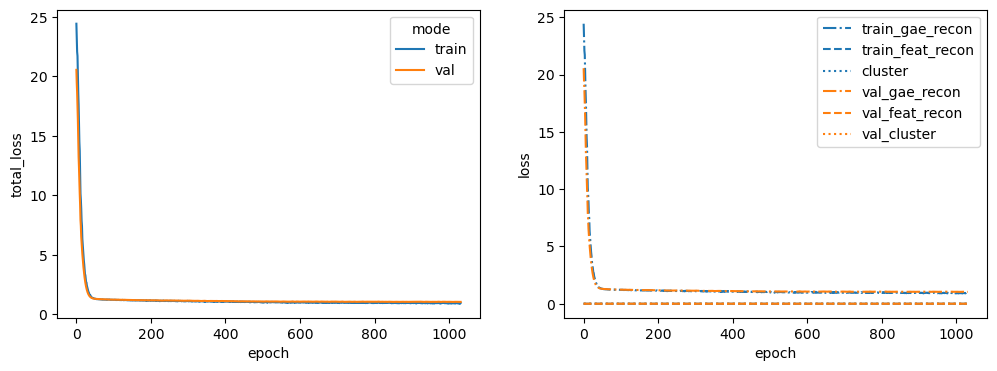

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 14%|█▍        | 1419/10000 [00:29<02:57, 48.31it/s]


Training stopped after 1420 epochs
Best model found at epoch 1318
------------------------------------------------------------
TEST AUC: 0.8043537414965987 AP: 0.820533848460727
TRAIN loss: 0.9094573259353638
VAL loss: 1.011107325553894
TEST loss: 1.1457674503326416
TEST AUC: 0.8043537414965987 	 AP: 0.820533848460727


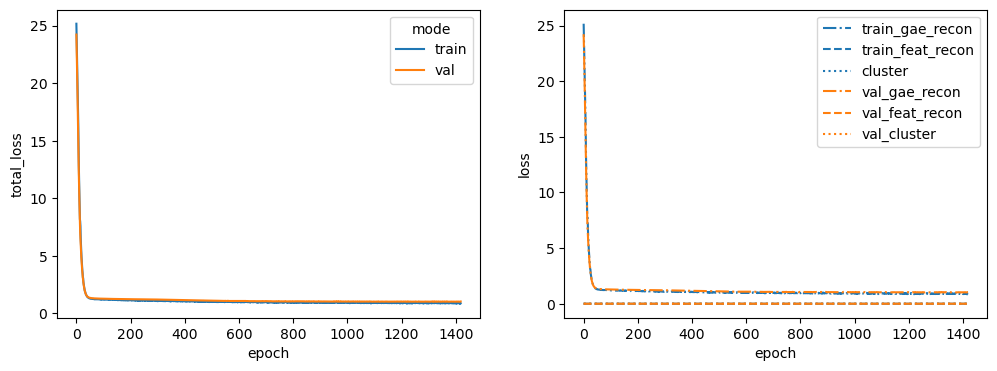

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


  9%|▉         | 903/10000 [00:19<03:18, 45.83it/s]


Training stopped after 904 epochs
Best model found at epoch 802
------------------------------------------------------------
TEST AUC: 0.8185034013605442 AP: 0.8358624808275599
TRAIN loss: 0.9621122479438782
VAL loss: 1.0923750400543213
TEST loss: 1.1133164167404175
TEST AUC: 0.8185034013605442 	 AP: 0.8358624808275599


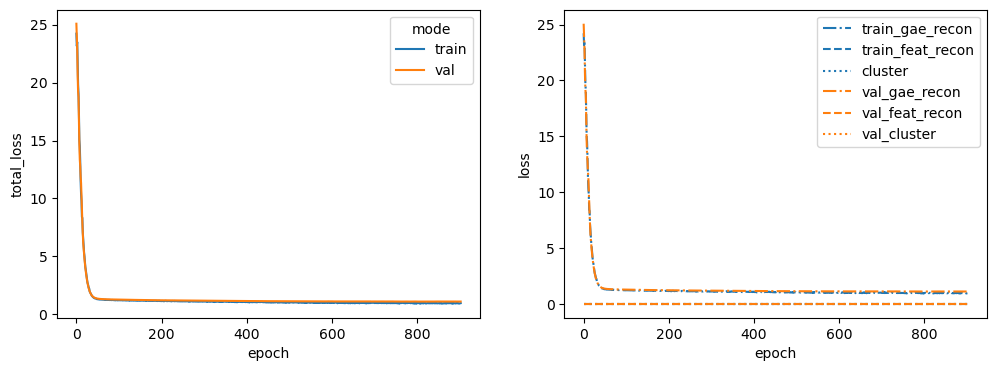

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 15%|█▌        | 1532/10000 [00:32<02:59, 47.13it/s]


Training stopped after 1533 epochs
Best model found at epoch 1431
------------------------------------------------------------
TEST AUC: 0.8033560090702949 AP: 0.8286805951236115
TRAIN loss: 0.8928516507148743
VAL loss: 1.0375200510025024
TEST loss: 1.1563749313354492
TEST AUC: 0.8033560090702949 	 AP: 0.8286805951236115


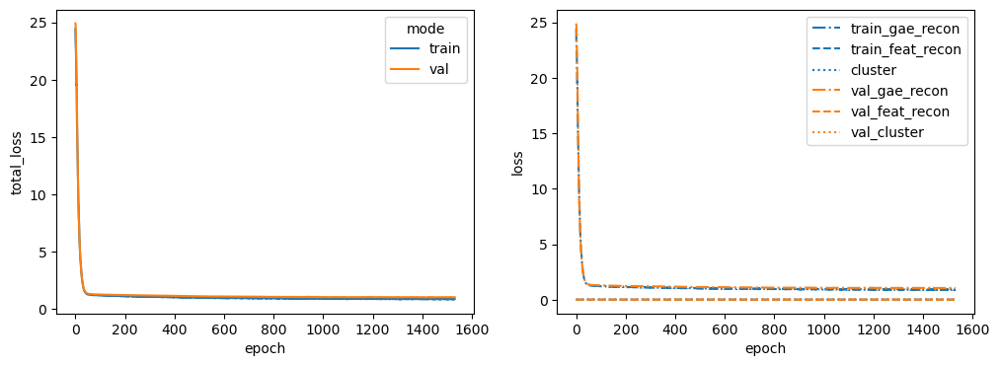

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


  7%|▋         | 678/10000 [00:13<03:10, 48.95it/s]


Training stopped after 679 epochs
Best model found at epoch 577
------------------------------------------------------------
TEST AUC: 0.823764172335601 AP: 0.8644618261684739
TRAIN loss: 1.0179729461669922
VAL loss: 1.0922901630401611
TEST loss: 1.110055685043335
TEST AUC: 0.823764172335601 	 AP: 0.8644618261684739


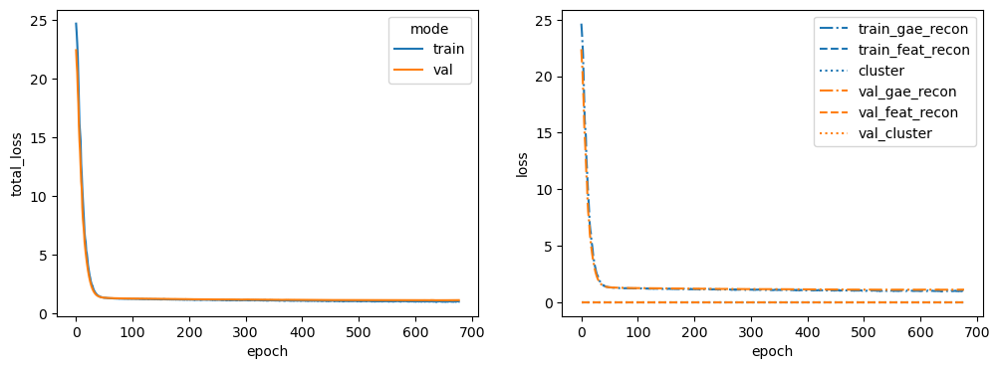

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


  9%|▉         | 902/10000 [00:18<03:09, 48.06it/s]


Training stopped after 903 epochs
Best model found at epoch 801
------------------------------------------------------------
TEST AUC: 0.8048072562358276 AP: 0.8415325133872924
TRAIN loss: 0.9634745121002197
VAL loss: 0.8799612522125244
TEST loss: 1.1509724855422974
TEST AUC: 0.8048072562358276 	 AP: 0.8415325133872924


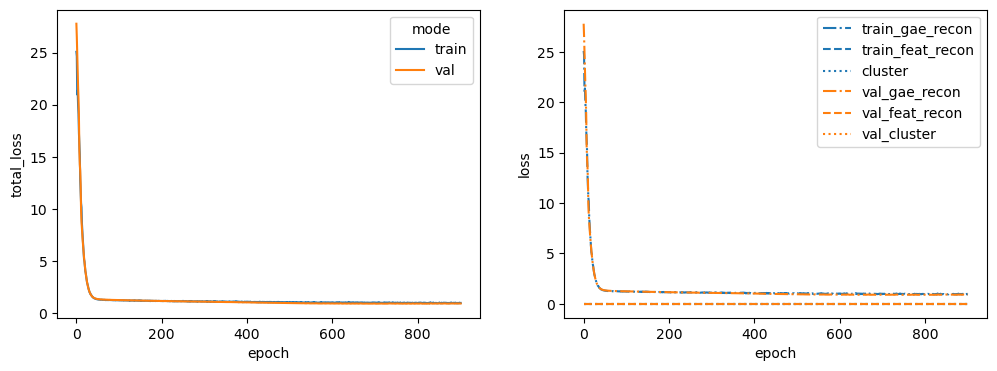

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


  6%|▋         | 650/10000 [00:13<03:18, 47.22it/s]


Training stopped after 651 epochs
Best model found at epoch 549
------------------------------------------------------------
TEST AUC: 0.813968253968254 AP: 0.8344924736358843
TRAIN loss: 0.9996203184127808
VAL loss: 1.1935056447982788
TEST loss: 1.1116175651550293
TEST AUC: 0.813968253968254 	 AP: 0.8344924736358843


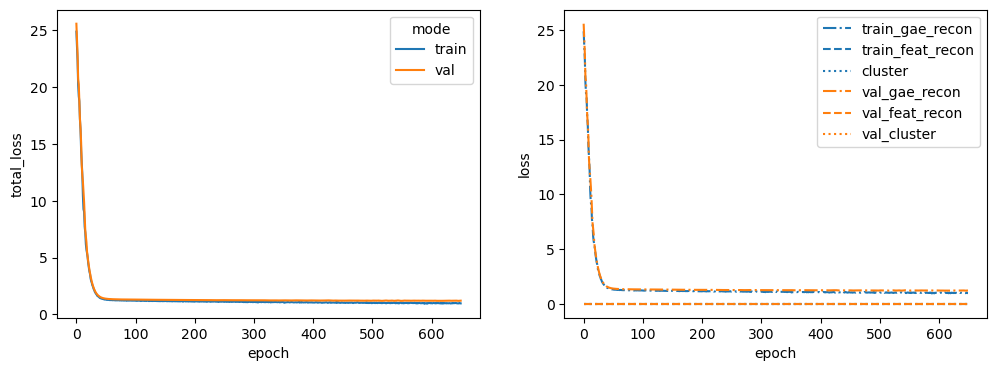

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 14%|█▍        | 1395/10000 [00:29<03:01, 47.53it/s]


Training stopped after 1396 epochs
Best model found at epoch 1294
------------------------------------------------------------
TEST AUC: 0.8212244897959182 AP: 0.8171165158619875
TRAIN loss: 0.8893500566482544
VAL loss: 1.092396855354309
TEST loss: 1.117311716079712
TEST AUC: 0.8212244897959182 	 AP: 0.8171165158619875


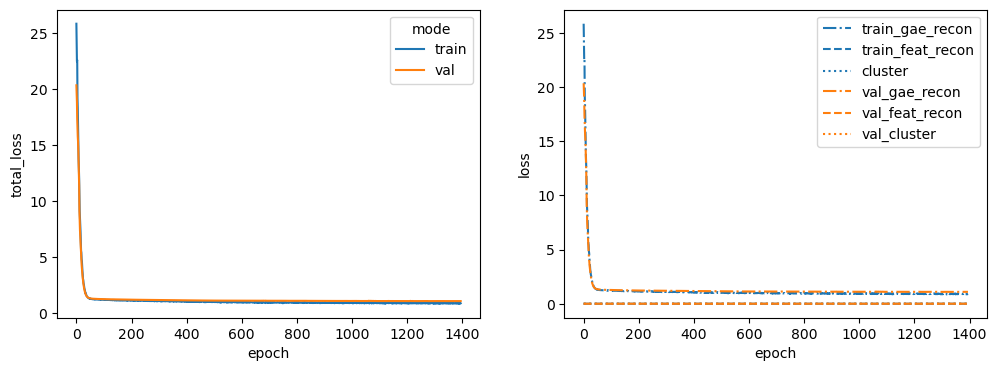

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


  9%|▉         | 907/10000 [00:18<03:06, 48.76it/s]


Training stopped after 908 epochs
Best model found at epoch 806
------------------------------------------------------------
TEST AUC: 0.8197732426303855 AP: 0.8308669529233998
TRAIN loss: 0.9537215232849121
VAL loss: 1.1479406356811523
TEST loss: 1.1103487014770508
TEST AUC: 0.8197732426303855 	 AP: 0.8308669529233998


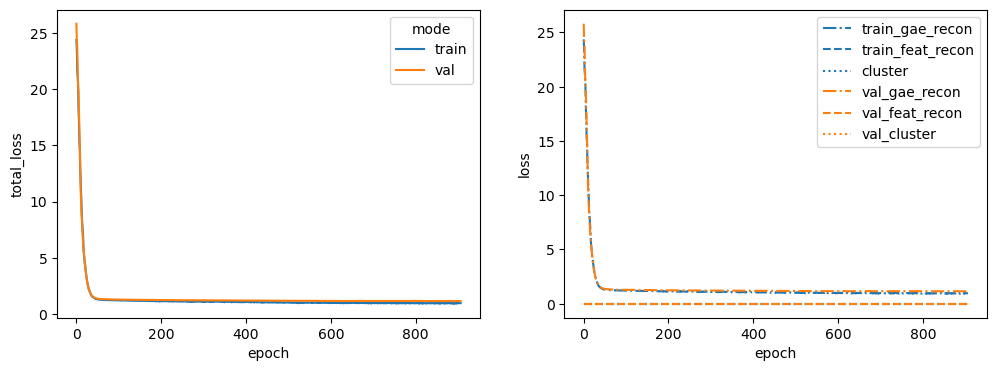

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 13%|█▎        | 1302/10000 [00:26<02:56, 49.31it/s]


Training stopped after 1303 epochs
Best model found at epoch 1201
------------------------------------------------------------
TEST AUC: 0.8335600907029479 AP: 0.8406377753171506
TRAIN loss: 0.9309707880020142
VAL loss: 1.038328766822815
TEST loss: 1.0927586555480957
TEST AUC: 0.8335600907029479 	 AP: 0.8406377753171506


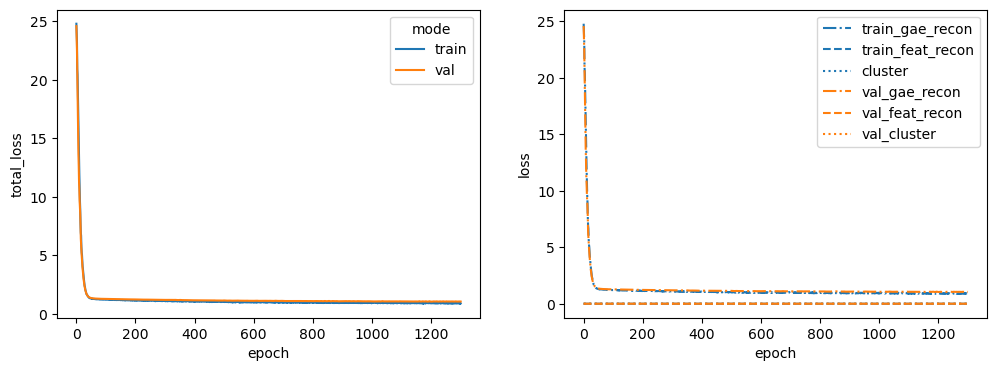

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 16%|█▌        | 1583/10000 [00:33<02:58, 47.21it/s]


Training stopped after 1584 epochs
Best model found at epoch 1482
------------------------------------------------------------
TEST AUC: 0.822312925170068 AP: 0.8389115629079872
TRAIN loss: 0.8590652346611023
VAL loss: 1.0793108940124512
TEST loss: 1.096472978591919
TEST AUC: 0.822312925170068 	 AP: 0.8389115629079872


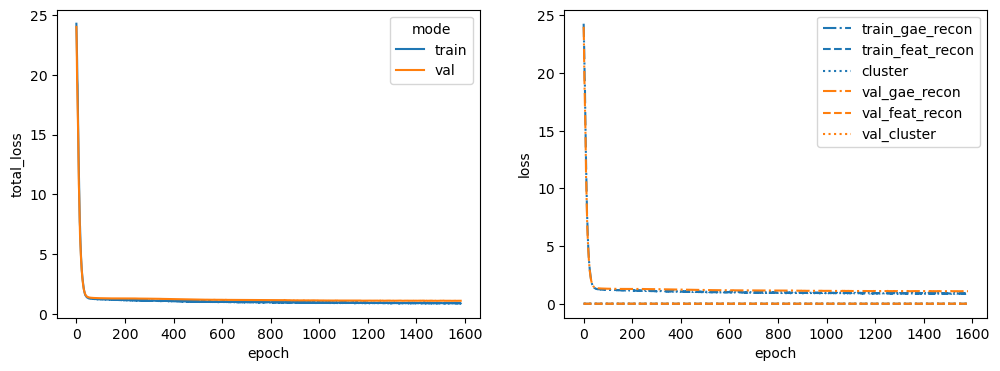

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


100%|██████████| 10000/10000 [03:33<00:00, 46.89it/s]


------------------------------------------------------------
TEST AUC: 0.6062131519274376 AP: 0.5598580413965005
TRAIN loss: 5.872595011169324e-06
VAL loss: 5.8631835599953774e-06
TEST loss: 0.005967789329588413
TEST AUC: 0.6062131519274376 	 AP: 0.5598580413965005


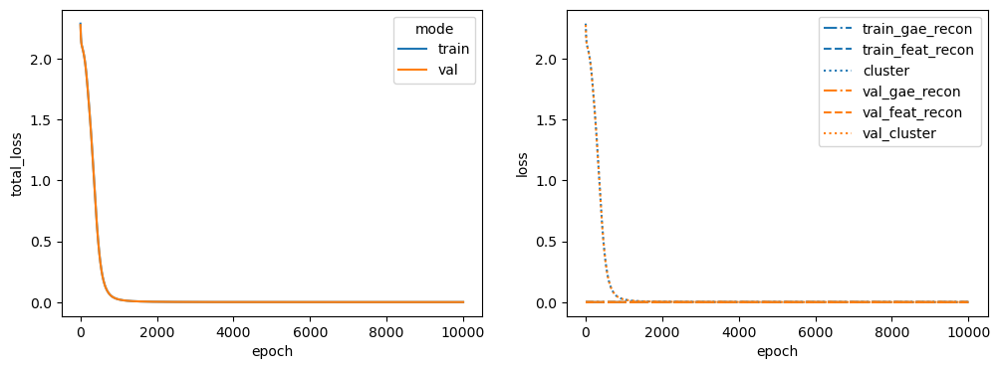

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


100%|██████████| 10000/10000 [03:33<00:00, 46.91it/s]


------------------------------------------------------------
TEST AUC: 0.5417687074829932 AP: 0.5222053282069095
TRAIN loss: 5.5432064982596785e-06
VAL loss: 5.536932349059498e-06
TEST loss: 0.00013075022434350103
TEST AUC: 0.5417687074829932 	 AP: 0.5222053282069095


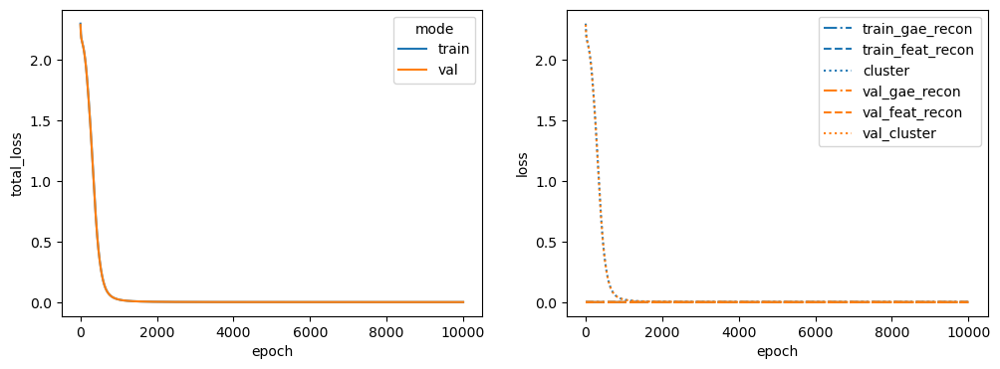

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


100%|██████████| 10000/10000 [03:33<00:00, 46.75it/s]


------------------------------------------------------------
TEST AUC: 0.6051700680272109 AP: 0.5593505833012543
TRAIN loss: 6.136106549092801e-06
VAL loss: 6.1329697018663865e-06
TEST loss: 0.000452094420325011
TEST AUC: 0.6051700680272109 	 AP: 0.5593505833012543


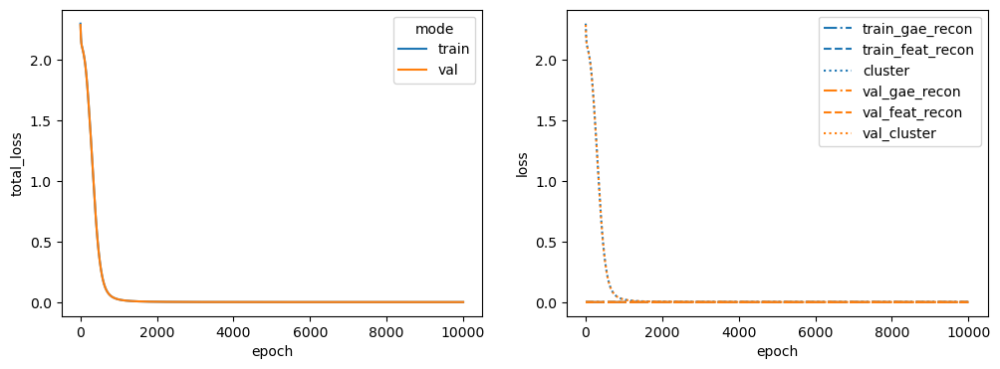

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


100%|██████████| 10000/10000 [03:31<00:00, 47.29it/s]


------------------------------------------------------------
TEST AUC: 0.572063492063492 AP: 0.5394933452951985
TRAIN loss: 5.963567218714161e-06
VAL loss: 5.960429916740395e-06
TEST loss: 0.0018574082059785724
TEST AUC: 0.572063492063492 	 AP: 0.5394933452951985


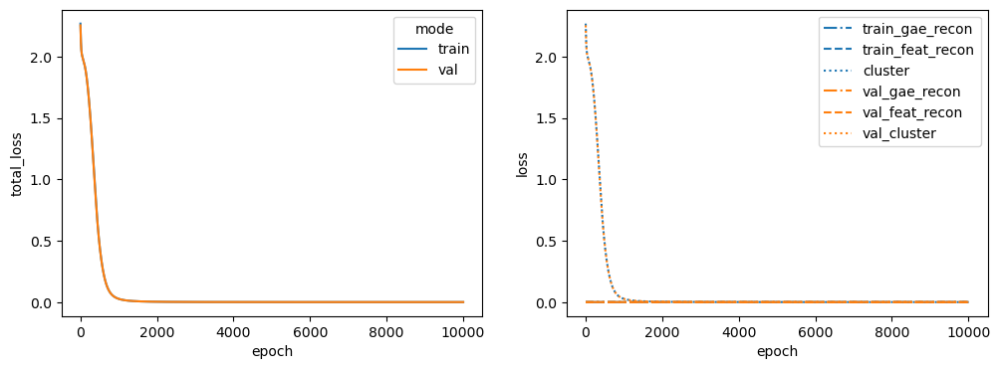

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


100%|██████████| 10000/10000 [03:34<00:00, 46.67it/s]


------------------------------------------------------------
TEST AUC: 0.5165532879818594 AP: 0.5082346925444934
TRAIN loss: 6.0765028138121124e-06
VAL loss: 6.073365511838347e-06
TEST loss: 0.0008066559676080942
TEST AUC: 0.5165532879818594 	 AP: 0.5082346925444934


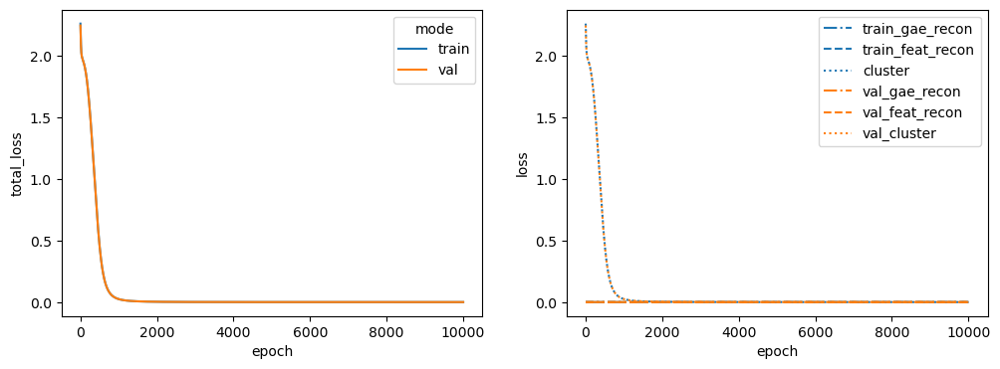

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


100%|██████████| 10000/10000 [03:34<00:00, 46.69it/s]


------------------------------------------------------------
TEST AUC: 0.64421768707483 AP: 0.5856776971704345
TRAIN loss: 6.010624474583892e-06
VAL loss: 6.004350325383712e-06
TEST loss: 0.009733323939144611
TEST AUC: 0.64421768707483 	 AP: 0.5856776971704345


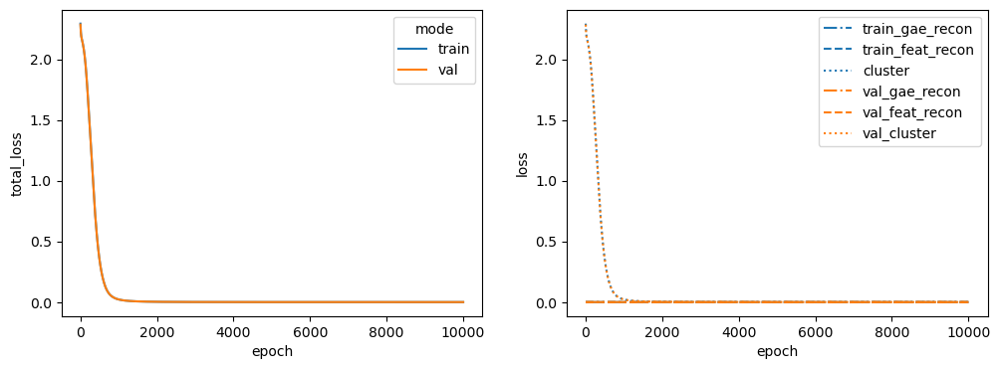

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


100%|██████████| 10000/10000 [03:33<00:00, 46.90it/s]


------------------------------------------------------------
TEST AUC: 0.5713832199546485 AP: 0.5405449074524906
TRAIN loss: 5.5243813221750315e-06
VAL loss: 5.521244474948617e-06
TEST loss: 0.00040133477887138724
TEST AUC: 0.5713832199546485 	 AP: 0.5405449074524906


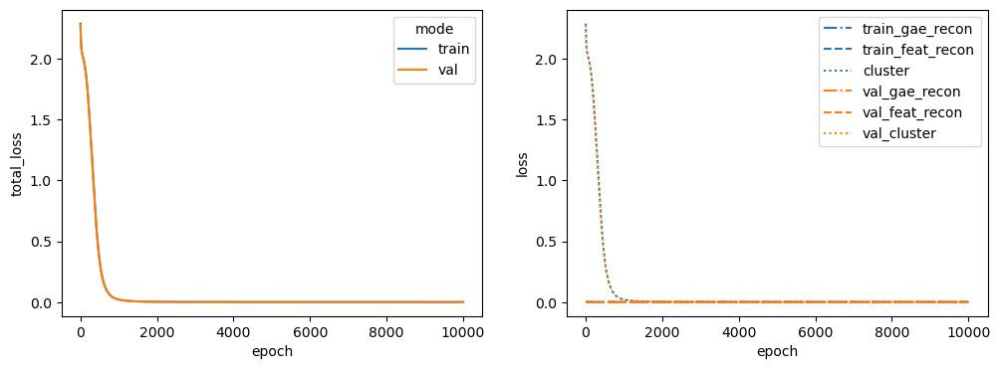

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


100%|██████████| 10000/10000 [03:34<00:00, 46.71it/s]


------------------------------------------------------------
TEST AUC: 0.62140589569161 AP: 0.5697535010650708
TRAIN loss: 5.891417458769865e-06
VAL loss: 5.8882806115434505e-06
TEST loss: 0.07784249633550644
TEST AUC: 0.62140589569161 	 AP: 0.5697535010650708


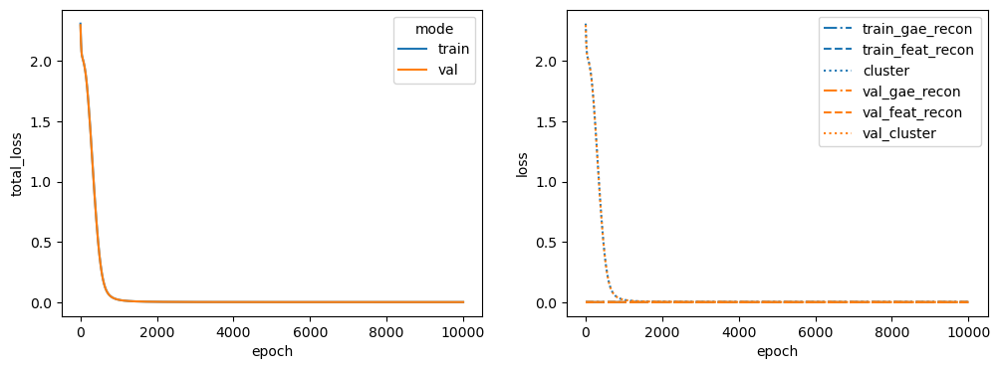

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


100%|██████████| 10000/10000 [03:35<00:00, 46.38it/s]


------------------------------------------------------------
TEST AUC: 0.6015873015873016 AP: 0.558126760392853
TRAIN loss: 5.445953775051748e-06
VAL loss: 5.4428169278253336e-06
TEST loss: 0.26289764046669006
TEST AUC: 0.6015873015873016 	 AP: 0.558126760392853


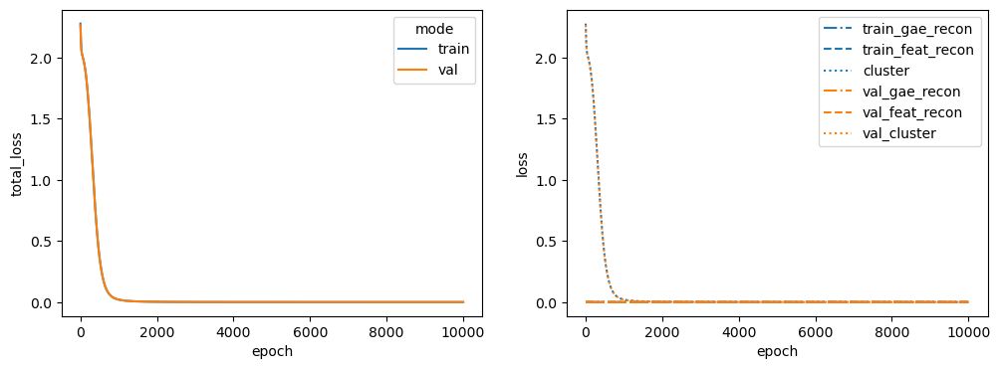

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


100%|██████████| 10000/10000 [03:34<00:00, 46.68it/s]


------------------------------------------------------------
TEST AUC: 0.5741950113378685 AP: 0.5403235882860528
TRAIN loss: 6.142378879303578e-06
VAL loss: 6.1392420320771635e-06
TEST loss: 0.0007315505063161254
TEST AUC: 0.5741950113378685 	 AP: 0.5403235882860528


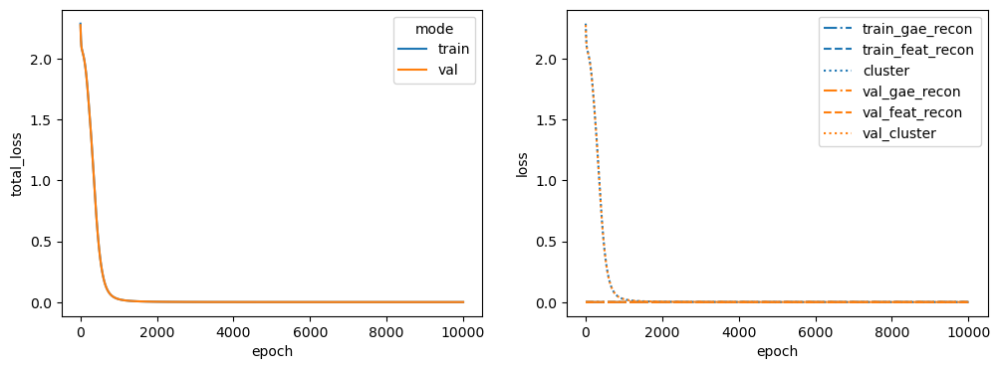

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


100%|██████████| 10000/10000 [03:33<00:00, 46.76it/s]


------------------------------------------------------------
TEST AUC: 0.6086167800453515 AP: 0.5612641165429259
TRAIN loss: 5.642544692818774e-06
VAL loss: 5.639487881126115e-06
TEST loss: 0.041228268295526505
TEST AUC: 0.6086167800453515 	 AP: 0.5612641165429259


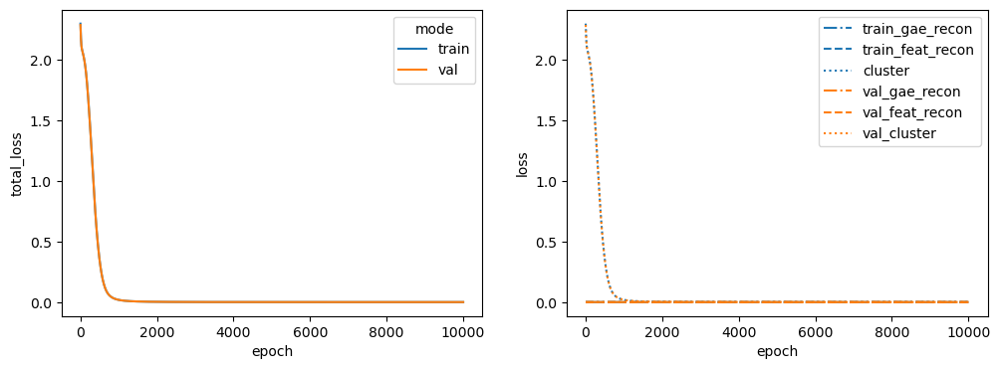

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


100%|██████████| 10000/10000 [03:32<00:00, 46.96it/s]


------------------------------------------------------------
TEST AUC: 0.5993650793650793 AP: 0.5559450735188299
TRAIN loss: 5.722015430364991e-06
VAL loss: 5.7094671319646295e-06
TEST loss: 0.10602027177810669
TEST AUC: 0.5993650793650793 	 AP: 0.5559450735188299


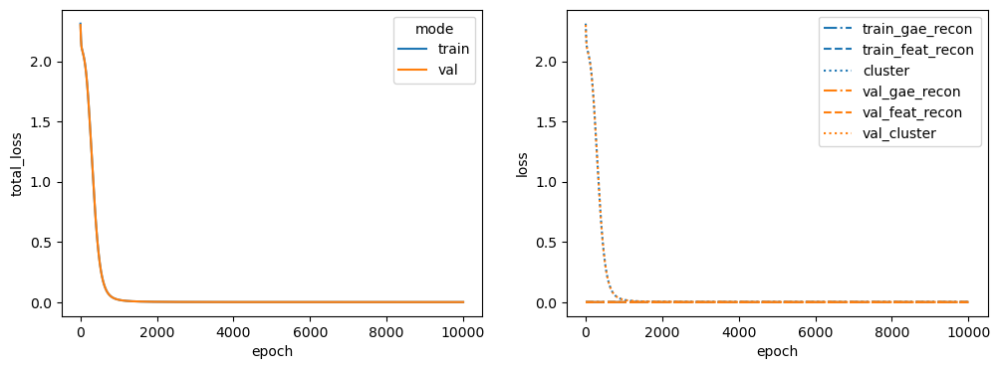

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


100%|██████████| 10000/10000 [03:32<00:00, 47.05it/s]


------------------------------------------------------------
TEST AUC: 0.58562358276644 AP: 0.5487696723275708
TRAIN loss: 5.700057045032736e-06
VAL loss: 5.693783805327257e-06
TEST loss: 0.0030698177870362997
TEST AUC: 0.58562358276644 	 AP: 0.5487696723275708


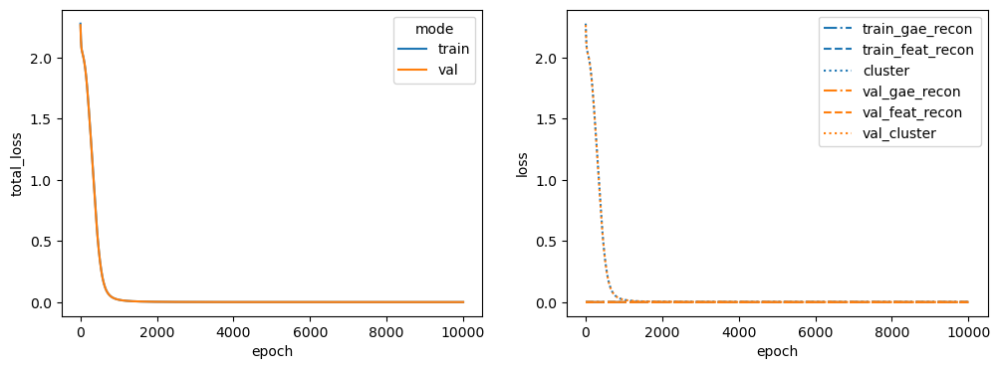

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


100%|██████████| 10000/10000 [03:35<00:00, 46.48it/s]


------------------------------------------------------------
TEST AUC: 0.5885260770975056 AP: 0.5488275050227208
TRAIN loss: 5.844358838658081e-06
VAL loss: 5.8412219914316665e-06
TEST loss: 0.002017837716266513
TEST AUC: 0.5885260770975056 	 AP: 0.5488275050227208


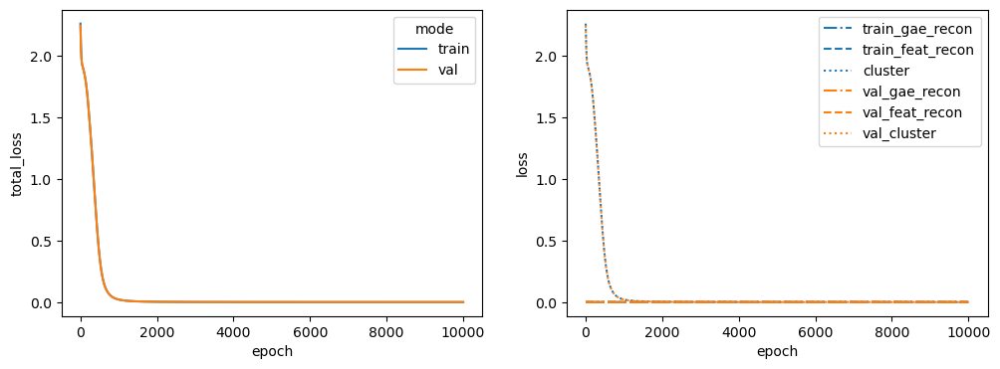

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


100%|██████████| 10000/10000 [03:34<00:00, 46.59it/s]


------------------------------------------------------------
TEST AUC: 0.5927891156462586 AP: 0.5516495226878158
TRAIN loss: 6.214129825821146e-06
VAL loss: 6.2110730141284876e-06
TEST loss: 0.0013718714471906424
TEST AUC: 0.5927891156462586 	 AP: 0.5516495226878158


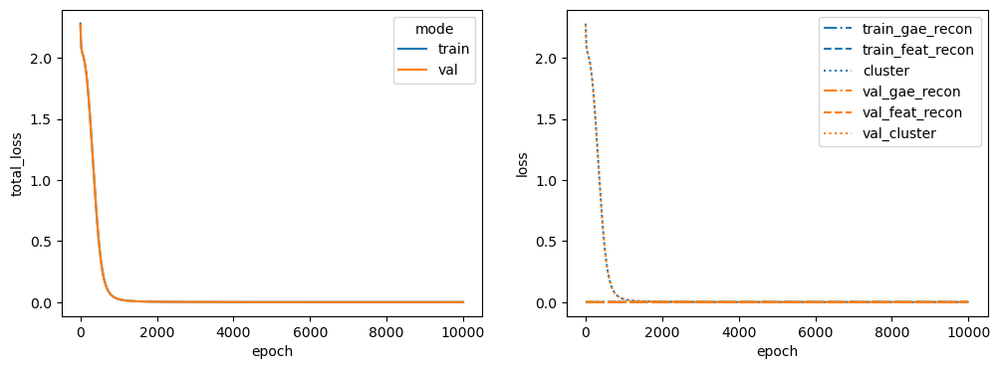

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


100%|██████████| 10000/10000 [03:34<00:00, 46.65it/s]


------------------------------------------------------------
TEST AUC: 0.6218140589569161 AP: 0.5699279066412448
TRAIN loss: 5.8067148529517e-06
VAL loss: 5.803578460472636e-06
TEST loss: 0.11061088740825653
TEST AUC: 0.6218140589569161 	 AP: 0.5699279066412448


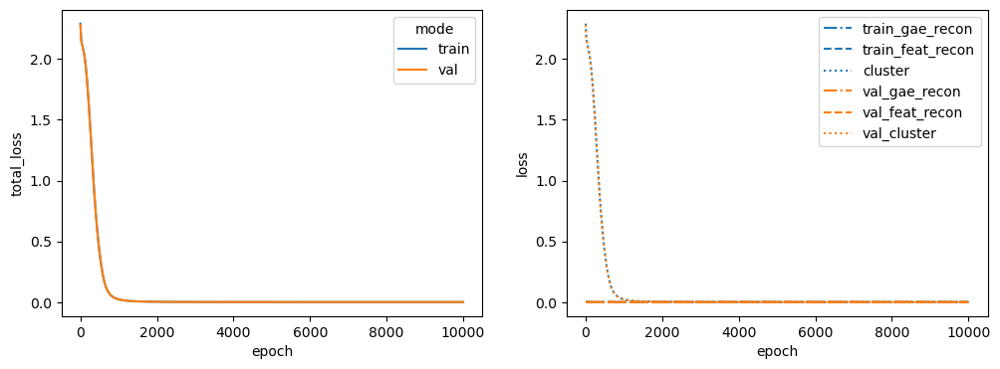

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


100%|██████████| 10000/10000 [03:33<00:00, 46.73it/s]


------------------------------------------------------------
TEST AUC: 0.5956462585034014 AP: 0.5527704333713593
TRAIN loss: 5.982395123282913e-06
VAL loss: 5.969846824882552e-06
TEST loss: 0.013087280094623566
TEST AUC: 0.5956462585034014 	 AP: 0.5527704333713593


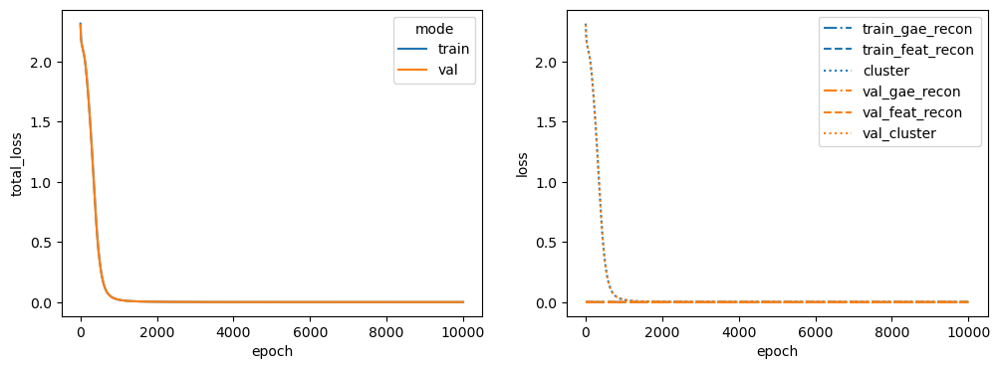

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


100%|██████████| 10000/10000 [03:33<00:00, 46.81it/s]


------------------------------------------------------------
TEST AUC: 0.589342403628118 AP: 0.550545541935558
TRAIN loss: 5.6906460486061405e-06
VAL loss: 5.68437189940596e-06
TEST loss: 0.0003080728347413242
TEST AUC: 0.589342403628118 	 AP: 0.550545541935558


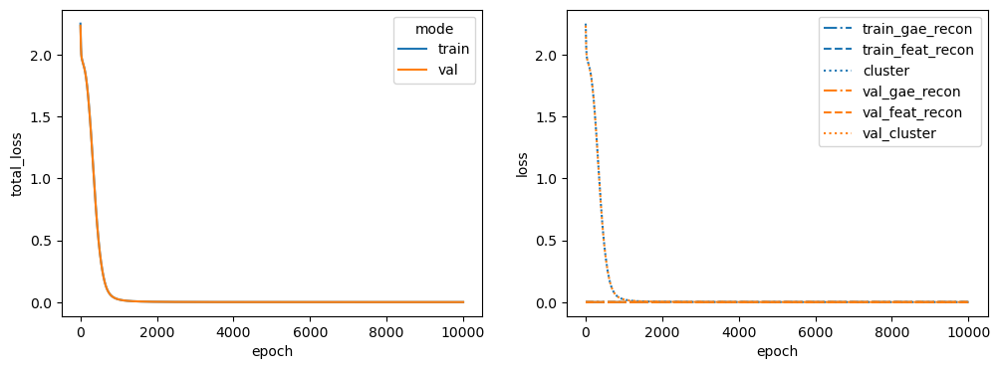

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


100%|██████████| 10000/10000 [03:33<00:00, 46.83it/s]


------------------------------------------------------------
TEST AUC: 0.5996825396825397 AP: 0.5552806721528516
TRAIN loss: 5.674962267221417e-06
VAL loss: 5.6718254199950024e-06
TEST loss: 0.015345928259193897
TEST AUC: 0.5996825396825397 	 AP: 0.5552806721528516


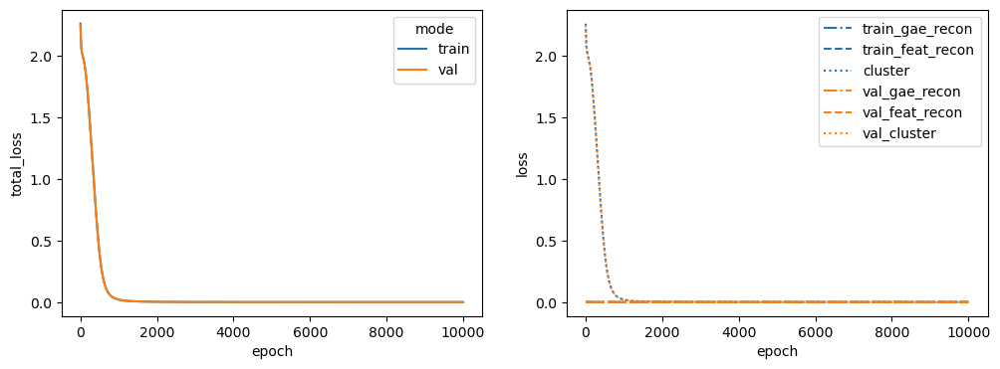

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


100%|██████████| 10000/10000 [03:33<00:00, 46.92it/s]


------------------------------------------------------------
TEST AUC: 0.5872562358276644 AP: 0.5478919119422772
TRAIN loss: 5.486736881721299e-06
VAL loss: 5.4835995797475334e-06
TEST loss: 0.026753384619951248
TEST AUC: 0.5872562358276644 	 AP: 0.5478919119422772


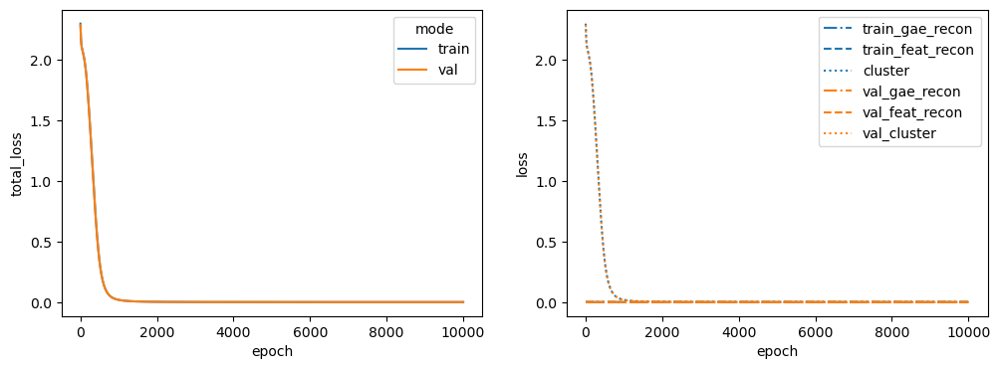

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


100%|██████████| 10000/10000 [03:33<00:00, 46.89it/s]


------------------------------------------------------------
TEST AUC: 0.5554195011337868 AP: 0.5295333789149246
TRAIN loss: 6.299232609308092e-06
VAL loss: 6.292958460107911e-06
TEST loss: 0.00172872981056571
TEST AUC: 0.5554195011337868 	 AP: 0.5295333789149246


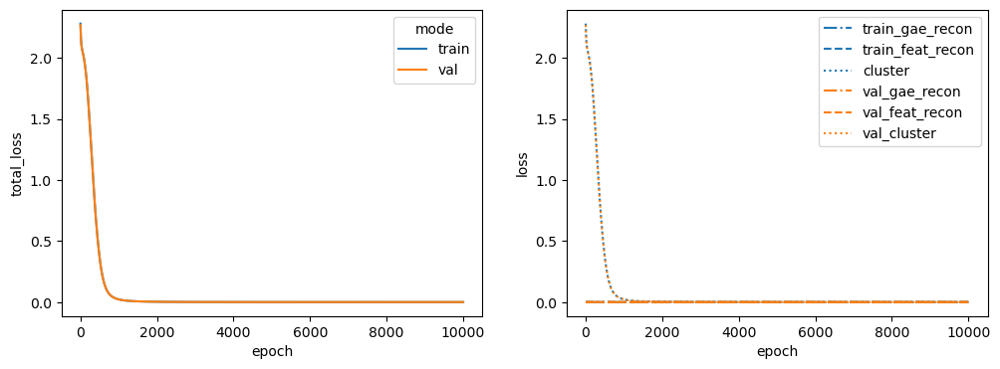

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


100%|██████████| 10000/10000 [03:33<00:00, 46.77it/s]


------------------------------------------------------------
TEST AUC: 0.5554648526077097 AP: 0.5288429226698879
TRAIN loss: 5.602808869298315e-06
VAL loss: 5.5996720220719e-06
TEST loss: 0.02399025484919548
TEST AUC: 0.5554648526077097 	 AP: 0.5288429226698879


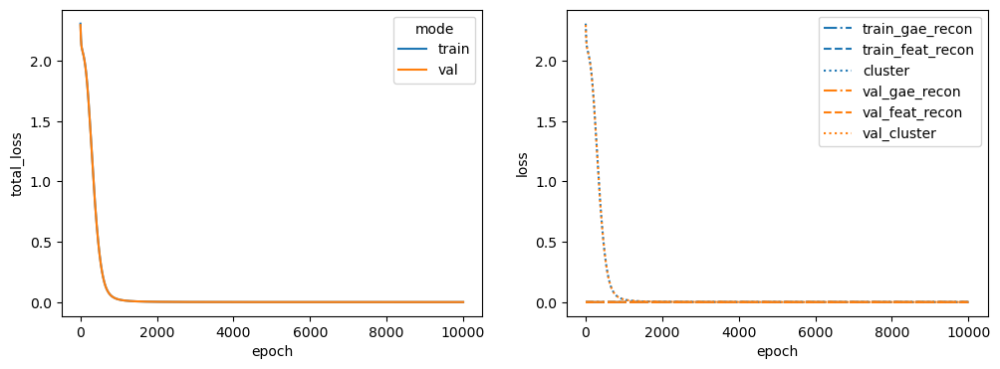

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


100%|██████████| 10000/10000 [03:34<00:00, 46.59it/s]


------------------------------------------------------------
TEST AUC: 0.567891156462585 AP: 0.5364921727218185
TRAIN loss: 6.01062356508919e-06
VAL loss: 6.00434941588901e-06
TEST loss: 0.00024409248726442456
TEST AUC: 0.567891156462585 	 AP: 0.5364921727218185


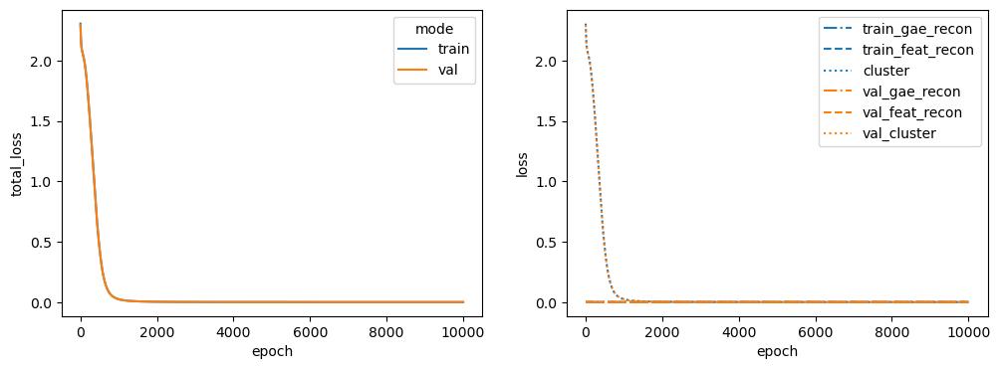

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


100%|██████████| 10000/10000 [03:33<00:00, 46.93it/s]


------------------------------------------------------------
TEST AUC: 0.5724716553287982 AP: 0.5397623060661763
TRAIN loss: 5.972984126856318e-06
VAL loss: 5.969846824882552e-06
TEST loss: 0.042913515120744705
TEST AUC: 0.5724716553287982 	 AP: 0.5397623060661763


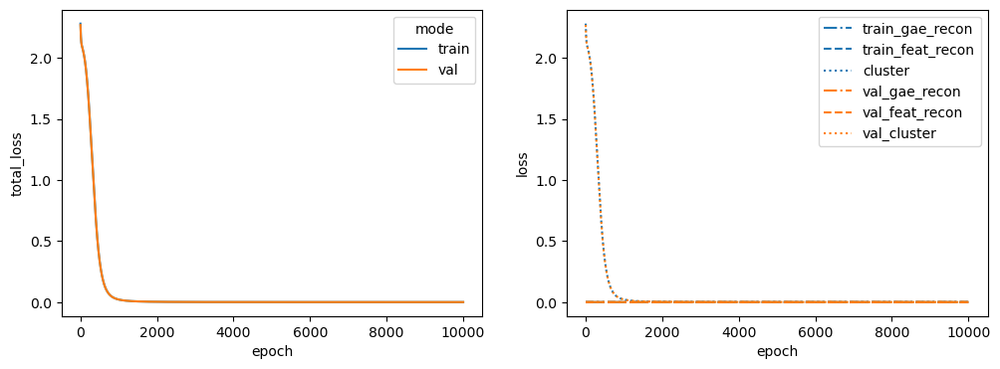

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


100%|██████████| 10000/10000 [03:34<00:00, 46.70it/s]


------------------------------------------------------------
TEST AUC: 0.5881179138321996 AP: 0.5484260467232016
TRAIN loss: 6.581567959074164e-06
VAL loss: 6.578430657100398e-06
TEST loss: 0.08440261334180832
TEST AUC: 0.5881179138321996 	 AP: 0.5484260467232016


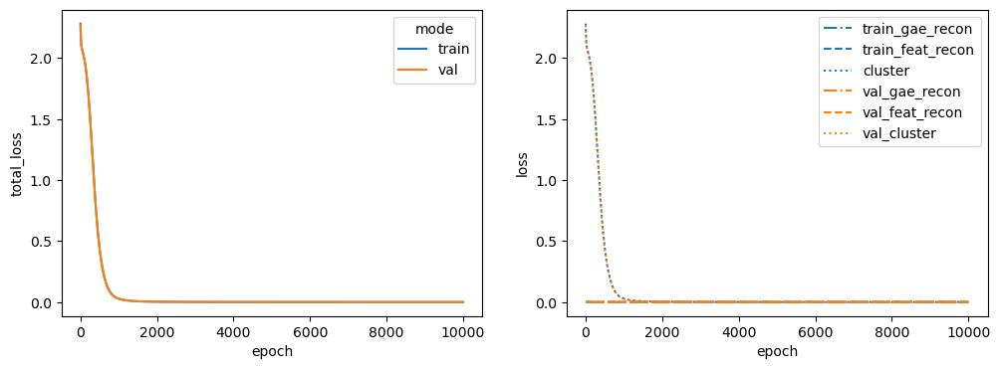

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


100%|██████████| 10000/10000 [03:34<00:00, 46.68it/s]


------------------------------------------------------------
TEST AUC: 0.5605895691609977 AP: 0.5325364139403331
TRAIN loss: 5.831814178236527e-06
VAL loss: 5.828676876262762e-06
TEST loss: 0.08986692130565643
TEST AUC: 0.5605895691609977 	 AP: 0.5325364139403331


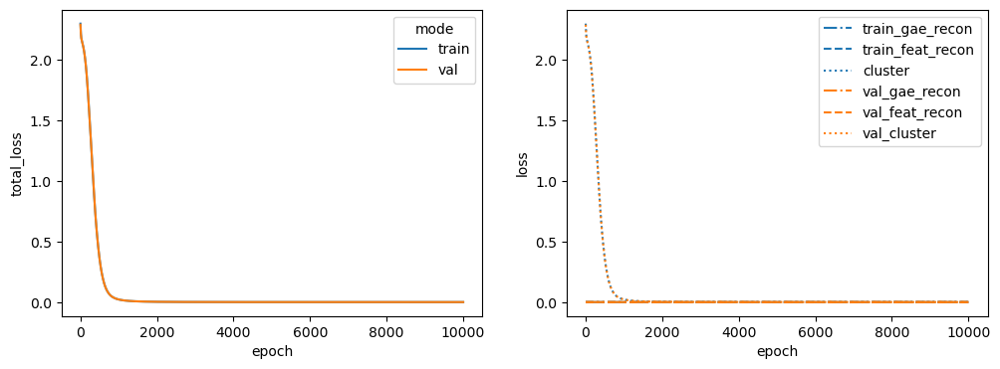

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


100%|██████████| 10000/10000 [03:33<00:00, 46.85it/s]


------------------------------------------------------------
TEST AUC: 0.5834467120181406 AP: 0.5453284067250111
TRAIN loss: 6.098462108639069e-06
VAL loss: 6.095325261412654e-06
TEST loss: 0.0029735472053289413
TEST AUC: 0.5834467120181406 	 AP: 0.5453284067250111


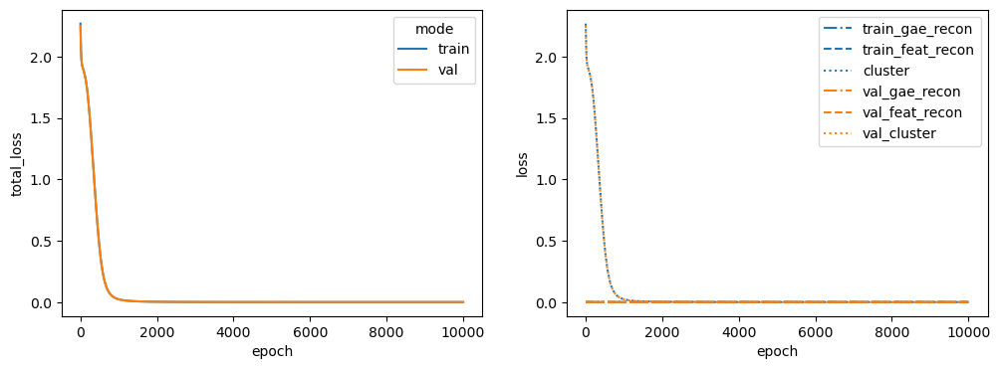

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


100%|██████████| 10000/10000 [03:36<00:00, 46.09it/s]


------------------------------------------------------------
TEST AUC: 0.6008616780045352 AP: 0.556374742712708
TRAIN loss: 5.981828053336358e-06
VAL loss: 5.975714884698391e-06
TEST loss: 0.002137501258403063
TEST AUC: 0.6008616780045352 	 AP: 0.556374742712708


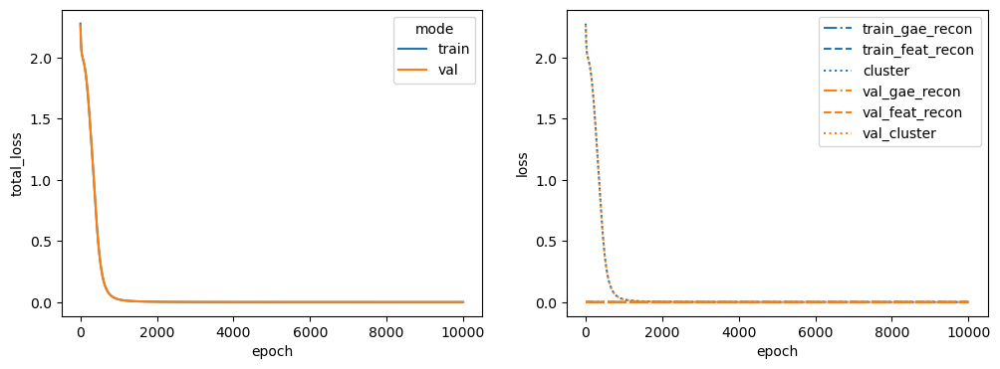

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


100%|██████████| 10000/10000 [03:33<00:00, 46.92it/s]


------------------------------------------------------------
TEST AUC: 0.54 AP: 0.5211405371159462
TRAIN loss: 6.236493845790392e-06
VAL loss: 6.230219696590211e-06
TEST loss: 0.17482014000415802
TEST AUC: 0.54 	 AP: 0.5211405371159462


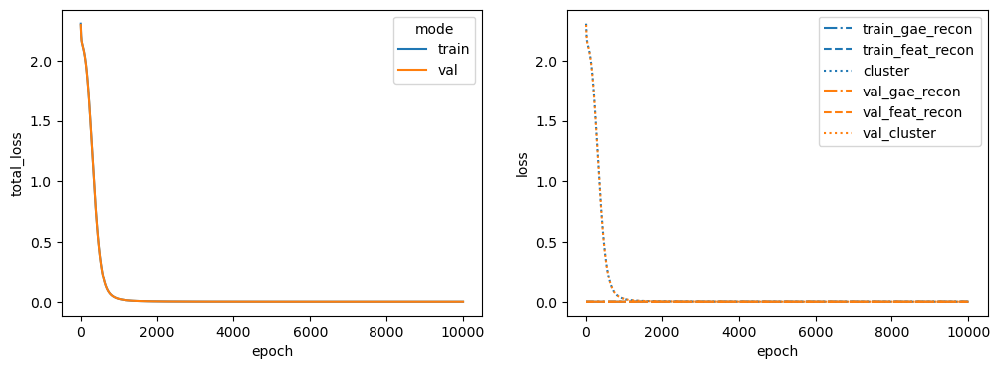

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


100%|██████████| 10000/10000 [03:32<00:00, 46.96it/s]


------------------------------------------------------------
TEST AUC: 0.5745124716553287 AP: 0.5399677850834876
TRAIN loss: 6.195709829626139e-06
VAL loss: 6.1925729823997244e-06
TEST loss: 0.0019501172937452793
TEST AUC: 0.5745124716553287 	 AP: 0.5399677850834876


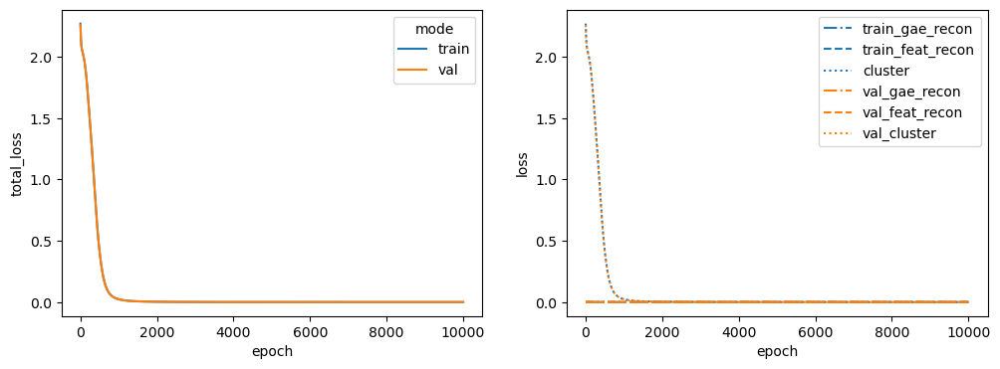

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


100%|██████████| 10000/10000 [03:32<00:00, 47.12it/s]


------------------------------------------------------------
TEST AUC: 0.5400453514739229 AP: 0.520130026855698
TRAIN loss: 5.508696176548256e-06
VAL loss: 5.496148332895245e-06
TEST loss: 0.0005471071344800293
TEST AUC: 0.5400453514739229 	 AP: 0.520130026855698


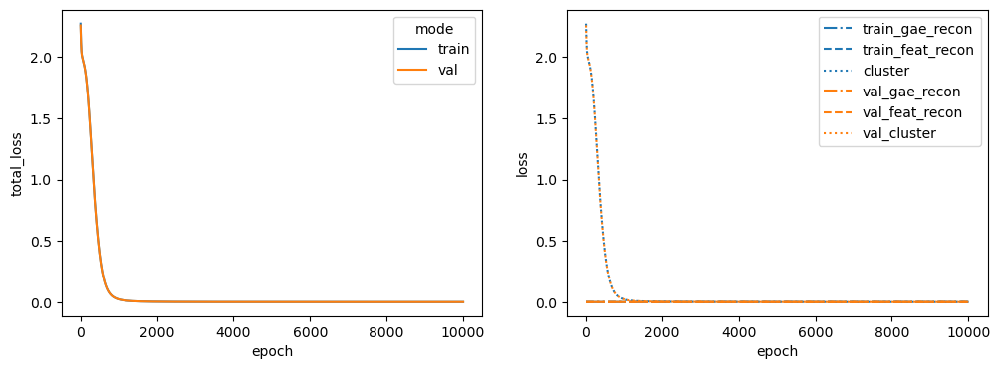

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


100%|██████████| 10000/10000 [03:33<00:00, 46.73it/s]


------------------------------------------------------------
TEST AUC: 0.6256235827664399 AP: 0.5733728353499475
TRAIN loss: 5.976116426609224e-06
VAL loss: 5.972979579382809e-06
TEST loss: 0.0004064152599312365
TEST AUC: 0.6256235827664399 	 AP: 0.5733728353499475


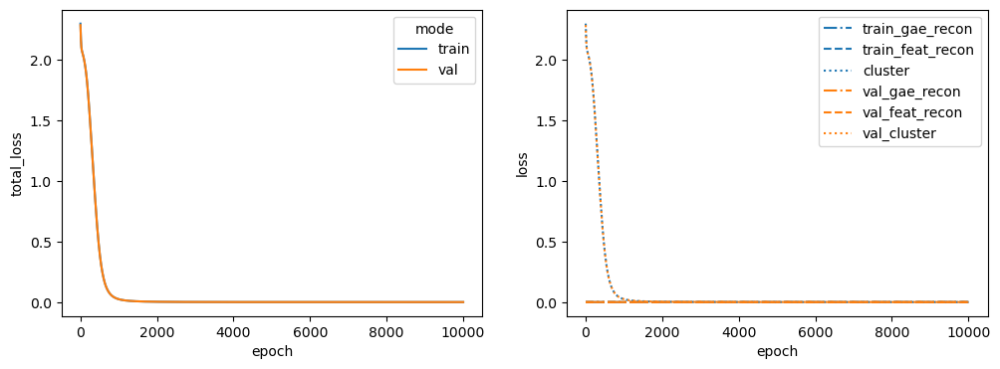

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


100%|██████████| 10000/10000 [03:35<00:00, 46.41it/s]


------------------------------------------------------------
TEST AUC: 0.6048072562358275 AP: 0.5588330907616756
TRAIN loss: 6.18315743849962e-06
VAL loss: 6.173746442073025e-06
TEST loss: 0.07833054661750793
TEST AUC: 0.6048072562358275 	 AP: 0.5588330907616756


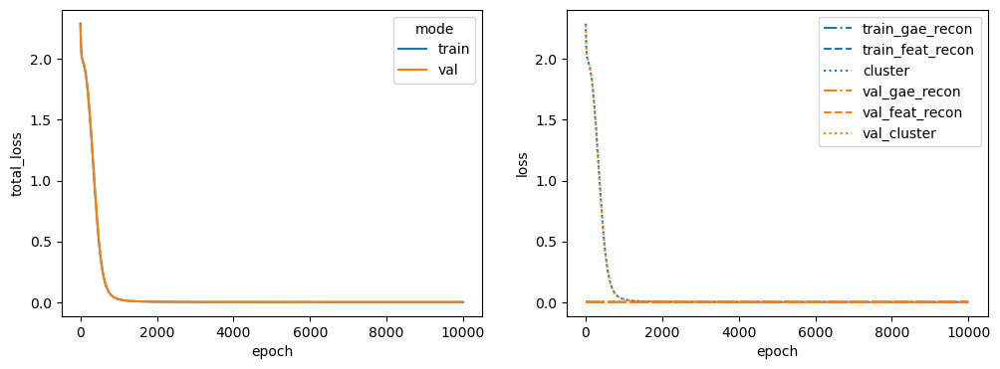

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


100%|██████████| 10000/10000 [03:33<00:00, 46.81it/s]


------------------------------------------------------------
TEST AUC: 0.5599546485260771 AP: 0.5321598455346878
TRAIN loss: 6.170612778078066e-06
VAL loss: 6.164338628877886e-06
TEST loss: 0.0985841155052185
TEST AUC: 0.5599546485260771 	 AP: 0.5321598455346878


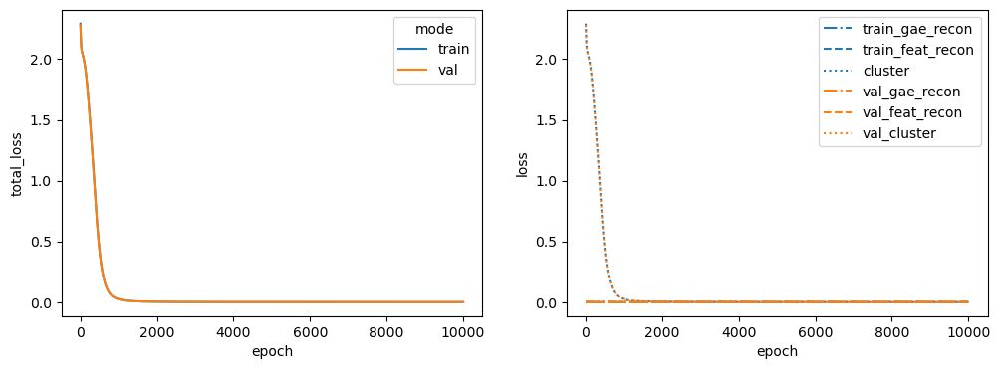

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


100%|██████████| 10000/10000 [03:35<00:00, 46.31it/s]


------------------------------------------------------------
TEST AUC: 0.5835374149659864 AP: 0.5457735713860753
TRAIN loss: 5.615358986688079e-06
VAL loss: 5.5996733863139525e-06
TEST loss: 0.004292336292564869
TEST AUC: 0.5835374149659864 	 AP: 0.5457735713860753


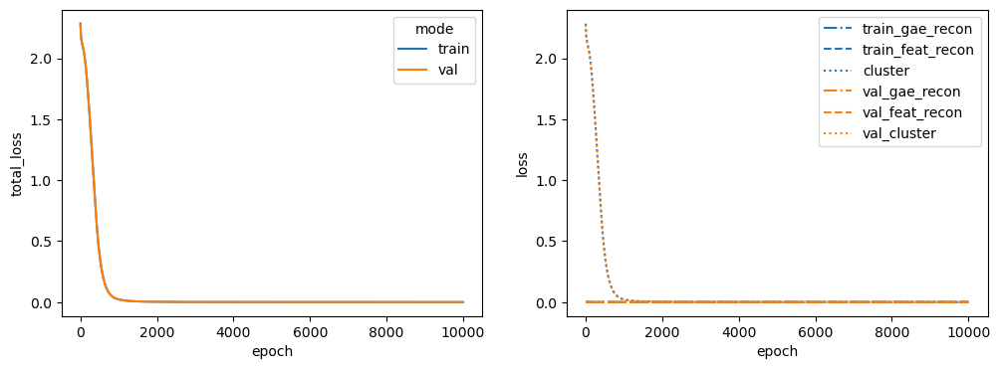

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


100%|██████████| 10000/10000 [03:33<00:00, 46.80it/s]


------------------------------------------------------------
TEST AUC: 0.607936507936508 AP: 0.5621731342787832
TRAIN loss: 6.236493845790392e-06
VAL loss: 6.230219696590211e-06
TEST loss: 0.06860421597957611
TEST AUC: 0.607936507936508 	 AP: 0.5621731342787832


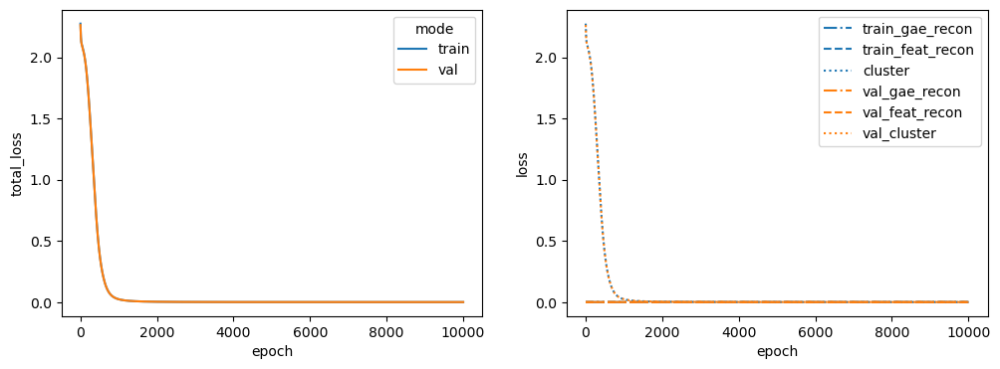

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


100%|██████████| 10000/10000 [03:32<00:00, 46.96it/s]


------------------------------------------------------------
TEST AUC: 0.6136054421768707 AP: 0.5643877277319074
TRAIN loss: 5.631040949083399e-06
VAL loss: 5.621629497909453e-06
TEST loss: 0.021755680441856384
TEST AUC: 0.6136054421768707 	 AP: 0.5643877277319074


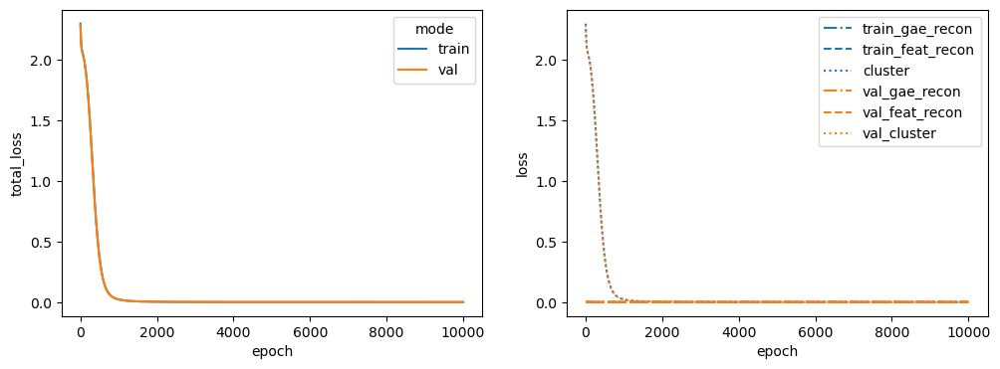

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


100%|██████████| 10000/10000 [03:37<00:00, 46.07it/s]


------------------------------------------------------------
TEST AUC: 0.6296598639455783 AP: 0.5763516575864039
TRAIN loss: 5.590257387666497e-06
VAL loss: 5.580845936492551e-06
TEST loss: 0.010920380242168903
TEST AUC: 0.6296598639455783 	 AP: 0.5763516575864039


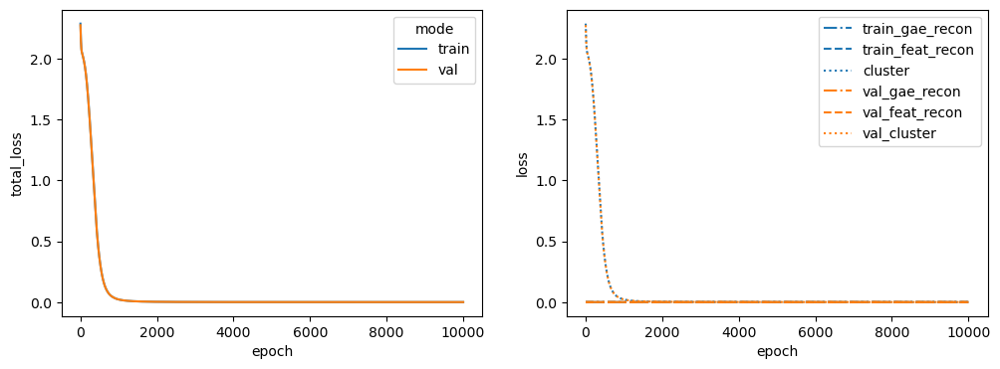

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


100%|██████████| 10000/10000 [03:33<00:00, 46.88it/s]


------------------------------------------------------------
TEST AUC: 0.61718820861678 AP: 0.5671681176323142
TRAIN loss: 6.349425348162185e-06
VAL loss: 6.343151198962005e-06
TEST loss: 0.0013062218204140663
TEST AUC: 0.61718820861678 	 AP: 0.5671681176323142


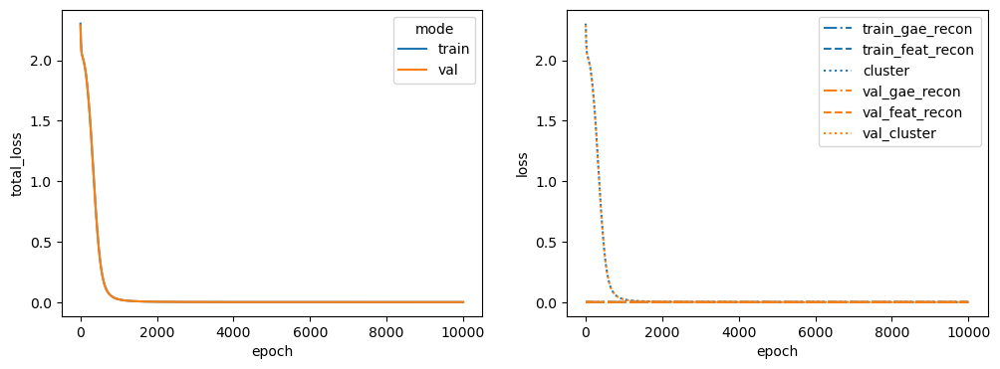

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


100%|██████████| 10000/10000 [03:33<00:00, 46.83it/s]


------------------------------------------------------------
TEST AUC: 0.5877551020408164 AP: 0.5491650851790607
TRAIN loss: 5.1667584557435475e-06
VAL loss: 5.163621608517133e-06
TEST loss: 0.058308977633714676
TEST AUC: 0.5877551020408164 	 AP: 0.5491650851790607


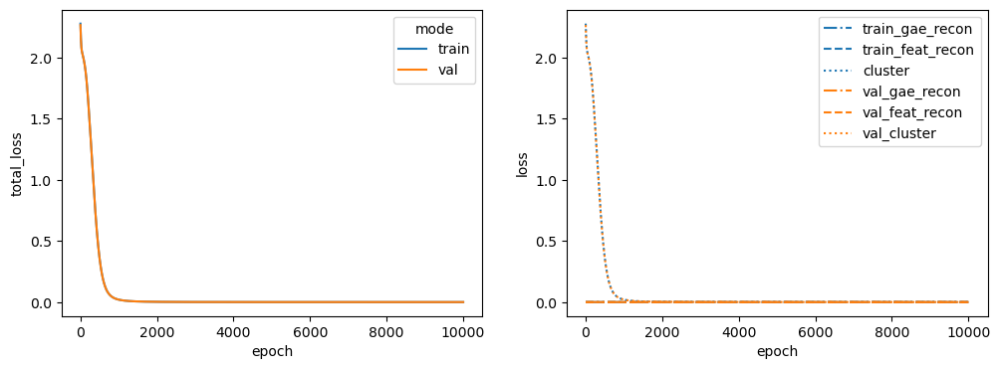

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


100%|██████████| 10000/10000 [03:36<00:00, 46.20it/s]


------------------------------------------------------------
TEST AUC: 0.644172335600907 AP: 0.5846684610869689
TRAIN loss: 5.615353529719869e-06
VAL loss: 5.609079380519688e-06
TEST loss: 0.07019465416669846
TEST AUC: 0.644172335600907 	 AP: 0.5846684610869689


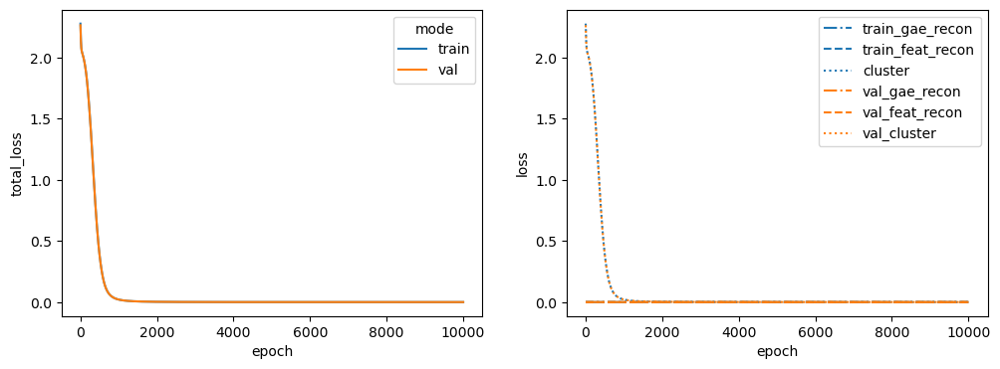

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


100%|██████████| 10000/10000 [03:35<00:00, 46.32it/s]


------------------------------------------------------------
TEST AUC: 0.6420408163265307 AP: 0.5833819290708102
TRAIN loss: 5.386351858760463e-06
VAL loss: 5.383215011534048e-06
TEST loss: 0.00015075266128405929
TEST AUC: 0.6420408163265307 	 AP: 0.5833819290708102


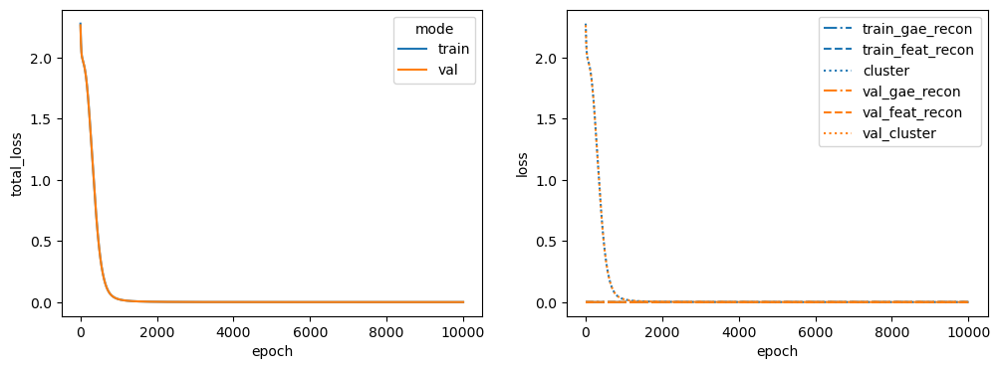

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 51%|█████     | 5097/10000 [01:45<01:41, 48.39it/s]


Training stopped after 5098 epochs
Best model found at epoch 4996
------------------------------------------------------------
TEST AUC: 0.8062585034013605 AP: 0.8425508234263275
TRAIN loss: 0.9458355903625488
VAL loss: 1.141000509262085
TEST loss: 1.2937088012695312
TEST AUC: 0.8062585034013605 	 AP: 0.8425508234263275


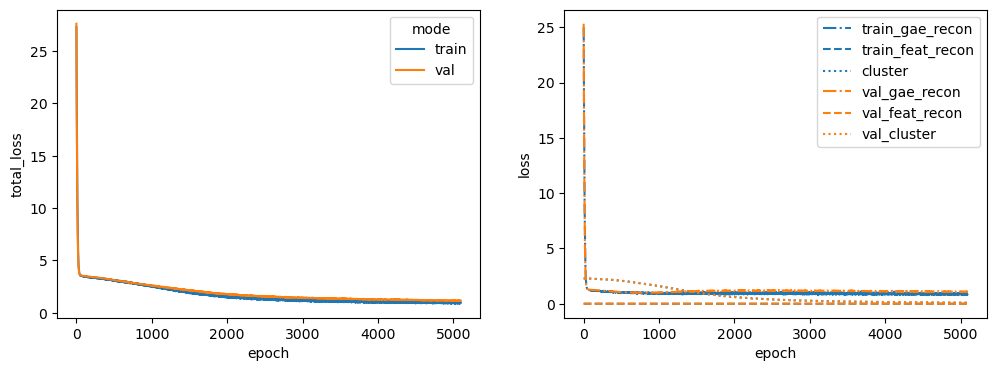

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 45%|████▍     | 4490/10000 [01:33<01:55, 47.88it/s]


Training stopped after 4491 epochs
Best model found at epoch 4389
------------------------------------------------------------
TEST AUC: 0.7999092970521542 AP: 0.8016219253232564
TRAIN loss: 0.9942922592163086
VAL loss: 1.2645206451416016
TEST loss: 1.378913164138794
TEST AUC: 0.7999092970521542 	 AP: 0.8016219253232564


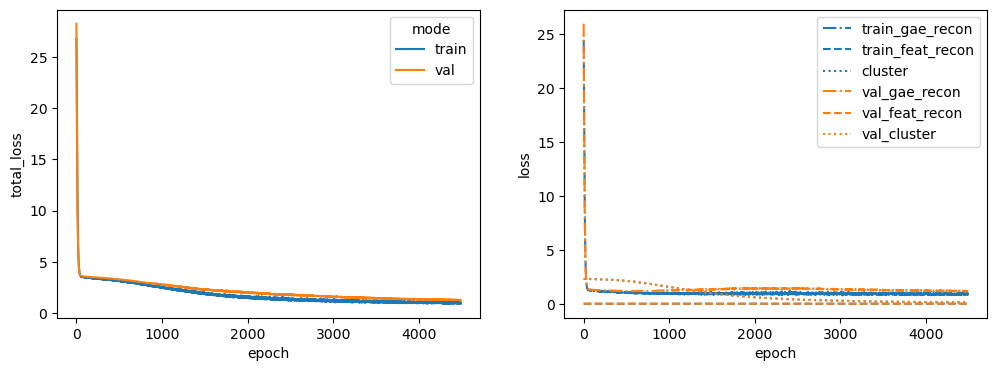

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 40%|███▉      | 3961/10000 [01:21<02:05, 48.31it/s]


Training stopped after 3962 epochs
Best model found at epoch 3860
------------------------------------------------------------
TEST AUC: 0.7873015873015874 AP: 0.7531156107293127
TRAIN loss: 1.0879826545715332
VAL loss: 1.6453496217727661
TEST loss: 1.6303269863128662
TEST AUC: 0.7873015873015874 	 AP: 0.7531156107293127


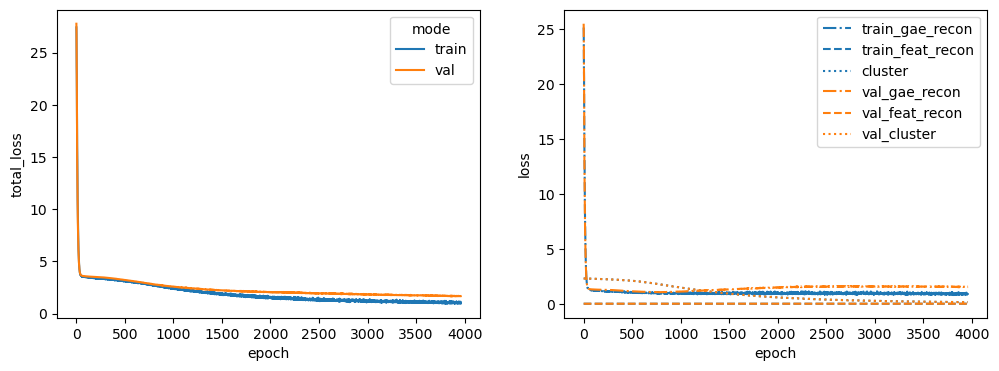

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 39%|███▉      | 3890/10000 [01:20<02:06, 48.25it/s]


Training stopped after 3891 epochs
Best model found at epoch 3789
------------------------------------------------------------
TEST AUC: 0.804172335600907 AP: 0.86328667889578
TRAIN loss: 1.0995078086853027
VAL loss: 1.3150838613510132
TEST loss: 1.382860779762268
TEST AUC: 0.804172335600907 	 AP: 0.86328667889578


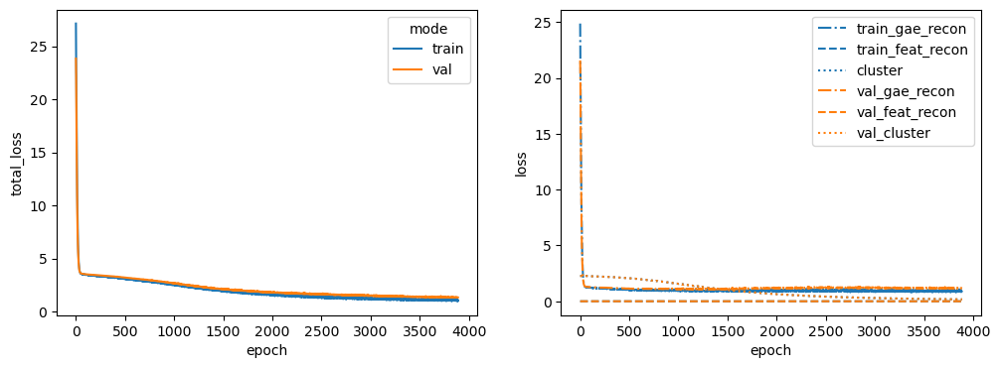

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 31%|███       | 3071/10000 [01:03<02:24, 48.02it/s]


Training stopped after 3072 epochs
Best model found at epoch 2970
------------------------------------------------------------
TEST AUC: 0.7983673469387755 AP: 0.8025421441020512
TRAIN loss: 1.1617960929870605
VAL loss: 1.5764892101287842
TEST loss: 1.530682921409607
TEST AUC: 0.7983673469387755 	 AP: 0.8025421441020512


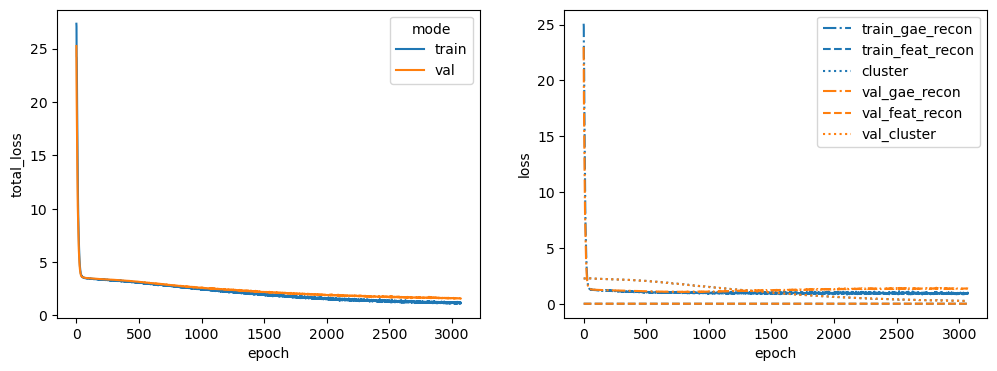

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 40%|████      | 4044/10000 [01:24<02:04, 47.90it/s]


Training stopped after 4045 epochs
Best model found at epoch 3943
------------------------------------------------------------
TEST AUC: 0.774421768707483 AP: 0.7689529891841032
TRAIN loss: 1.0100455284118652
VAL loss: 1.3468382358551025
TEST loss: 1.5680590867996216
TEST AUC: 0.774421768707483 	 AP: 0.7689529891841032


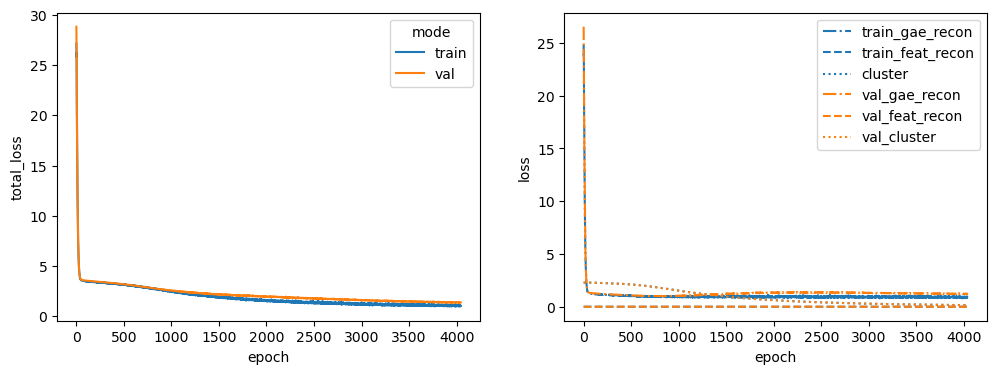

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 31%|███▏      | 3133/10000 [01:05<02:24, 47.51it/s]


Training stopped after 3134 epochs
Best model found at epoch 3032
------------------------------------------------------------
TEST AUC: 0.7745124716553289 AP: 0.777650821864761
TRAIN loss: 1.2063655853271484
VAL loss: 1.4947402477264404
TEST loss: 1.5608906745910645
TEST AUC: 0.7745124716553289 	 AP: 0.777650821864761


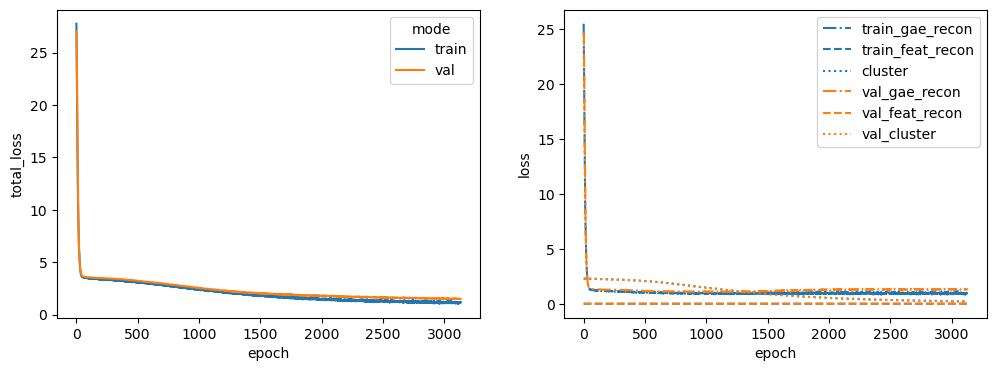

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 46%|████▌     | 4615/10000 [01:36<01:52, 47.66it/s]


Training stopped after 4616 epochs
Best model found at epoch 4514
------------------------------------------------------------
TEST AUC: 0.8055328798185941 AP: 0.8042034966696301
TRAIN loss: 0.9427896738052368
VAL loss: 1.2661693096160889
TEST loss: 1.348586082458496
TEST AUC: 0.8055328798185941 	 AP: 0.8042034966696301


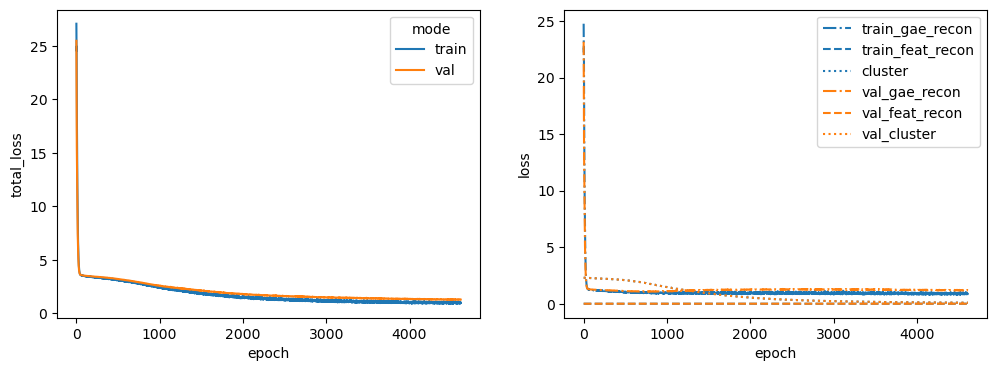

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 50%|█████     | 5027/10000 [01:46<01:45, 47.34it/s]


Training stopped after 5028 epochs
Best model found at epoch 4926
------------------------------------------------------------
TEST AUC: 0.8195011337868481 AP: 0.8657449373230154
TRAIN loss: 0.9921076893806458
VAL loss: 1.5667271614074707
TEST loss: 1.2169567346572876
TEST AUC: 0.8195011337868481 	 AP: 0.8657449373230154


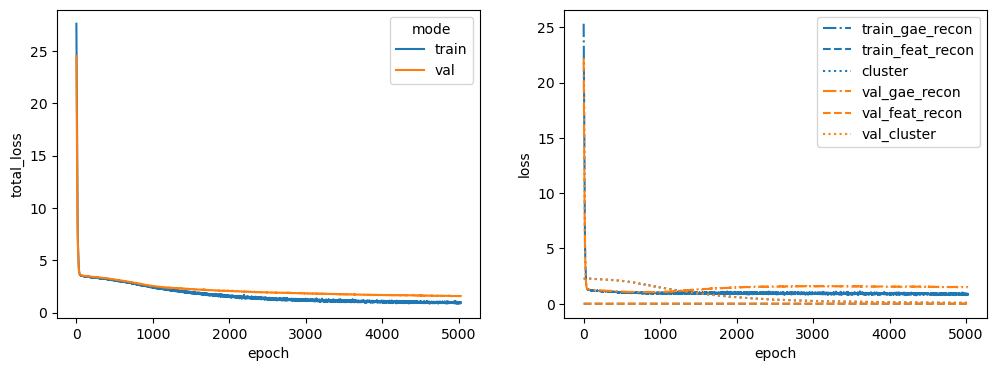

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 32%|███▏      | 3245/10000 [01:08<02:22, 47.44it/s]


Training stopped after 3246 epochs
Best model found at epoch 3144
------------------------------------------------------------
TEST AUC: 0.7758730158730159 AP: 0.8207335617539586
TRAIN loss: 1.2003753185272217
VAL loss: 1.675163745880127
TEST loss: 1.5500171184539795
TEST AUC: 0.7758730158730159 	 AP: 0.8207335617539586


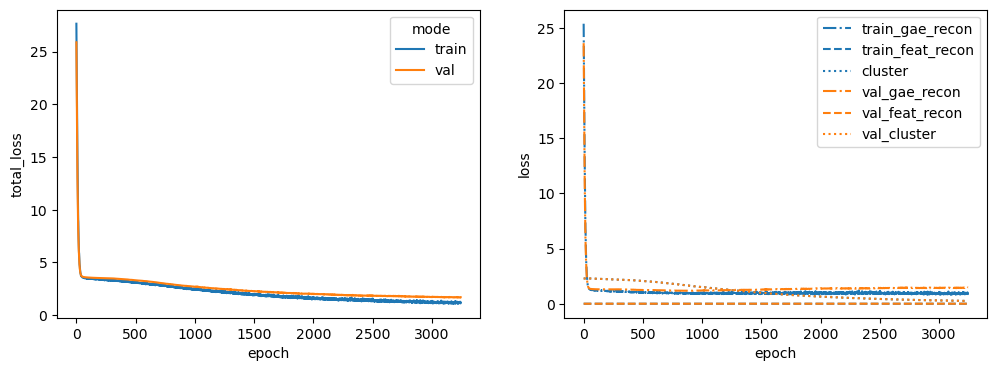

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 34%|███▍      | 3433/10000 [01:10<02:15, 48.54it/s]


Training stopped after 3434 epochs
Best model found at epoch 3332
------------------------------------------------------------
TEST AUC: 0.7743310657596371 AP: 0.7910697110670457
TRAIN loss: 1.087621808052063
VAL loss: 1.392750859260559
TEST loss: 1.5020933151245117
TEST AUC: 0.7743310657596371 	 AP: 0.7910697110670457


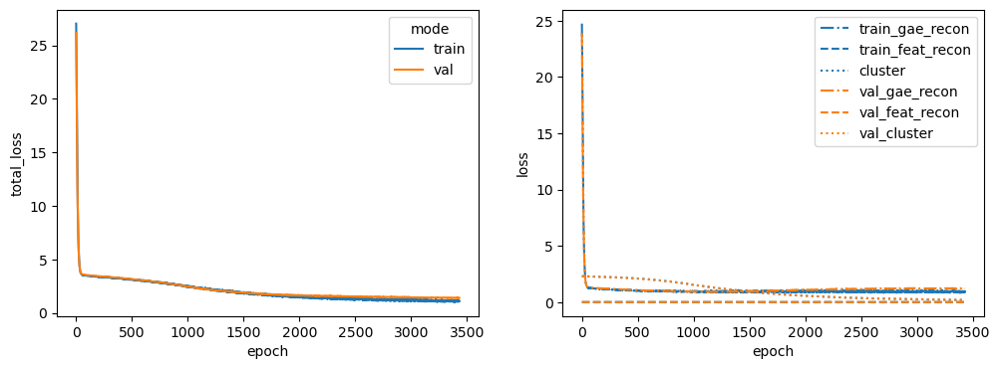

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 31%|███       | 3100/10000 [01:04<02:23, 48.12it/s]


Training stopped after 3101 epochs
Best model found at epoch 2999
------------------------------------------------------------
TEST AUC: 0.776235827664399 AP: 0.7954892208538278
TRAIN loss: 1.2017937898635864
VAL loss: 1.4631617069244385
TEST loss: 1.5752283334732056
TEST AUC: 0.776235827664399 	 AP: 0.7954892208538278


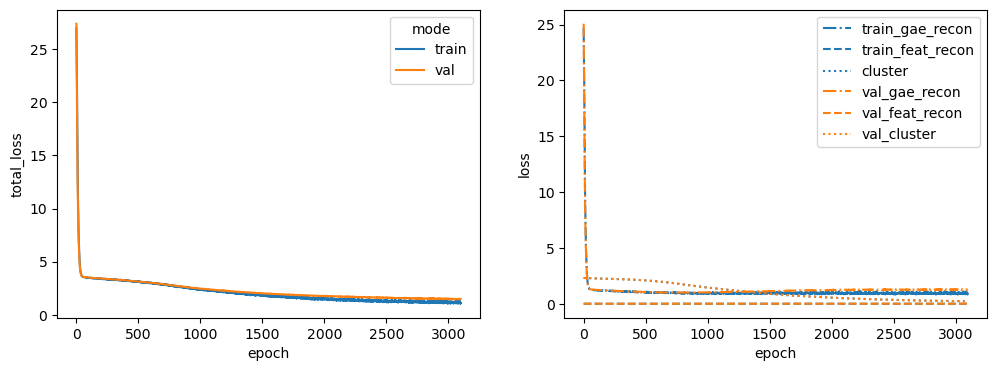

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 45%|████▌     | 4514/10000 [01:33<01:54, 48.04it/s]


Training stopped after 4515 epochs
Best model found at epoch 4413
------------------------------------------------------------
TEST AUC: 0.848344671201814 AP: 0.8677718330450228
TRAIN loss: 0.9815921187400818
VAL loss: 1.18357253074646
TEST loss: 1.1897766590118408
TEST AUC: 0.848344671201814 	 AP: 0.8677718330450228


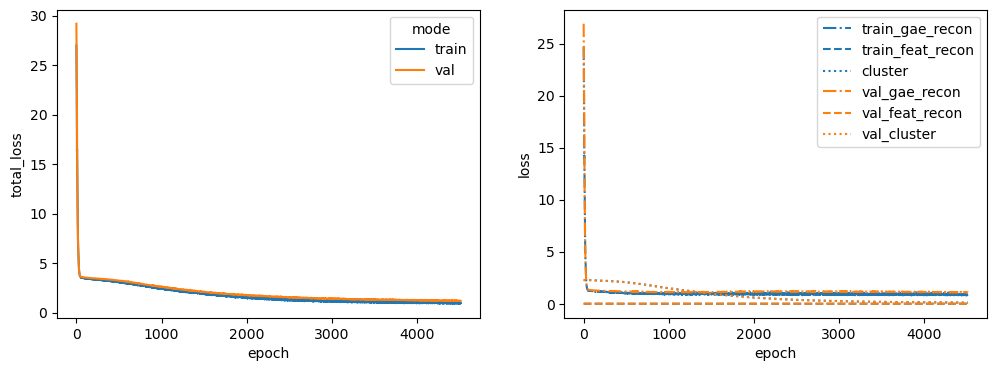

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 48%|████▊     | 4840/10000 [01:40<01:46, 48.39it/s]


Training stopped after 4841 epochs
Best model found at epoch 4739
------------------------------------------------------------
TEST AUC: 0.7636281179138321 AP: 0.7719497305795351
TRAIN loss: 0.8940760493278503
VAL loss: 1.208024501800537
TEST loss: 1.412513017654419
TEST AUC: 0.7636281179138321 	 AP: 0.7719497305795351


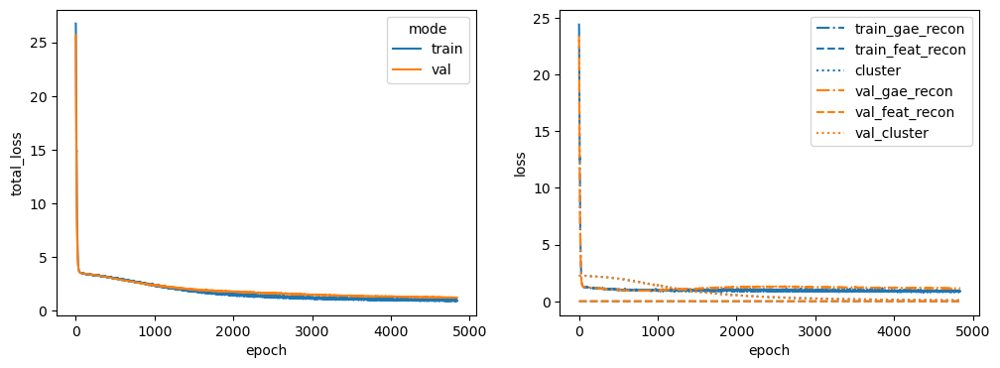

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 29%|██▉       | 2876/10000 [01:00<02:29, 47.55it/s]


Training stopped after 2877 epochs
Best model found at epoch 2775
------------------------------------------------------------
TEST AUC: 0.7963718820861678 AP: 0.8068986865645806
TRAIN loss: 1.1972241401672363
VAL loss: 1.7808187007904053
TEST loss: 1.6682326793670654
TEST AUC: 0.7963718820861678 	 AP: 0.8068986865645806


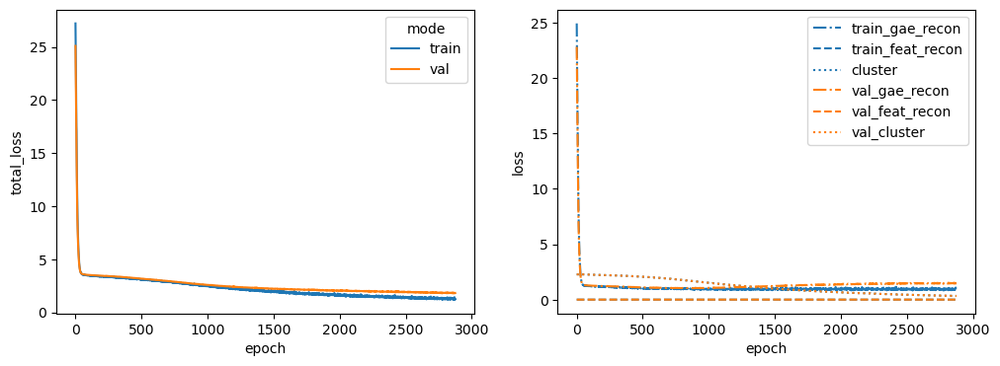

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 57%|█████▋    | 5727/10000 [01:59<01:29, 47.97it/s]


Training stopped after 5728 epochs
Best model found at epoch 5626
------------------------------------------------------------
TEST AUC: 0.8132426303854875 AP: 0.8044705358799964
TRAIN loss: 0.9008097648620605
VAL loss: 1.265378713607788
TEST loss: 1.326567530632019
TEST AUC: 0.8132426303854875 	 AP: 0.8044705358799964


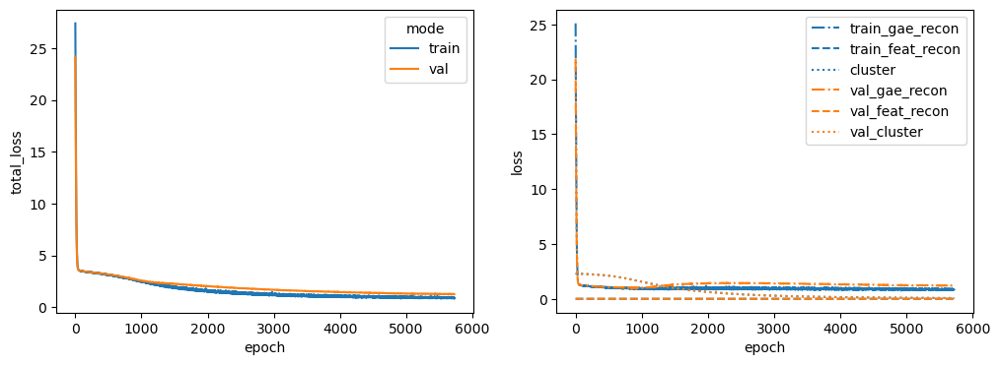

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 48%|████▊     | 4816/10000 [01:39<01:47, 48.23it/s]


Training stopped after 4817 epochs
Best model found at epoch 4715
------------------------------------------------------------
TEST AUC: 0.7922902494331066 AP: 0.7267121658478746
TRAIN loss: 0.9245073795318604
VAL loss: 1.1588919162750244
TEST loss: 1.5200384855270386
TEST AUC: 0.7922902494331066 	 AP: 0.7267121658478746


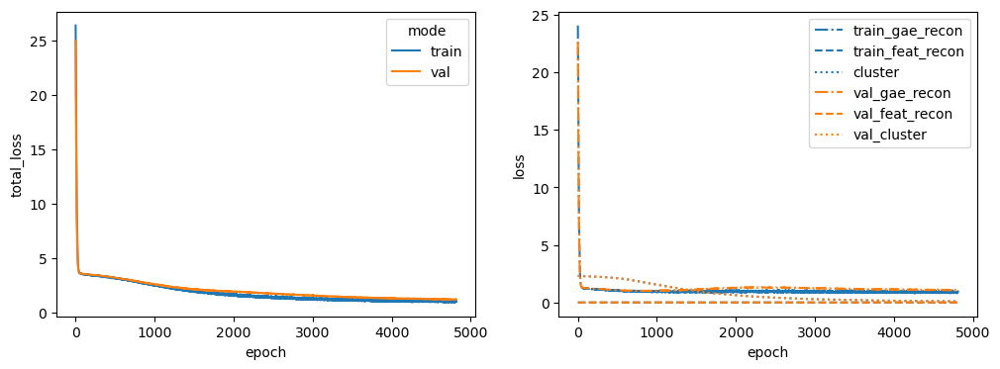

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 33%|███▎      | 3311/10000 [01:08<02:18, 48.24it/s]


Training stopped after 3312 epochs
Best model found at epoch 3210
------------------------------------------------------------
TEST AUC: 0.8115192743764171 AP: 0.8391977898284977
TRAIN loss: 1.0771210193634033
VAL loss: 1.4542573690414429
TEST loss: 1.3716228008270264
TEST AUC: 0.8115192743764171 	 AP: 0.8391977898284977


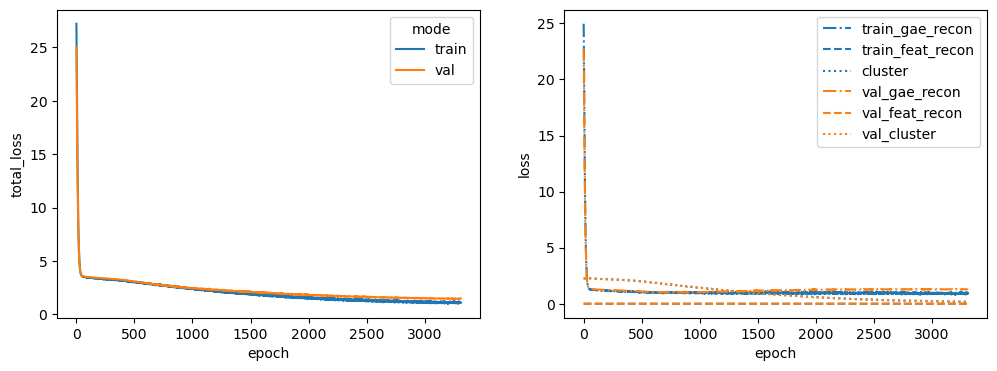

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 28%|██▊       | 2775/10000 [00:57<02:30, 48.03it/s]


Training stopped after 2776 epochs
Best model found at epoch 2674
------------------------------------------------------------
TEST AUC: 0.746938775510204 AP: 0.7505282094834272
TRAIN loss: 1.2617233991622925
VAL loss: 1.6269984245300293
TEST loss: 1.8403642177581787
TEST AUC: 0.746938775510204 	 AP: 0.7505282094834272


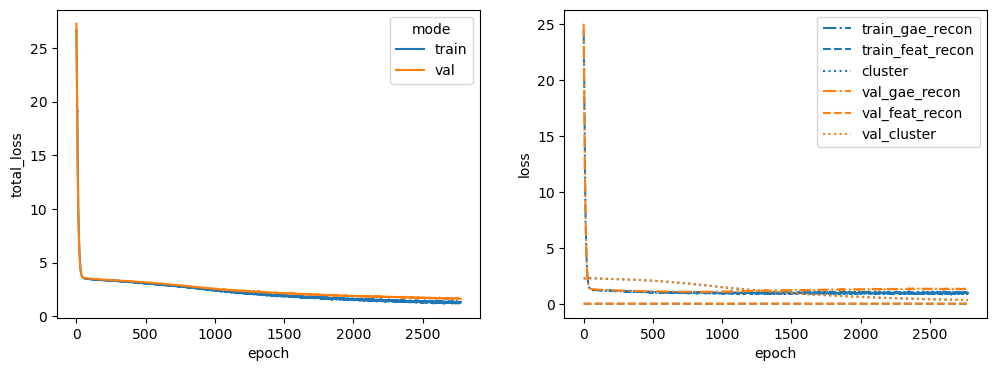

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 58%|█████▊    | 5837/10000 [01:59<01:25, 48.76it/s]


Training stopped after 5838 epochs
Best model found at epoch 5736
------------------------------------------------------------
TEST AUC: 0.7999092970521542 AP: 0.8278472834237353
TRAIN loss: 0.983539342880249
VAL loss: 1.3052767515182495
TEST loss: 1.2691967487335205
TEST AUC: 0.7999092970521542 	 AP: 0.8278472834237353


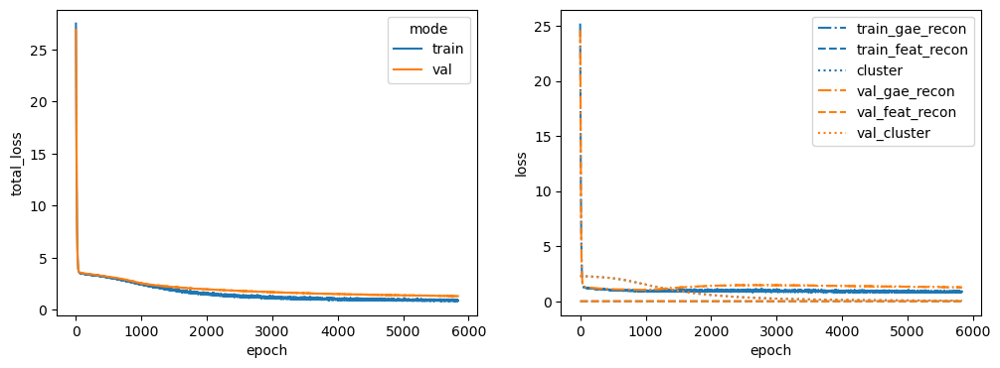

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 47%|████▋     | 4704/10000 [01:38<01:50, 47.98it/s]


Training stopped after 4705 epochs
Best model found at epoch 4603
------------------------------------------------------------
TEST AUC: 0.7746031746031745 AP: 0.7638368971982444
TRAIN loss: 0.959716260433197
VAL loss: 1.2166719436645508
TEST loss: 1.4320558309555054
TEST AUC: 0.7746031746031745 	 AP: 0.7638368971982444


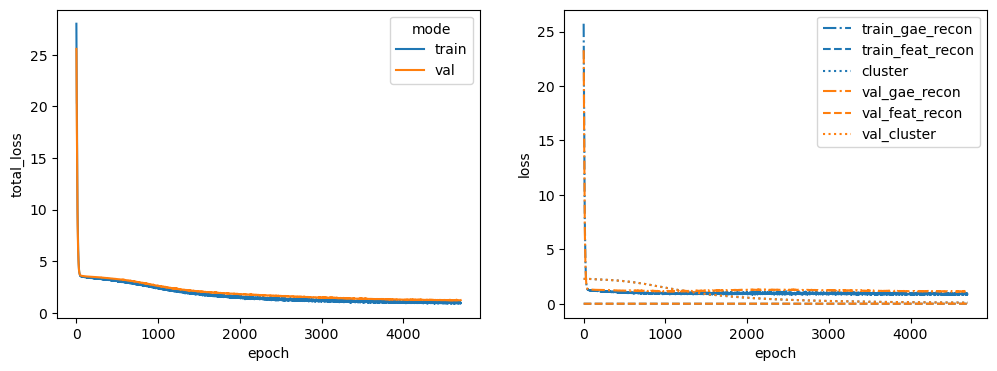

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 47%|████▋     | 4700/10000 [01:39<01:52, 47.13it/s]


Training stopped after 4701 epochs
Best model found at epoch 4599
------------------------------------------------------------
TEST AUC: 0.774875283446712 AP: 0.784893451414241
TRAIN loss: 0.9447816610336304
VAL loss: 1.2957887649536133
TEST loss: 1.4098798036575317
TEST AUC: 0.774875283446712 	 AP: 0.784893451414241


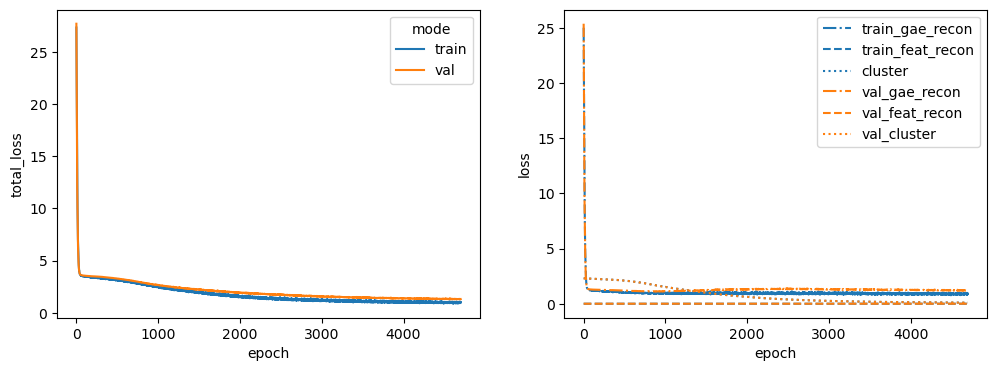

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 41%|████      | 4093/10000 [01:25<02:02, 48.11it/s]


Training stopped after 4094 epochs
Best model found at epoch 3992
------------------------------------------------------------
TEST AUC: 0.7969160997732426 AP: 0.7881751279549052
TRAIN loss: 1.0138988494873047
VAL loss: 1.442083477973938
TEST loss: 1.5124826431274414
TEST AUC: 0.7969160997732426 	 AP: 0.7881751279549052


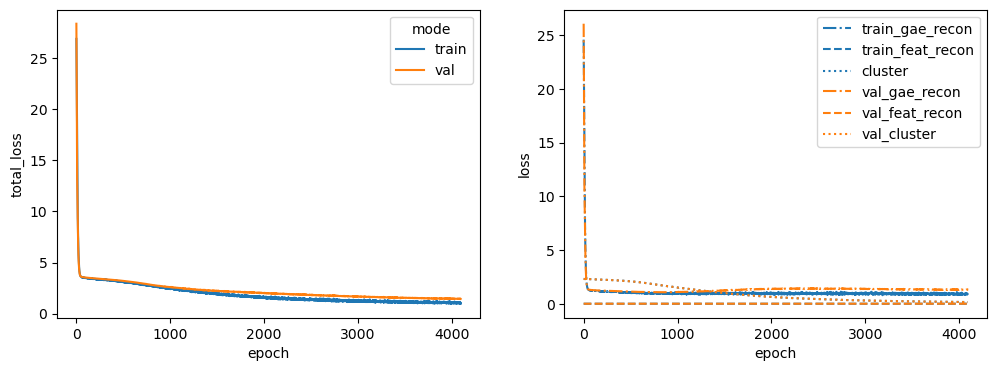

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 40%|████      | 4037/10000 [01:24<02:04, 48.02it/s]


Training stopped after 4038 epochs
Best model found at epoch 3936
------------------------------------------------------------
TEST AUC: 0.7871201814058958 AP: 0.8111124906038123
TRAIN loss: 1.0772461891174316
VAL loss: 1.2753362655639648
TEST loss: 1.3977611064910889
TEST AUC: 0.7871201814058958 	 AP: 0.8111124906038123


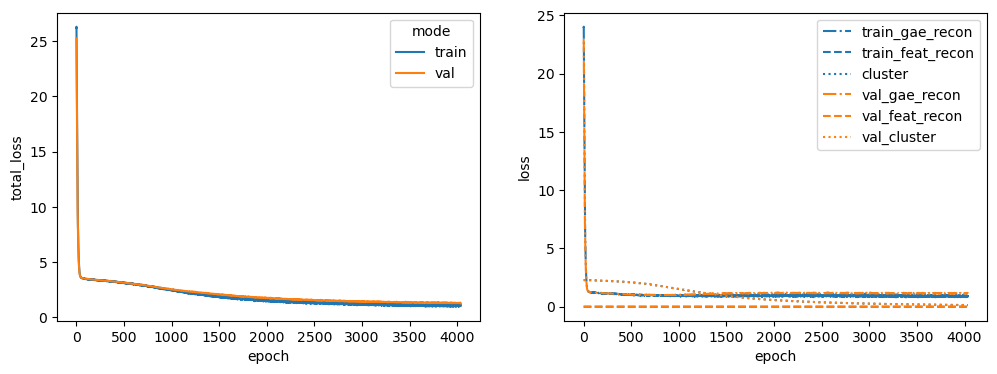

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 51%|█████▏    | 5125/10000 [01:46<01:41, 48.23it/s]


Training stopped after 5126 epochs
Best model found at epoch 5024
------------------------------------------------------------
TEST AUC: 0.8410884353741497 AP: 0.855249258273612
TRAIN loss: 1.0269007682800293
VAL loss: 1.2530277967453003
TEST loss: 1.2693883180618286
TEST AUC: 0.8410884353741497 	 AP: 0.855249258273612


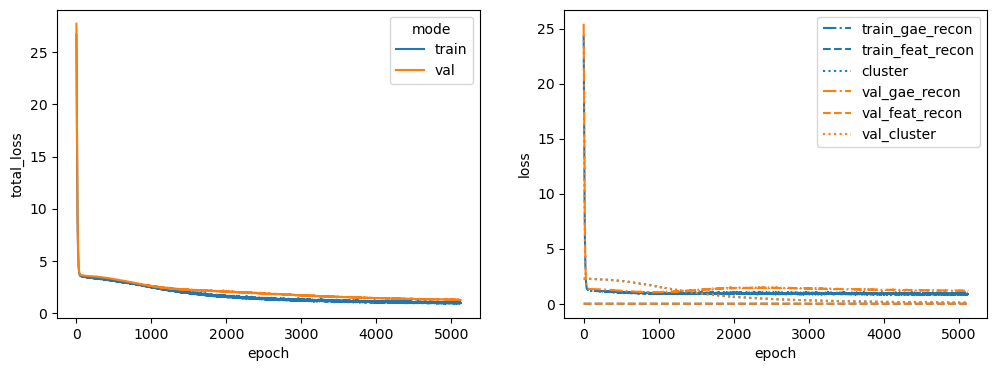

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 29%|██▉       | 2931/10000 [01:02<02:30, 46.89it/s]


Training stopped after 2932 epochs
Best model found at epoch 2830
------------------------------------------------------------
TEST AUC: 0.7662585034013605 AP: 0.7583063190993995
TRAIN loss: 1.2100830078125
VAL loss: 1.8039658069610596
TEST loss: 1.7330023050308228
TEST AUC: 0.7662585034013605 	 AP: 0.7583063190993995


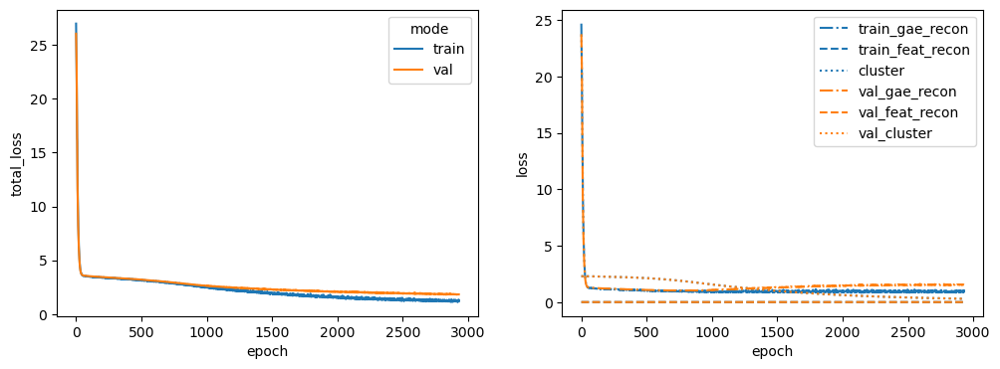

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 50%|████▉     | 4981/10000 [01:44<01:45, 47.46it/s]


Training stopped after 4982 epochs
Best model found at epoch 4880
------------------------------------------------------------
TEST AUC: 0.7835827664399093 AP: 0.7793090897650415
TRAIN loss: 0.939778208732605
VAL loss: 1.1759788990020752
TEST loss: 1.383142352104187
TEST AUC: 0.7835827664399093 	 AP: 0.7793090897650415


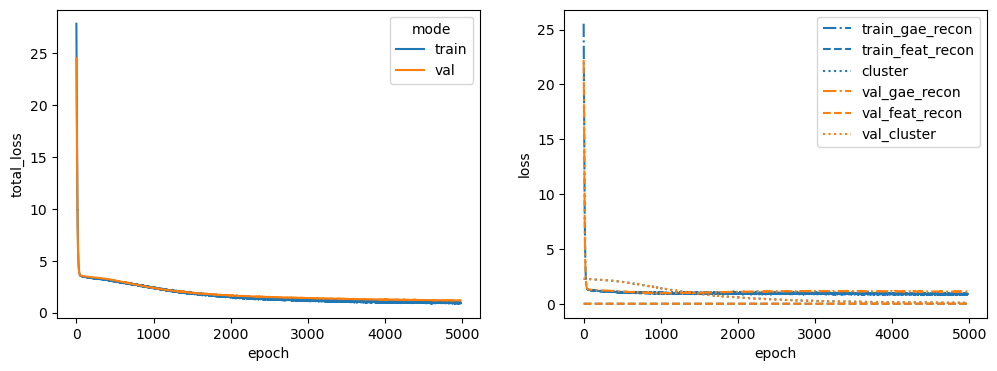

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 48%|████▊     | 4776/10000 [01:40<01:49, 47.67it/s]


Training stopped after 4777 epochs
Best model found at epoch 4675
------------------------------------------------------------
TEST AUC: 0.8198639455782314 AP: 0.852653543881549
TRAIN loss: 1.0454087257385254
VAL loss: 1.3285083770751953
TEST loss: 1.2589975595474243
TEST AUC: 0.8198639455782314 	 AP: 0.852653543881549


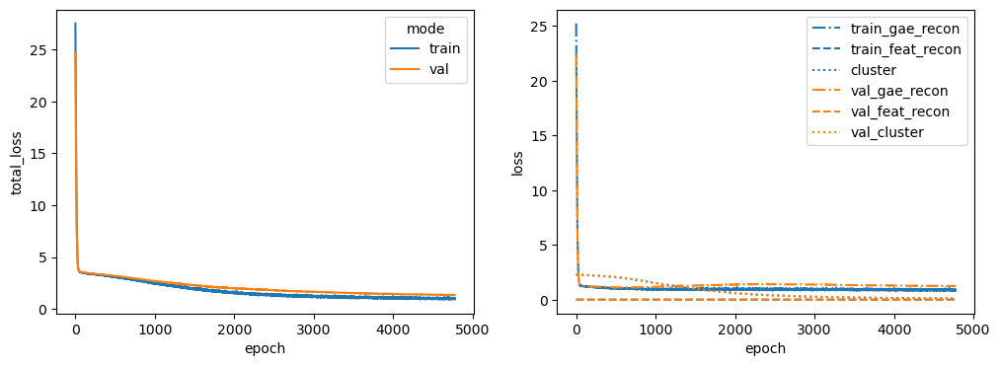

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 35%|███▍      | 3497/10000 [01:13<02:16, 47.80it/s]


Training stopped after 3498 epochs
Best model found at epoch 3396
------------------------------------------------------------
TEST AUC: 0.7751473922902495 AP: 0.7907560141617287
TRAIN loss: 1.0922539234161377
VAL loss: 1.3476479053497314
TEST loss: 1.4660605192184448
TEST AUC: 0.7751473922902495 	 AP: 0.7907560141617287


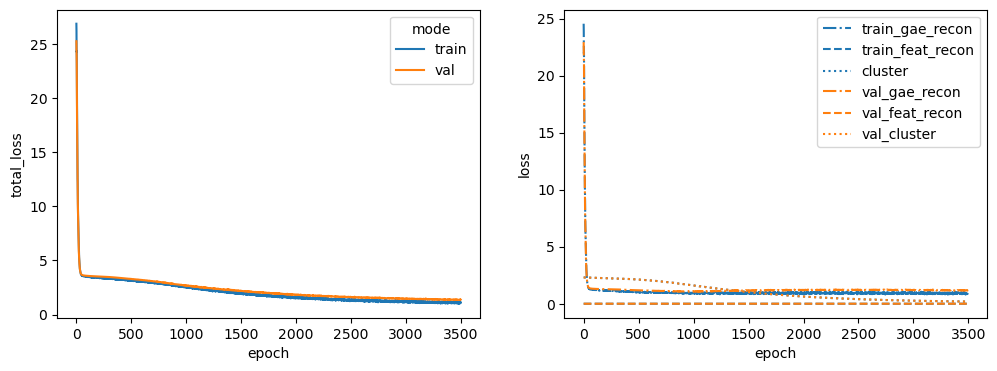

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 49%|████▉     | 4897/10000 [01:40<01:45, 48.54it/s]


Training stopped after 4898 epochs
Best model found at epoch 4796
------------------------------------------------------------
TEST AUC: 0.8052607709750568 AP: 0.8209986444782172
TRAIN loss: 0.9515920877456665
VAL loss: 1.3470871448516846
TEST loss: 1.34209406375885
TEST AUC: 0.8052607709750568 	 AP: 0.8209986444782172


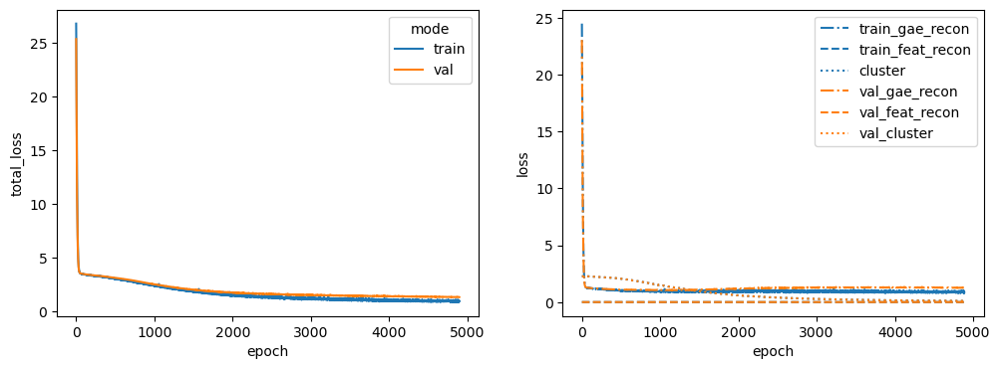

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 41%|████      | 4116/10000 [01:25<02:01, 48.35it/s]


Training stopped after 4117 epochs
Best model found at epoch 4015
------------------------------------------------------------
TEST AUC: 0.8198639455782313 AP: 0.8270779382730546
TRAIN loss: 1.0205837488174438
VAL loss: 1.4200774431228638
TEST loss: 1.3385040760040283
TEST AUC: 0.8198639455782313 	 AP: 0.8270779382730546


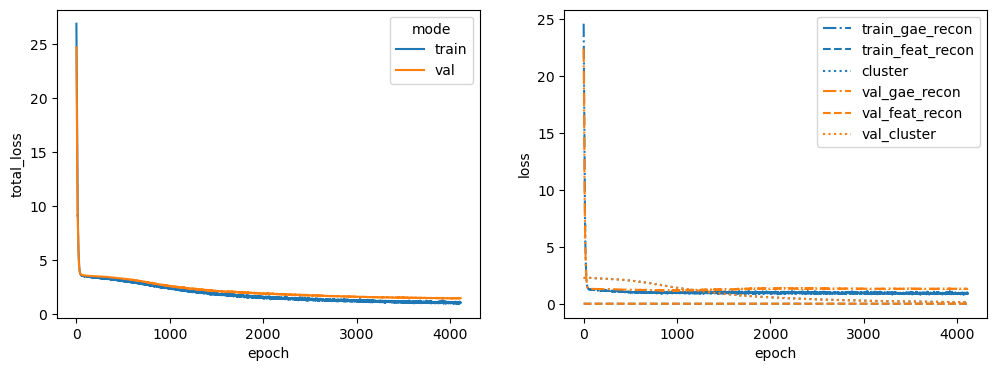

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 24%|██▍       | 2428/10000 [00:50<02:37, 48.21it/s]


Training stopped after 2429 epochs
Best model found at epoch 2327
------------------------------------------------------------
TEST AUC: 0.8087981859410431 AP: 0.8159639541681998
TRAIN loss: 1.416054129600525
VAL loss: 1.5619910955429077
TEST loss: 1.699263095855713
TEST AUC: 0.8087981859410431 	 AP: 0.8159639541681998


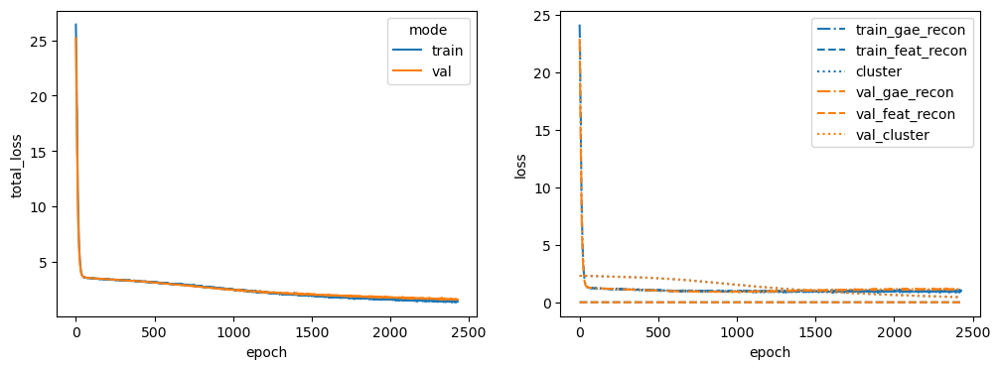

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 44%|████▎     | 4374/10000 [01:30<01:56, 48.34it/s]


Training stopped after 4375 epochs
Best model found at epoch 4273
------------------------------------------------------------
TEST AUC: 0.8161451247165533 AP: 0.8185620596283969
TRAIN loss: 1.0650261640548706
VAL loss: 1.2610468864440918
TEST loss: 1.3779995441436768
TEST AUC: 0.8161451247165533 	 AP: 0.8185620596283969


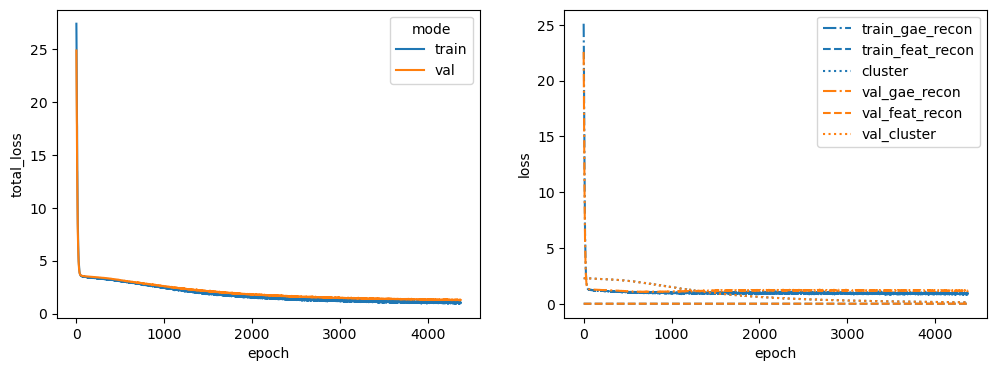

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 36%|███▌      | 3582/10000 [01:15<02:15, 47.21it/s]


Training stopped after 3583 epochs
Best model found at epoch 3481
------------------------------------------------------------
TEST AUC: 0.7884807256235828 AP: 0.7931589591534007
TRAIN loss: 1.133882761001587
VAL loss: 1.327866792678833
TEST loss: 1.536024570465088
TEST AUC: 0.7884807256235828 	 AP: 0.7931589591534007


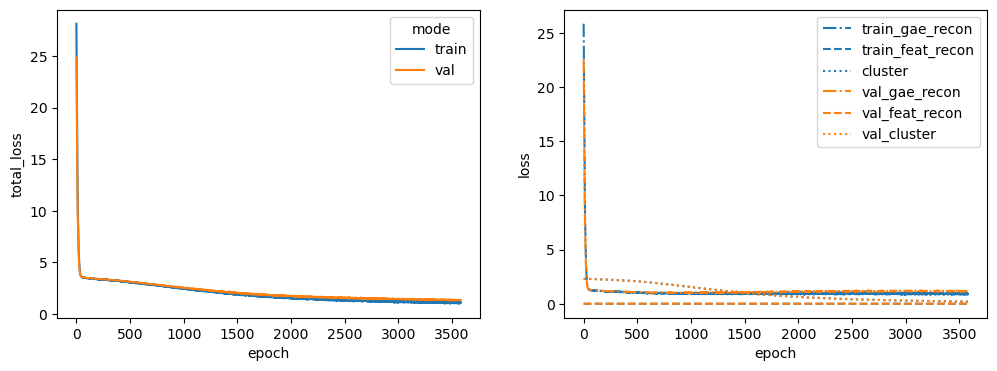

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 44%|████▎     | 4373/10000 [01:29<01:55, 48.91it/s]


Training stopped after 4374 epochs
Best model found at epoch 4272
------------------------------------------------------------
TEST AUC: 0.8404535147392291 AP: 0.8541175056557608
TRAIN loss: 1.0130362510681152
VAL loss: 1.2188924551010132
TEST loss: 1.2383853197097778
TEST AUC: 0.8404535147392291 	 AP: 0.8541175056557608


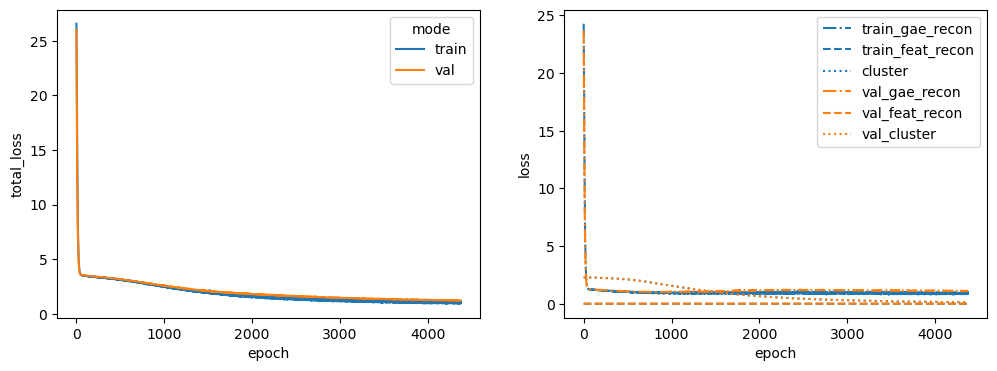

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 46%|████▌     | 4600/10000 [01:35<01:51, 48.37it/s]


Training stopped after 4601 epochs
Best model found at epoch 4499
------------------------------------------------------------
TEST AUC: 0.8149659863945579 AP: 0.81472859209925
TRAIN loss: 0.9447211623191833
VAL loss: 1.3371599912643433
TEST loss: 1.3200621604919434
TEST AUC: 0.8149659863945579 	 AP: 0.81472859209925


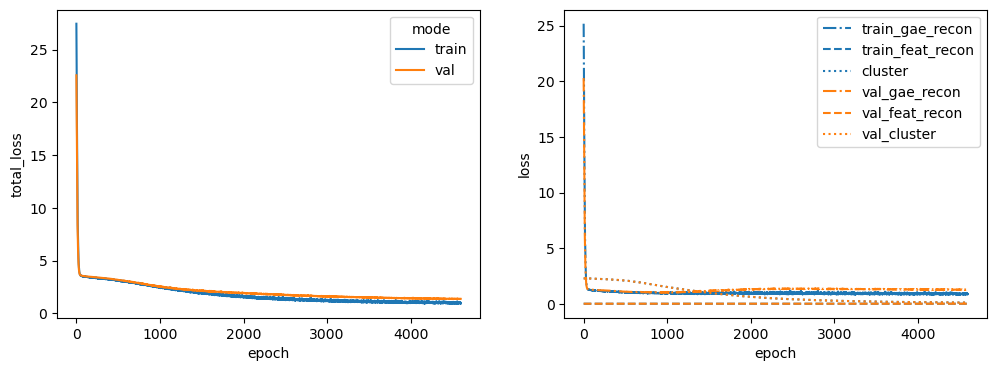

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 29%|██▉       | 2898/10000 [01:01<02:30, 47.20it/s]


Training stopped after 2899 epochs
Best model found at epoch 2797
------------------------------------------------------------
TEST AUC: 0.8472562358276643 AP: 0.8647548721351376
TRAIN loss: 1.1788512468338013
VAL loss: 1.8017497062683105
TEST loss: 1.3971562385559082
TEST AUC: 0.8472562358276643 	 AP: 0.8647548721351376


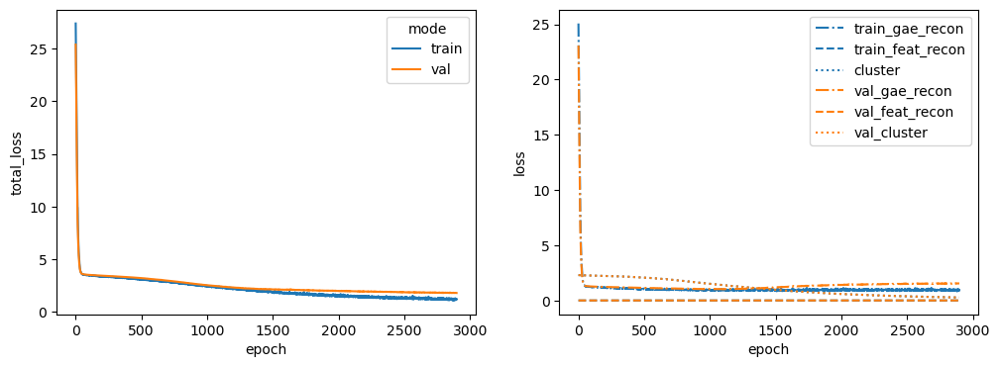

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 42%|████▏     | 4159/10000 [01:25<02:00, 48.60it/s]


Training stopped after 4160 epochs
Best model found at epoch 4058
------------------------------------------------------------
TEST AUC: 0.8132426303854876 AP: 0.8104734245556111
TRAIN loss: 1.0510261058807373
VAL loss: 1.2693166732788086
TEST loss: 1.384250283241272
TEST AUC: 0.8132426303854876 	 AP: 0.8104734245556111


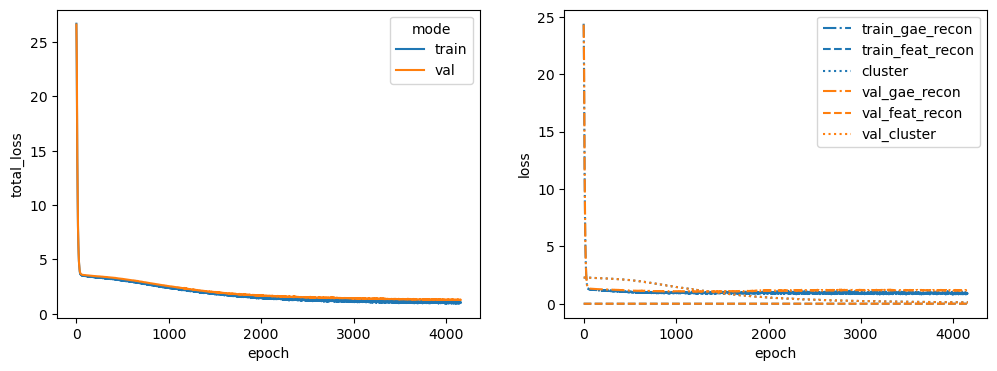

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 35%|███▌      | 3504/10000 [01:12<02:15, 48.02it/s]


Training stopped after 3505 epochs
Best model found at epoch 3403
------------------------------------------------------------
TEST AUC: 0.8203628117913833 AP: 0.8227042496421872
TRAIN loss: 1.1573131084442139
VAL loss: 1.5508671998977661
TEST loss: 1.3848282098770142
TEST AUC: 0.8203628117913833 	 AP: 0.8227042496421872


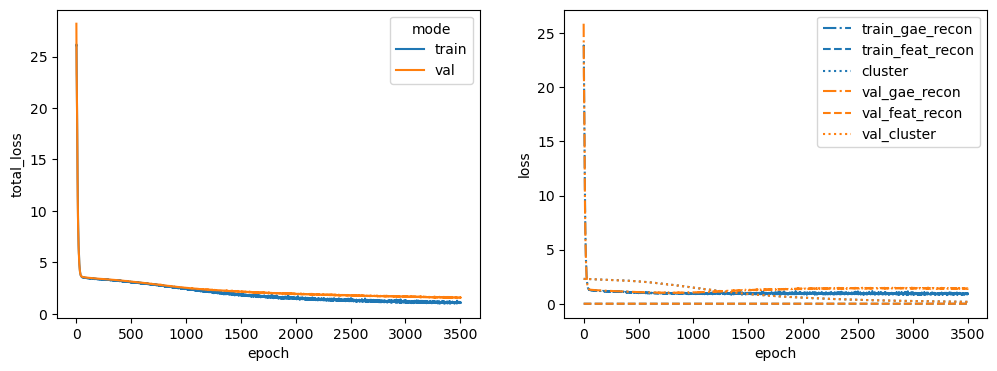

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 34%|███▍      | 3393/10000 [01:11<02:18, 47.64it/s]


Training stopped after 3394 epochs
Best model found at epoch 3292
------------------------------------------------------------
TEST AUC: 0.811609977324263 AP: 0.8351040853389703
TRAIN loss: 1.1333576440811157
VAL loss: 1.5241434574127197
TEST loss: 1.4188777208328247
TEST AUC: 0.811609977324263 	 AP: 0.8351040853389703


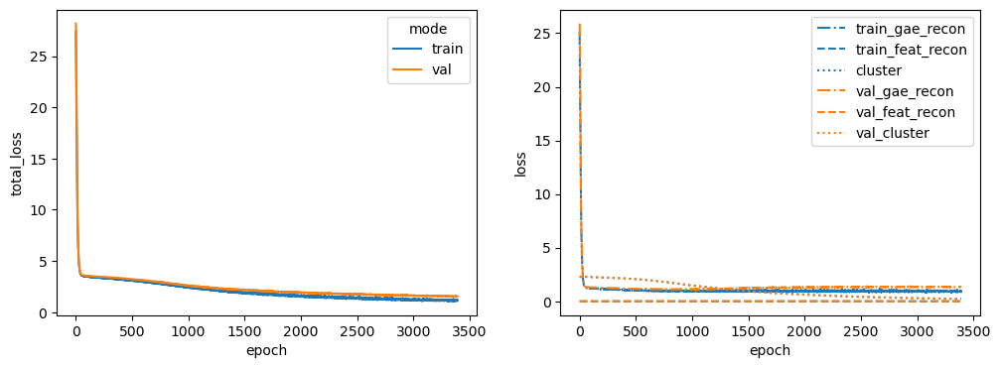

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 36%|███▋      | 3644/10000 [01:16<02:13, 47.64it/s]


Training stopped after 3645 epochs
Best model found at epoch 3543
------------------------------------------------------------
TEST AUC: 0.7937414965986395 AP: 0.7676427640359434
TRAIN loss: 1.1253013610839844
VAL loss: 1.274559497833252
TEST loss: 1.6024439334869385
TEST AUC: 0.7937414965986395 	 AP: 0.7676427640359434


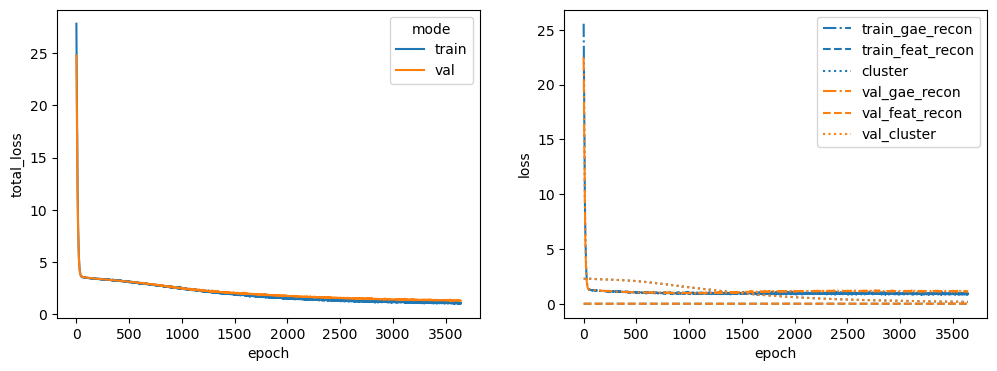

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 35%|███▍      | 3454/10000 [01:12<02:17, 47.62it/s]


Training stopped after 3455 epochs
Best model found at epoch 3353
------------------------------------------------------------
TEST AUC: 0.7898412698412698 AP: 0.7999141605145978
TRAIN loss: 1.1050840616226196
VAL loss: 1.3061528205871582
TEST loss: 1.5259547233581543
TEST AUC: 0.7898412698412698 	 AP: 0.7999141605145978


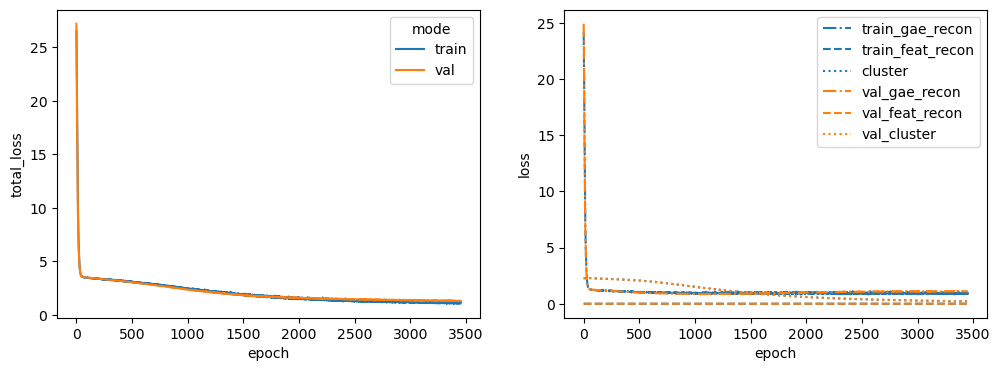

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 43%|████▎     | 4301/10000 [01:29<01:58, 48.08it/s]


Training stopped after 4302 epochs
Best model found at epoch 4200
------------------------------------------------------------
TEST AUC: 0.7925623582766441 AP: 0.8002394737463197
TRAIN loss: 1.0681052207946777
VAL loss: 1.5143671035766602
TEST loss: 1.5251855850219727
TEST AUC: 0.7925623582766441 	 AP: 0.8002394737463197


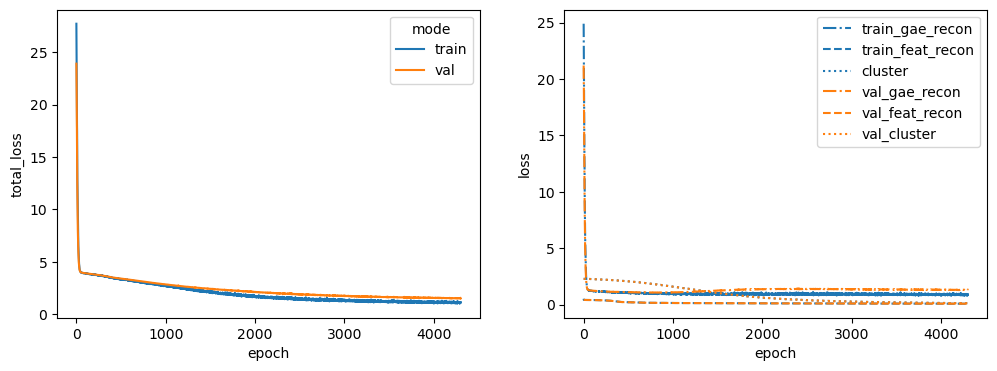

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 48%|████▊     | 4827/10000 [01:42<01:49, 47.29it/s]


Training stopped after 4828 epochs
Best model found at epoch 4726
------------------------------------------------------------
TEST AUC: 0.8126077097505668 AP: 0.8305551811060263
TRAIN loss: 1.1250685453414917
VAL loss: 1.2555631399154663
TEST loss: 1.4020346403121948
TEST AUC: 0.8126077097505668 	 AP: 0.8305551811060263


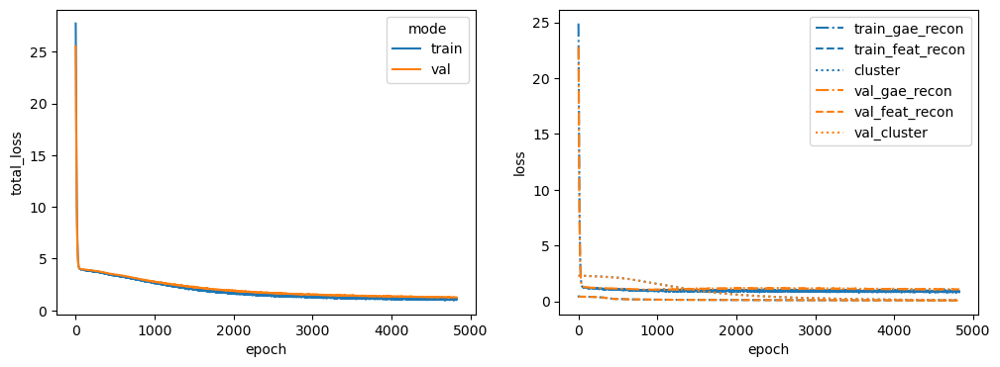

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 45%|████▍     | 4486/10000 [01:33<01:54, 48.06it/s]


Training stopped after 4487 epochs
Best model found at epoch 4385
------------------------------------------------------------
TEST AUC: 0.8234013605442176 AP: 0.8244976743099977
TRAIN loss: 1.03187096118927
VAL loss: 1.6157721281051636
TEST loss: 1.483224630355835
TEST AUC: 0.8234013605442176 	 AP: 0.8244976743099977


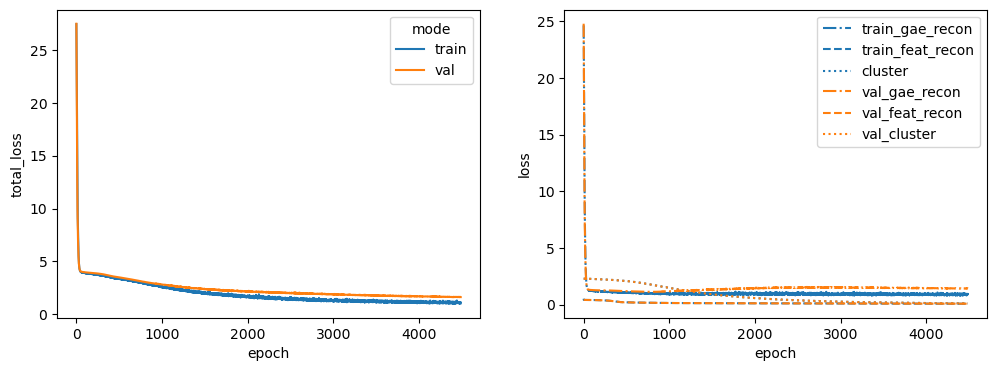

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 42%|████▏     | 4153/10000 [01:25<02:00, 48.46it/s]


Training stopped after 4154 epochs
Best model found at epoch 4052
------------------------------------------------------------
TEST AUC: 0.7959183673469389 AP: 0.8225570747415152
TRAIN loss: 1.0595202445983887
VAL loss: 1.572584867477417
TEST loss: 1.5245574712753296
TEST AUC: 0.7959183673469389 	 AP: 0.8225570747415152


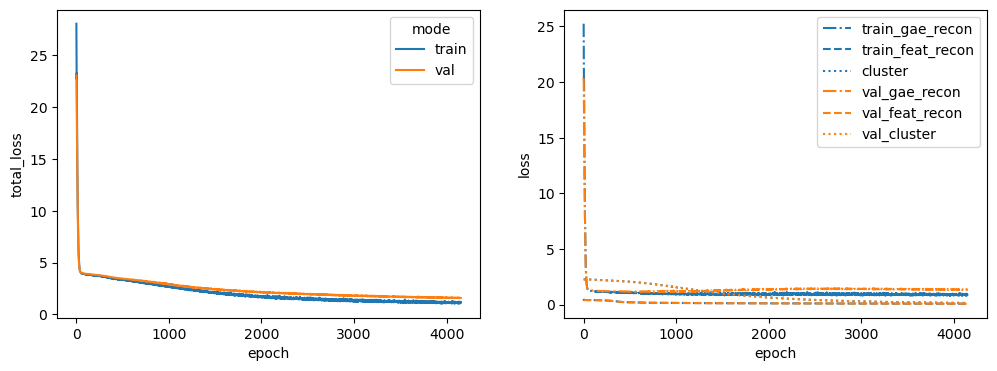

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 75%|███████▍  | 7496/10000 [02:36<00:52, 47.93it/s]


Training stopped after 7497 epochs
Best model found at epoch 7395
------------------------------------------------------------
TEST AUC: 0.7887528344671202 AP: 0.795564684629979
TRAIN loss: 1.0346771478652954
VAL loss: 1.530437707901001
TEST loss: 1.3989243507385254
TEST AUC: 0.7887528344671202 	 AP: 0.795564684629979


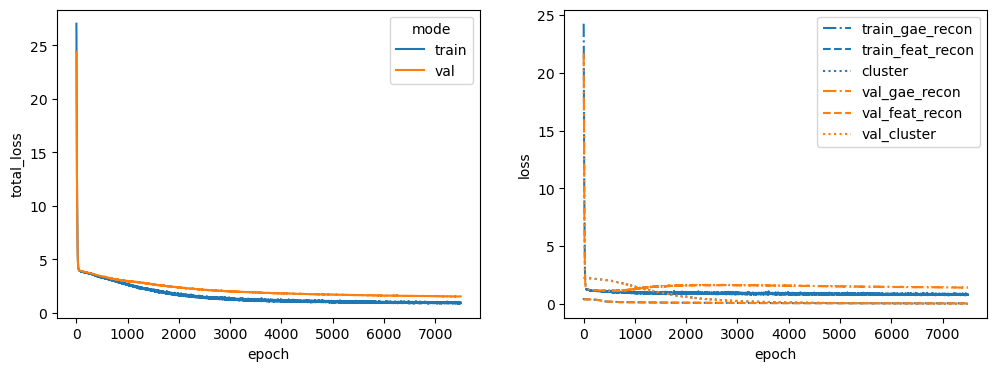

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 57%|█████▋    | 5685/10000 [01:57<01:29, 48.47it/s]


Training stopped after 5686 epochs
Best model found at epoch 5584
------------------------------------------------------------
TEST AUC: 0.7896598639455783 AP: 0.808065232558018
TRAIN loss: 1.0104408264160156
VAL loss: 1.3270347118377686
TEST loss: 1.4172441959381104
TEST AUC: 0.7896598639455783 	 AP: 0.808065232558018


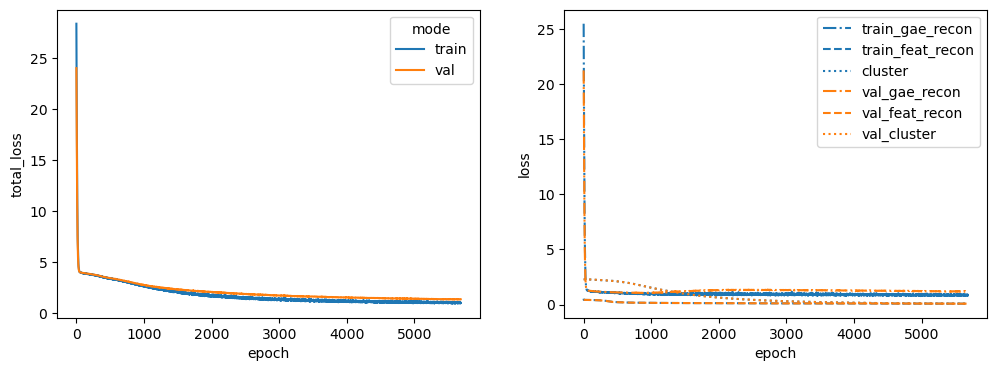

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 59%|█████▉    | 5875/10000 [02:01<01:25, 48.27it/s]


Training stopped after 5876 epochs
Best model found at epoch 5774
------------------------------------------------------------
TEST AUC: 0.8080725623582766 AP: 0.8290856614214618
TRAIN loss: 0.9922809600830078
VAL loss: 1.3566570281982422
TEST loss: 1.3334025144577026
TEST AUC: 0.8080725623582766 	 AP: 0.8290856614214618


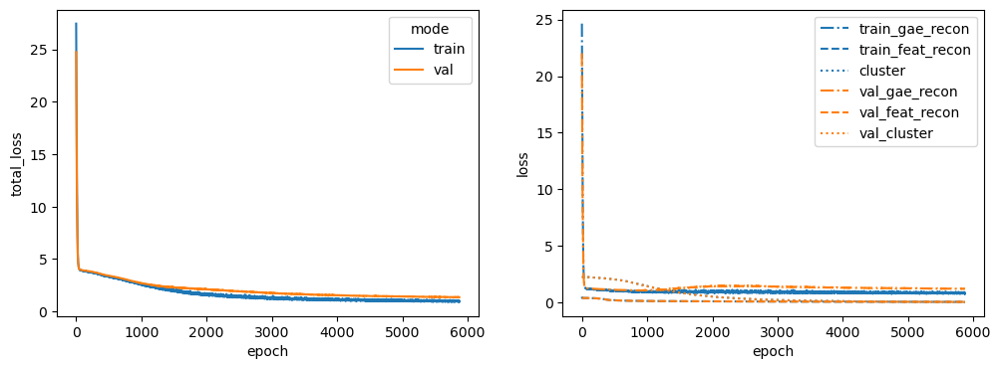

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 30%|██▉       | 2989/10000 [01:02<02:26, 47.84it/s]


Training stopped after 2990 epochs
Best model found at epoch 2888
------------------------------------------------------------
TEST AUC: 0.7955555555555556 AP: 0.8063619176263545
TRAIN loss: 1.2739264965057373
VAL loss: 1.7308582067489624
TEST loss: 1.6299909353256226
TEST AUC: 0.7955555555555556 	 AP: 0.8063619176263545


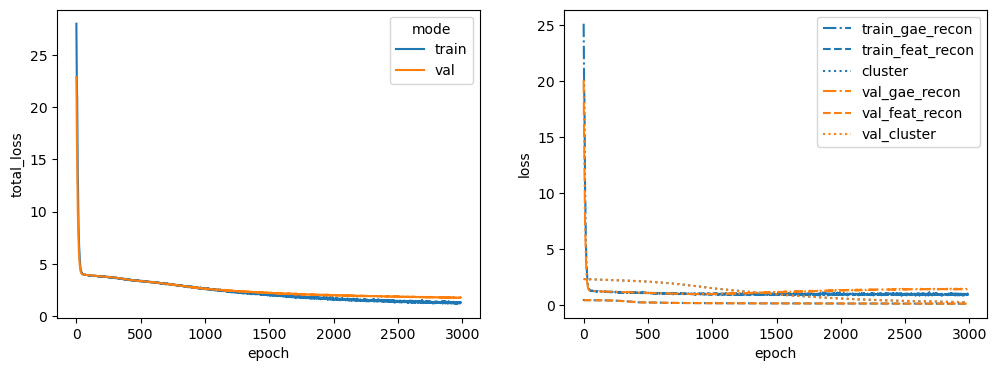

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 49%|████▉     | 4883/10000 [01:40<01:45, 48.58it/s]


Training stopped after 4884 epochs
Best model found at epoch 4782
------------------------------------------------------------
TEST AUC: 0.8214058956916099 AP: 0.8242658501878973
TRAIN loss: 1.0272825956344604
VAL loss: 1.3067795038223267
TEST loss: 1.3774781227111816
TEST AUC: 0.8214058956916099 	 AP: 0.8242658501878973


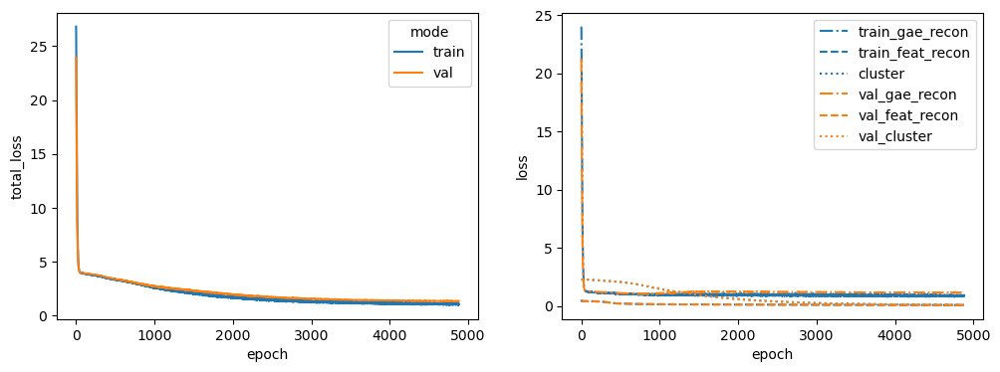

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 47%|████▋     | 4700/10000 [01:38<01:50, 47.79it/s]


Training stopped after 4701 epochs
Best model found at epoch 4599
------------------------------------------------------------
TEST AUC: 0.7931972789115647 AP: 0.7894820732658694
TRAIN loss: 1.00129234790802
VAL loss: 1.3742990493774414
TEST loss: 1.583371639251709
TEST AUC: 0.7931972789115647 	 AP: 0.7894820732658694


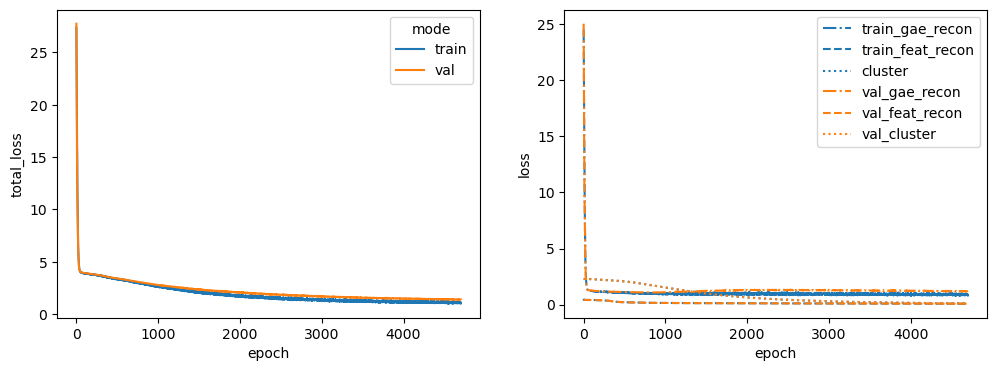

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 28%|██▊       | 2807/10000 [00:58<02:29, 48.08it/s]


Training stopped after 2808 epochs
Best model found at epoch 2706
------------------------------------------------------------
TEST AUC: 0.7758730158730158 AP: 0.7919965483034497
TRAIN loss: 1.3450407981872559
VAL loss: 1.8178696632385254
TEST loss: 1.7395238876342773
TEST AUC: 0.7758730158730158 	 AP: 0.7919965483034497


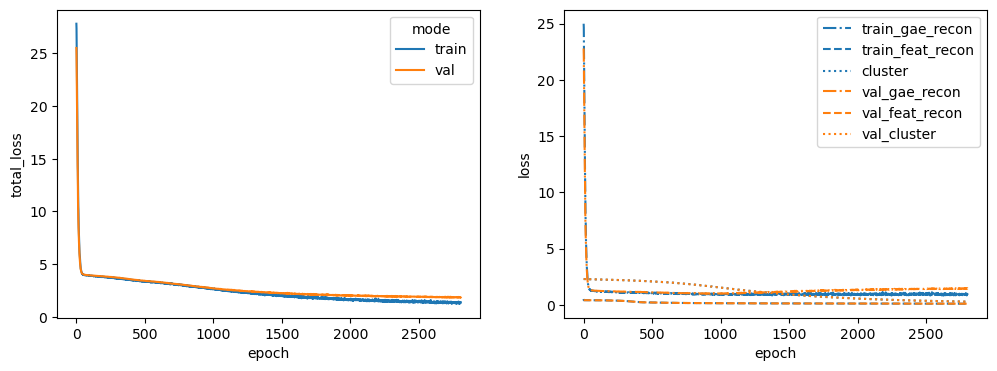

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 41%|████      | 4118/10000 [01:25<02:02, 47.90it/s]


Training stopped after 4119 epochs
Best model found at epoch 4017
------------------------------------------------------------
TEST AUC: 0.7983673469387755 AP: 0.78655976876628
TRAIN loss: 1.1495462656021118
VAL loss: 1.5227453708648682
TEST loss: 1.534826397895813
TEST AUC: 0.7983673469387755 	 AP: 0.78655976876628


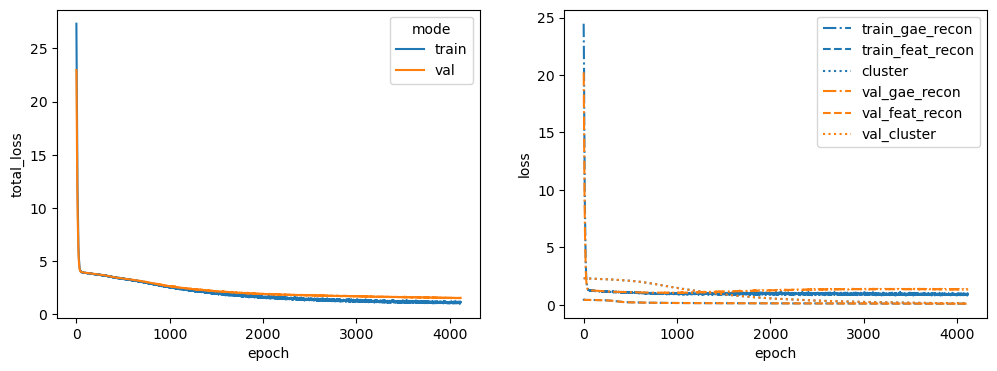

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 46%|████▋     | 4642/10000 [01:36<01:51, 48.00it/s]


Training stopped after 4643 epochs
Best model found at epoch 4541
------------------------------------------------------------
TEST AUC: 0.8196825396825398 AP: 0.8464501932726628
TRAIN loss: 1.126672625541687
VAL loss: 1.4698779582977295
TEST loss: 1.3752129077911377
TEST AUC: 0.8196825396825398 	 AP: 0.8464501932726628


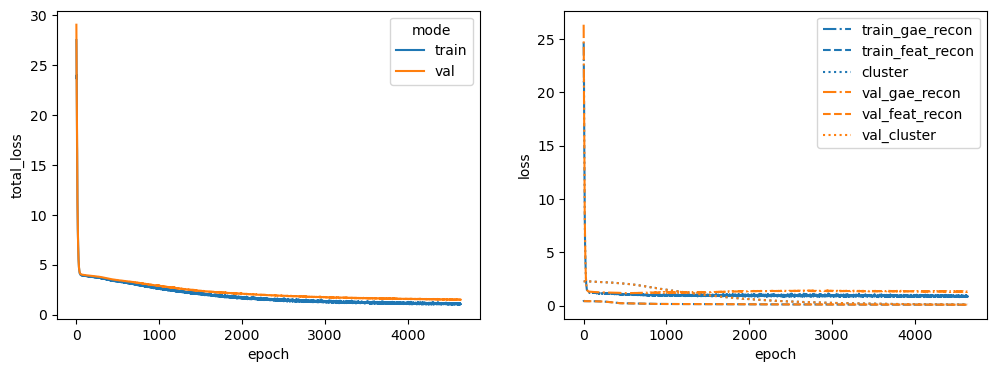

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 49%|████▉     | 4939/10000 [01:42<01:45, 47.98it/s]


Training stopped after 4940 epochs
Best model found at epoch 4838
------------------------------------------------------------
TEST AUC: 0.7825850340136055 AP: 0.7793962955967306
TRAIN loss: 1.0225918292999268
VAL loss: 1.2603588104248047
TEST loss: 1.4810752868652344
TEST AUC: 0.7825850340136055 	 AP: 0.7793962955967306


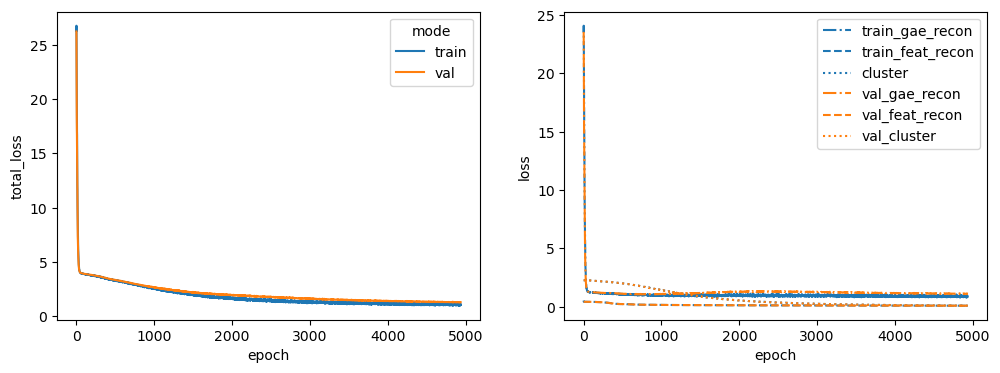

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 48%|████▊     | 4750/10000 [01:39<01:50, 47.59it/s]


Training stopped after 4751 epochs
Best model found at epoch 4649
------------------------------------------------------------
TEST AUC: 0.7899319727891156 AP: 0.8094886257588012
TRAIN loss: 1.0566715002059937
VAL loss: 1.3107657432556152
TEST loss: 1.52093505859375
TEST AUC: 0.7899319727891156 	 AP: 0.8094886257588012


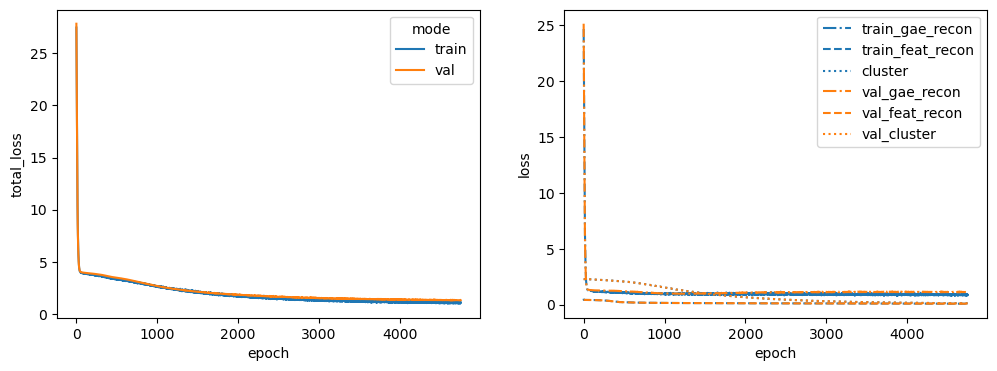

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 53%|█████▎    | 5321/10000 [01:51<01:37, 47.82it/s]


Training stopped after 5322 epochs
Best model found at epoch 5220
------------------------------------------------------------
TEST AUC: 0.824671201814059 AP: 0.862634030574891
TRAIN loss: 1.0811938047409058
VAL loss: 1.2963922023773193
TEST loss: 1.3130515813827515
TEST AUC: 0.824671201814059 	 AP: 0.862634030574891


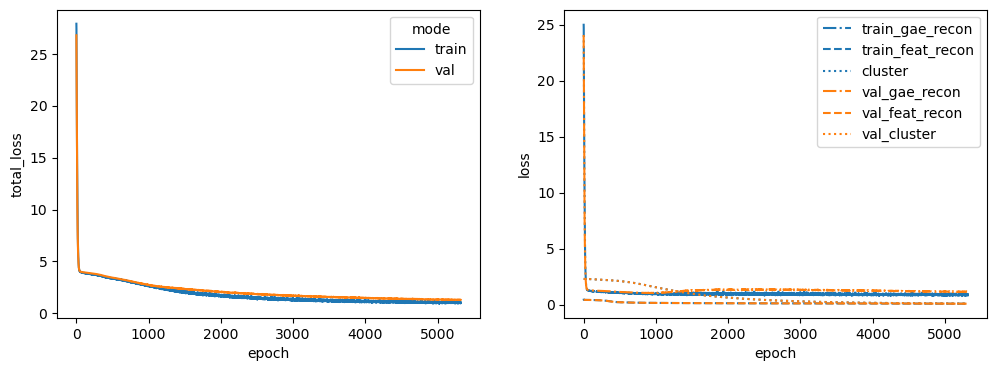

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 45%|████▌     | 4548/10000 [01:35<01:54, 47.62it/s]


Training stopped after 4549 epochs
Best model found at epoch 4447
------------------------------------------------------------
TEST AUC: 0.7955555555555556 AP: 0.7826577830600855
TRAIN loss: 1.0314334630966187
VAL loss: 1.3400903940200806
TEST loss: 1.527194857597351
TEST AUC: 0.7955555555555556 	 AP: 0.7826577830600855


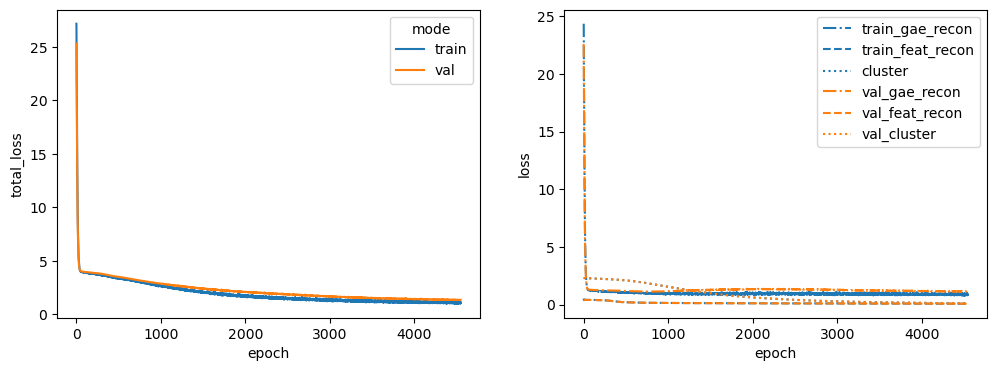

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 45%|████▌     | 4519/10000 [01:33<01:53, 48.34it/s]


Training stopped after 4520 epochs
Best model found at epoch 4418
------------------------------------------------------------
TEST AUC: 0.823310657596372 AP: 0.8117358454438922
TRAIN loss: 1.046257734298706
VAL loss: 1.2786803245544434
TEST loss: 1.4407546520233154
TEST AUC: 0.823310657596372 	 AP: 0.8117358454438922


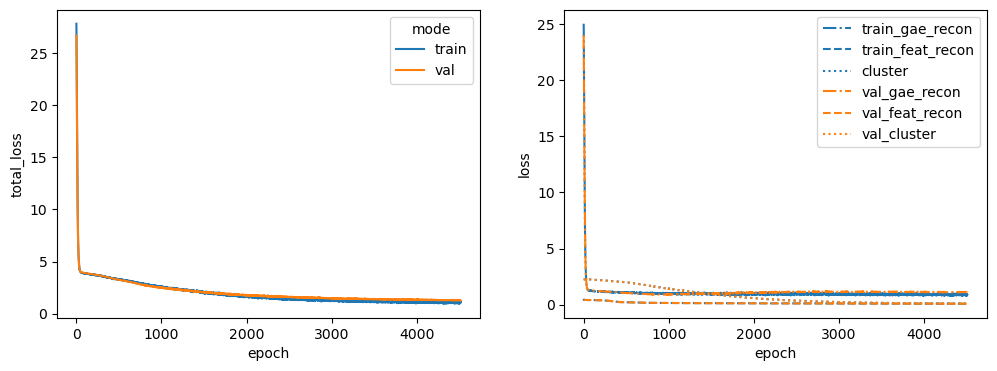

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 31%|███       | 3101/10000 [01:05<02:25, 47.40it/s]


Training stopped after 3102 epochs
Best model found at epoch 3000
------------------------------------------------------------
TEST AUC: 0.7881179138321995 AP: 0.8000556745895246
TRAIN loss: 1.3133323192596436
VAL loss: 1.504740834236145
TEST loss: 1.6907856464385986
TEST AUC: 0.7881179138321995 	 AP: 0.8000556745895246


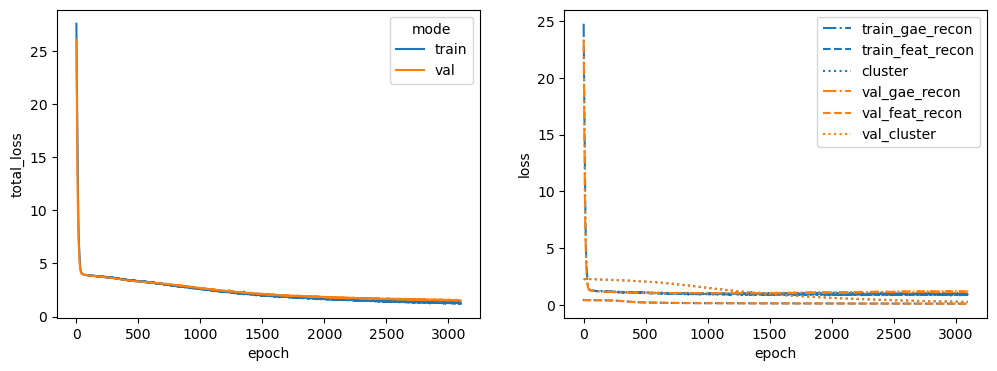

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 47%|████▋     | 4736/10000 [01:37<01:48, 48.37it/s]


Training stopped after 4737 epochs
Best model found at epoch 4635
------------------------------------------------------------
TEST AUC: 0.8142403628117914 AP: 0.8051318573110204
TRAIN loss: 1.0233166217803955
VAL loss: 1.2509583234786987
TEST loss: 1.4395850896835327
TEST AUC: 0.8142403628117914 	 AP: 0.8051318573110204


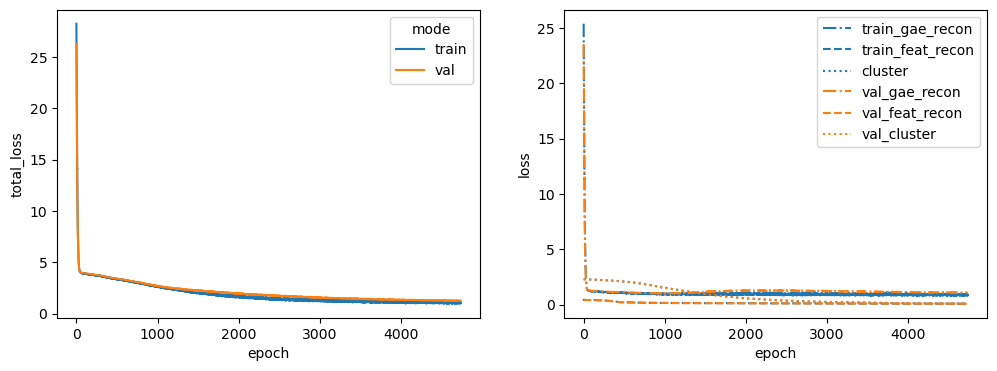

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 47%|████▋     | 4736/10000 [01:39<01:50, 47.75it/s]


Training stopped after 4737 epochs
Best model found at epoch 4635
------------------------------------------------------------
TEST AUC: 0.8358276643990931 AP: 0.8624296712635882
TRAIN loss: 1.067055344581604
VAL loss: 1.2317227125167847
TEST loss: 1.2604809999465942
TEST AUC: 0.8358276643990931 	 AP: 0.8624296712635882


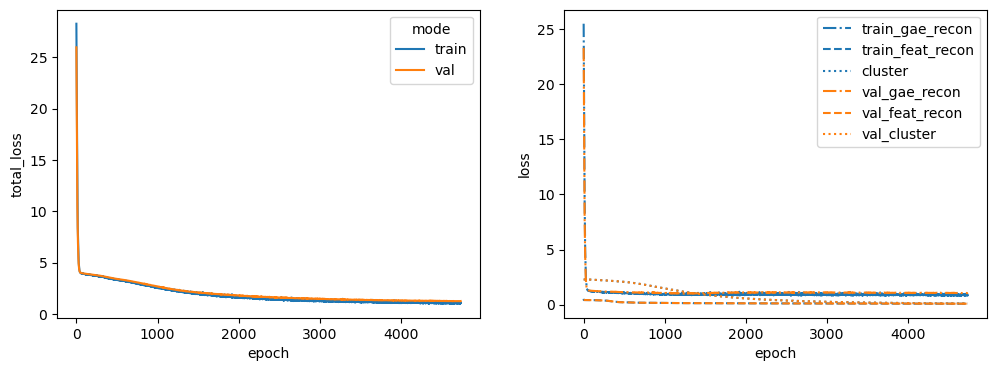

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 35%|███▍      | 3463/10000 [01:12<02:17, 47.70it/s]


Training stopped after 3464 epochs
Best model found at epoch 3362
------------------------------------------------------------
TEST AUC: 0.7822222222222222 AP: 0.8129731527620434
TRAIN loss: 1.1508234739303589
VAL loss: 1.4043664932250977
TEST loss: 1.5863159894943237
TEST AUC: 0.7822222222222222 	 AP: 0.8129731527620434


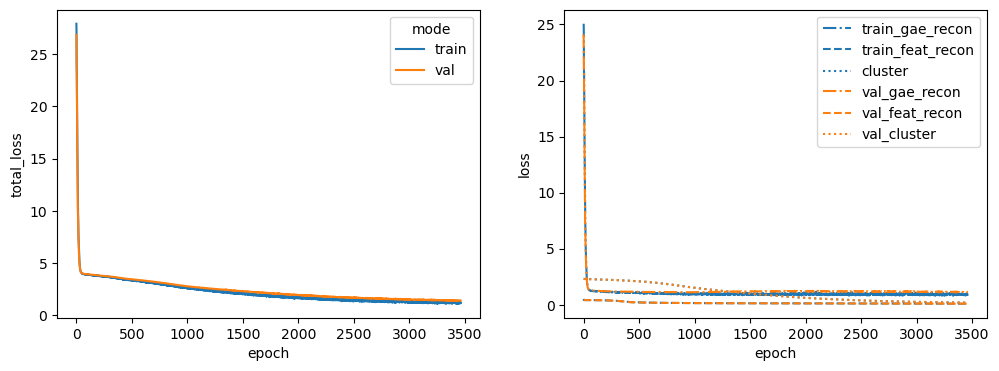

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 42%|████▏     | 4153/10000 [01:27<02:03, 47.40it/s]


Training stopped after 4154 epochs
Best model found at epoch 4052
------------------------------------------------------------
TEST AUC: 0.8026303854875284 AP: 0.7813445834211148
TRAIN loss: 1.1369291543960571
VAL loss: 1.5368729829788208
TEST loss: 1.533284306526184
TEST AUC: 0.8026303854875284 	 AP: 0.7813445834211148


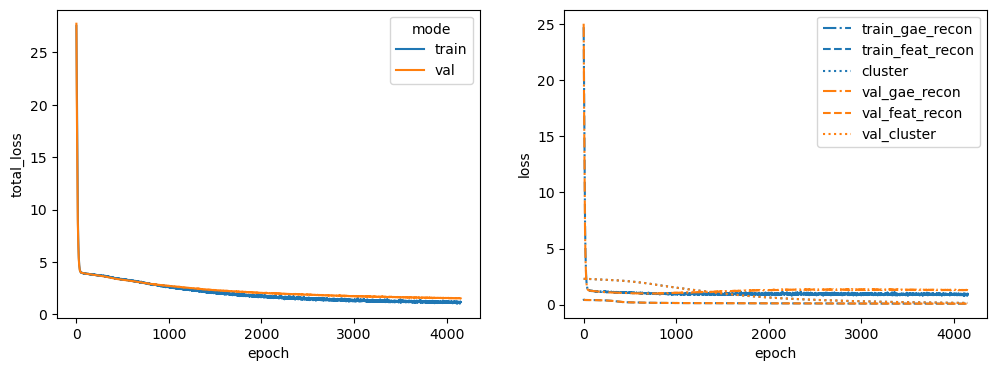

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 36%|███▌      | 3602/10000 [01:15<02:14, 47.44it/s]


Training stopped after 3603 epochs
Best model found at epoch 3501
------------------------------------------------------------
TEST AUC: 0.8102494331065759 AP: 0.8179810835554444
TRAIN loss: 1.1898528337478638
VAL loss: 1.501664400100708
TEST loss: 1.4914841651916504
TEST AUC: 0.8102494331065759 	 AP: 0.8179810835554444


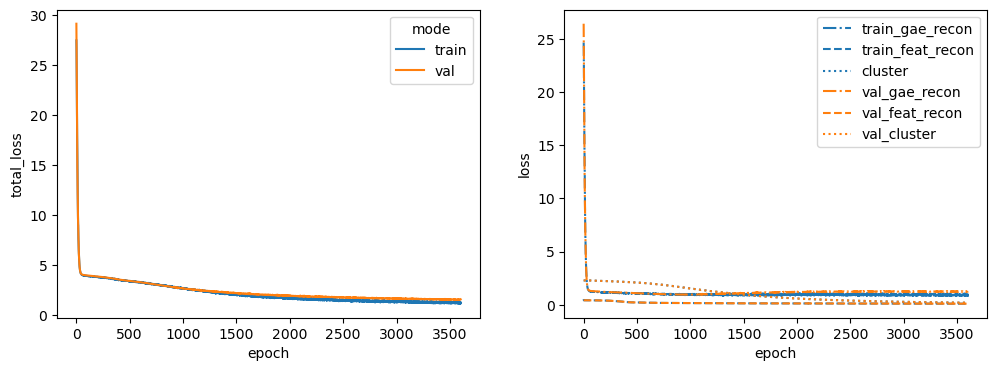

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 34%|███▍      | 3421/10000 [01:11<02:18, 47.60it/s]


Training stopped after 3422 epochs
Best model found at epoch 3320
------------------------------------------------------------
TEST AUC: 0.8025396825396826 AP: 0.8037029342444708
TRAIN loss: 1.2920091152191162
VAL loss: 1.5320500135421753
TEST loss: 1.649446964263916
TEST AUC: 0.8025396825396826 	 AP: 0.8037029342444708


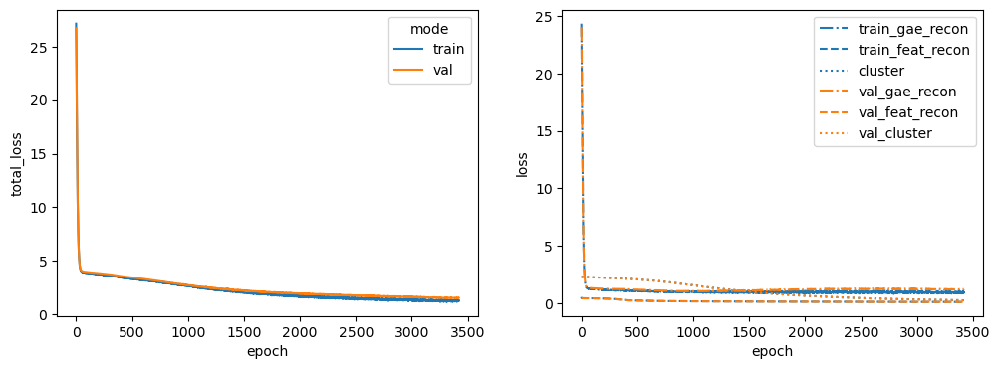

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 46%|████▌     | 4624/10000 [01:35<01:51, 48.20it/s]


Training stopped after 4625 epochs
Best model found at epoch 4523
------------------------------------------------------------
TEST AUC: 0.8282993197278912 AP: 0.8325821776962337
TRAIN loss: 1.0751798152923584
VAL loss: 1.2670825719833374
TEST loss: 1.3797539472579956
TEST AUC: 0.8282993197278912 	 AP: 0.8325821776962337


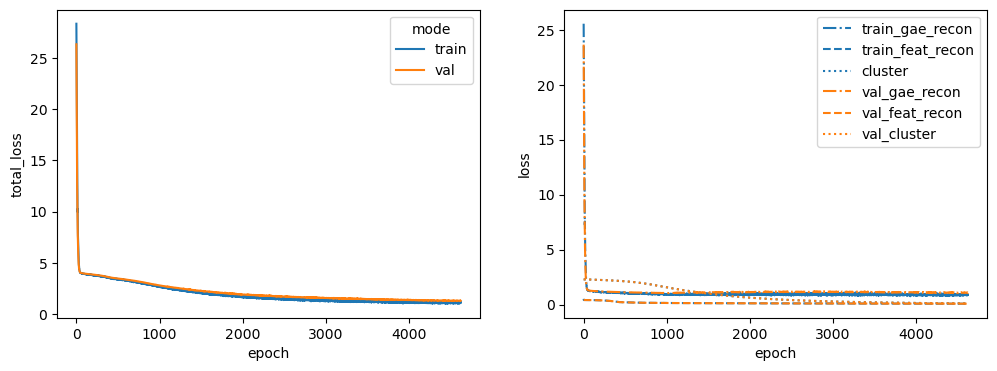

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 45%|████▌     | 4515/10000 [01:33<01:53, 48.34it/s]


Training stopped after 4516 epochs
Best model found at epoch 4414
------------------------------------------------------------
TEST AUC: 0.819954648526077 AP: 0.8354666069174334
TRAIN loss: 1.0232276916503906
VAL loss: 1.335066556930542
TEST loss: 1.3929932117462158
TEST AUC: 0.819954648526077 	 AP: 0.8354666069174334


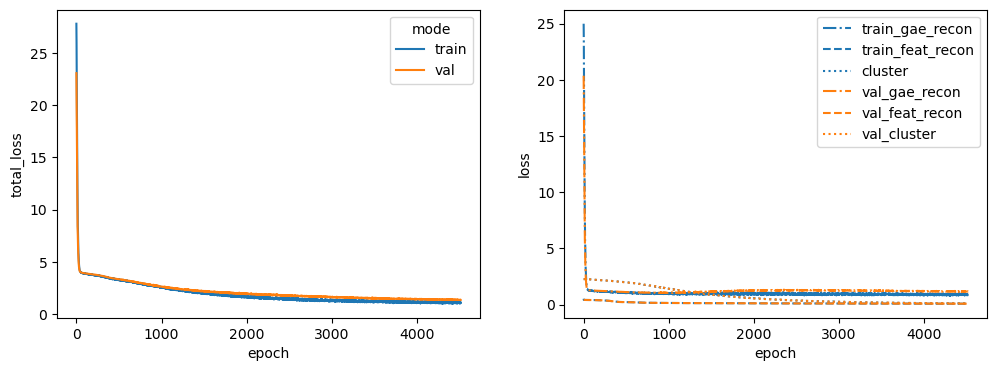

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 34%|███▍      | 3434/10000 [01:12<02:18, 47.41it/s]


Training stopped after 3435 epochs
Best model found at epoch 3333
------------------------------------------------------------
TEST AUC: 0.7996371882086166 AP: 0.8184076739542271
TRAIN loss: 1.1657474040985107
VAL loss: 1.7321869134902954
TEST loss: 1.5778533220291138
TEST AUC: 0.7996371882086166 	 AP: 0.8184076739542271


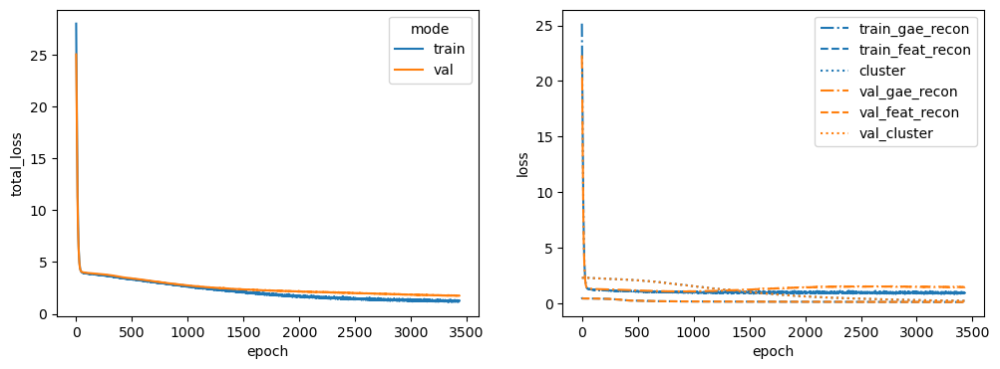

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 45%|████▍     | 4460/10000 [01:33<01:55, 47.92it/s]


Training stopped after 4461 epochs
Best model found at epoch 4359
------------------------------------------------------------
TEST AUC: 0.7519274376417233 AP: 0.7368051989557758
TRAIN loss: 1.040379285812378
VAL loss: 1.4340440034866333
TEST loss: 1.6326093673706055
TEST AUC: 0.7519274376417233 	 AP: 0.7368051989557758


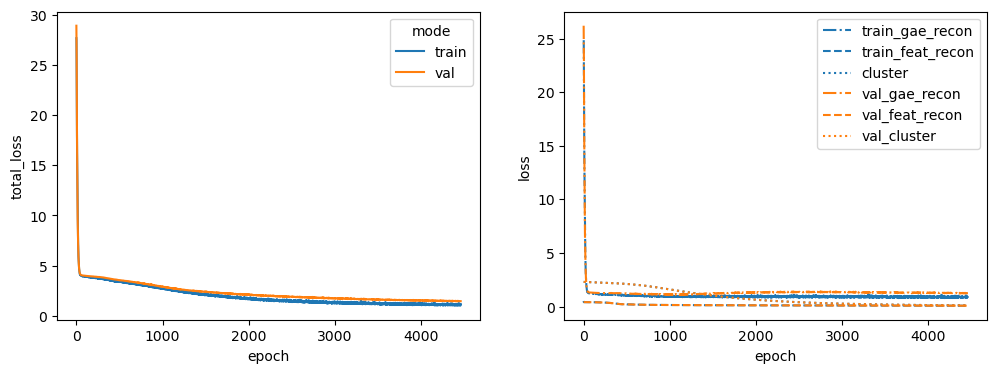

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 38%|███▊      | 3800/10000 [01:18<02:08, 48.29it/s]


Training stopped after 3801 epochs
Best model found at epoch 3699
------------------------------------------------------------
TEST AUC: 0.7780498866213152 AP: 0.7824277728152423
TRAIN loss: 1.1276321411132812
VAL loss: 1.6843031644821167
TEST loss: 1.6038926839828491
TEST AUC: 0.7780498866213152 	 AP: 0.7824277728152423


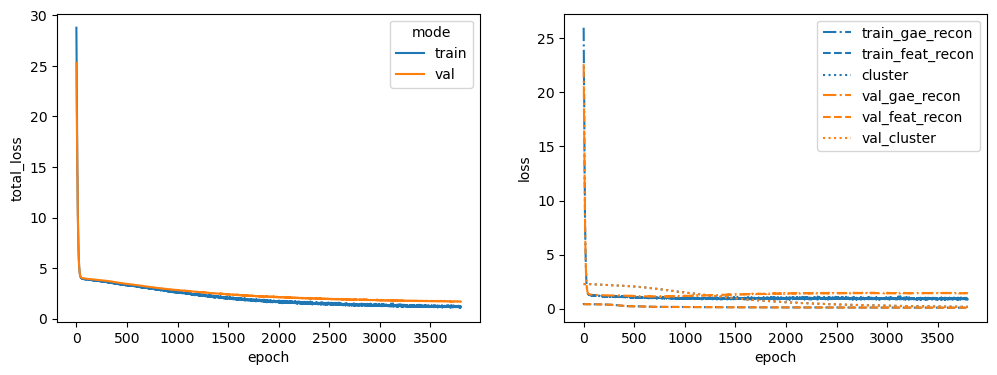

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 33%|███▎      | 3276/10000 [01:09<02:22, 47.10it/s]


Training stopped after 3277 epochs
Best model found at epoch 3175
------------------------------------------------------------
TEST AUC: 0.7612698412698412 AP: 0.7577671753542161
TRAIN loss: 1.2759251594543457
VAL loss: 1.399003267288208
TEST loss: 1.7861088514328003
TEST AUC: 0.7612698412698412 	 AP: 0.7577671753542161


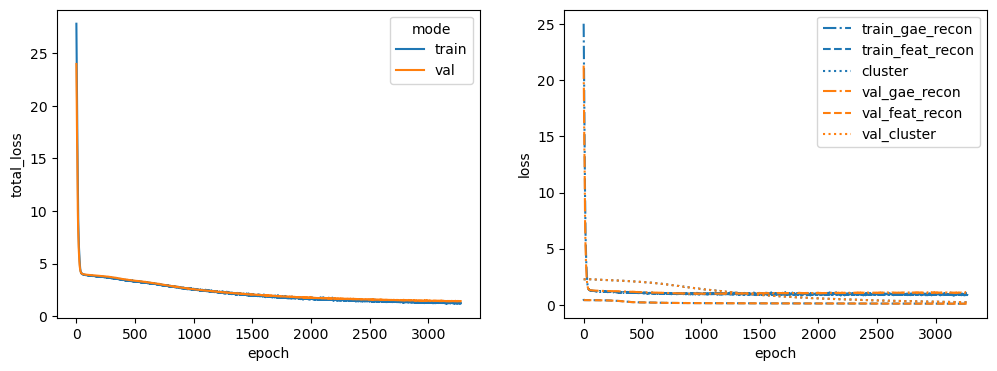

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 43%|████▎     | 4313/10000 [01:29<01:57, 48.35it/s]


Training stopped after 4314 epochs
Best model found at epoch 4212
------------------------------------------------------------
TEST AUC: 0.7996371882086167 AP: 0.8224904735185423
TRAIN loss: 1.194216012954712
VAL loss: 1.5971888303756714
TEST loss: 1.5023847818374634
TEST AUC: 0.7996371882086167 	 AP: 0.8224904735185423


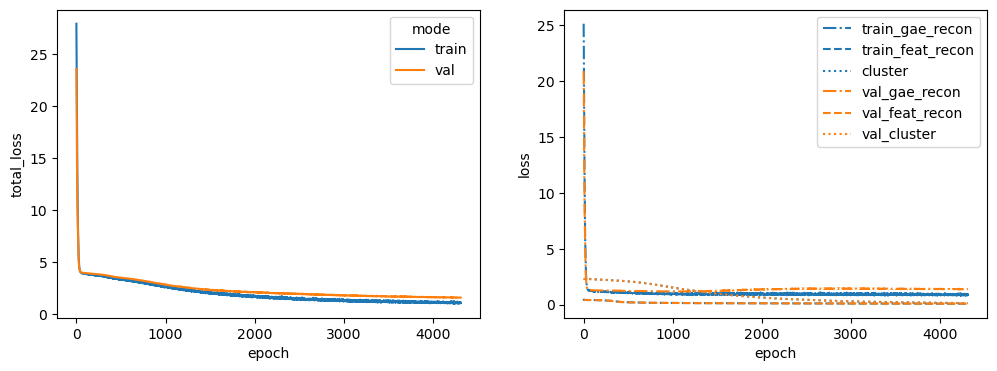

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 27%|██▋       | 2680/10000 [00:56<02:34, 47.42it/s]


Training stopped after 2681 epochs
Best model found at epoch 2579
------------------------------------------------------------
TEST AUC: 0.8376417233560091 AP: 0.851553151440209
TRAIN loss: 1.4532487392425537
VAL loss: 1.6420398950576782
TEST loss: 1.651452898979187
TEST AUC: 0.8376417233560091 	 AP: 0.851553151440209


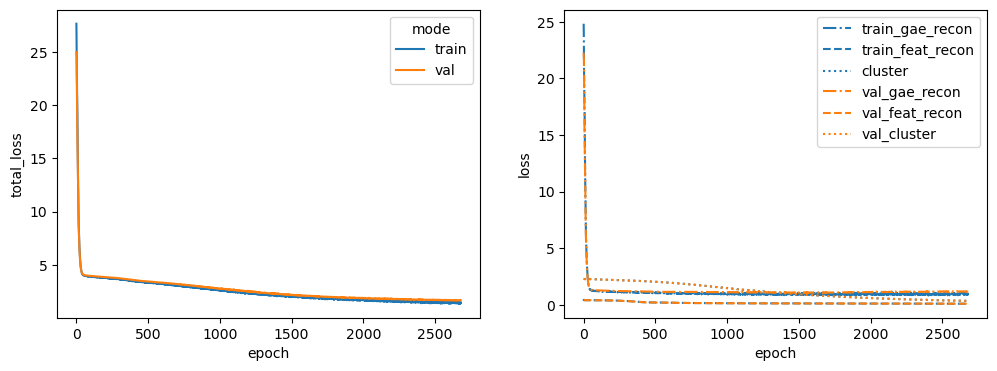

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 38%|███▊      | 3807/10000 [01:19<02:09, 47.66it/s]


Training stopped after 3808 epochs
Best model found at epoch 3706
------------------------------------------------------------
TEST AUC: 0.7981859410430839 AP: 0.8231127572234018
TRAIN loss: 1.197528600692749
VAL loss: 1.4830312728881836
TEST loss: 1.5597211122512817
TEST AUC: 0.7981859410430839 	 AP: 0.8231127572234018


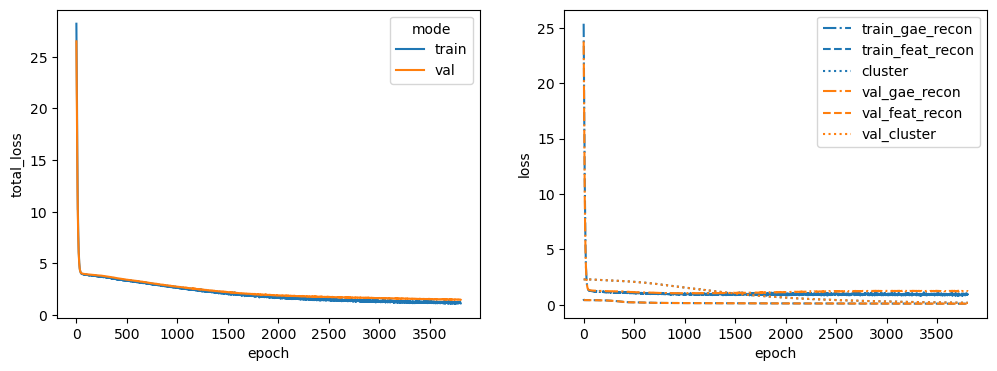

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 54%|█████▍    | 5413/10000 [01:53<01:35, 47.89it/s]


Training stopped after 5414 epochs
Best model found at epoch 5312
------------------------------------------------------------
TEST AUC: 0.8012698412698412 AP: 0.8116307866141657
TRAIN loss: 0.9919744729995728
VAL loss: 1.1014741659164429
TEST loss: 1.4093376398086548
TEST AUC: 0.8012698412698412 	 AP: 0.8116307866141657


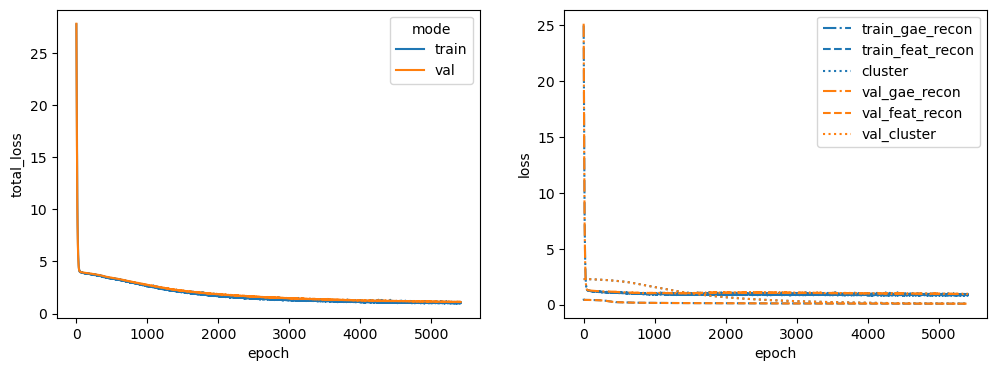

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 60%|█████▉    | 5991/10000 [02:03<01:22, 48.47it/s]


Training stopped after 5992 epochs
Best model found at epoch 5890
------------------------------------------------------------
TEST AUC: 0.8202267573696145 AP: 0.8026202090916139
TRAIN loss: 1.0372517108917236
VAL loss: 1.5669989585876465
TEST loss: 1.3582948446273804
TEST AUC: 0.8202267573696145 	 AP: 0.8026202090916139


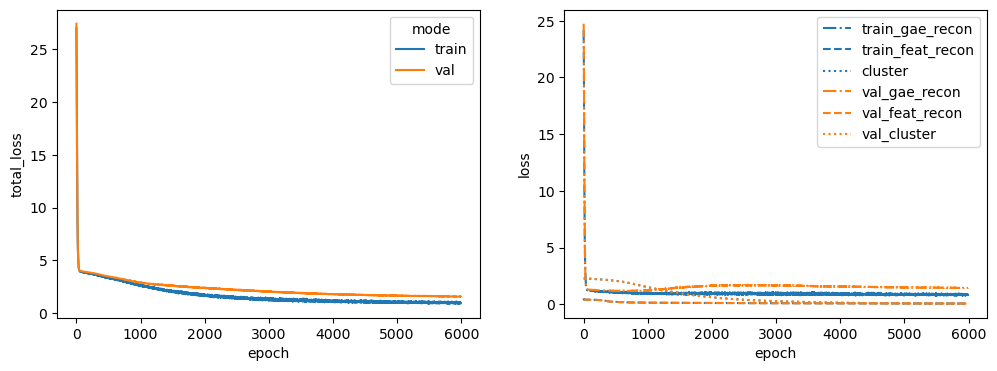

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 29%|██▉       | 2888/10000 [01:01<02:30, 47.21it/s]


Training stopped after 2889 epochs
Best model found at epoch 2787
------------------------------------------------------------
TEST AUC: 0.8108843537414965 AP: 0.8285193391792756
TRAIN loss: 1.3481318950653076
VAL loss: 1.4951032400131226
TEST loss: 1.6359835863113403
TEST AUC: 0.8108843537414965 	 AP: 0.8285193391792756


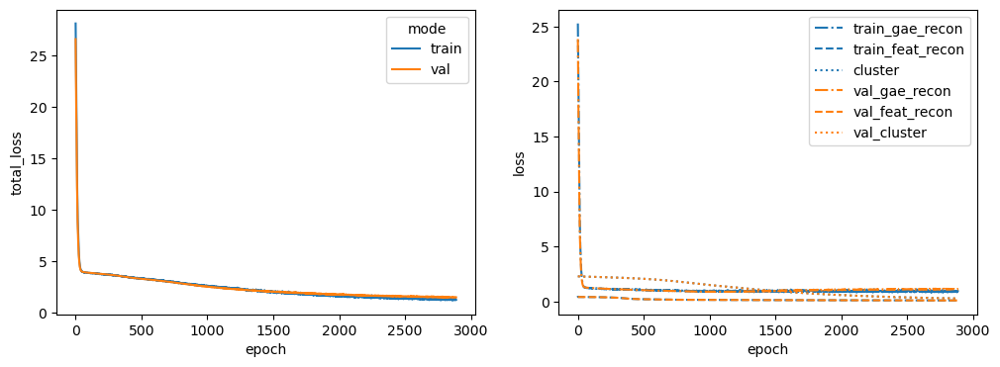

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 33%|███▎      | 3258/10000 [01:09<02:22, 47.16it/s]


Training stopped after 3259 epochs
Best model found at epoch 3157
------------------------------------------------------------
TEST AUC: 0.8001814058956916 AP: 0.819622795496167
TRAIN loss: 1.2348459959030151
VAL loss: 1.5793447494506836
TEST loss: 1.5708839893341064
TEST AUC: 0.8001814058956916 	 AP: 0.819622795496167


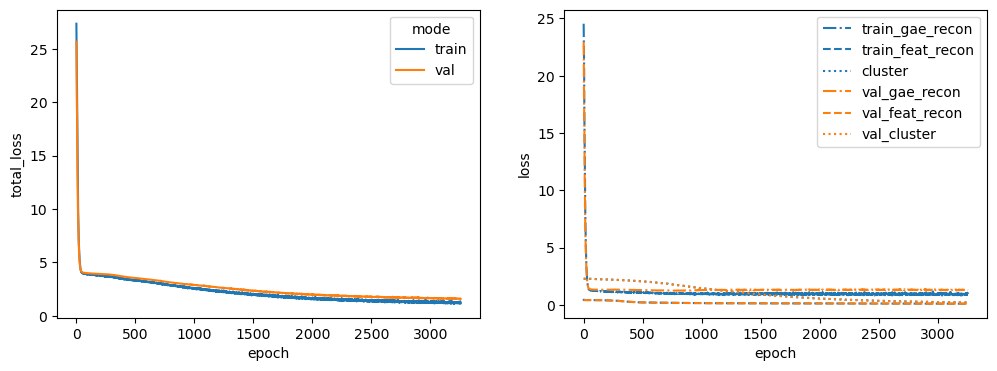

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 54%|█████▎    | 5356/10000 [01:51<01:37, 47.83it/s]


Training stopped after 5357 epochs
Best model found at epoch 5255
------------------------------------------------------------
TEST AUC: 0.8177777777777777 AP: 0.8513878107653043
TRAIN loss: 1.114853858947754
VAL loss: 1.4421035051345825
TEST loss: 1.3245481252670288
TEST AUC: 0.8177777777777777 	 AP: 0.8513878107653043


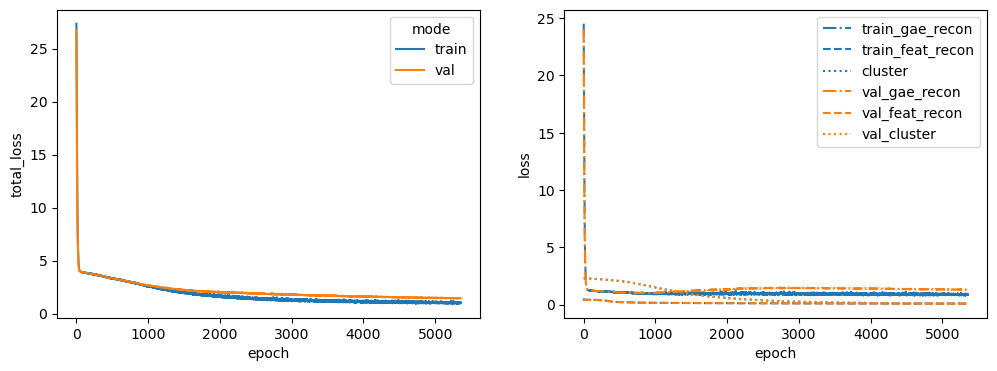

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 53%|█████▎    | 5328/10000 [01:52<01:38, 47.28it/s]


Training stopped after 5329 epochs
Best model found at epoch 5227
------------------------------------------------------------
TEST AUC: 0.8133333333333334 AP: 0.8015532509276619
TRAIN loss: 1.062947154045105
VAL loss: 1.5932528972625732
TEST loss: 1.4305728673934937
TEST AUC: 0.8133333333333334 	 AP: 0.8015532509276619


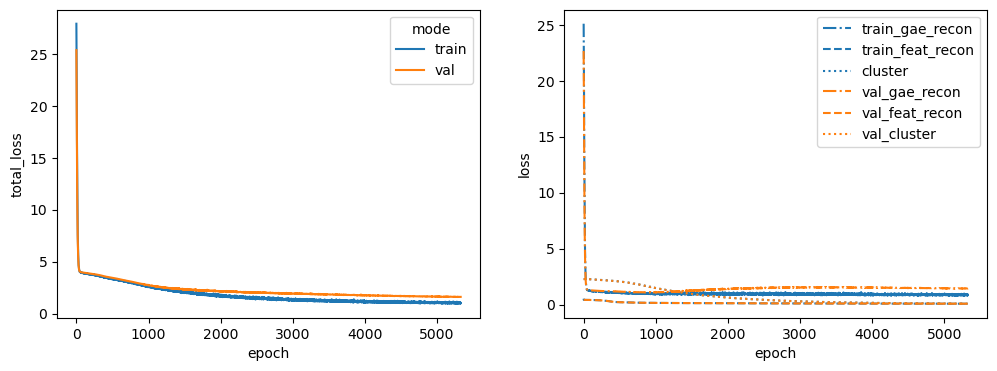

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 33%|███▎      | 3308/10000 [01:09<02:21, 47.32it/s]


Training stopped after 3309 epochs
Best model found at epoch 3207
------------------------------------------------------------
TEST AUC: 0.8201360544217687 AP: 0.7652509149888673
TRAIN loss: 1.188286304473877
VAL loss: 1.6433422565460205
TEST loss: 2.0348012447357178
TEST AUC: 0.8201360544217687 	 AP: 0.7652509149888673


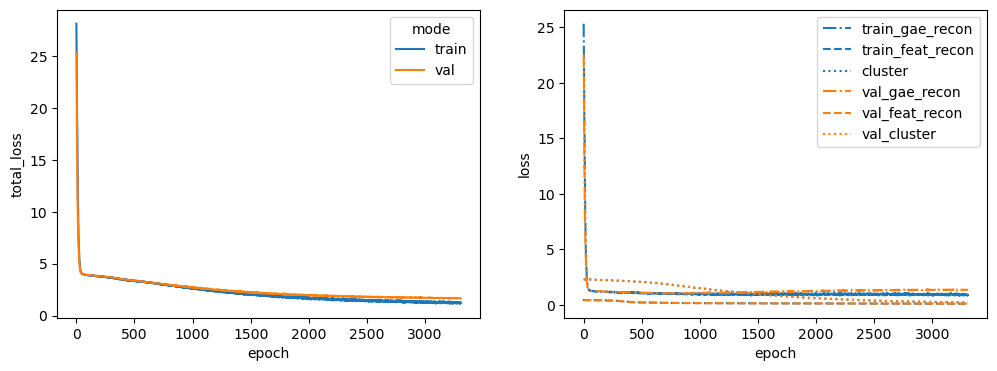

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 41%|████      | 4103/10000 [01:25<02:03, 47.87it/s]


Training stopped after 4104 epochs
Best model found at epoch 4002
------------------------------------------------------------
TEST AUC: 0.7726077097505668 AP: 0.76350249008591
TRAIN loss: 1.1619287729263306
VAL loss: 1.4127622842788696
TEST loss: 1.713053584098816
TEST AUC: 0.7726077097505668 	 AP: 0.76350249008591


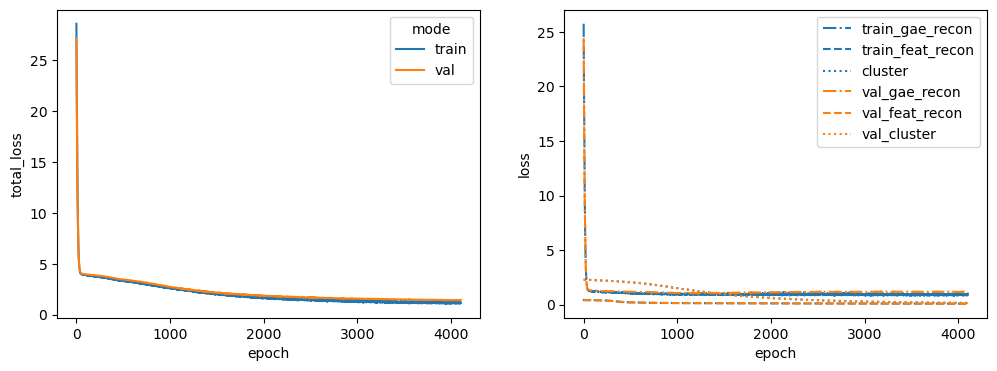

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 48%|████▊     | 4754/10000 [01:39<01:49, 47.90it/s]


Training stopped after 4755 epochs
Best model found at epoch 4653
------------------------------------------------------------
TEST AUC: 0.7819501133786848 AP: 0.7690133965355719
TRAIN loss: 1.0278722047805786
VAL loss: 1.358356237411499
TEST loss: 1.5348701477050781
TEST AUC: 0.7819501133786848 	 AP: 0.7690133965355719


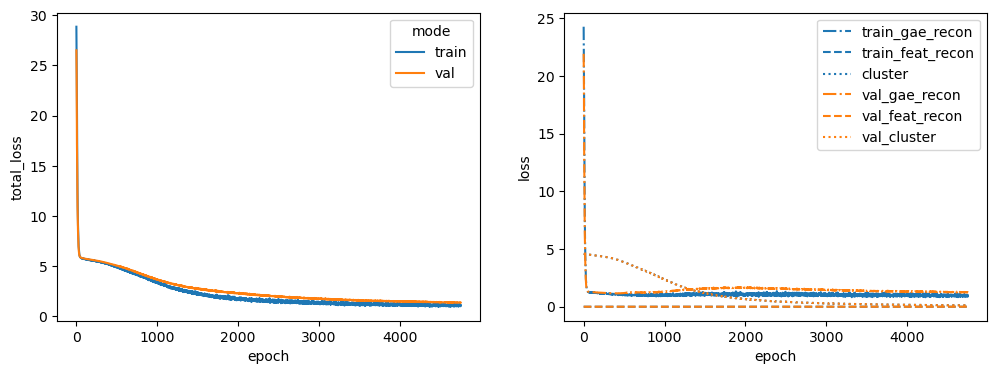

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 18%|█▊        | 1816/10000 [00:38<02:52, 47.35it/s]


Training stopped after 1817 epochs
Best model found at epoch 1715
------------------------------------------------------------
TEST AUC: 0.7849433106575964 AP: 0.782435527324429
TRAIN loss: 1.9636887311935425
VAL loss: 2.5127861499786377
TEST loss: 2.3257718086242676
TEST AUC: 0.7849433106575964 	 AP: 0.782435527324429


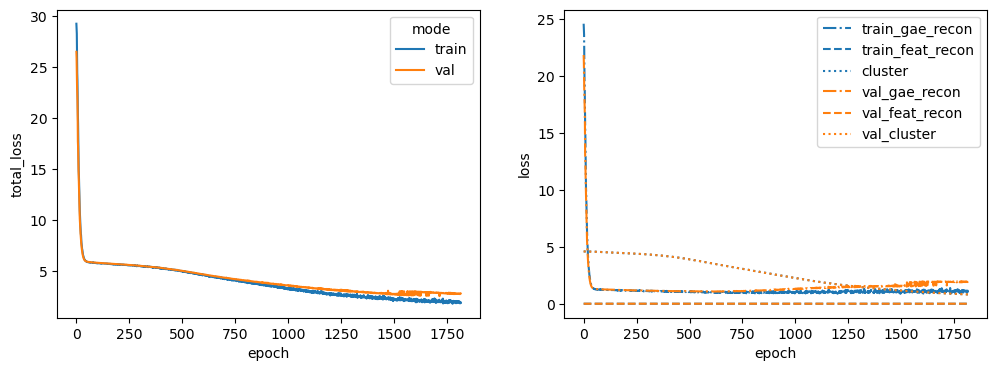

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


  7%|▋         | 696/10000 [00:14<03:09, 49.02it/s]


Training stopped after 697 epochs
Best model found at epoch 595
------------------------------------------------------------
TEST AUC: 0.8047165532879818 AP: 0.811627810997014
TRAIN loss: 4.527852535247803
VAL loss: 5.083096027374268
TEST loss: 4.709811210632324
TEST AUC: 0.8047165532879818 	 AP: 0.811627810997014


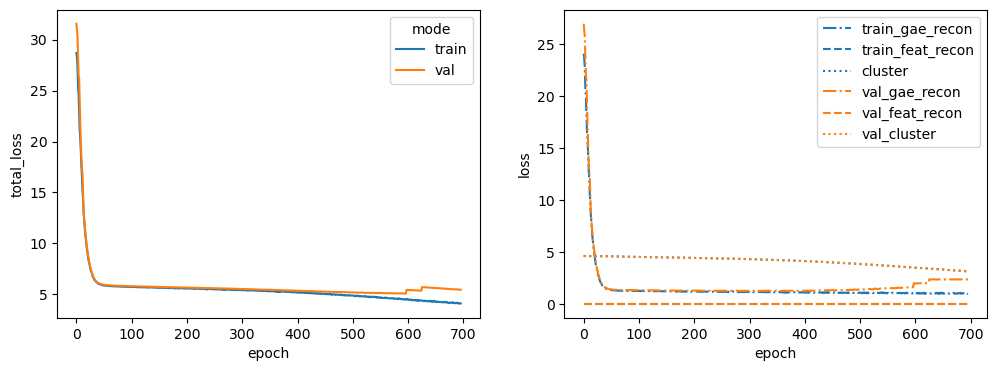

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 45%|████▌     | 4549/10000 [01:35<01:54, 47.49it/s]


Training stopped after 4550 epochs
Best model found at epoch 4448
------------------------------------------------------------
TEST AUC: 0.7965532879818594 AP: 0.8032138147350447
TRAIN loss: 1.1829876899719238
VAL loss: 1.3738189935684204
TEST loss: 1.7576723098754883
TEST AUC: 0.7965532879818594 	 AP: 0.8032138147350447


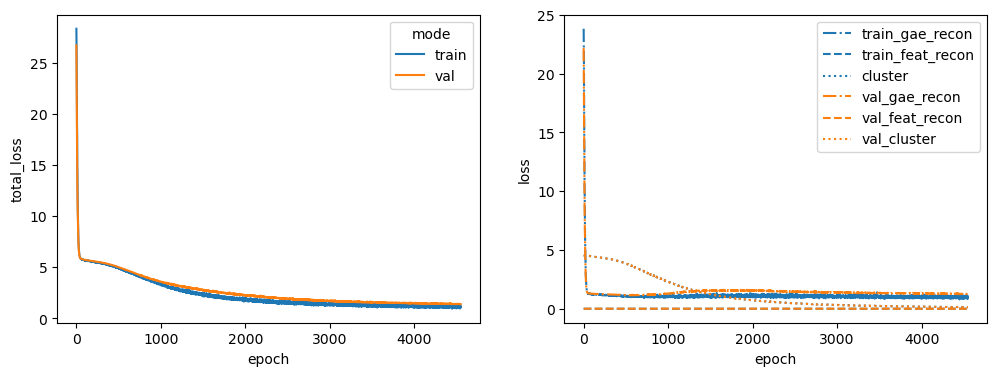

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 26%|██▌       | 2562/10000 [00:53<02:36, 47.49it/s]


Training stopped after 2563 epochs
Best model found at epoch 2461
------------------------------------------------------------
TEST AUC: 0.8136054421768708 AP: 0.8553852872984189
TRAIN loss: 1.4873995780944824
VAL loss: 1.6481034755706787
TEST loss: 1.6967370510101318
TEST AUC: 0.8136054421768708 	 AP: 0.8553852872984189


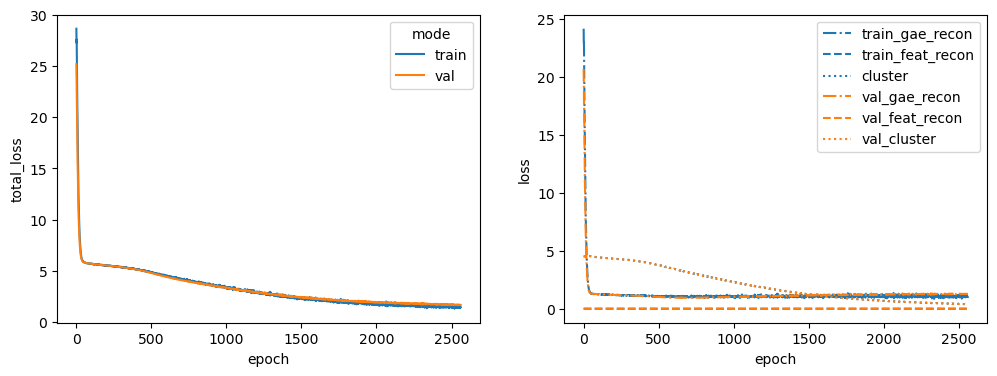

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 32%|███▏      | 3228/10000 [01:08<02:23, 47.23it/s]


Training stopped after 3229 epochs
Best model found at epoch 3127
------------------------------------------------------------
TEST AUC: 0.7920181405895691 AP: 0.7857898671074454
TRAIN loss: 1.2602429389953613
VAL loss: 1.6860291957855225
TEST loss: 1.6777944564819336
TEST AUC: 0.7920181405895691 	 AP: 0.7857898671074454


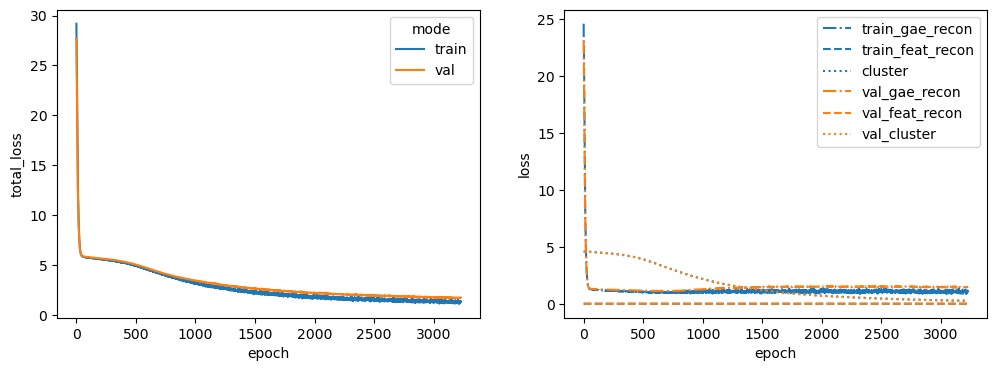

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 10%|█         | 1000/10000 [00:21<03:13, 46.57it/s]


Training stopped after 1001 epochs
Best model found at epoch 899
------------------------------------------------------------
TEST AUC: 0.7852154195011338 AP: 0.7595653296556814
TRAIN loss: 3.3940043449401855
VAL loss: 3.7057979106903076
TEST loss: 3.7394964694976807
TEST AUC: 0.7852154195011338 	 AP: 0.7595653296556814


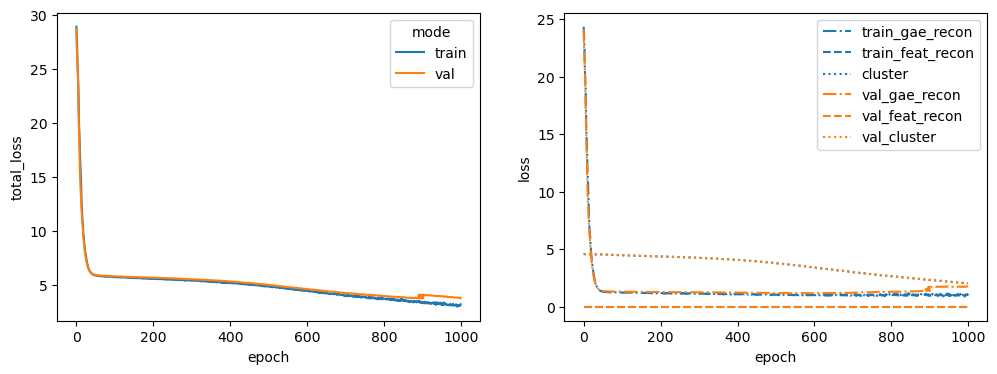

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 26%|██▋       | 2634/10000 [00:55<02:34, 47.76it/s]


Training stopped after 2635 epochs
Best model found at epoch 2533
------------------------------------------------------------
TEST AUC: 0.768888888888889 AP: 0.7920606200047525
TRAIN loss: 1.369696855545044
VAL loss: 1.890915036201477
TEST loss: 1.7337119579315186
TEST AUC: 0.768888888888889 	 AP: 0.7920606200047525


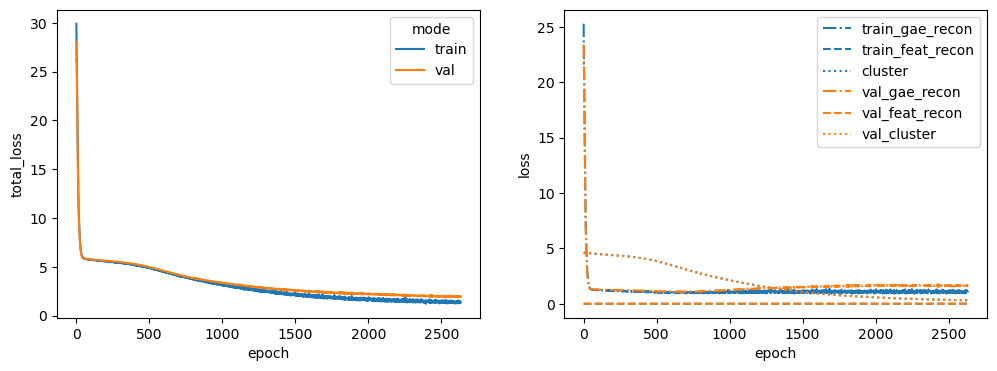

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 47%|████▋     | 4724/10000 [01:38<01:49, 47.98it/s]


Training stopped after 4725 epochs
Best model found at epoch 4623
------------------------------------------------------------
TEST AUC: 0.8017233560090703 AP: 0.807609514555759
TRAIN loss: 0.987790584564209
VAL loss: 1.2838616371154785
TEST loss: 1.3870099782943726
TEST AUC: 0.8017233560090703 	 AP: 0.807609514555759


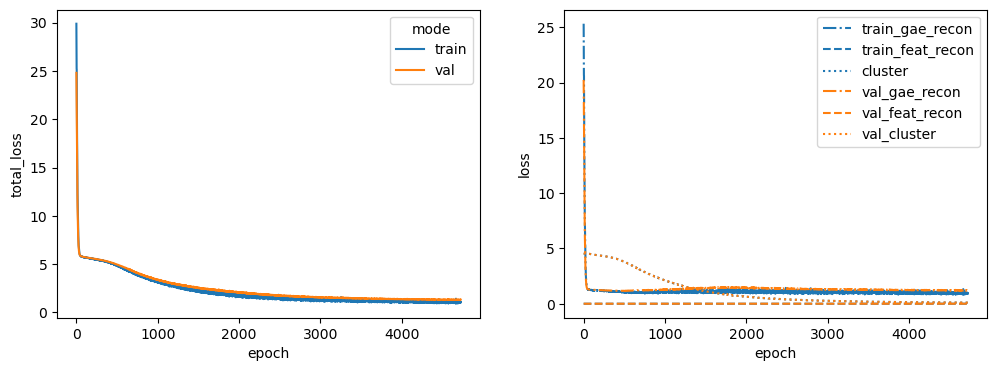

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 31%|███       | 3120/10000 [01:05<02:23, 47.82it/s]


Training stopped after 3121 epochs
Best model found at epoch 3019
------------------------------------------------------------
TEST AUC: 0.7915646258503402 AP: 0.8047873117244022
TRAIN loss: 1.3181787729263306
VAL loss: 1.5037915706634521
TEST loss: 1.6539273262023926
TEST AUC: 0.7915646258503402 	 AP: 0.8047873117244022


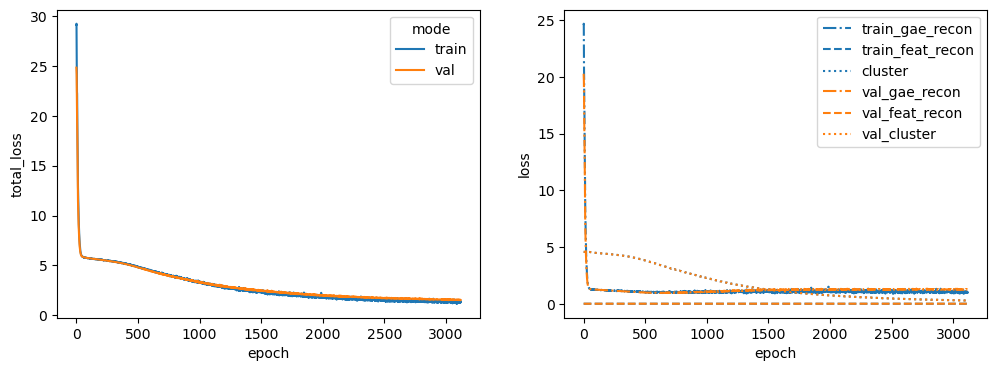

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 28%|██▊       | 2794/10000 [00:59<02:32, 47.20it/s]


Training stopped after 2795 epochs
Best model found at epoch 2693
------------------------------------------------------------
TEST AUC: 0.7765986394557823 AP: 0.781136952812814
TRAIN loss: 1.5123703479766846
VAL loss: 2.0340237617492676
TEST loss: 1.7719314098358154
TEST AUC: 0.7765986394557823 	 AP: 0.781136952812814


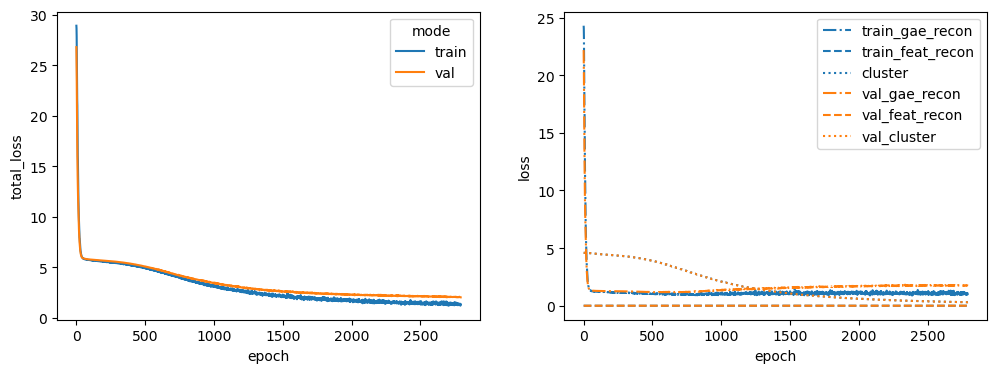

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 36%|███▌      | 3598/10000 [01:16<02:16, 46.91it/s]


Training stopped after 3599 epochs
Best model found at epoch 3497
------------------------------------------------------------
TEST AUC: 0.8392743764172336 AP: 0.8530594582689525
TRAIN loss: 1.130244493484497
VAL loss: 1.4247000217437744
TEST loss: 1.3654627799987793
TEST AUC: 0.8392743764172336 	 AP: 0.8530594582689525


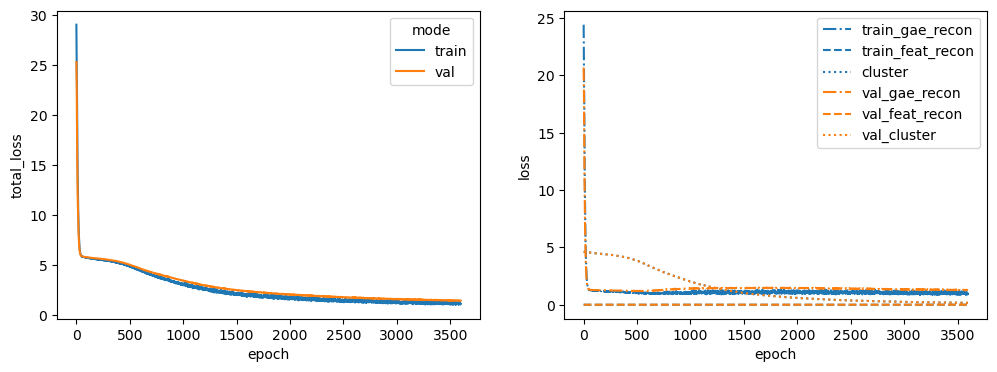

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 30%|███       | 3009/10000 [01:03<02:27, 47.46it/s]


Training stopped after 3010 epochs
Best model found at epoch 2908
------------------------------------------------------------
TEST AUC: 0.8230385487528343 AP: 0.8302290824321423
TRAIN loss: 1.2992719411849976
VAL loss: 1.4664013385772705
TEST loss: 1.5434978008270264
TEST AUC: 0.8230385487528343 	 AP: 0.8302290824321423


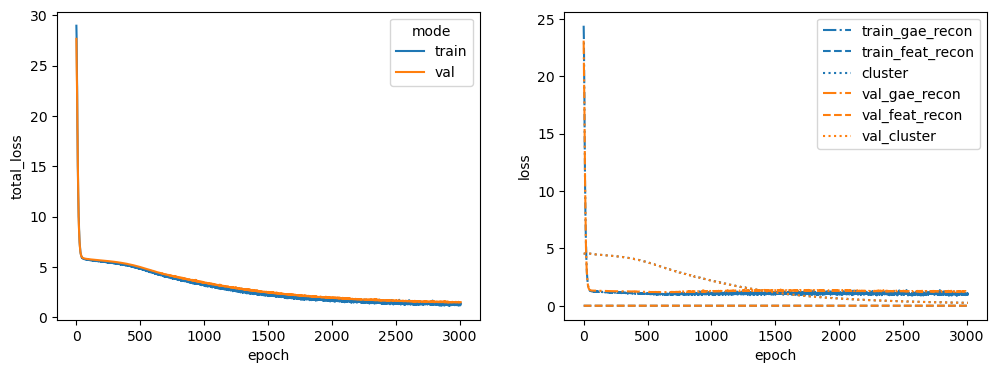

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 37%|███▋      | 3717/10000 [01:18<02:12, 47.51it/s]


Training stopped after 3718 epochs
Best model found at epoch 3616
------------------------------------------------------------
TEST AUC: 0.7742857142857142 AP: 0.7742729268613381
TRAIN loss: 1.1244159936904907
VAL loss: 1.5638731718063354
TEST loss: 1.5749280452728271
TEST AUC: 0.7742857142857142 	 AP: 0.7742729268613381


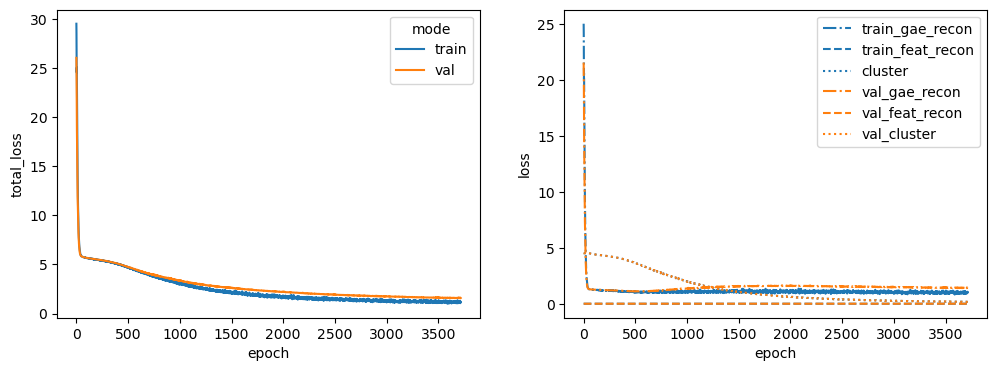

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 32%|███▏      | 3169/10000 [01:07<02:26, 46.67it/s]


Training stopped after 3170 epochs
Best model found at epoch 3068
------------------------------------------------------------
TEST AUC: 0.7917460317460319 AP: 0.8089475636870955
TRAIN loss: 1.2275723218917847
VAL loss: 1.40706467628479
TEST loss: 1.688673973083496
TEST AUC: 0.7917460317460319 	 AP: 0.8089475636870955


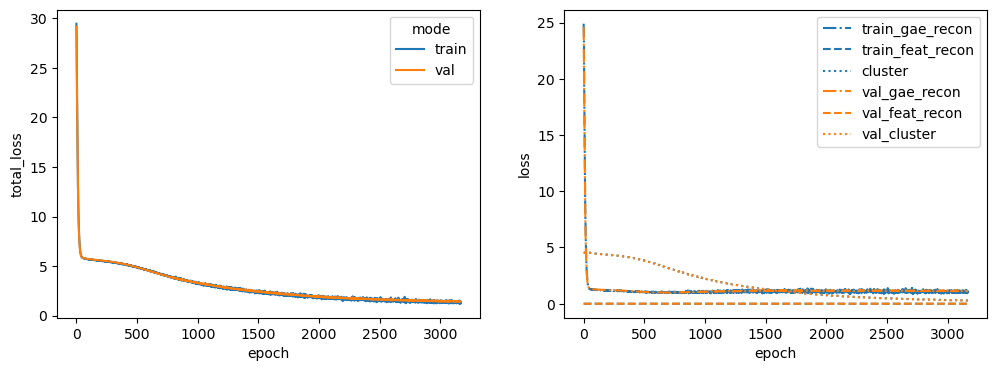

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 35%|███▌      | 3527/10000 [01:14<02:15, 47.65it/s]


Training stopped after 3528 epochs
Best model found at epoch 3426
------------------------------------------------------------
TEST AUC: 0.7803174603174603 AP: 0.7936273231971677
TRAIN loss: 1.320680022239685
VAL loss: 1.6990798711776733
TEST loss: 1.613109827041626
TEST AUC: 0.7803174603174603 	 AP: 0.7936273231971677


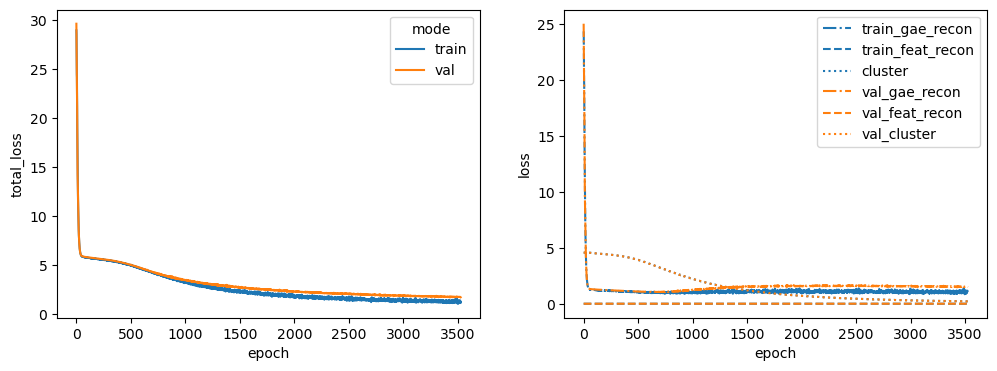

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 30%|███       | 3003/10000 [01:02<02:24, 48.36it/s]


Training stopped after 3004 epochs
Best model found at epoch 2902
------------------------------------------------------------
TEST AUC: 0.8198639455782312 AP: 0.8411274902661097
TRAIN loss: 1.3982537984848022
VAL loss: 1.9259992837905884
TEST loss: 1.5223169326782227
TEST AUC: 0.8198639455782312 	 AP: 0.8411274902661097


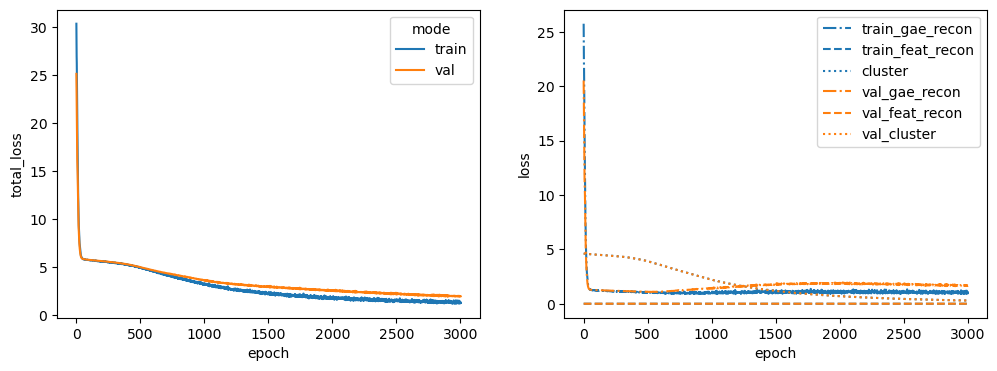

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 58%|█████▊    | 5776/10000 [02:00<01:27, 48.07it/s]


Training stopped after 5777 epochs
Best model found at epoch 5675
------------------------------------------------------------
TEST AUC: 0.8436281179138322 AP: 0.8654224847758301
TRAIN loss: 0.8967270255088806
VAL loss: 1.6388564109802246
TEST loss: 1.1622816324234009
TEST AUC: 0.8436281179138322 	 AP: 0.8654224847758301


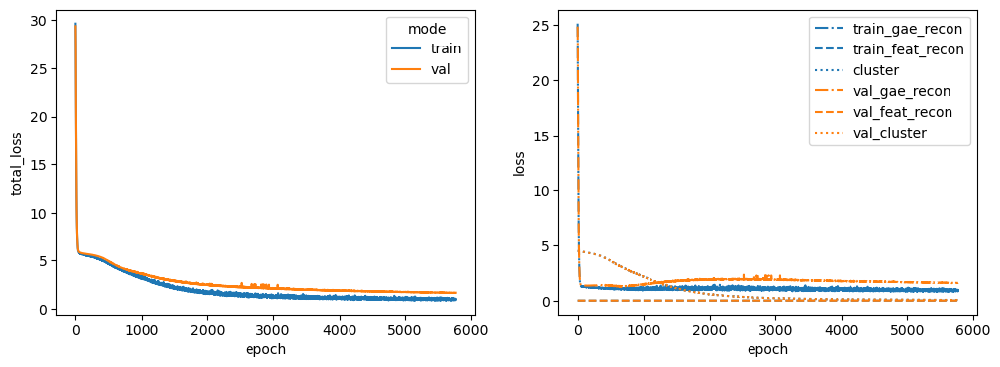

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 40%|███▉      | 3954/10000 [01:23<02:07, 47.49it/s]


Training stopped after 3955 epochs
Best model found at epoch 3853
------------------------------------------------------------
TEST AUC: 0.7775963718820862 AP: 0.7588351591354167
TRAIN loss: 1.0623688697814941
VAL loss: 1.5168834924697876
TEST loss: 1.7625218629837036
TEST AUC: 0.7775963718820862 	 AP: 0.7588351591354167


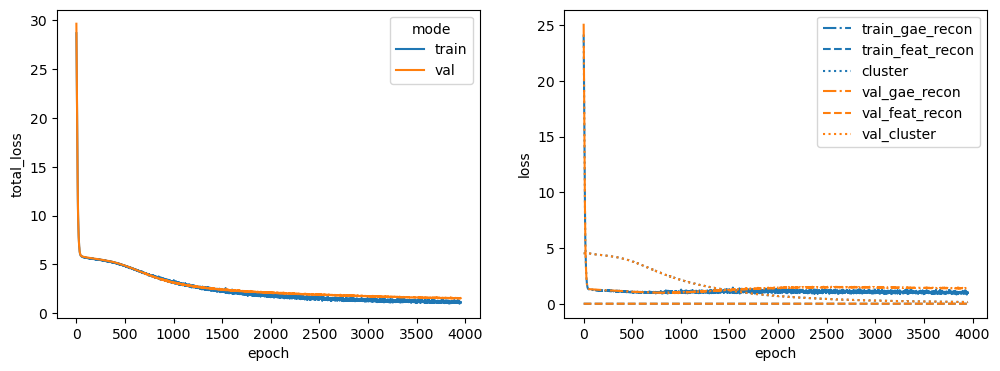

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 43%|████▎     | 4332/10000 [01:29<01:57, 48.29it/s]


Training stopped after 4333 epochs
Best model found at epoch 4231
------------------------------------------------------------
TEST AUC: 0.7783219954648526 AP: 0.7630454874235741
TRAIN loss: 1.0020930767059326
VAL loss: 1.4436240196228027
TEST loss: 1.5785937309265137
TEST AUC: 0.7783219954648526 	 AP: 0.7630454874235741


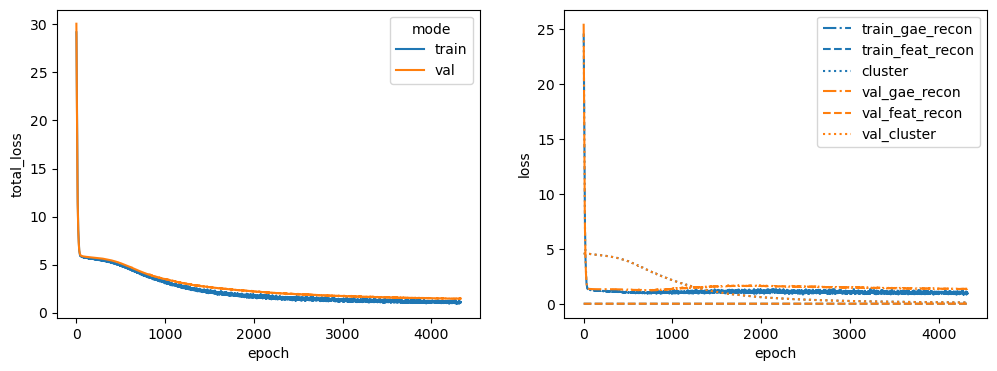

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 44%|████▎     | 4352/10000 [01:30<01:58, 47.85it/s]


Training stopped after 4353 epochs
Best model found at epoch 4251
------------------------------------------------------------
TEST AUC: 0.8101587301587302 AP: 0.8060697107248653
TRAIN loss: 1.0802687406539917
VAL loss: 1.2601416110992432
TEST loss: 1.3842591047286987
TEST AUC: 0.8101587301587302 	 AP: 0.8060697107248653


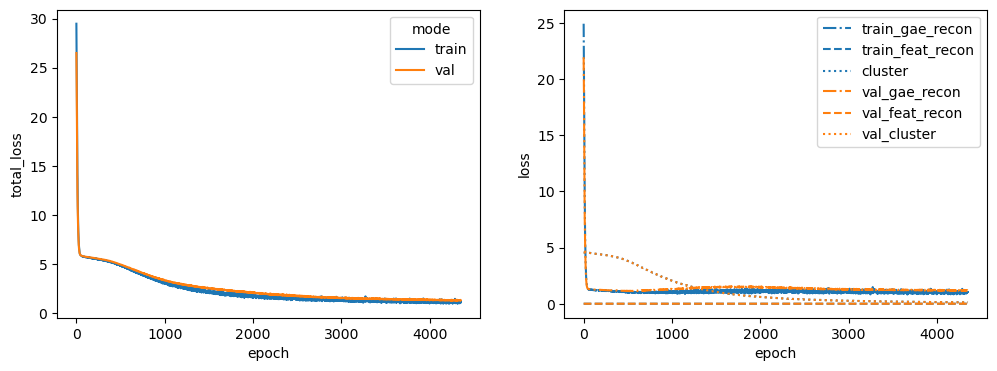

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 43%|████▎     | 4276/10000 [01:30<02:00, 47.48it/s]


Training stopped after 4277 epochs
Best model found at epoch 4175
------------------------------------------------------------
TEST AUC: 0.8556916099773242 AP: 0.8662555641580162
TRAIN loss: 1.0842323303222656
VAL loss: 1.902552604675293
TEST loss: 1.209351897239685
TEST AUC: 0.8556916099773242 	 AP: 0.8662555641580162


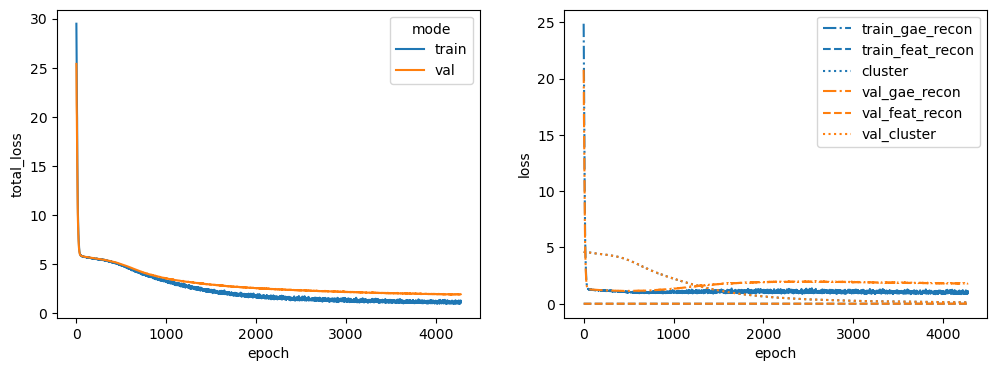

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 57%|█████▋    | 5664/10000 [01:58<01:30, 47.97it/s]


Training stopped after 5665 epochs
Best model found at epoch 5563
------------------------------------------------------------
TEST AUC: 0.793469387755102 AP: 0.8029545241260485
TRAIN loss: 1.177253246307373
VAL loss: 1.462263822555542
TEST loss: 1.353886365890503
TEST AUC: 0.793469387755102 	 AP: 0.8029545241260485


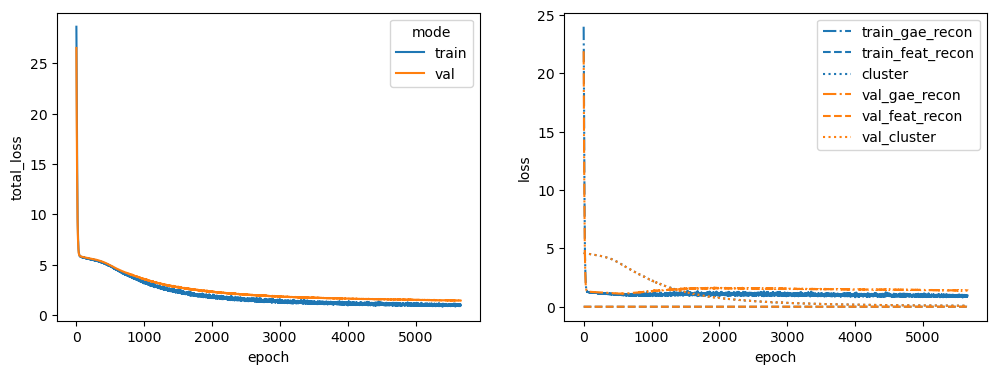

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 41%|████      | 4101/10000 [01:25<02:03, 47.73it/s]


Training stopped after 4102 epochs
Best model found at epoch 4000
------------------------------------------------------------
TEST AUC: 0.8222222222222222 AP: 0.8226961999834486
TRAIN loss: 1.1966700553894043
VAL loss: 1.4991599321365356
TEST loss: 1.4067459106445312
TEST AUC: 0.8222222222222222 	 AP: 0.8226961999834486


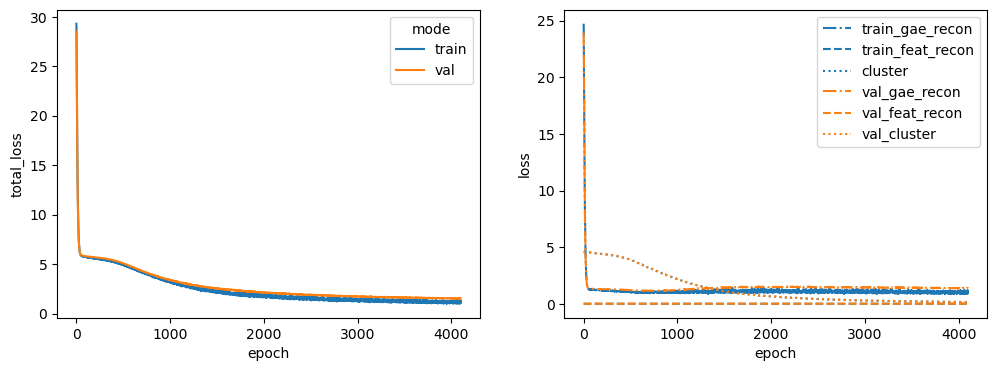

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 26%|██▋       | 2648/10000 [00:56<02:36, 46.83it/s]


Training stopped after 2649 epochs
Best model found at epoch 2547
------------------------------------------------------------
TEST AUC: 0.7835827664399093 AP: 0.7989809250427671
TRAIN loss: 1.5128068923950195
VAL loss: 2.1362929344177246
TEST loss: 1.953628420829773
TEST AUC: 0.7835827664399093 	 AP: 0.7989809250427671


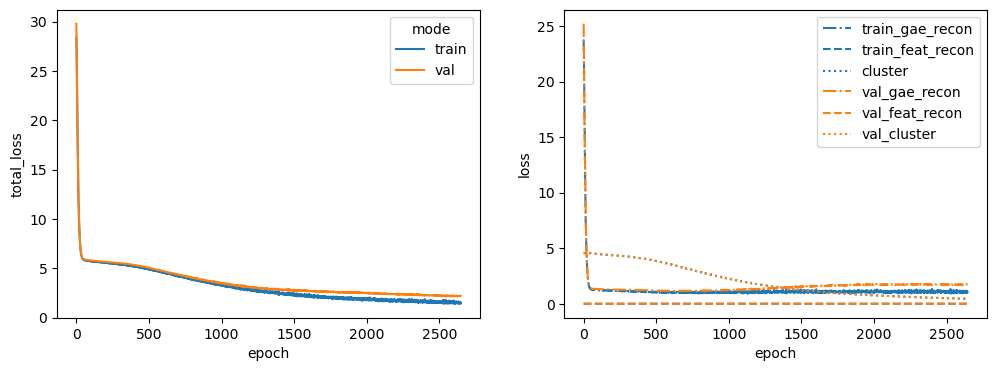

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 43%|████▎     | 4260/10000 [01:28<01:59, 47.88it/s]


Training stopped after 4261 epochs
Best model found at epoch 4159
------------------------------------------------------------
TEST AUC: 0.8214058956916099 AP: 0.8451821235118357
TRAIN loss: 1.173915147781372
VAL loss: 1.490912914276123
TEST loss: 1.2845205068588257
TEST AUC: 0.8214058956916099 	 AP: 0.8451821235118357


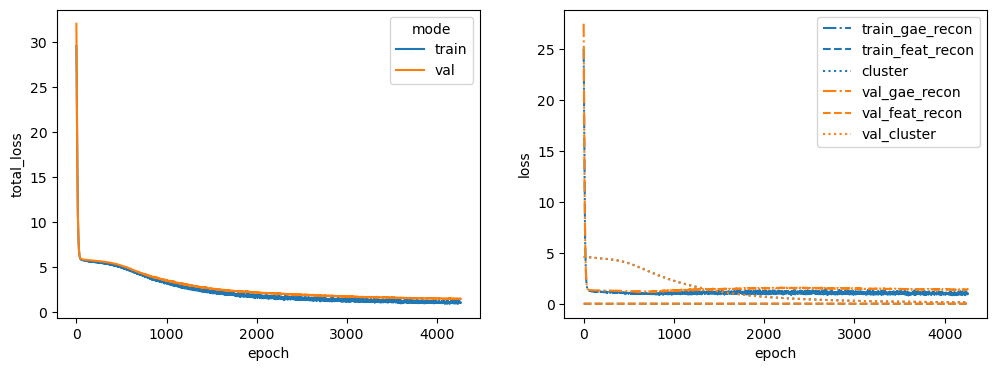

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 47%|████▋     | 4651/10000 [01:37<01:51, 47.91it/s]


Training stopped after 4652 epochs
Best model found at epoch 4550
------------------------------------------------------------
TEST AUC: 0.785124716553288 AP: 0.8130999942137839
TRAIN loss: 1.1719917058944702
VAL loss: 1.3834151029586792
TEST loss: 1.4369415044784546
TEST AUC: 0.785124716553288 	 AP: 0.8130999942137839


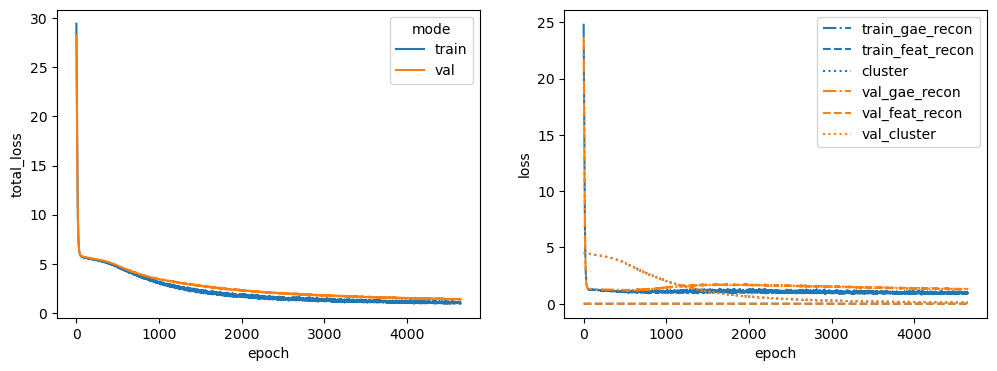

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 28%|██▊       | 2833/10000 [00:58<02:28, 48.34it/s]


Training stopped after 2834 epochs
Best model found at epoch 2732
------------------------------------------------------------
TEST AUC: 0.7941043083900227 AP: 0.8011073026004718
TRAIN loss: 1.354990839958191
VAL loss: 1.8129044771194458
TEST loss: 1.7402360439300537
TEST AUC: 0.7941043083900227 	 AP: 0.8011073026004718


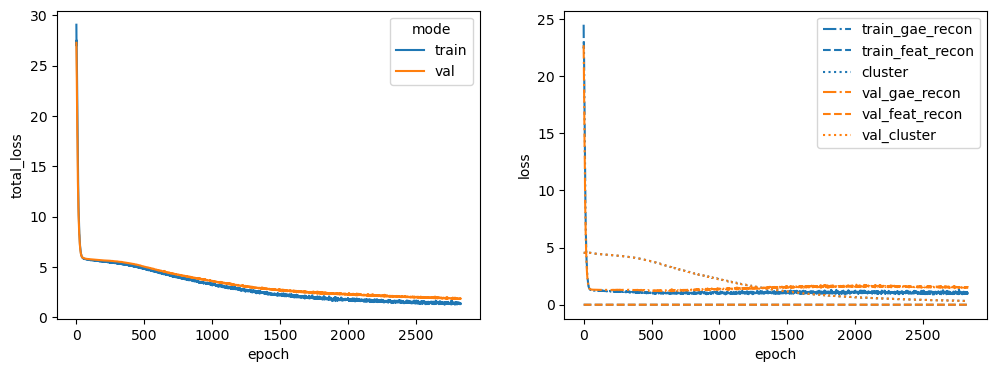

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 32%|███▏      | 3158/10000 [01:06<02:24, 47.37it/s]


Training stopped after 3159 epochs
Best model found at epoch 3057
------------------------------------------------------------
TEST AUC: 0.793015873015873 AP: 0.7650306452760222
TRAIN loss: 1.2957046031951904
VAL loss: 1.5967658758163452
TEST loss: 1.7228776216506958
TEST AUC: 0.793015873015873 	 AP: 0.7650306452760222


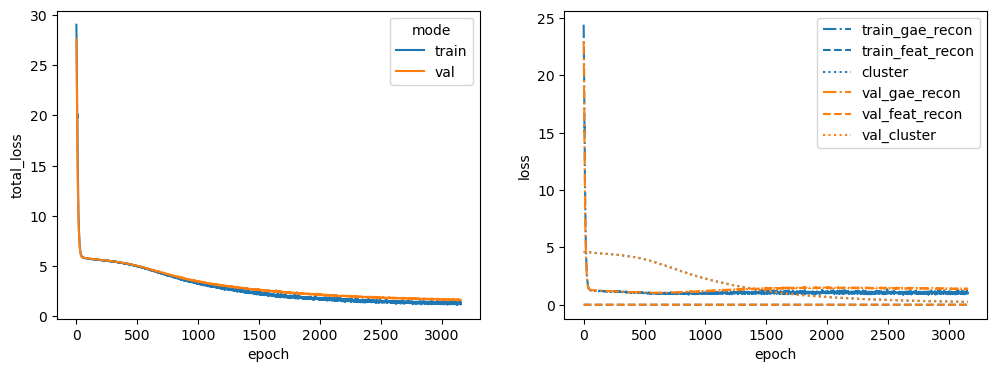

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 56%|█████▋    | 5629/10000 [01:56<01:30, 48.23it/s]


Training stopped after 5630 epochs
Best model found at epoch 5528
------------------------------------------------------------
TEST AUC: 0.8012698412698412 AP: 0.834165516508556
TRAIN loss: 1.0348975658416748
VAL loss: 1.361445426940918
TEST loss: 1.3441402912139893
TEST AUC: 0.8012698412698412 	 AP: 0.834165516508556


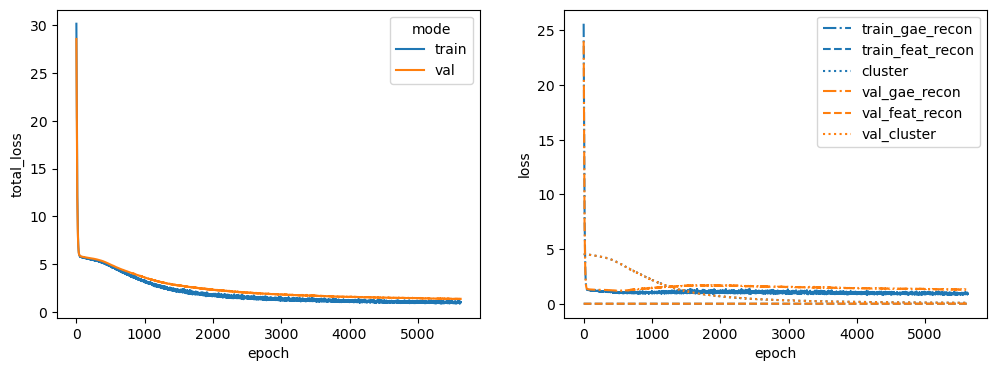

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 38%|███▊      | 3848/10000 [01:20<02:08, 48.02it/s]


Training stopped after 3849 epochs
Best model found at epoch 3747
------------------------------------------------------------
TEST AUC: 0.8097959183673469 AP: 0.8310500077053626
TRAIN loss: 1.1681077480316162
VAL loss: 1.5449382066726685
TEST loss: 1.4211335182189941
TEST AUC: 0.8097959183673469 	 AP: 0.8310500077053626


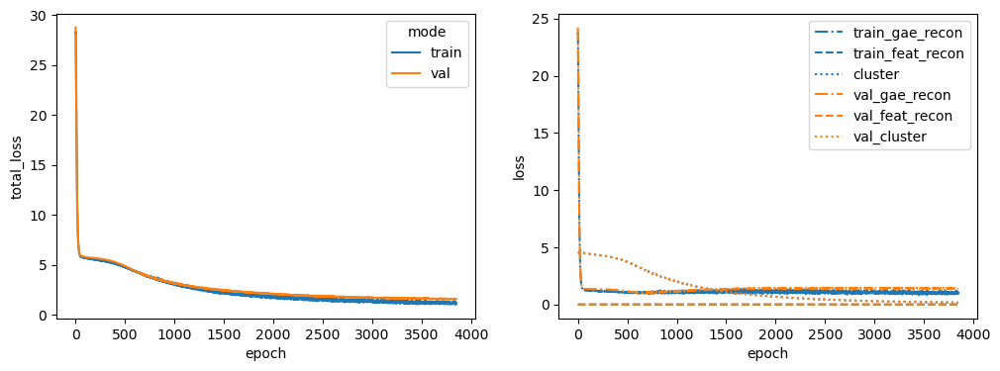

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 26%|██▌       | 2603/10000 [00:54<02:33, 48.20it/s]


Training stopped after 2604 epochs
Best model found at epoch 2502
------------------------------------------------------------
TEST AUC: 0.7756009070294785 AP: 0.7944024926028528
TRAIN loss: 1.627484917640686
VAL loss: 1.9661991596221924
TEST loss: 1.889404535293579
TEST AUC: 0.7756009070294785 	 AP: 0.7944024926028528


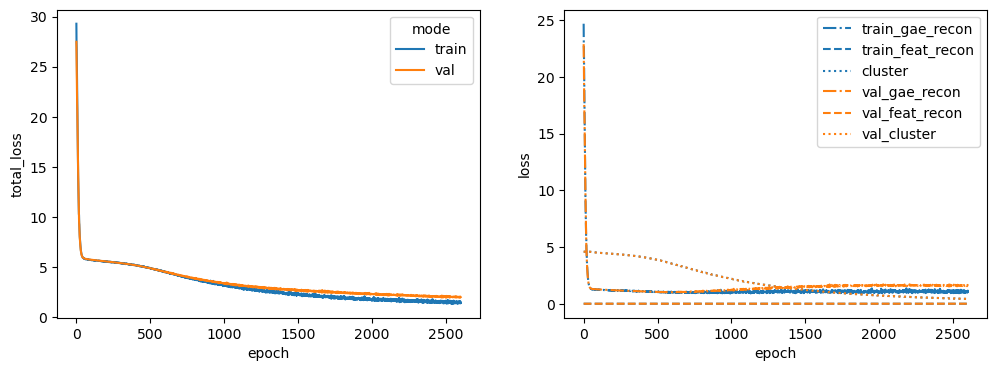

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 64%|██████▍   | 6408/10000 [02:13<01:14, 48.04it/s]


Training stopped after 6409 epochs
Best model found at epoch 6307
------------------------------------------------------------
TEST AUC: 0.8005442176870747 AP: 0.7966174068638394
TRAIN loss: 0.9547467827796936
VAL loss: 1.2010380029678345
TEST loss: 1.3832238912582397
TEST AUC: 0.8005442176870747 	 AP: 0.7966174068638394


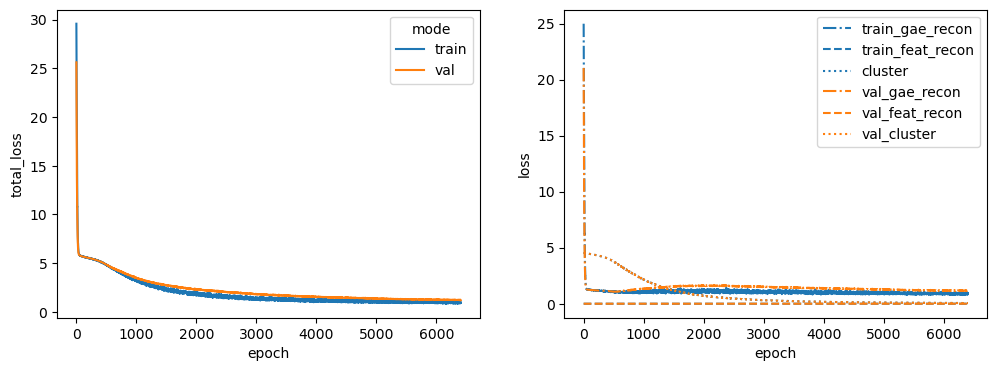

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 37%|███▋      | 3735/10000 [01:19<02:12, 47.19it/s]


Training stopped after 3736 epochs
Best model found at epoch 3634
------------------------------------------------------------
TEST AUC: 0.7658049886621315 AP: 0.75620734754011
TRAIN loss: 1.2147154808044434
VAL loss: 1.5635149478912354
TEST loss: 1.7384145259857178
TEST AUC: 0.7658049886621315 	 AP: 0.75620734754011


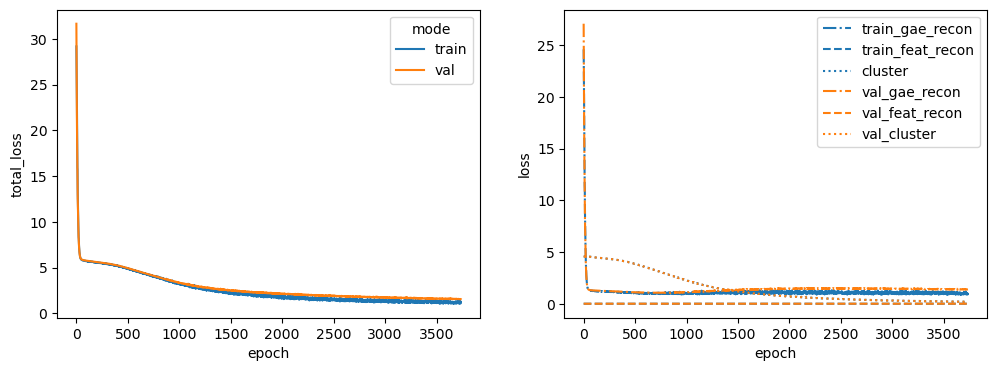

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 40%|███▉      | 3977/10000 [01:22<02:05, 47.95it/s]


Training stopped after 3978 epochs
Best model found at epoch 3876
------------------------------------------------------------
TEST AUC: 0.7972789115646258 AP: 0.797043012761665
TRAIN loss: 1.2827954292297363
VAL loss: 1.270453929901123
TEST loss: 1.5419163703918457
TEST AUC: 0.7972789115646258 	 AP: 0.797043012761665


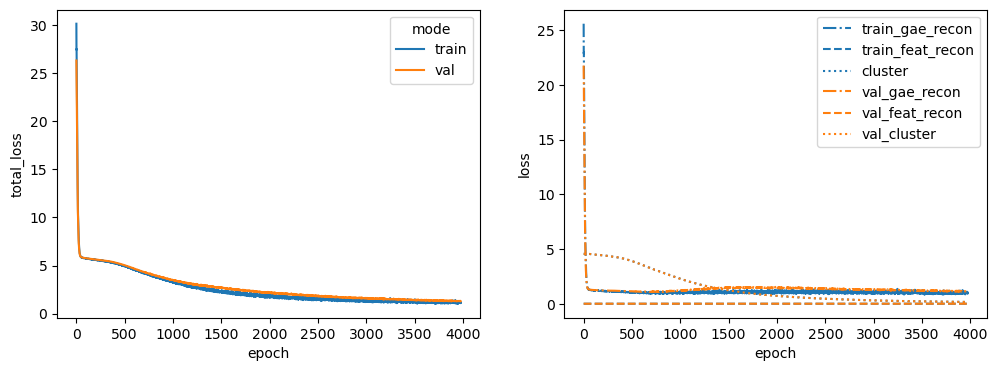

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 40%|███▉      | 3995/10000 [01:25<02:08, 46.55it/s]


Training stopped after 3996 epochs
Best model found at epoch 3894
------------------------------------------------------------
TEST AUC: 0.8075283446712019 AP: 0.800138961146603
TRAIN loss: 1.1162664890289307
VAL loss: 1.3514811992645264
TEST loss: 1.4697022438049316
TEST AUC: 0.8075283446712019 	 AP: 0.800138961146603


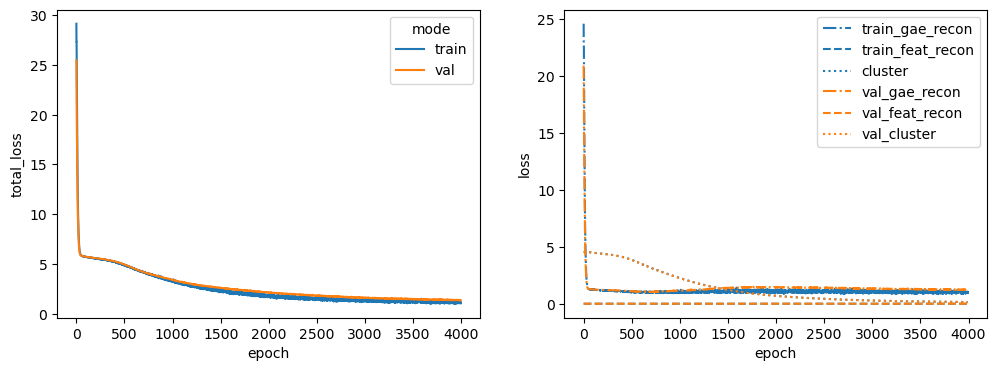

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 35%|███▌      | 3522/10000 [01:13<02:15, 47.80it/s]


Training stopped after 3523 epochs
Best model found at epoch 3421
------------------------------------------------------------
TEST AUC: 0.8209523809523809 AP: 0.8268030896287218
TRAIN loss: 1.1495094299316406
VAL loss: 1.64358389377594
TEST loss: 1.4834625720977783
TEST AUC: 0.8209523809523809 	 AP: 0.8268030896287218


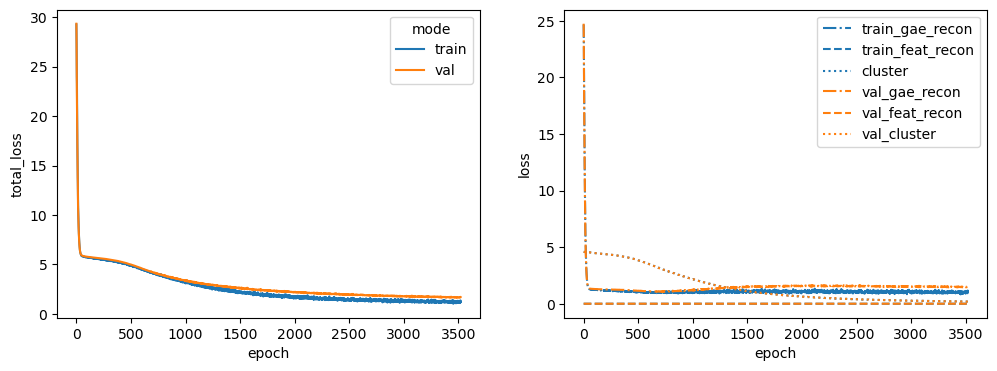

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 38%|███▊      | 3822/10000 [01:20<02:09, 47.59it/s]


Training stopped after 3823 epochs
Best model found at epoch 3721
------------------------------------------------------------
TEST AUC: 0.753922902494331 AP: 0.7323979419217855
TRAIN loss: 1.0967721939086914
VAL loss: 1.4075782299041748
TEST loss: 1.8011952638626099
TEST AUC: 0.753922902494331 	 AP: 0.7323979419217855


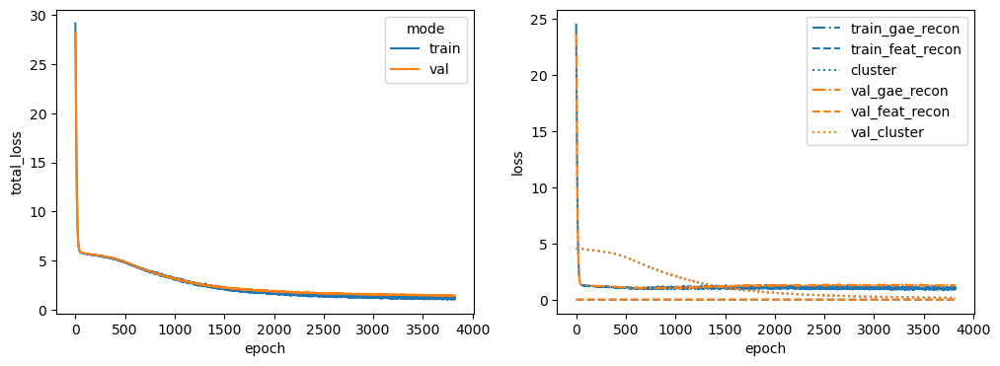

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 38%|███▊      | 3841/10000 [01:20<02:08, 47.94it/s]


Training stopped after 3842 epochs
Best model found at epoch 3740
------------------------------------------------------------
TEST AUC: 0.8180498866213152 AP: 0.8315139261225204
TRAIN loss: 1.1587706804275513
VAL loss: 1.3850929737091064
TEST loss: 1.4301960468292236
TEST AUC: 0.8180498866213152 	 AP: 0.8315139261225204


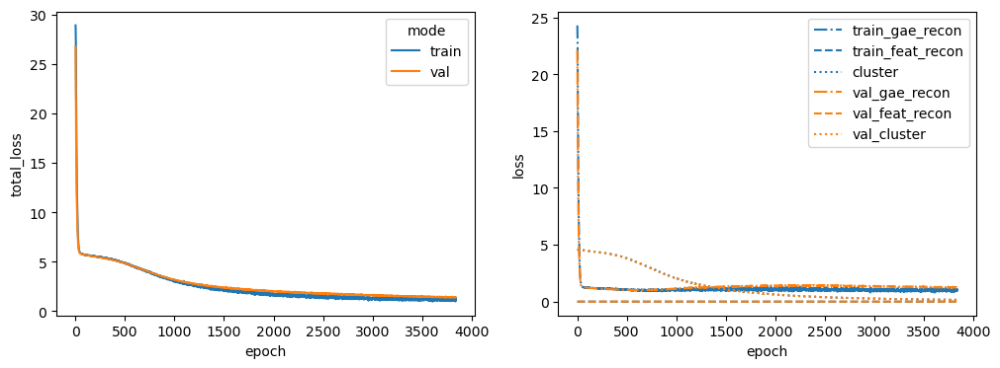

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 43%|████▎     | 4325/10000 [01:30<01:58, 47.74it/s]


Training stopped after 4326 epochs
Best model found at epoch 4224
------------------------------------------------------------
TEST AUC: 0.7974603174603175 AP: 0.8097838978407106
TRAIN loss: 1.1727262735366821
VAL loss: 1.357269048690796
TEST loss: 1.5001943111419678
TEST AUC: 0.7974603174603175 	 AP: 0.8097838978407106


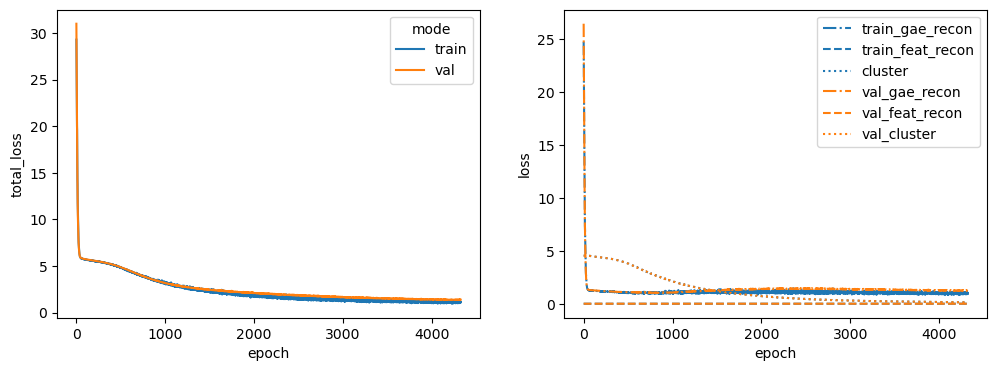

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 53%|█████▎    | 5311/10000 [01:50<01:37, 48.03it/s]


Training stopped after 5312 epochs
Best model found at epoch 5210
------------------------------------------------------------
TEST AUC: 0.7949206349206348 AP: 0.7767950980758833
TRAIN loss: 1.0041496753692627
VAL loss: 1.5870274305343628
TEST loss: 1.5755218267440796
TEST AUC: 0.7949206349206348 	 AP: 0.7767950980758833


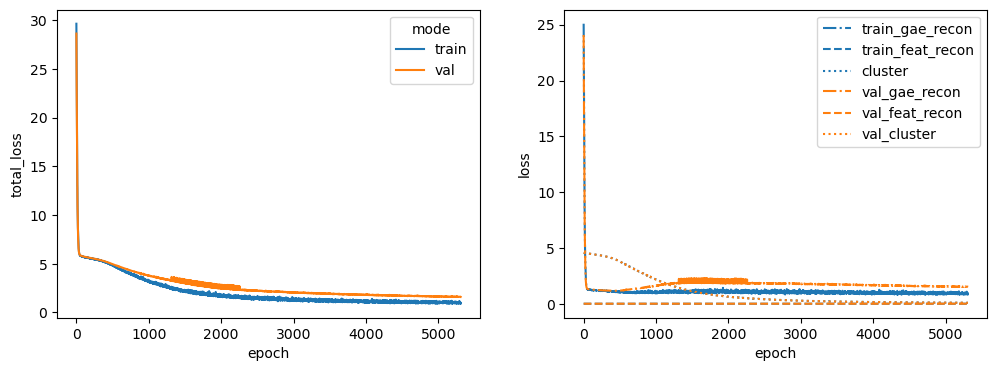

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 35%|███▍      | 3463/10000 [01:13<02:18, 47.11it/s]


Training stopped after 3464 epochs
Best model found at epoch 3362
------------------------------------------------------------
TEST AUC: 0.7949206349206349 AP: 0.8359510018902403
TRAIN loss: 1.2287896871566772
VAL loss: 1.403657078742981
TEST loss: 1.5620862245559692
TEST AUC: 0.7949206349206349 	 AP: 0.8359510018902403


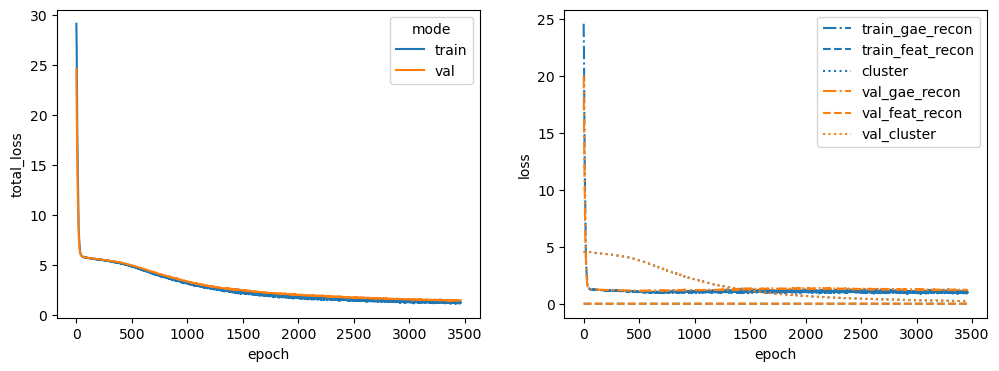

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 44%|████▍     | 4402/10000 [01:31<01:56, 48.19it/s]


Training stopped after 4403 epochs
Best model found at epoch 4301
------------------------------------------------------------
TEST AUC: 0.7834920634920635 AP: 0.7701867950888185
TRAIN loss: 1.3999519348144531
VAL loss: 1.6327085494995117
TEST loss: 1.855419635772705
TEST AUC: 0.7834920634920635 	 AP: 0.7701867950888185


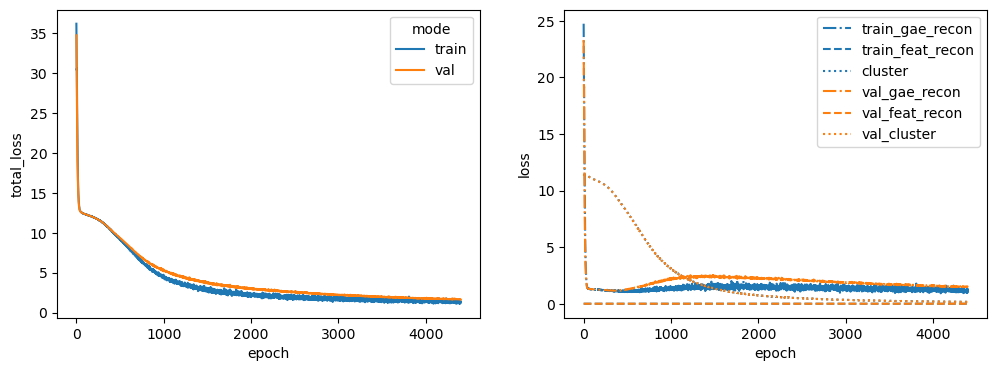

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 34%|███▎      | 3365/10000 [01:11<02:21, 46.79it/s]


Training stopped after 3366 epochs
Best model found at epoch 3264
------------------------------------------------------------
TEST AUC: 0.7763718820861678 AP: 0.75352683495904
TRAIN loss: 1.733980417251587
VAL loss: 1.5067048072814941
TEST loss: 2.2173590660095215
TEST AUC: 0.7763718820861678 	 AP: 0.75352683495904


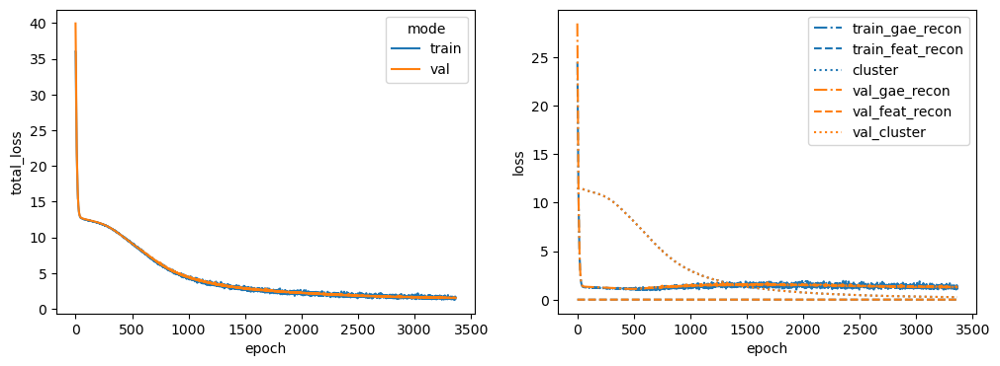

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 32%|███▏      | 3239/10000 [01:08<02:22, 47.57it/s]


Training stopped after 3240 epochs
Best model found at epoch 3138
------------------------------------------------------------
TEST AUC: 0.746938775510204 AP: 0.749645776352386
TRAIN loss: 1.42387056350708
VAL loss: 2.160064220428467
TEST loss: 2.01460862159729
TEST AUC: 0.746938775510204 	 AP: 0.749645776352386


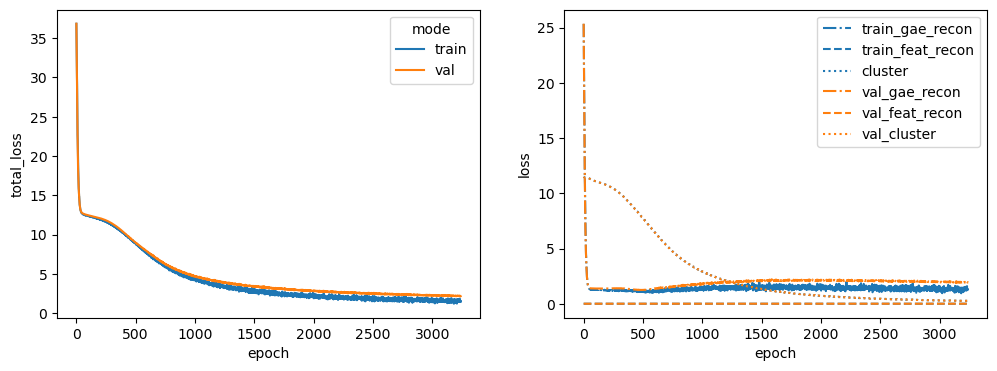

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 12%|█▏        | 1241/10000 [00:25<03:02, 47.91it/s]


Training stopped after 1242 epochs
Best model found at epoch 1140
------------------------------------------------------------
TEST AUC: 0.7540136054421769 AP: 0.7245644529020157
TRAIN loss: 3.950387954711914
VAL loss: 4.230722427368164
TEST loss: 4.575756072998047
TEST AUC: 0.7540136054421769 	 AP: 0.7245644529020157


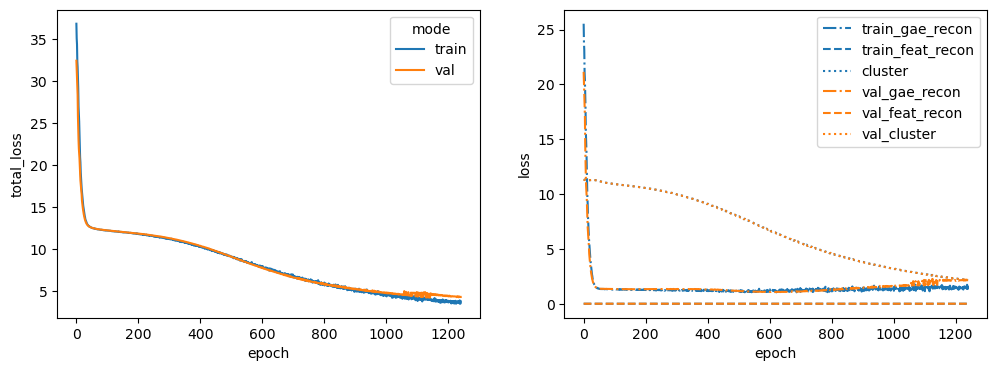

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 27%|██▋       | 2666/10000 [00:55<02:32, 48.04it/s]


Training stopped after 2667 epochs
Best model found at epoch 2565
------------------------------------------------------------
TEST AUC: 0.7267573696145124 AP: 0.7184890334069749
TRAIN loss: 1.706902265548706
VAL loss: 2.106186628341675
TEST loss: 2.4033730030059814
TEST AUC: 0.7267573696145124 	 AP: 0.7184890334069749


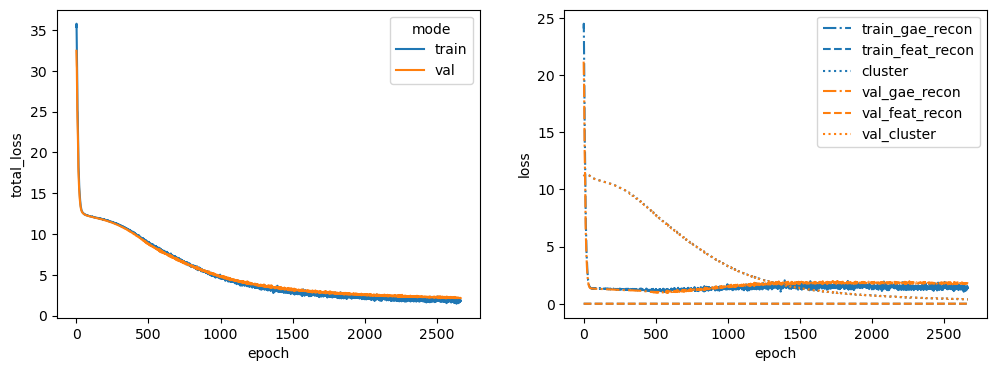

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 41%|████▏     | 4142/10000 [01:27<02:03, 47.35it/s]


Training stopped after 4143 epochs
Best model found at epoch 4041
------------------------------------------------------------
TEST AUC: 0.7743764172335602 AP: 0.7822554184619048
TRAIN loss: 1.5589922666549683
VAL loss: 1.9987390041351318
TEST loss: 1.9310381412506104
TEST AUC: 0.7743764172335602 	 AP: 0.7822554184619048


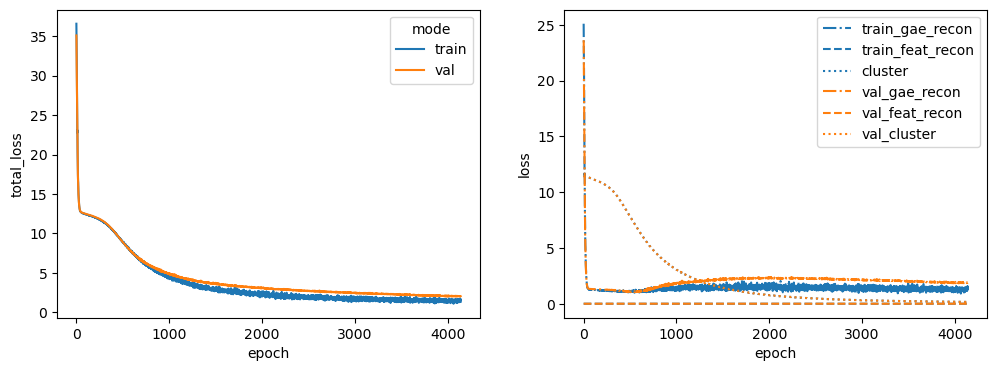

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 38%|███▊      | 3797/10000 [01:20<02:11, 47.13it/s]


Training stopped after 3798 epochs
Best model found at epoch 3696
------------------------------------------------------------
TEST AUC: 0.7607256235827663 AP: 0.7875591417722612
TRAIN loss: 1.6960585117340088
VAL loss: 1.354705810546875
TEST loss: 1.689652919769287
TEST AUC: 0.7607256235827663 	 AP: 0.7875591417722612


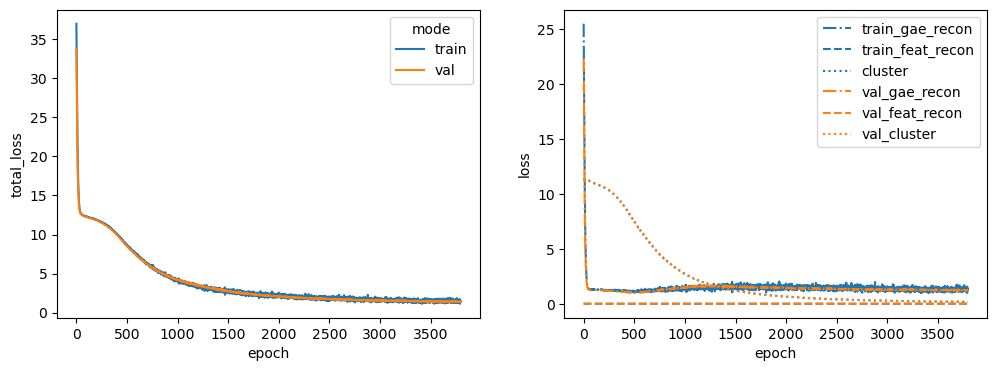

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 25%|██▌       | 2532/10000 [00:53<02:36, 47.61it/s]


Training stopped after 2533 epochs
Best model found at epoch 2431
------------------------------------------------------------
TEST AUC: 0.7850793650793652 AP: 0.7616284752725728
TRAIN loss: 1.897603988647461
VAL loss: 2.676806926727295
TEST loss: 2.341231346130371
TEST AUC: 0.7850793650793652 	 AP: 0.7616284752725728


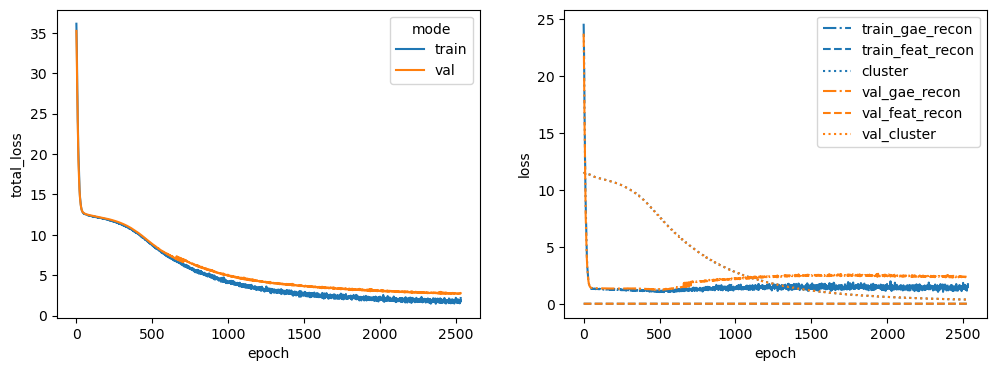

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 12%|█▏        | 1230/10000 [00:26<03:09, 46.38it/s]


Training stopped after 1231 epochs
Best model found at epoch 1129
------------------------------------------------------------
TEST AUC: 0.8058956916099774 AP: 0.8190167590266983
TRAIN loss: 3.6872708797454834
VAL loss: 4.197887420654297
TEST loss: 3.942474365234375
TEST AUC: 0.8058956916099774 	 AP: 0.8190167590266983


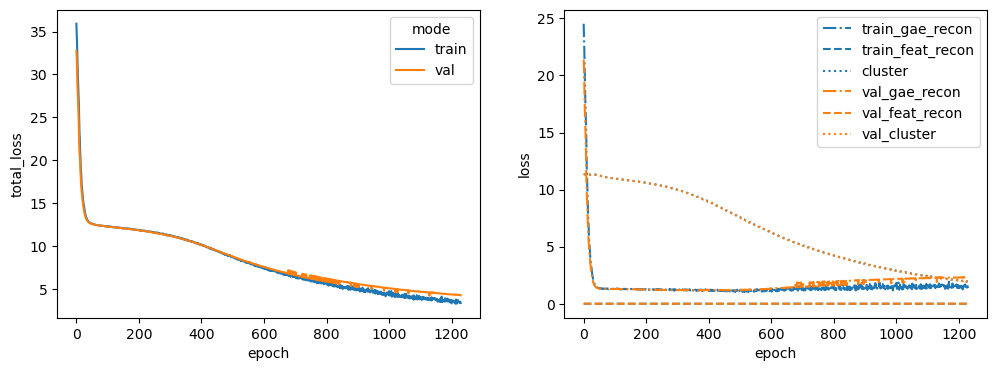

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 38%|███▊      | 3819/10000 [01:19<02:08, 48.14it/s]


Training stopped after 3820 epochs
Best model found at epoch 3718
------------------------------------------------------------
TEST AUC: 0.7841269841269841 AP: 0.7905314631067758
TRAIN loss: 1.2738187313079834
VAL loss: 1.4934742450714111
TEST loss: 1.827109456062317
TEST AUC: 0.7841269841269841 	 AP: 0.7905314631067758


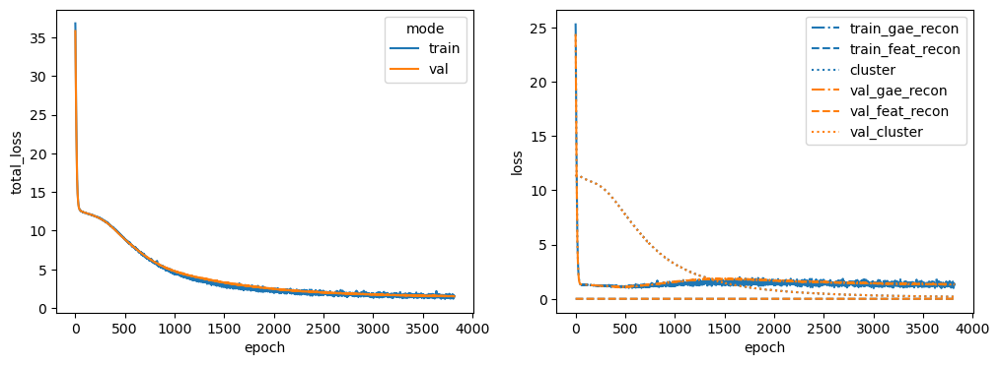

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 24%|██▍       | 2405/10000 [00:50<02:40, 47.31it/s]


Training stopped after 2406 epochs
Best model found at epoch 2304
------------------------------------------------------------
TEST AUC: 0.7804081632653062 AP: 0.7720713095065936
TRAIN loss: 1.905611515045166
VAL loss: 2.1531221866607666
TEST loss: 2.1252570152282715
TEST AUC: 0.7804081632653062 	 AP: 0.7720713095065936


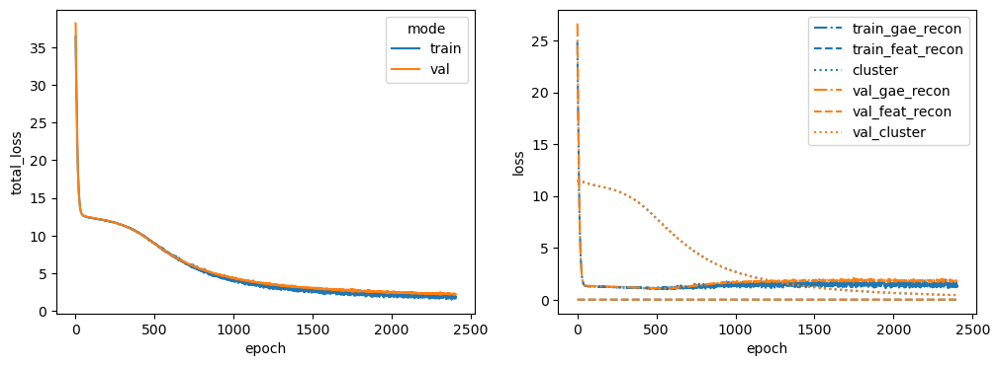

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 19%|█▉        | 1903/10000 [00:39<02:49, 47.85it/s]


Training stopped after 1904 epochs
Best model found at epoch 1802
------------------------------------------------------------
TEST AUC: 0.7734240362811791 AP: 0.7801253354767421
TRAIN loss: 2.678791046142578
VAL loss: 3.031402587890625
TEST loss: 2.5464916229248047
TEST AUC: 0.7734240362811791 	 AP: 0.7801253354767421


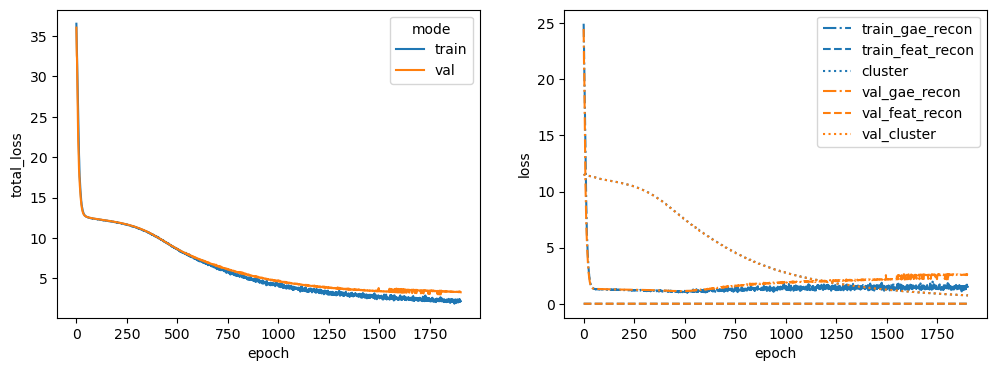

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 31%|███       | 3068/10000 [01:04<02:26, 47.22it/s]


Training stopped after 3069 epochs
Best model found at epoch 2967
------------------------------------------------------------
TEST AUC: 0.7552834467120181 AP: 0.7075916833149672
TRAIN loss: 1.7882025241851807
VAL loss: 1.7707239389419556
TEST loss: 2.60103702545166
TEST AUC: 0.7552834467120181 	 AP: 0.7075916833149672


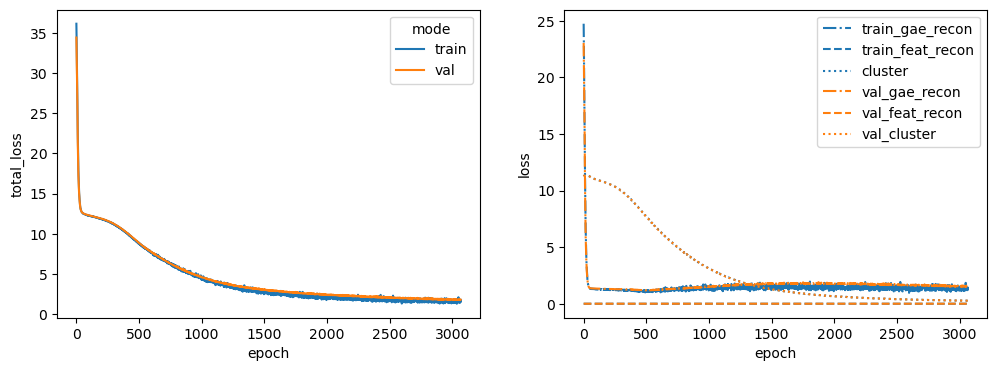

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 48%|████▊     | 4800/10000 [01:41<01:49, 47.31it/s]


Training stopped after 4801 epochs
Best model found at epoch 4699
------------------------------------------------------------
TEST AUC: 0.788390022675737 AP: 0.782569627665884
TRAIN loss: 1.2834899425506592
VAL loss: 1.269689679145813
TEST loss: 1.577972412109375
TEST AUC: 0.788390022675737 	 AP: 0.782569627665884


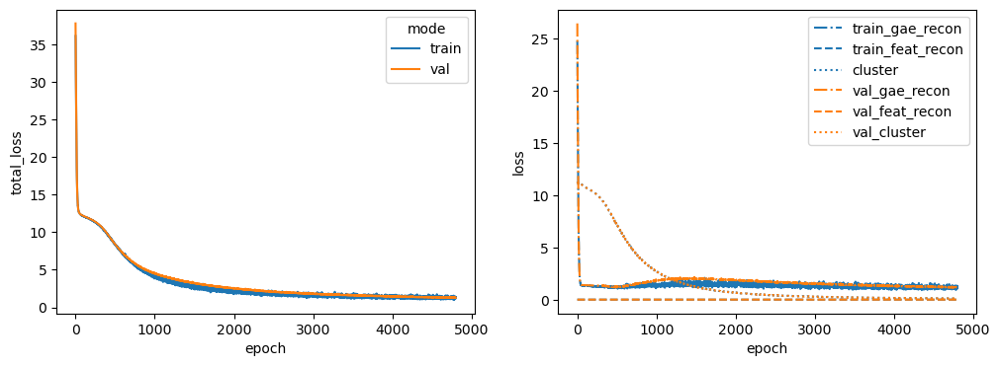

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 26%|██▌       | 2561/10000 [00:55<02:41, 46.06it/s]


Training stopped after 2562 epochs
Best model found at epoch 2460
------------------------------------------------------------
TEST AUC: 0.7413151927437641 AP: 0.7206634996482121
TRAIN loss: 1.929267168045044
VAL loss: 2.3328447341918945
TEST loss: 2.663095474243164
TEST AUC: 0.7413151927437641 	 AP: 0.7206634996482121


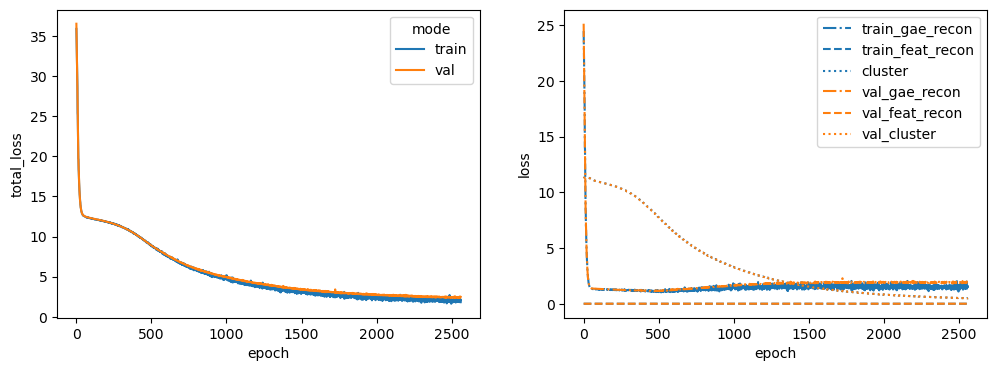

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 57%|█████▋    | 5721/10000 [01:59<01:29, 47.82it/s]


Training stopped after 5722 epochs
Best model found at epoch 5620
------------------------------------------------------------
TEST AUC: 0.8154195011337867 AP: 0.8029583111924955
TRAIN loss: 1.2331080436706543
VAL loss: 2.499171733856201
TEST loss: 1.5085349082946777
TEST AUC: 0.8154195011337867 	 AP: 0.8029583111924955


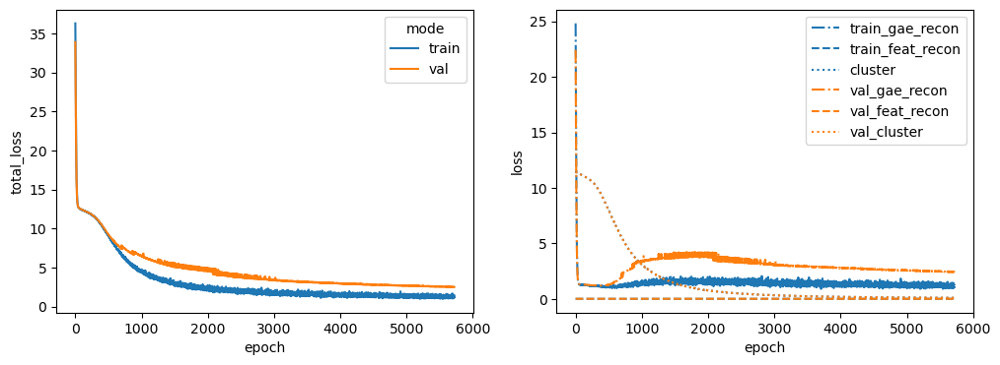

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 13%|█▎        | 1306/10000 [00:27<03:02, 47.67it/s]


Training stopped after 1307 epochs
Best model found at epoch 1205
------------------------------------------------------------
TEST AUC: 0.7715192743764172 AP: 0.7852920727940399
TRAIN loss: 3.663656711578369
VAL loss: 4.583431243896484
TEST loss: 3.9315805435180664
TEST AUC: 0.7715192743764172 	 AP: 0.7852920727940399


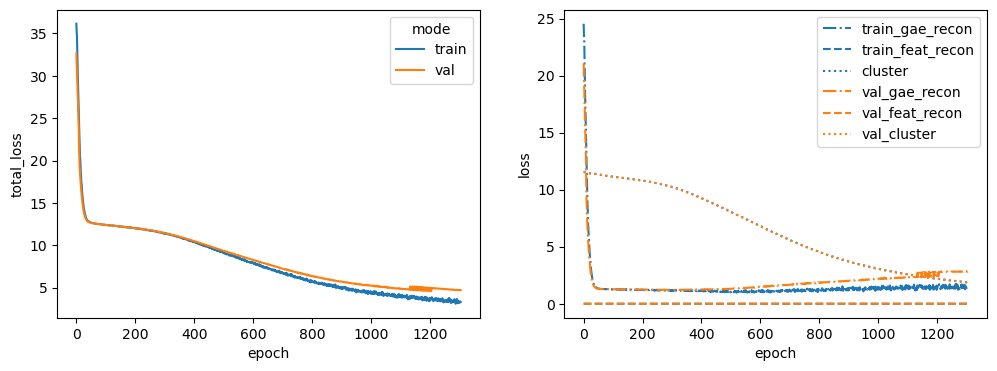

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 40%|███▉      | 3977/10000 [01:22<02:05, 48.11it/s]


Training stopped after 3978 epochs
Best model found at epoch 3876
------------------------------------------------------------
TEST AUC: 0.8155102040816326 AP: 0.8255697888292957
TRAIN loss: 1.459288477897644
VAL loss: 1.4025990962982178
TEST loss: 1.4046576023101807
TEST AUC: 0.8155102040816326 	 AP: 0.8255697888292957


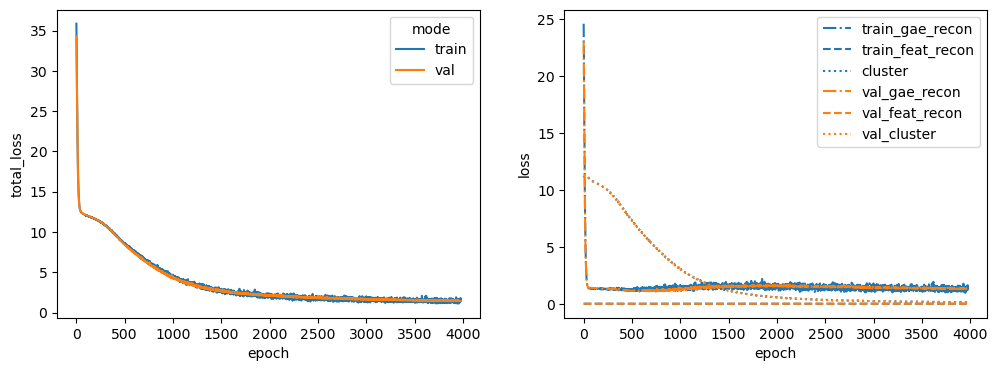

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 43%|████▎     | 4294/10000 [01:30<01:59, 47.59it/s]


Training stopped after 4295 epochs
Best model found at epoch 4193
------------------------------------------------------------
TEST AUC: 0.7326077097505669 AP: 0.7132107198962374
TRAIN loss: 1.280846357345581
VAL loss: 1.4995898008346558
TEST loss: 2.085753917694092
TEST AUC: 0.7326077097505669 	 AP: 0.7132107198962374


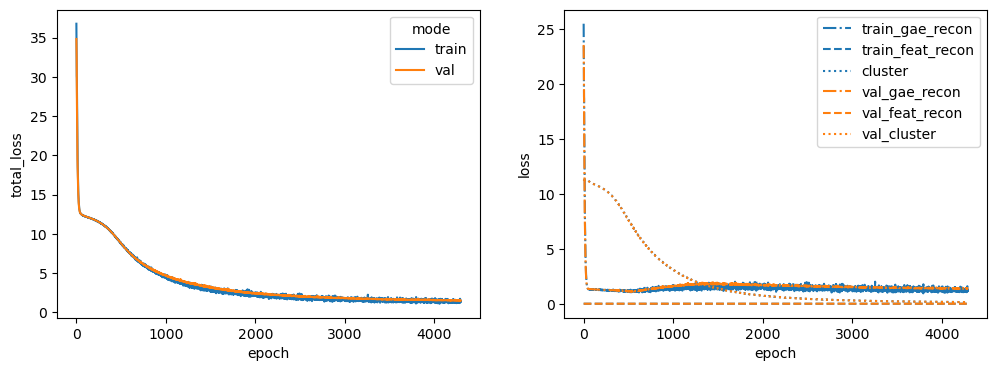

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 25%|██▌       | 2543/10000 [00:53<02:35, 47.83it/s]


Training stopped after 2544 epochs
Best model found at epoch 2442
------------------------------------------------------------
TEST AUC: 0.7615419501133786 AP: 0.7665218624059168
TRAIN loss: 1.9254223108291626
VAL loss: 2.137786865234375
TEST loss: 2.139317750930786
TEST AUC: 0.7615419501133786 	 AP: 0.7665218624059168


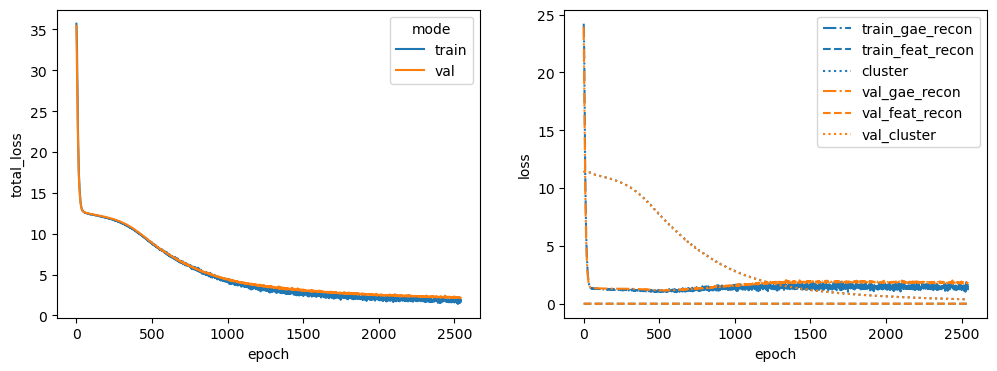

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 32%|███▏      | 3158/10000 [01:05<02:21, 48.33it/s]


Training stopped after 3159 epochs
Best model found at epoch 3057
------------------------------------------------------------
TEST AUC: 0.7262585034013606 AP: 0.7100892197170383
TRAIN loss: 1.496343970298767
VAL loss: 1.693326711654663
TEST loss: 2.319262742996216
TEST AUC: 0.7262585034013606 	 AP: 0.7100892197170383


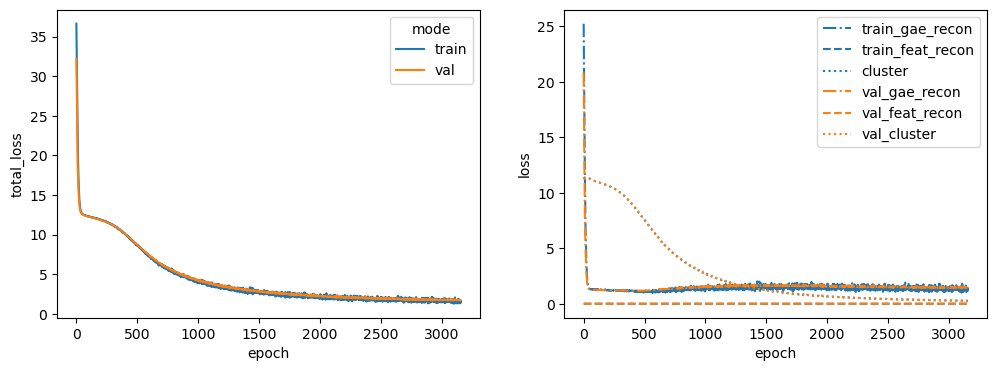

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 30%|███       | 3028/10000 [01:03<02:27, 47.38it/s]


Training stopped after 3029 epochs
Best model found at epoch 2927
------------------------------------------------------------
TEST AUC: 0.8183673469387754 AP: 0.8214044118003052
TRAIN loss: 1.8986601829528809
VAL loss: 2.3315346240997314
TEST loss: 1.7315294742584229
TEST AUC: 0.8183673469387754 	 AP: 0.8214044118003052


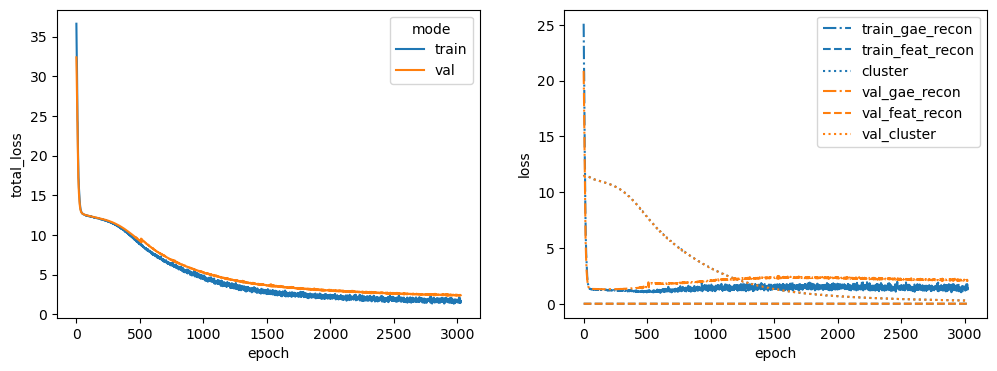

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 36%|███▌      | 3590/10000 [01:16<02:16, 47.09it/s]


Training stopped after 3591 epochs
Best model found at epoch 3489
------------------------------------------------------------
TEST AUC: 0.775328798185941 AP: 0.7608487763151426
TRAIN loss: 1.615681529045105
VAL loss: 1.8353090286254883
TEST loss: 1.9243085384368896
TEST AUC: 0.775328798185941 	 AP: 0.7608487763151426


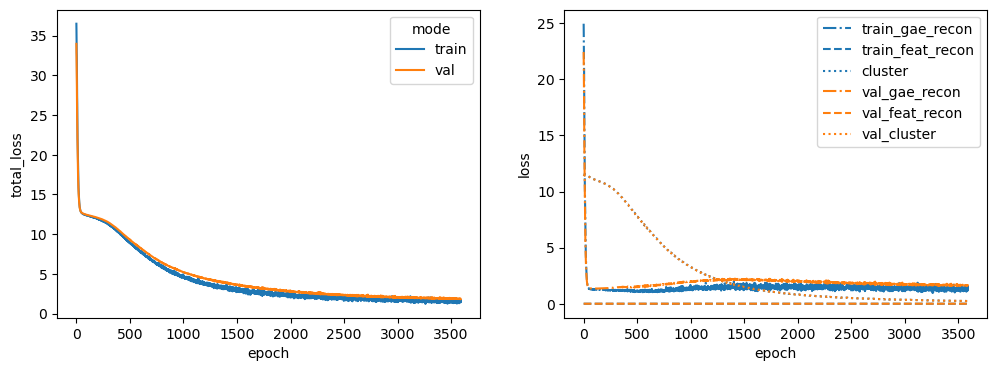

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 13%|█▎        | 1338/10000 [00:28<03:06, 46.44it/s]


Training stopped after 1339 epochs
Best model found at epoch 1237
------------------------------------------------------------
TEST AUC: 0.788344671201814 AP: 0.7673462754740821
TRAIN loss: 3.4700710773468018
VAL loss: 4.638190746307373
TEST loss: 3.9037342071533203
TEST AUC: 0.788344671201814 	 AP: 0.7673462754740821


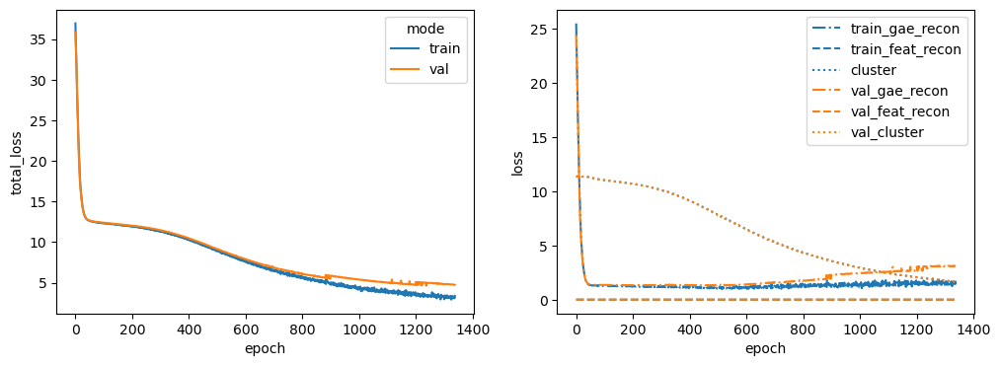

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 34%|███▎      | 3350/10000 [01:11<02:21, 46.94it/s]


Training stopped after 3351 epochs
Best model found at epoch 3249
------------------------------------------------------------
TEST AUC: 0.7741496598639457 AP: 0.774613822570233
TRAIN loss: 1.6317803859710693
VAL loss: 2.0524253845214844
TEST loss: 2.096890926361084
TEST AUC: 0.7741496598639457 	 AP: 0.774613822570233


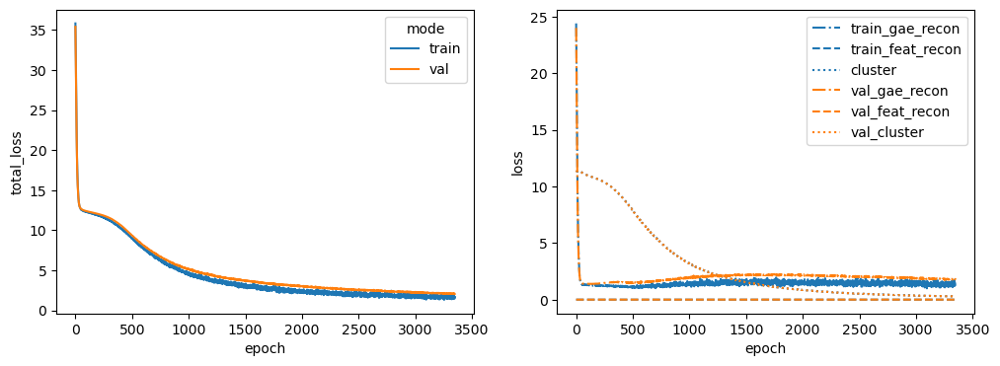

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 38%|███▊      | 3812/10000 [01:19<02:08, 48.17it/s]


Training stopped after 3813 epochs
Best model found at epoch 3711
------------------------------------------------------------
TEST AUC: 0.765124716553288 AP: 0.7529170344386068
TRAIN loss: 1.3738672733306885
VAL loss: 1.8070858716964722
TEST loss: 1.9814754724502563
TEST AUC: 0.765124716553288 	 AP: 0.7529170344386068


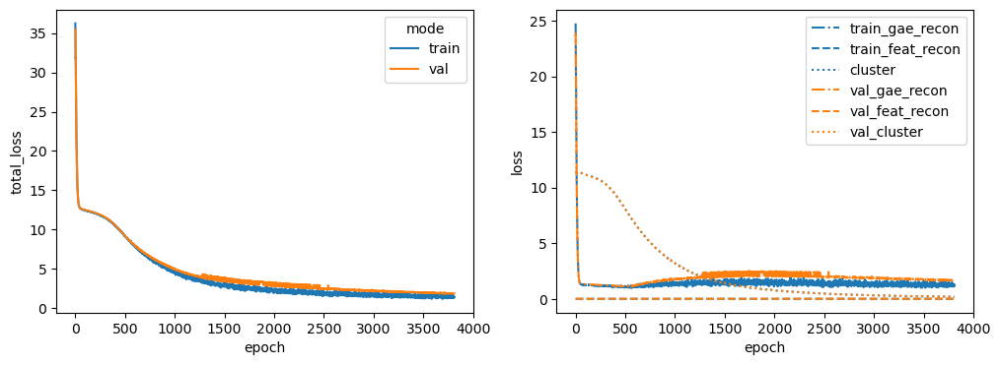

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 44%|████▍     | 4421/10000 [01:33<01:57, 47.36it/s]


Training stopped after 4422 epochs
Best model found at epoch 4320
------------------------------------------------------------
TEST AUC: 0.7927891156462585 AP: 0.7628325461403905
TRAIN loss: 1.3191152811050415
VAL loss: 1.9274873733520508
TEST loss: 1.88875412940979
TEST AUC: 0.7927891156462585 	 AP: 0.7628325461403905


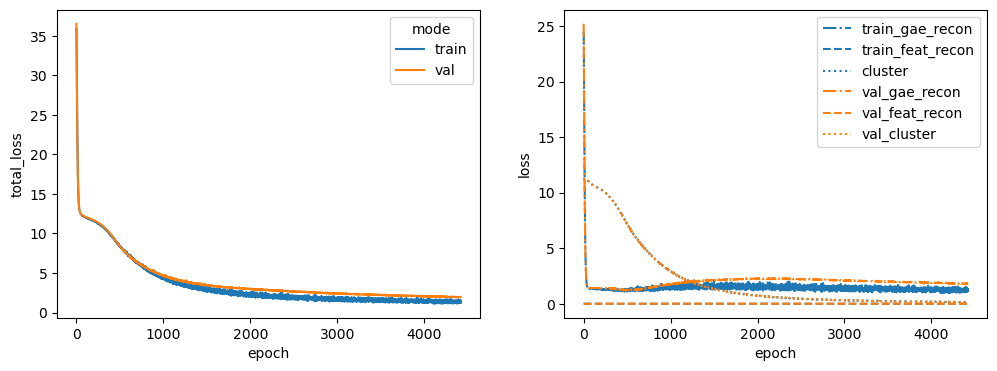

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 15%|█▍        | 1474/10000 [00:31<03:03, 46.40it/s]


Training stopped after 1475 epochs
Best model found at epoch 1373
------------------------------------------------------------
TEST AUC: 0.765986394557823 AP: 0.7491361937825844
TRAIN loss: 2.9177322387695312
VAL loss: 4.6782732009887695
TEST loss: 3.481388568878174
TEST AUC: 0.765986394557823 	 AP: 0.7491361937825844


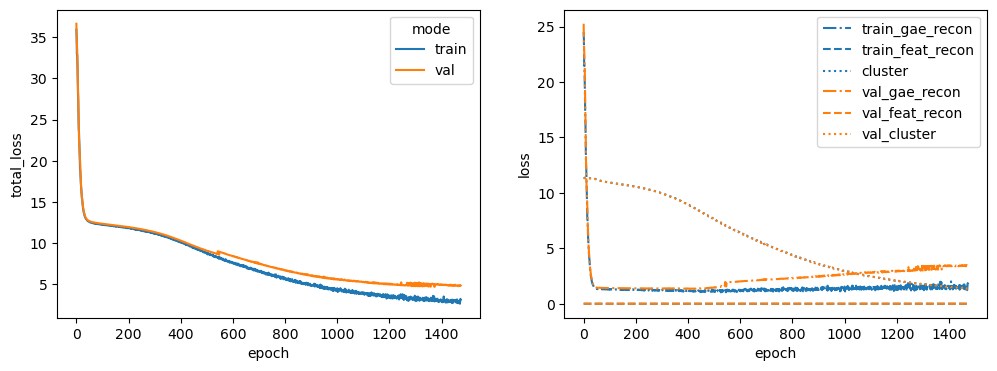

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 28%|██▊       | 2782/10000 [00:58<02:32, 47.23it/s]


Training stopped after 2783 epochs
Best model found at epoch 2681
------------------------------------------------------------
TEST AUC: 0.7647165532879819 AP: 0.7757588728626535
TRAIN loss: 2.078280448913574
VAL loss: 2.0195751190185547
TEST loss: 1.9526965618133545
TEST AUC: 0.7647165532879819 	 AP: 0.7757588728626535


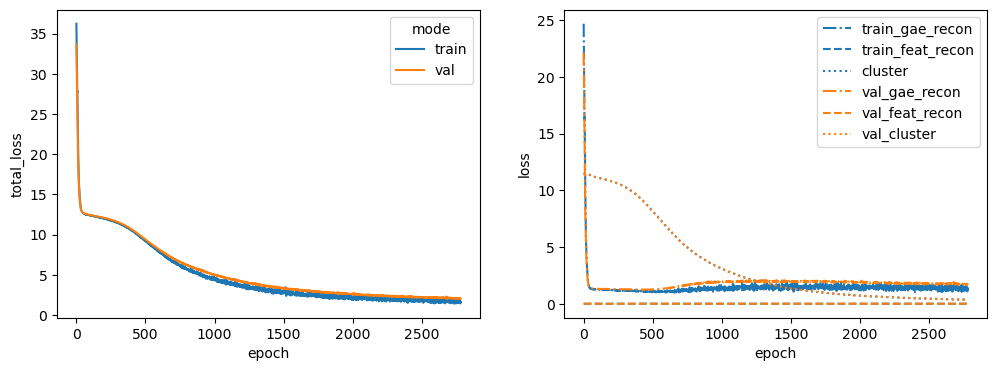

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 28%|██▊       | 2802/10000 [00:59<02:33, 46.99it/s]


Training stopped after 2803 epochs
Best model found at epoch 2701
------------------------------------------------------------
TEST AUC: 0.7377777777777778 AP: 0.6997097817424909
TRAIN loss: 1.612642765045166
VAL loss: 2.3111212253570557
TEST loss: 2.917006731033325
TEST AUC: 0.7377777777777778 	 AP: 0.6997097817424909


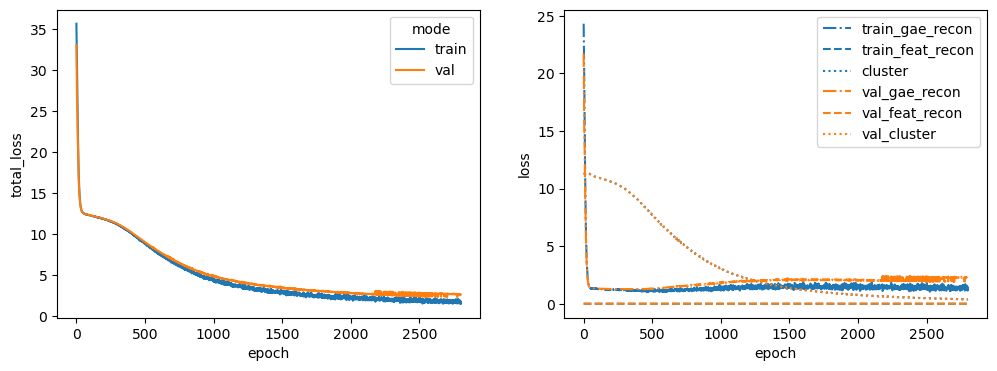

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 13%|█▎        | 1260/10000 [00:27<03:13, 45.27it/s]


Training stopped after 1261 epochs
Best model found at epoch 1159
------------------------------------------------------------
TEST AUC: 0.7490702947845804 AP: 0.7222556246599487
TRAIN loss: 3.722771167755127
VAL loss: 4.0791473388671875
TEST loss: 4.522953033447266
TEST AUC: 0.7490702947845804 	 AP: 0.7222556246599487


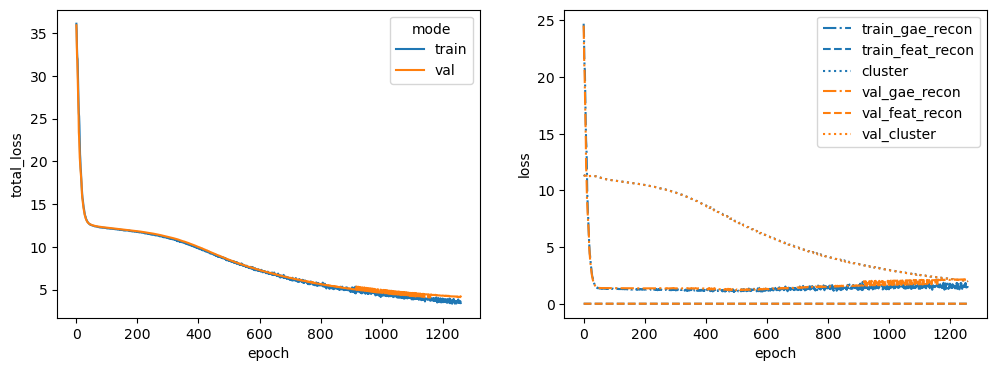

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 47%|████▋     | 4685/10000 [01:38<01:51, 47.79it/s]


Training stopped after 4686 epochs
Best model found at epoch 4584
------------------------------------------------------------
TEST AUC: 0.798639455782313 AP: 0.8279028773042111
TRAIN loss: 1.2031973600387573
VAL loss: 1.4809117317199707
TEST loss: 1.5896754264831543
TEST AUC: 0.798639455782313 	 AP: 0.8279028773042111


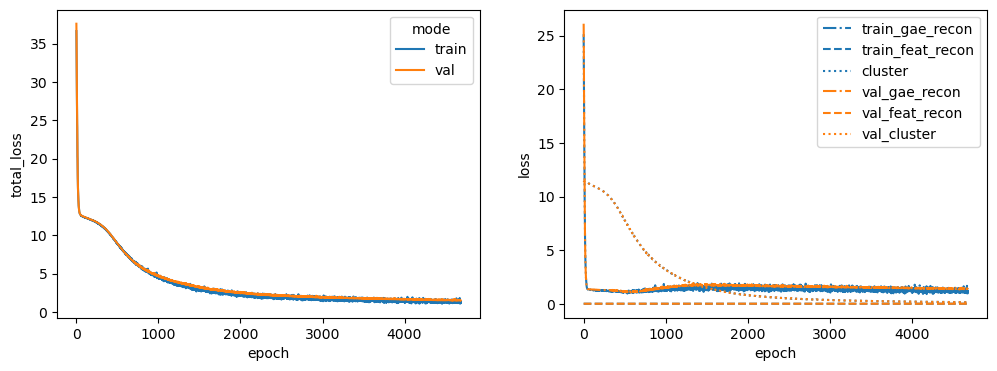

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 12%|█▏        | 1230/10000 [00:27<03:12, 45.46it/s]


Training stopped after 1231 epochs
Best model found at epoch 1129
------------------------------------------------------------
TEST AUC: 0.7921088435374148 AP: 0.7780080856038867
TRAIN loss: 3.913405418395996
VAL loss: 5.438213348388672
TEST loss: 4.2808451652526855
TEST AUC: 0.7921088435374148 	 AP: 0.7780080856038867


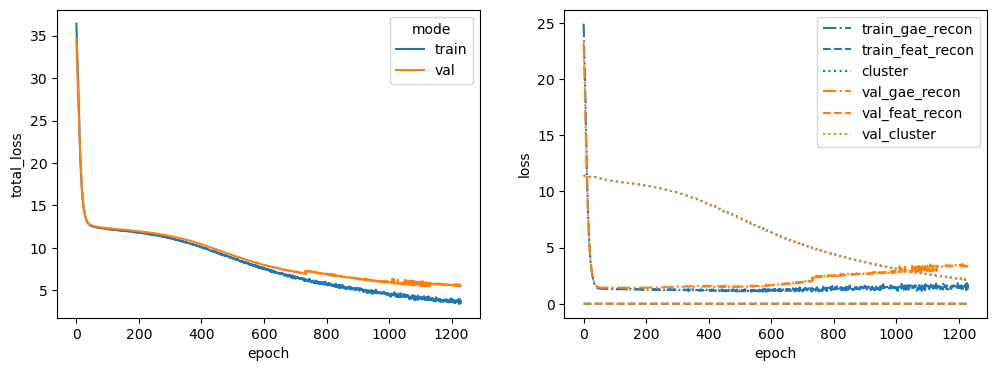

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 30%|███       | 3045/10000 [01:04<02:26, 47.32it/s]


Training stopped after 3046 epochs
Best model found at epoch 2944
------------------------------------------------------------
TEST AUC: 0.8134240362811791 AP: 0.8469600805311699
TRAIN loss: 1.7557451725006104
VAL loss: 1.7526931762695312
TEST loss: 1.7871736288070679
TEST AUC: 0.8134240362811791 	 AP: 0.8469600805311699


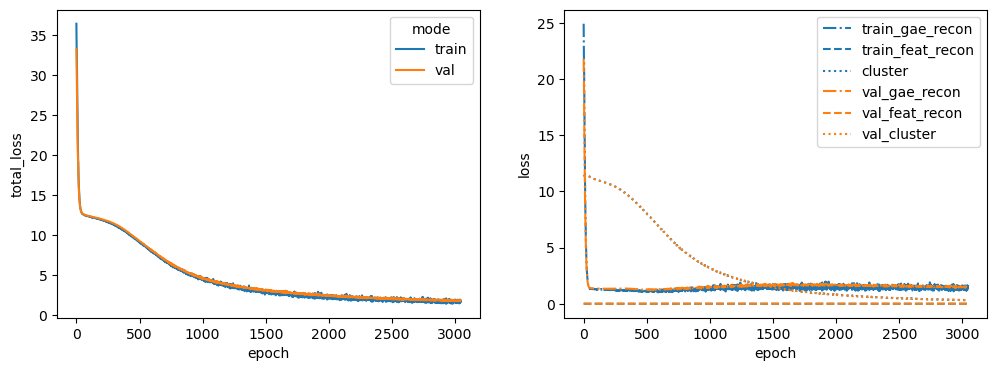

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 41%|████      | 4070/10000 [01:25<02:04, 47.63it/s]


Training stopped after 4071 epochs
Best model found at epoch 3969
------------------------------------------------------------
TEST AUC: 0.7619954648526077 AP: 0.7230971620553817
TRAIN loss: 1.4938856363296509
VAL loss: 1.430769681930542
TEST loss: 2.2437593936920166
TEST AUC: 0.7619954648526077 	 AP: 0.7230971620553817


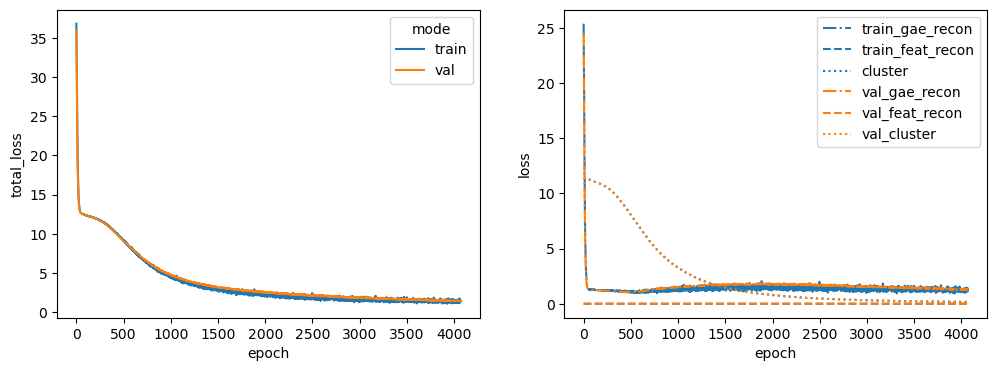

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 46%|████▌     | 4552/10000 [01:36<01:55, 47.11it/s]


Training stopped after 4553 epochs
Best model found at epoch 4451
------------------------------------------------------------
TEST AUC: 0.7662585034013605 AP: 0.7763294373846066
TRAIN loss: 1.2394416332244873
VAL loss: 1.7096372842788696
TEST loss: 1.5886998176574707
TEST AUC: 0.7662585034013605 	 AP: 0.7763294373846066


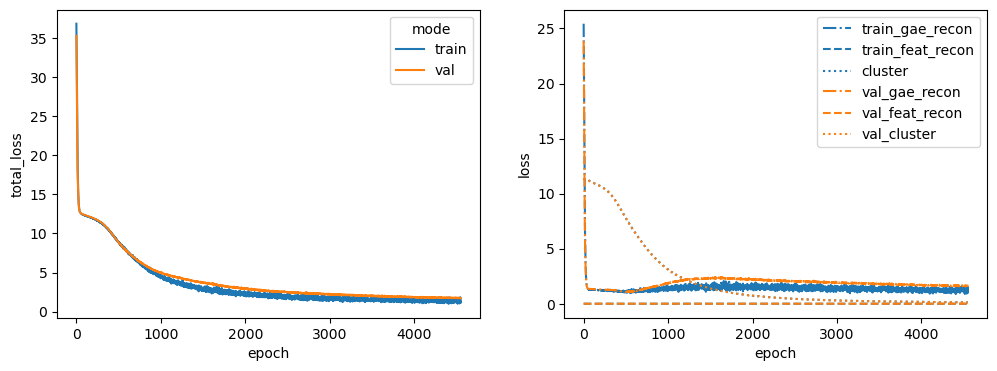

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 40%|███▉      | 3983/10000 [01:24<02:07, 47.13it/s]


Training stopped after 3984 epochs
Best model found at epoch 3882
------------------------------------------------------------
TEST AUC: 0.7720634920634919 AP: 0.744452244541617
TRAIN loss: 1.5548151731491089
VAL loss: 1.8830947875976562
TEST loss: 1.859488606452942
TEST AUC: 0.7720634920634919 	 AP: 0.744452244541617


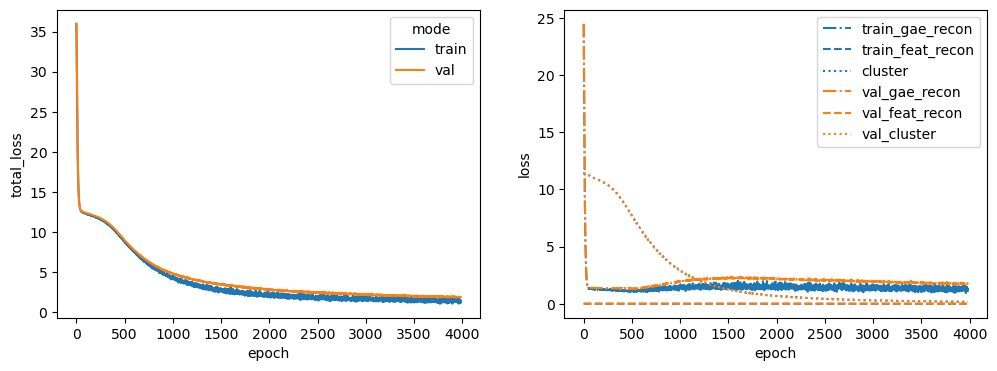

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 19%|█▊        | 1864/10000 [00:40<02:55, 46.29it/s]


Training stopped after 1865 epochs
Best model found at epoch 1763
------------------------------------------------------------
TEST AUC: 0.7196371882086169 AP: 0.6687691210340806
TRAIN loss: 2.436347007751465
VAL loss: 3.31829571723938
TEST loss: 3.6401724815368652
TEST AUC: 0.7196371882086169 	 AP: 0.6687691210340806


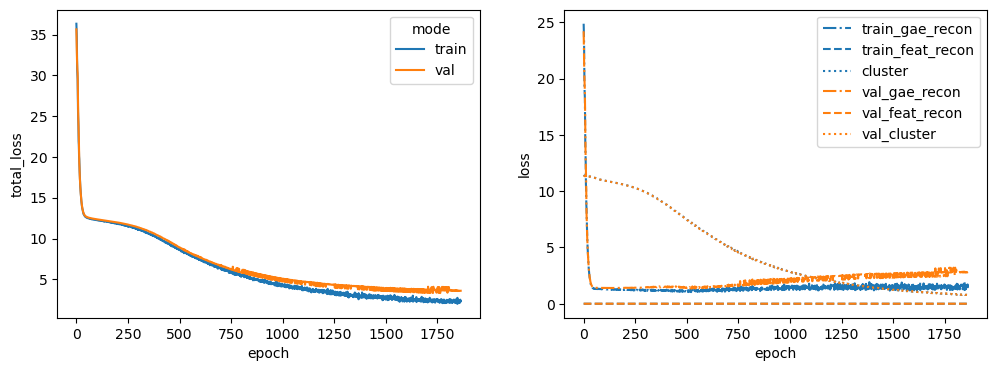

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 12%|█▏        | 1223/10000 [00:26<03:11, 45.91it/s]


Training stopped after 1224 epochs
Best model found at epoch 1122
------------------------------------------------------------
TEST AUC: 0.733922902494331 AP: 0.6830571731176477
TRAIN loss: 3.719590425491333
VAL loss: 4.576078414916992
TEST loss: 4.546449184417725
TEST AUC: 0.733922902494331 	 AP: 0.6830571731176477


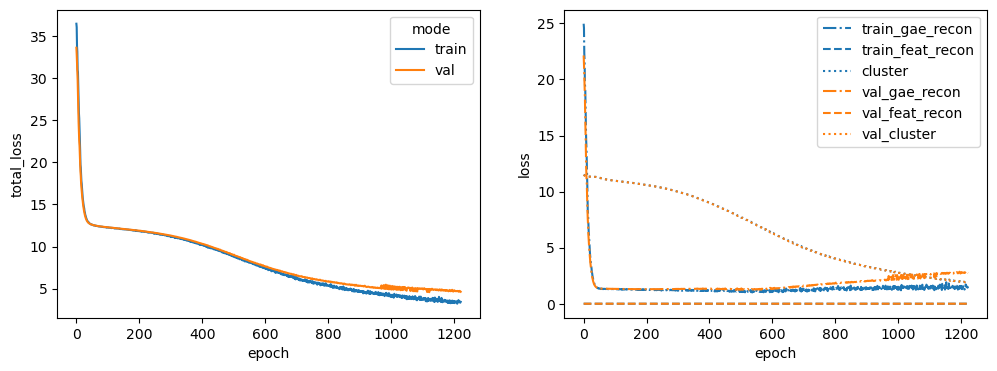

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 16%|█▌        | 1564/10000 [00:33<03:03, 46.08it/s]


Training stopped after 1565 epochs
Best model found at epoch 1463
------------------------------------------------------------
TEST AUC: 0.7336054421768707 AP: 0.7196916429827485
TRAIN loss: 3.149557113647461
VAL loss: 4.071771144866943
TEST loss: 3.892300844192505
TEST AUC: 0.7336054421768707 	 AP: 0.7196916429827485


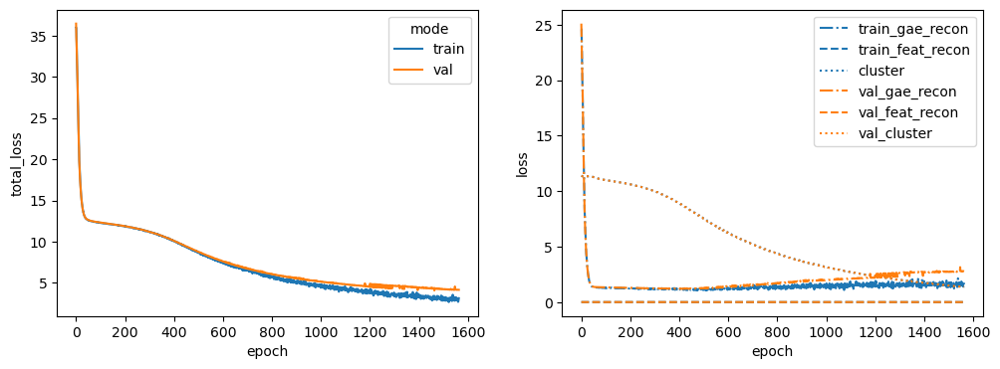

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 30%|██▉       | 2988/10000 [01:03<02:28, 47.32it/s]


Training stopped after 2989 epochs
Best model found at epoch 2887
------------------------------------------------------------
TEST AUC: 0.8336507936507936 AP: 0.8236001869473188
TRAIN loss: 1.629759669303894
VAL loss: 2.6448965072631836
TEST loss: 1.8081727027893066
TEST AUC: 0.8336507936507936 	 AP: 0.8236001869473188


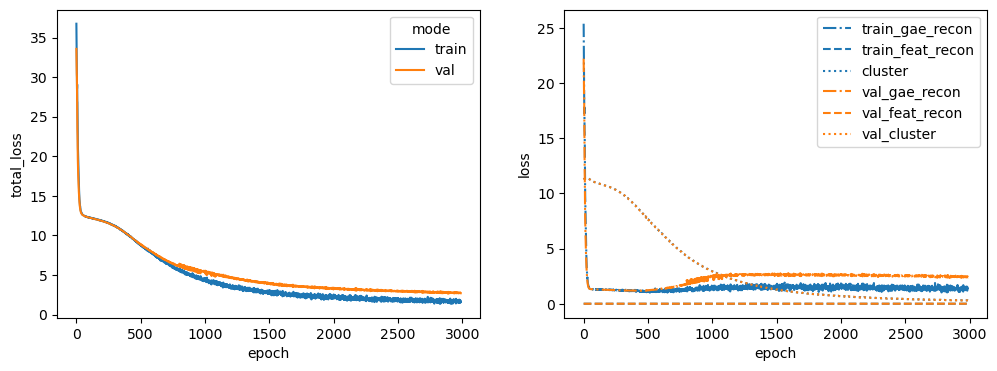

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 40%|███▉      | 3967/10000 [01:23<02:06, 47.52it/s]


Training stopped after 3968 epochs
Best model found at epoch 3866
------------------------------------------------------------
TEST AUC: 0.7942857142857143 AP: 0.8171292004721515
TRAIN loss: 1.5822339057922363
VAL loss: 1.3458255529403687
TEST loss: 1.6988399028778076
TEST AUC: 0.7942857142857143 	 AP: 0.8171292004721515


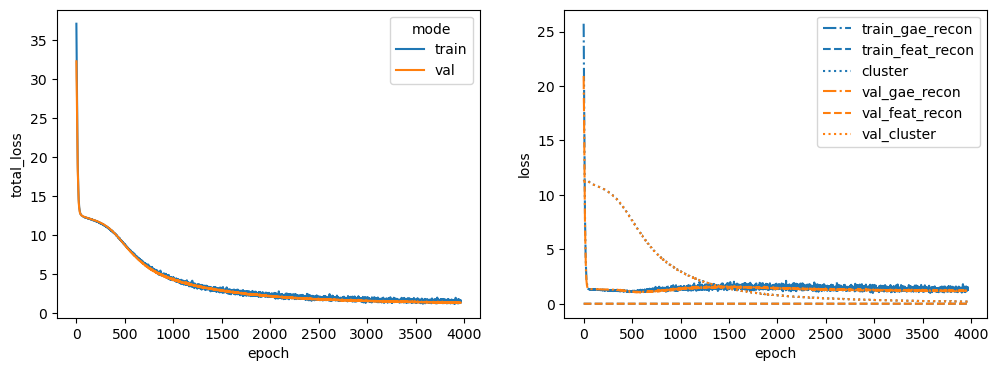

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 49%|████▉     | 4904/10000 [01:42<01:46, 47.85it/s]


Training stopped after 4905 epochs
Best model found at epoch 4803
------------------------------------------------------------
TEST AUC: 0.8118820861678004 AP: 0.8501846309015204
TRAIN loss: 1.153344988822937
VAL loss: 1.4205900430679321
TEST loss: 1.5146868228912354
TEST AUC: 0.8118820861678004 	 AP: 0.8501846309015204


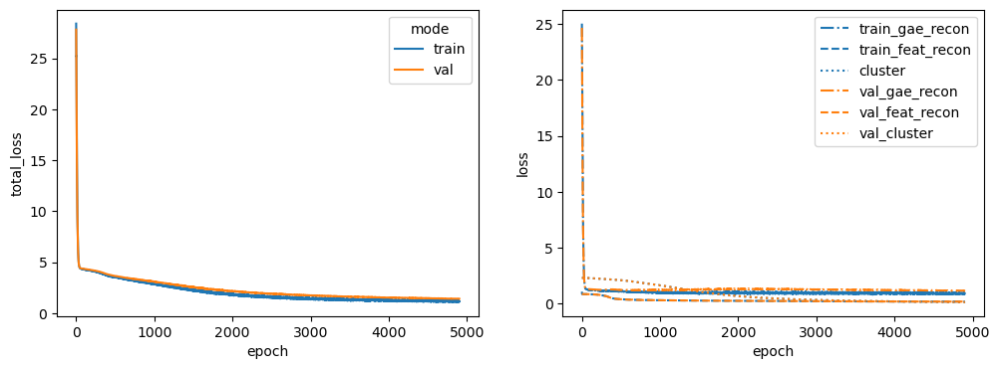

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 10%|▉         | 964/10000 [00:20<03:12, 46.87it/s]


Training stopped after 965 epochs
Best model found at epoch 863
------------------------------------------------------------
TEST AUC: 0.7957369614512472 AP: 0.8213801181475027
TRAIN loss: 3.001354694366455
VAL loss: 3.457902193069458
TEST loss: 3.267331838607788
TEST AUC: 0.7957369614512472 	 AP: 0.8213801181475027


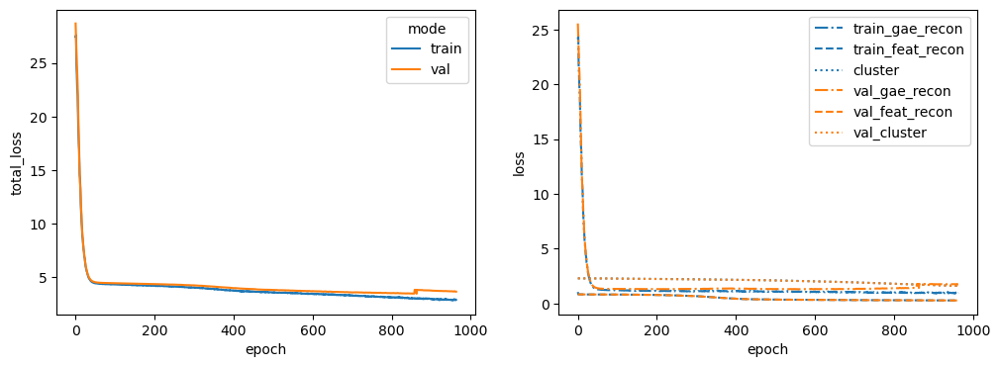

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 45%|████▍     | 4475/10000 [01:34<01:57, 47.21it/s]


Training stopped after 4476 epochs
Best model found at epoch 4374
------------------------------------------------------------
TEST AUC: 0.7863945578231292 AP: 0.7806007868171814
TRAIN loss: 1.1986687183380127
VAL loss: 1.561049461364746
TEST loss: 1.7697070837020874
TEST AUC: 0.7863945578231292 	 AP: 0.7806007868171814


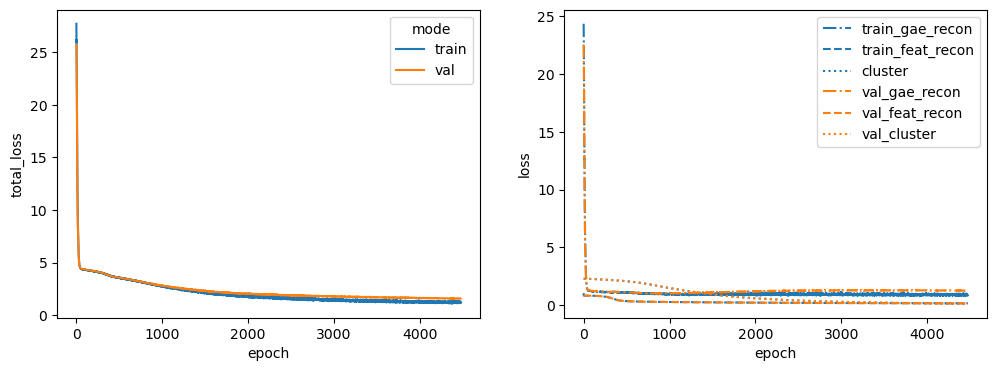

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 33%|███▎      | 3252/10000 [01:09<02:24, 46.66it/s]


Training stopped after 3253 epochs
Best model found at epoch 3151
------------------------------------------------------------
TEST AUC: 0.7769614512471655 AP: 0.8106430883186186
TRAIN loss: 1.4578465223312378
VAL loss: 1.772497296333313
TEST loss: 1.8082247972488403
TEST AUC: 0.7769614512471655 	 AP: 0.8106430883186186


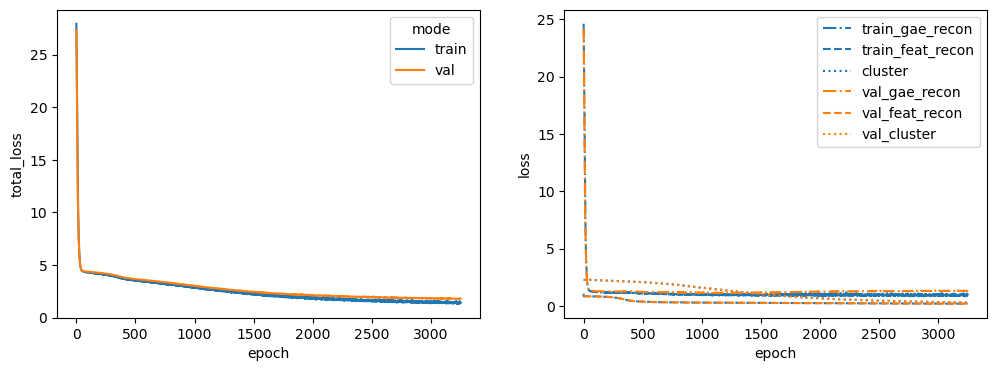

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 38%|███▊      | 3807/10000 [01:19<02:09, 47.76it/s]


Training stopped after 3808 epochs
Best model found at epoch 3706
------------------------------------------------------------
TEST AUC: 0.7841269841269842 AP: 0.8248971350142169
TRAIN loss: 1.2916805744171143
VAL loss: 1.7136908769607544
TEST loss: 1.6858693361282349
TEST AUC: 0.7841269841269842 	 AP: 0.8248971350142169


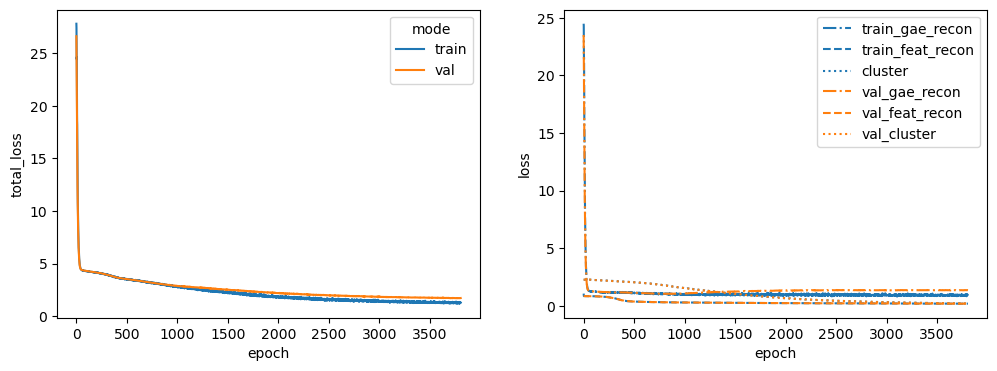

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 49%|████▉     | 4902/10000 [01:42<01:46, 47.89it/s]


Training stopped after 4903 epochs
Best model found at epoch 4801
------------------------------------------------------------
TEST AUC: 0.7980045351473922 AP: 0.8348038400103264
TRAIN loss: 1.1493408679962158
VAL loss: 1.429541826248169
TEST loss: 1.52862548828125
TEST AUC: 0.7980045351473922 	 AP: 0.8348038400103264


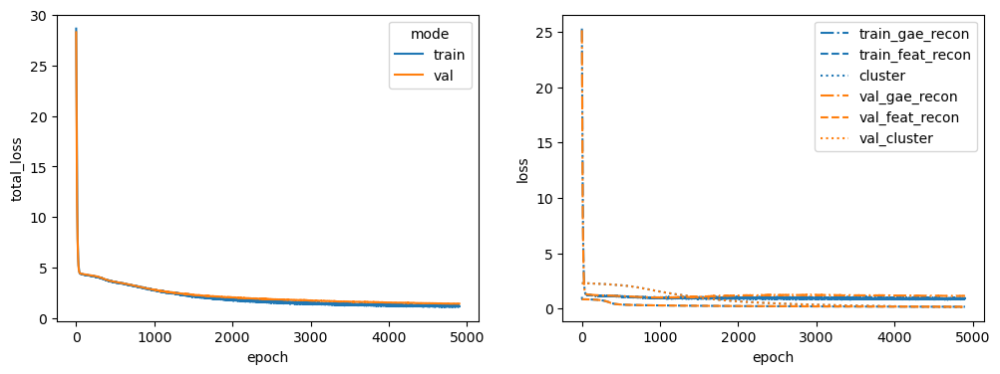

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 51%|█████▏    | 5139/10000 [01:47<01:41, 47.82it/s]


Training stopped after 5140 epochs
Best model found at epoch 5038
------------------------------------------------------------
TEST AUC: 0.8174149659863945 AP: 0.8471234356549825
TRAIN loss: 1.1031395196914673
VAL loss: 1.4893548488616943
TEST loss: 1.4467058181762695
TEST AUC: 0.8174149659863945 	 AP: 0.8471234356549825


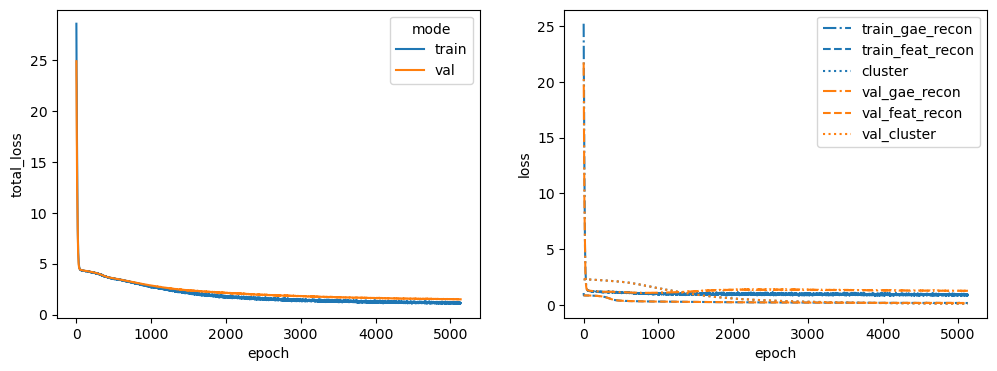

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 38%|███▊      | 3779/10000 [01:20<02:11, 47.14it/s]


Training stopped after 3780 epochs
Best model found at epoch 3678
------------------------------------------------------------
TEST AUC: 0.8274829931972789 AP: 0.8512086343654653
TRAIN loss: 1.2647565603256226
VAL loss: 1.6881781816482544
TEST loss: 1.5366485118865967
TEST AUC: 0.8274829931972789 	 AP: 0.8512086343654653


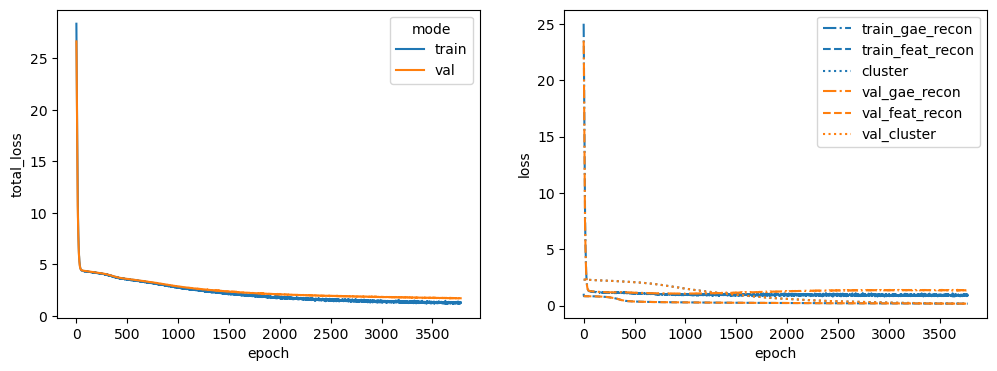

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 50%|█████     | 5036/10000 [01:46<01:45, 47.16it/s]


Training stopped after 5037 epochs
Best model found at epoch 4935
------------------------------------------------------------
TEST AUC: 0.7979138321995465 AP: 0.8082210947236825
TRAIN loss: 1.1207377910614014
VAL loss: 1.504049301147461
TEST loss: 1.5623126029968262
TEST AUC: 0.7979138321995465 	 AP: 0.8082210947236825


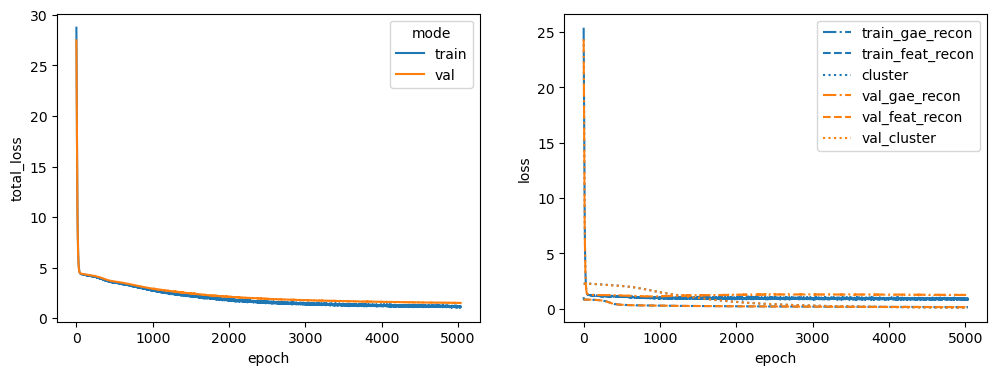

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 44%|████▍     | 4377/10000 [01:30<01:56, 48.17it/s]


Training stopped after 4378 epochs
Best model found at epoch 4276
------------------------------------------------------------
TEST AUC: 0.8078004535147393 AP: 0.8176327763862633
TRAIN loss: 1.223879337310791
VAL loss: 1.6775952577590942
TEST loss: 1.5865057706832886
TEST AUC: 0.8078004535147393 	 AP: 0.8176327763862633


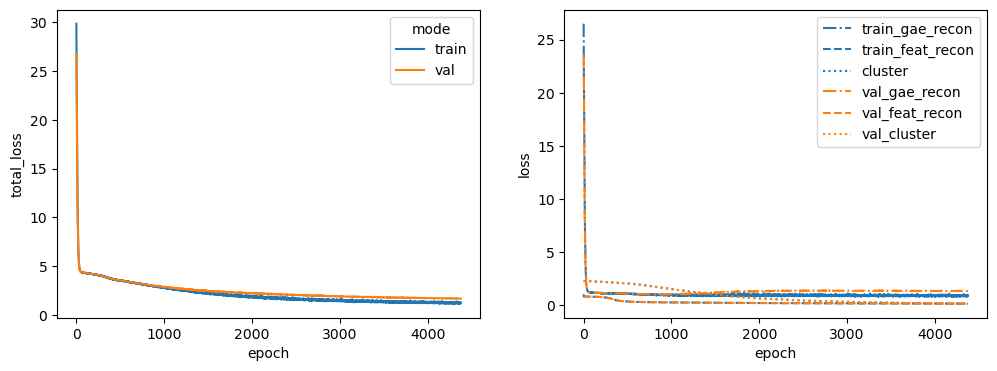

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 12%|█▏        | 1179/10000 [00:24<03:03, 48.06it/s]


Training stopped after 1180 epochs
Best model found at epoch 1078
------------------------------------------------------------
TEST AUC: 0.8491609977324263 AP: 0.8650046576854987
TRAIN loss: 2.710847854614258
VAL loss: 2.989931344985962
TEST loss: 2.871581554412842
TEST AUC: 0.8491609977324263 	 AP: 0.8650046576854987


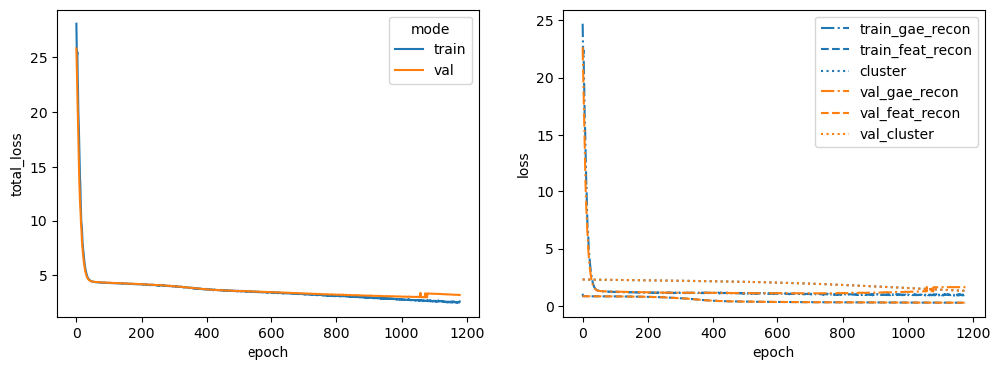

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 38%|███▊      | 3762/10000 [01:19<02:11, 47.58it/s]


Training stopped after 3763 epochs
Best model found at epoch 3661
------------------------------------------------------------
TEST AUC: 0.7979138321995465 AP: 0.8236290206825471
TRAIN loss: 1.3233284950256348
VAL loss: 1.9184142351150513
TEST loss: 1.6086825132369995
TEST AUC: 0.7979138321995465 	 AP: 0.8236290206825471


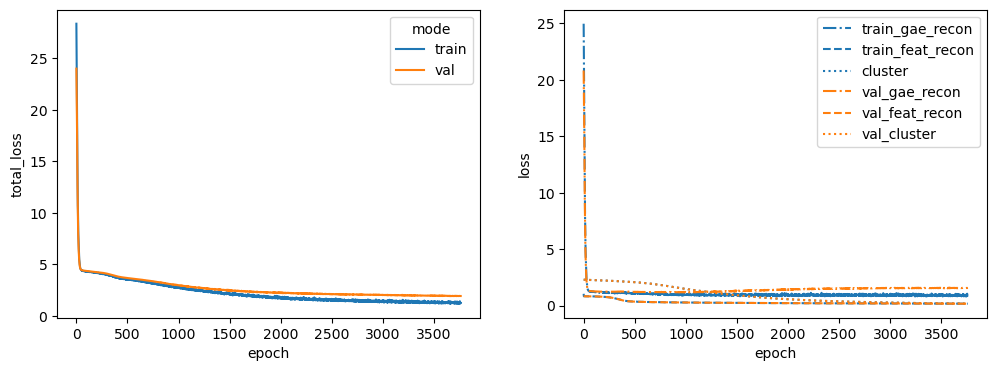

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 15%|█▌        | 1537/10000 [00:32<02:58, 47.53it/s]


Training stopped after 1538 epochs
Best model found at epoch 1436
------------------------------------------------------------
TEST AUC: 0.7929251700680273 AP: 0.7971212552560841
TRAIN loss: 2.337080955505371
VAL loss: 2.8161375522613525
TEST loss: 2.6089529991149902
TEST AUC: 0.7929251700680273 	 AP: 0.7971212552560841


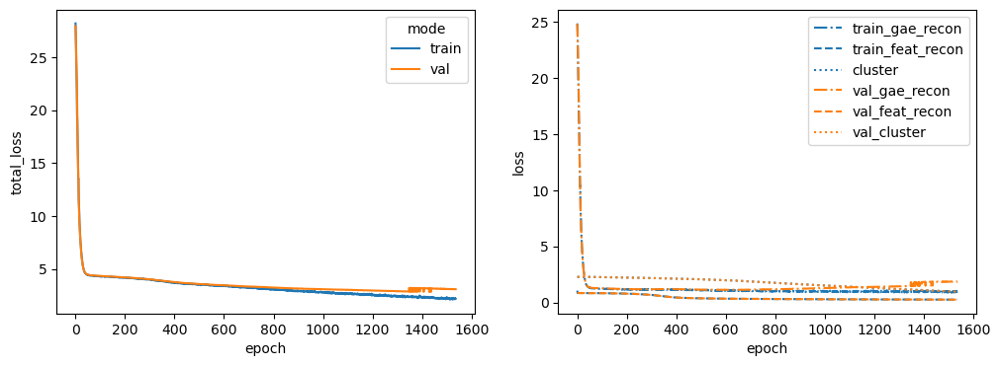

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 60%|█████▉    | 5976/10000 [02:03<01:23, 48.44it/s]


Training stopped after 5977 epochs
Best model found at epoch 5875
------------------------------------------------------------
TEST AUC: 0.8154195011337869 AP: 0.8156723667860591
TRAIN loss: 1.0760501623153687
VAL loss: 1.4410624504089355
TEST loss: 1.4438340663909912
TEST AUC: 0.8154195011337869 	 AP: 0.8156723667860591


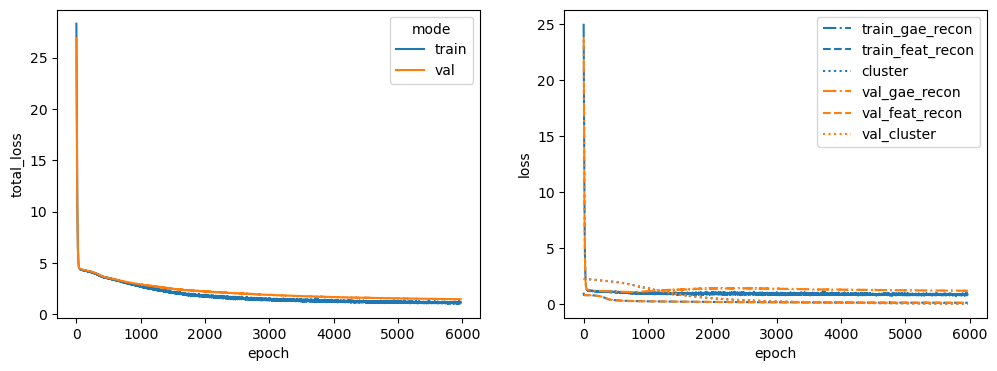

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 41%|████▏     | 4148/10000 [01:25<02:00, 48.37it/s]


Training stopped after 4149 epochs
Best model found at epoch 4047
------------------------------------------------------------
TEST AUC: 0.7801360544217687 AP: 0.7796734826028192
TRAIN loss: 1.2585710287094116
VAL loss: 1.5684499740600586
TEST loss: 1.747807502746582
TEST AUC: 0.7801360544217687 	 AP: 0.7796734826028192


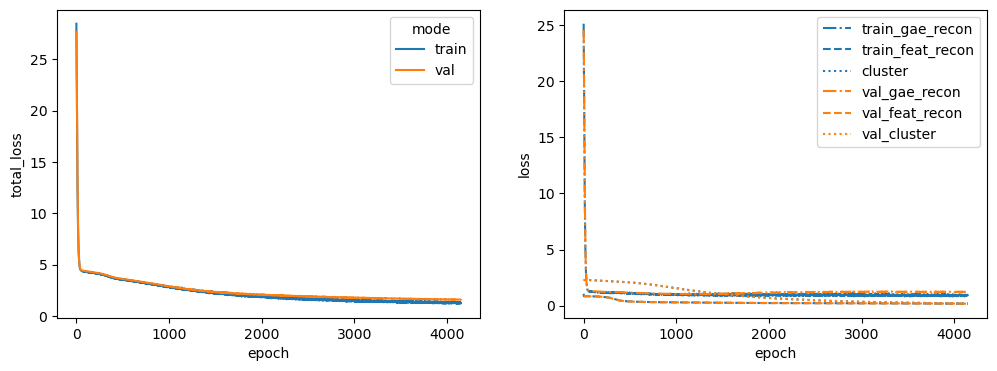

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 53%|█████▎    | 5269/10000 [01:49<01:38, 48.17it/s]


Training stopped after 5270 epochs
Best model found at epoch 5168
------------------------------------------------------------
TEST AUC: 0.7919274376417234 AP: 0.7956258136414309
TRAIN loss: 1.1035706996917725
VAL loss: 1.408463716506958
TEST loss: 1.6530181169509888
TEST AUC: 0.7919274376417234 	 AP: 0.7956258136414309


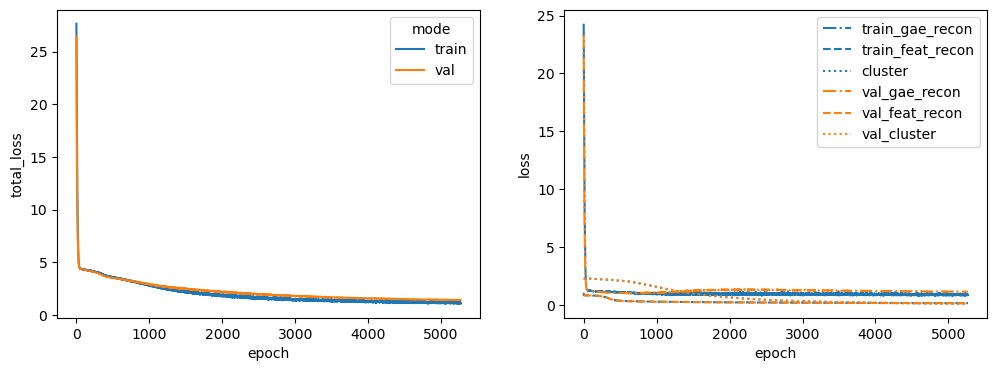

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 70%|███████   | 7000/10000 [02:27<01:03, 47.38it/s]


Training stopped after 7001 epochs
Best model found at epoch 6899
------------------------------------------------------------
TEST AUC: 0.8313832199546486 AP: 0.7960710579450015
TRAIN loss: 1.0762609243392944
VAL loss: 1.4823486804962158
TEST loss: 1.4358997344970703
TEST AUC: 0.8313832199546486 	 AP: 0.7960710579450015


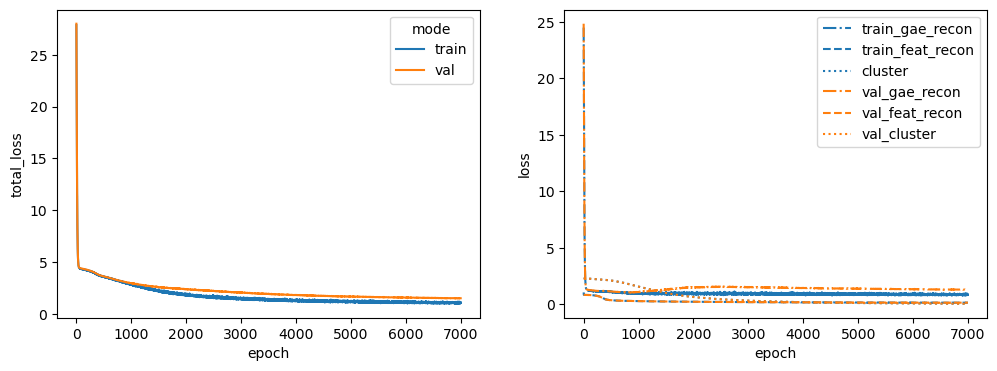

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 36%|███▌      | 3621/10000 [01:16<02:14, 47.52it/s]


Training stopped after 3622 epochs
Best model found at epoch 3520
------------------------------------------------------------
TEST AUC: 0.8541496598639455 AP: 0.8713850228417377
TRAIN loss: 1.3018159866333008
VAL loss: 1.3441236019134521
TEST loss: 1.4577127695083618
TEST AUC: 0.8541496598639455 	 AP: 0.8713850228417377


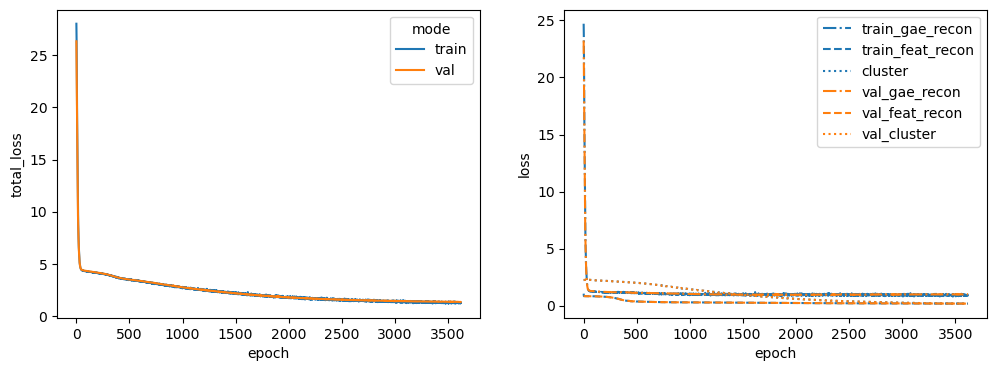

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 63%|██████▎   | 6257/10000 [02:10<01:18, 47.77it/s]


Training stopped after 6258 epochs
Best model found at epoch 6156
------------------------------------------------------------
TEST AUC: 0.8293877551020408 AP: 0.8543876926950366
TRAIN loss: 1.0703346729278564
VAL loss: 1.4095441102981567
TEST loss: 1.3839716911315918
TEST AUC: 0.8293877551020408 	 AP: 0.8543876926950366


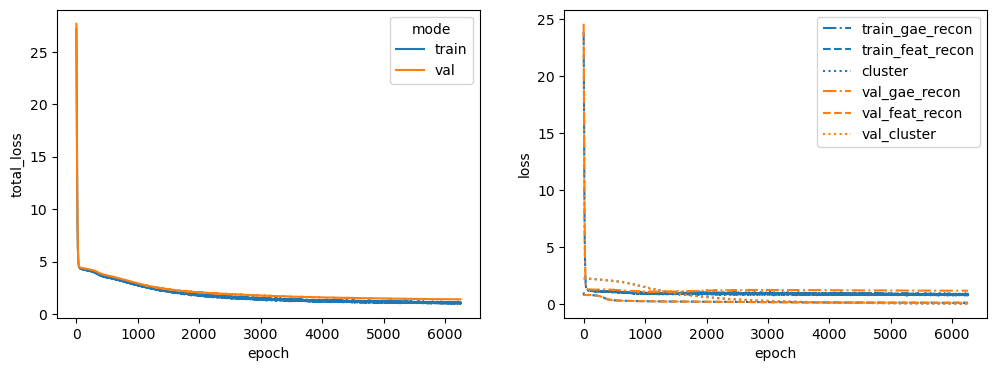

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 44%|████▍     | 4390/10000 [01:31<01:56, 48.22it/s]


Training stopped after 4391 epochs
Best model found at epoch 4289
------------------------------------------------------------
TEST AUC: 0.8128798185941042 AP: 0.822256876059904
TRAIN loss: 1.1756402254104614
VAL loss: 1.5164027214050293
TEST loss: 1.5408440828323364
TEST AUC: 0.8128798185941042 	 AP: 0.822256876059904


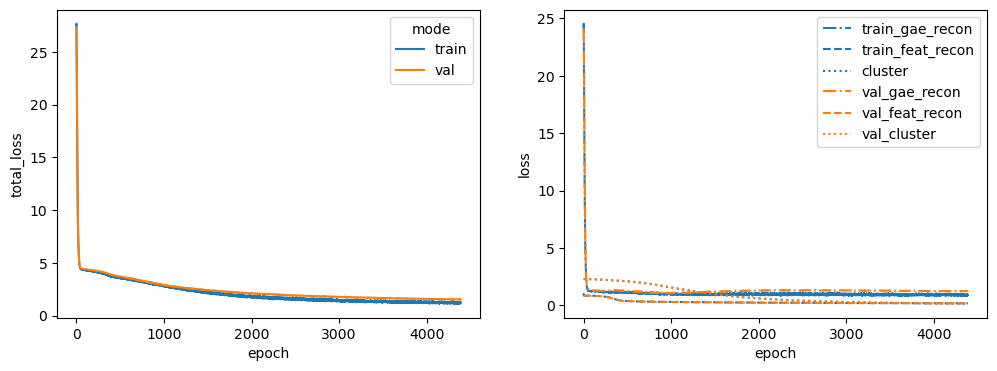

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 42%|████▏     | 4222/10000 [01:27<02:00, 47.98it/s]


Training stopped after 4223 epochs
Best model found at epoch 4121
------------------------------------------------------------
TEST AUC: 0.7970068027210885 AP: 0.8082101209233008
TRAIN loss: 1.2163652181625366
VAL loss: 1.6411277055740356
TEST loss: 1.5690863132476807
TEST AUC: 0.7970068027210885 	 AP: 0.8082101209233008


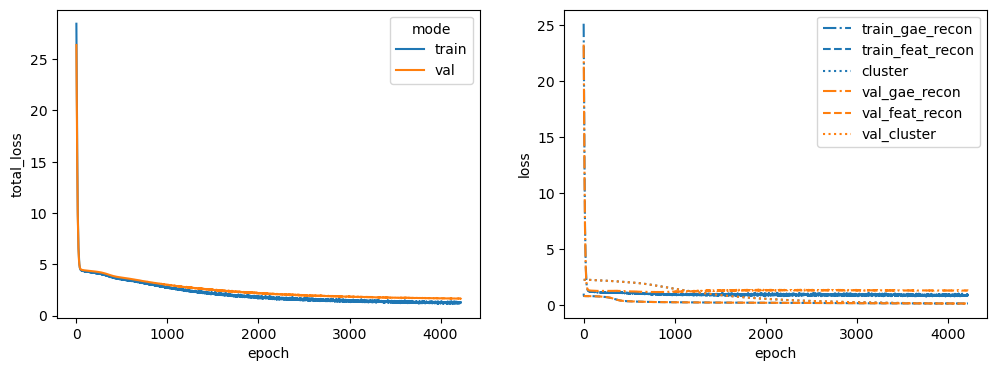

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 35%|███▌      | 3503/10000 [01:13<02:17, 47.36it/s]


Training stopped after 3504 epochs
Best model found at epoch 3402
------------------------------------------------------------
TEST AUC: 0.7991836734693877 AP: 0.7988448829640236
TRAIN loss: 1.2851048707962036
VAL loss: 1.6440179347991943
TEST loss: 1.7177461385726929
TEST AUC: 0.7991836734693877 	 AP: 0.7988448829640236


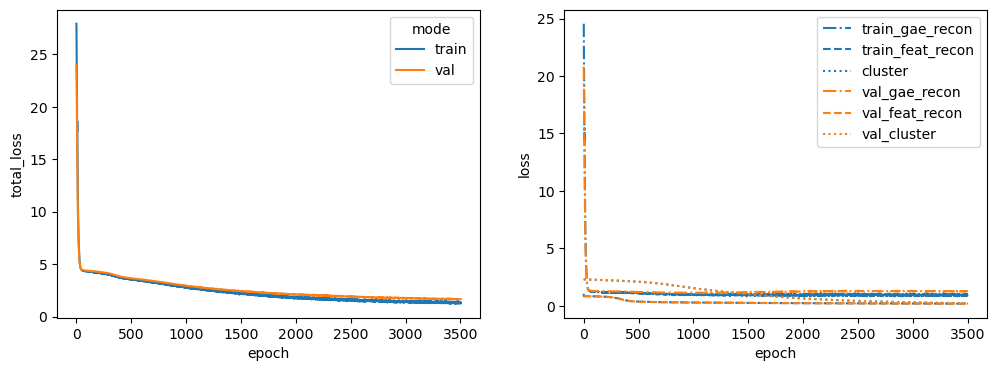

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 43%|████▎     | 4255/10000 [01:29<02:01, 47.42it/s]


Training stopped after 4256 epochs
Best model found at epoch 4154
------------------------------------------------------------
TEST AUC: 0.7979591836734693 AP: 0.7869056570991269
TRAIN loss: 1.2569913864135742
VAL loss: 1.5830786228179932
TEST loss: 1.6237326860427856
TEST AUC: 0.7979591836734693 	 AP: 0.7869056570991269


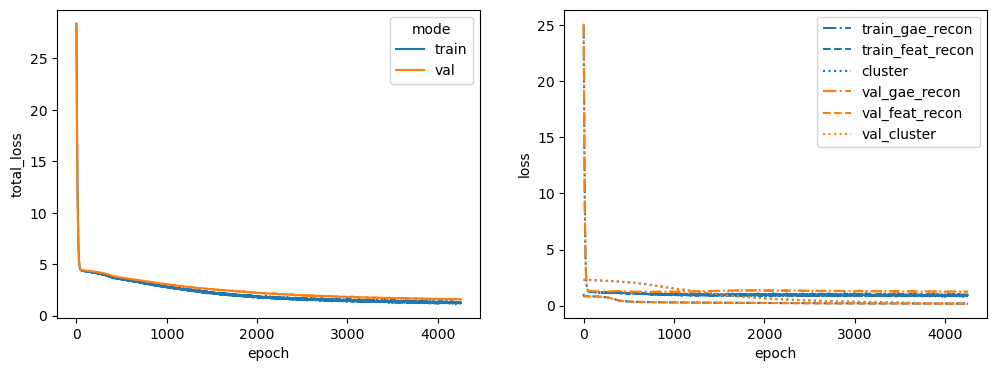

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 46%|████▌     | 4605/10000 [01:37<01:53, 47.38it/s]


Training stopped after 4606 epochs
Best model found at epoch 4504
------------------------------------------------------------
TEST AUC: 0.7875736961451247 AP: 0.7739109683079992
TRAIN loss: 1.3235985040664673
VAL loss: 1.4922195672988892
TEST loss: 1.7091588973999023
TEST AUC: 0.7875736961451247 	 AP: 0.7739109683079992


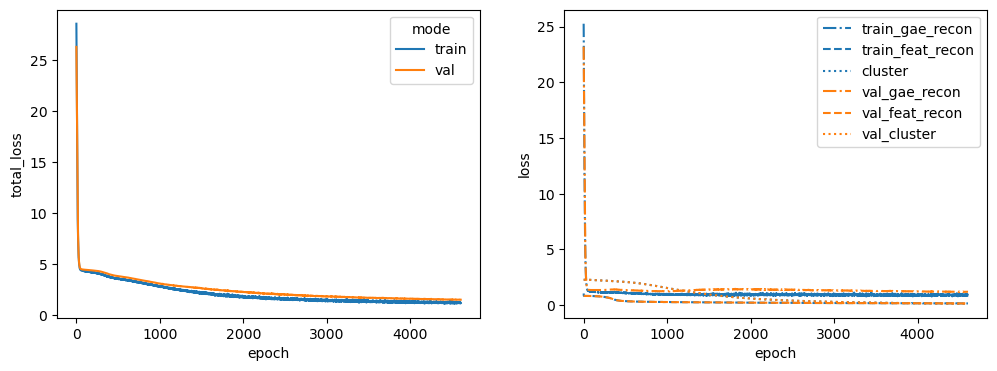

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 26%|██▋       | 2635/10000 [00:56<02:37, 46.71it/s]


Training stopped after 2636 epochs
Best model found at epoch 2534
------------------------------------------------------------
TEST AUC: 0.7945578231292518 AP: 0.8124157507568133
TRAIN loss: 1.6684067249298096
VAL loss: 1.8805065155029297
TEST loss: 1.9656604528427124
TEST AUC: 0.7945578231292518 	 AP: 0.8124157507568133


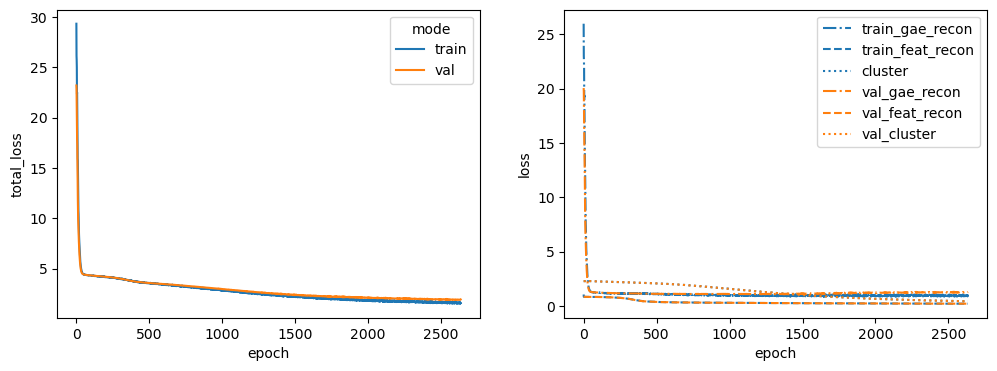

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 58%|█████▊    | 5817/10000 [02:02<01:27, 47.65it/s]


Training stopped after 5818 epochs
Best model found at epoch 5716
------------------------------------------------------------
TEST AUC: 0.7845804988662132 AP: 0.8195887386793854
TRAIN loss: 1.1896569728851318
VAL loss: 1.2736378908157349
TEST loss: 1.5015292167663574
TEST AUC: 0.7845804988662132 	 AP: 0.8195887386793854


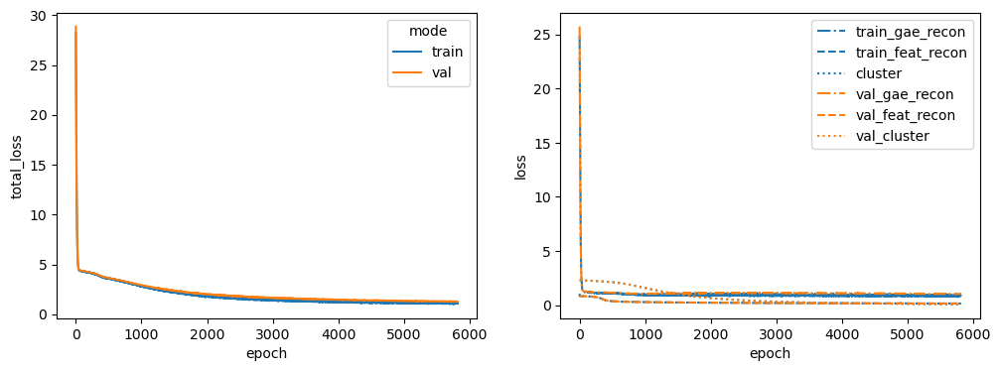

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 51%|█████     | 5074/10000 [01:47<01:44, 47.28it/s]


Training stopped after 5075 epochs
Best model found at epoch 4973
------------------------------------------------------------
TEST AUC: 0.7401360544217687 AP: 0.7330453114603631
TRAIN loss: 1.1390340328216553
VAL loss: 1.601467490196228
TEST loss: 1.7429115772247314
TEST AUC: 0.7401360544217687 	 AP: 0.7330453114603631


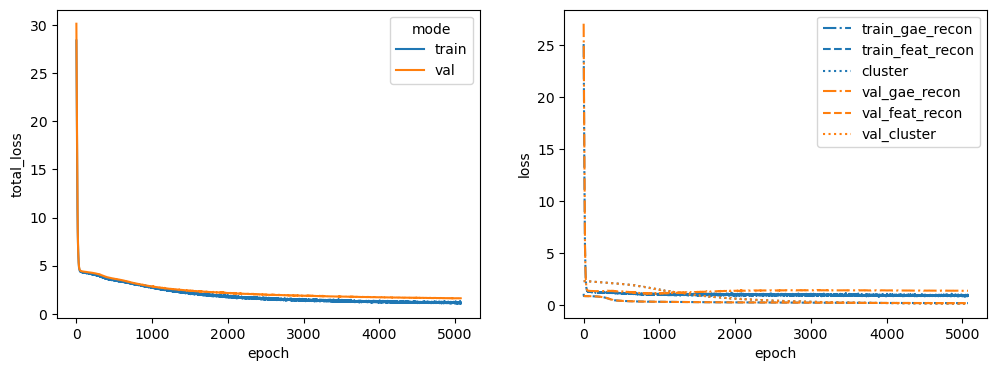

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 63%|██████▎   | 6314/10000 [02:14<01:18, 47.02it/s]


Training stopped after 6315 epochs
Best model found at epoch 6213
------------------------------------------------------------
TEST AUC: 0.8042630385487529 AP: 0.7980825240498808
TRAIN loss: 1.066558837890625
VAL loss: 1.3163577318191528
TEST loss: 1.518154501914978
TEST AUC: 0.8042630385487529 	 AP: 0.7980825240498808


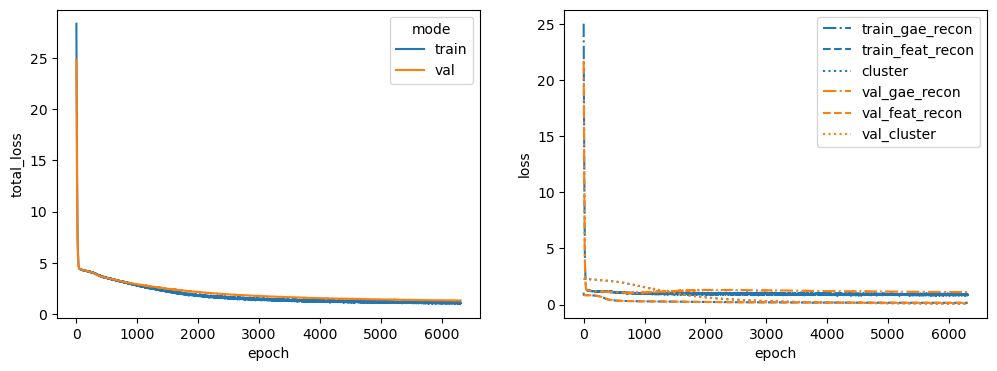

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 42%|████▏     | 4178/10000 [01:28<02:02, 47.47it/s]


Training stopped after 4179 epochs
Best model found at epoch 4077
------------------------------------------------------------
TEST AUC: 0.7810430839002267 AP: 0.8003369814173915
TRAIN loss: 1.2448303699493408
VAL loss: 1.5817315578460693
TEST loss: 1.6157662868499756
TEST AUC: 0.7810430839002267 	 AP: 0.8003369814173915


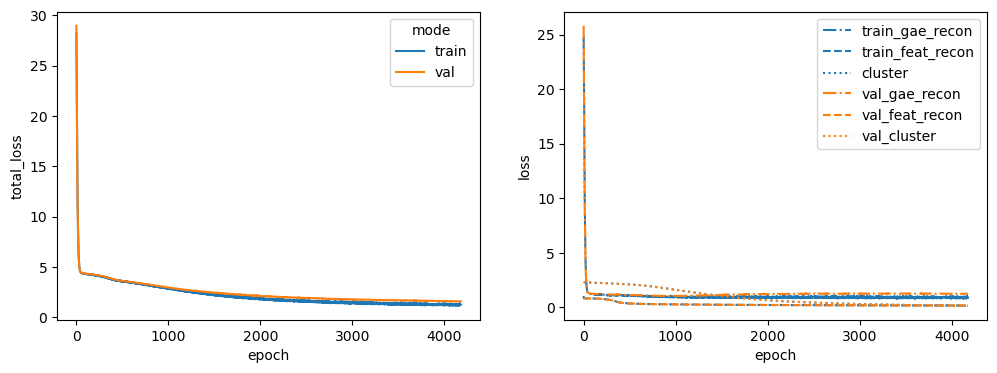

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 49%|████▉     | 4924/10000 [01:44<01:47, 47.22it/s]


Training stopped after 4925 epochs
Best model found at epoch 4823
------------------------------------------------------------
TEST AUC: 0.7987301587301587 AP: 0.8001929635958659
TRAIN loss: 1.11613929271698
VAL loss: 1.6396905183792114
TEST loss: 1.5788500308990479
TEST AUC: 0.7987301587301587 	 AP: 0.8001929635958659


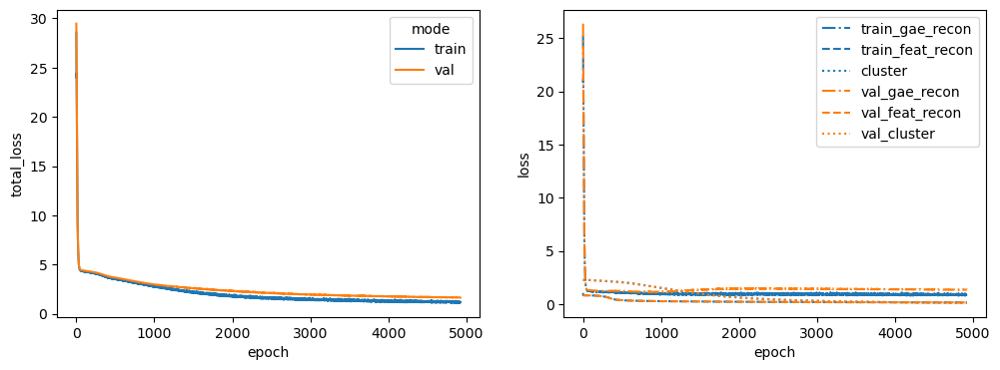

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 54%|█████▍    | 5445/10000 [01:53<01:34, 48.15it/s]


Training stopped after 5446 epochs
Best model found at epoch 5344
------------------------------------------------------------
TEST AUC: 0.7900226757369614 AP: 0.8178573070665804
TRAIN loss: 1.0967952013015747
VAL loss: 1.5533267259597778
TEST loss: 1.5432500839233398
TEST AUC: 0.7900226757369614 	 AP: 0.8178573070665804


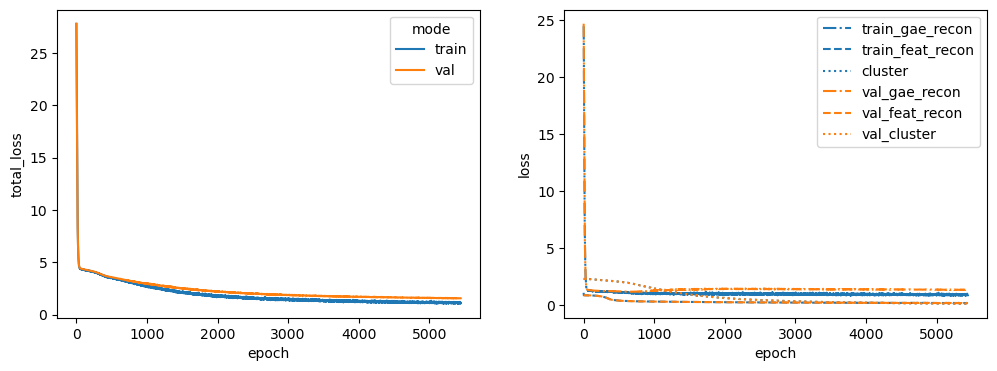

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 32%|███▏      | 3234/10000 [01:07<02:21, 47.69it/s]


Training stopped after 3235 epochs
Best model found at epoch 3133
------------------------------------------------------------
TEST AUC: 0.7905668934240362 AP: 0.7854611542421005
TRAIN loss: 1.4388127326965332
VAL loss: 1.7867051362991333
TEST loss: 1.8112825155258179
TEST AUC: 0.7905668934240362 	 AP: 0.7854611542421005


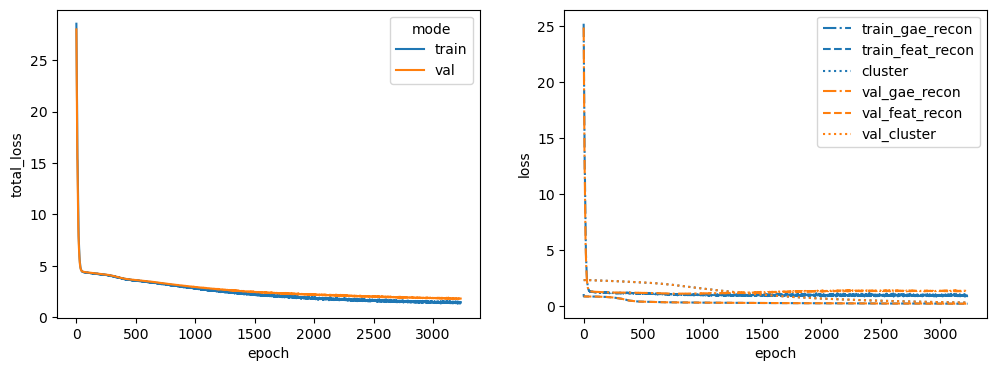

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 38%|███▊      | 3785/10000 [01:18<02:09, 48.01it/s]


Training stopped after 3786 epochs
Best model found at epoch 3684
------------------------------------------------------------
TEST AUC: 0.8370068027210884 AP: 0.8580827457557896
TRAIN loss: 1.3174655437469482
VAL loss: 1.611079454421997
TEST loss: 1.614251732826233
TEST AUC: 0.8370068027210884 	 AP: 0.8580827457557896


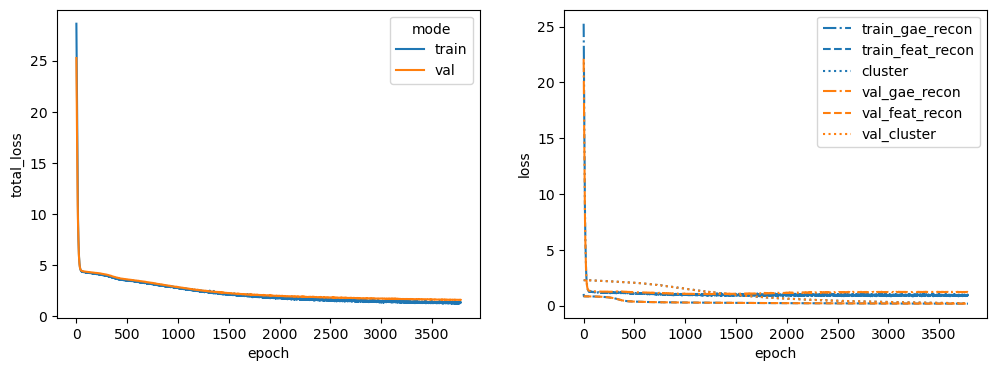

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 40%|████      | 4018/10000 [01:23<02:04, 48.07it/s]


Training stopped after 4019 epochs
Best model found at epoch 3917
------------------------------------------------------------
TEST AUC: 0.7653514739229025 AP: 0.7461159313064398
TRAIN loss: 1.4081535339355469
VAL loss: 1.5139226913452148
TEST loss: 1.9139336347579956
TEST AUC: 0.7653514739229025 	 AP: 0.7461159313064398


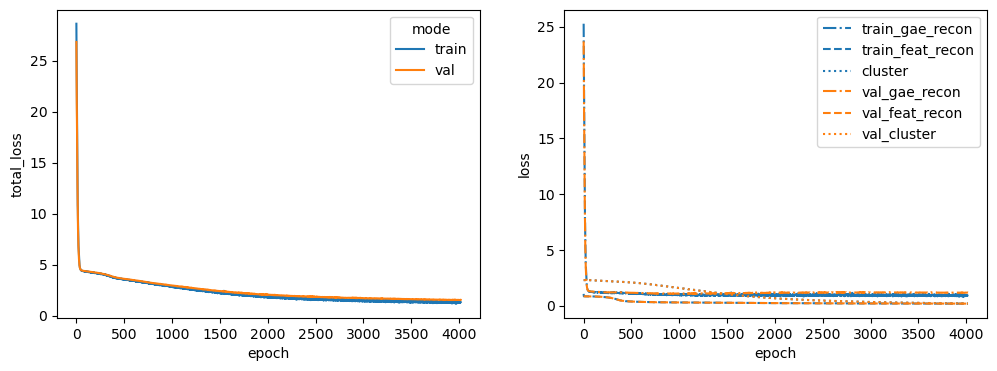

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 61%|██████    | 6118/10000 [02:08<01:21, 47.62it/s]


Training stopped after 6119 epochs
Best model found at epoch 6017
------------------------------------------------------------
TEST AUC: 0.8180498866213151 AP: 0.8484269811592535
TRAIN loss: 1.1266810894012451
VAL loss: 1.4450291395187378
TEST loss: 1.4164347648620605
TEST AUC: 0.8180498866213151 	 AP: 0.8484269811592535


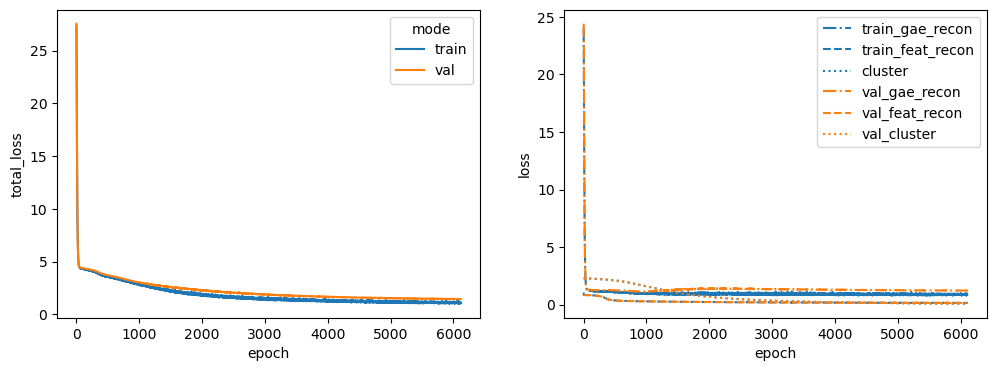

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 32%|███▏      | 3243/10000 [01:07<02:20, 48.03it/s]


Training stopped after 3244 epochs
Best model found at epoch 3142
------------------------------------------------------------
TEST AUC: 0.803718820861678 AP: 0.802193753862304
TRAIN loss: 1.4527418613433838
VAL loss: 1.8112441301345825
TEST loss: 1.7506086826324463
TEST AUC: 0.803718820861678 	 AP: 0.802193753862304


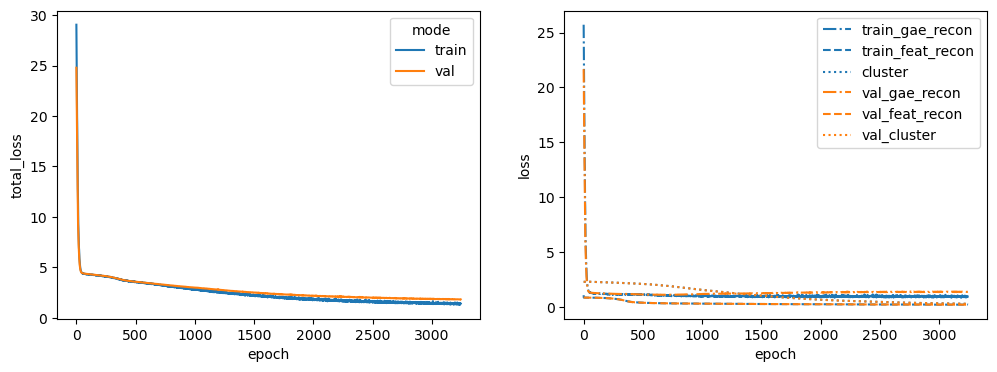

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 33%|███▎      | 3274/10000 [01:08<02:20, 47.94it/s]


Training stopped after 3275 epochs
Best model found at epoch 3173
------------------------------------------------------------
TEST AUC: 0.8281179138321996 AP: 0.8423502953191149
TRAIN loss: 1.4578620195388794
VAL loss: 1.5935088396072388
TEST loss: 1.6619505882263184
TEST AUC: 0.8281179138321996 	 AP: 0.8423502953191149


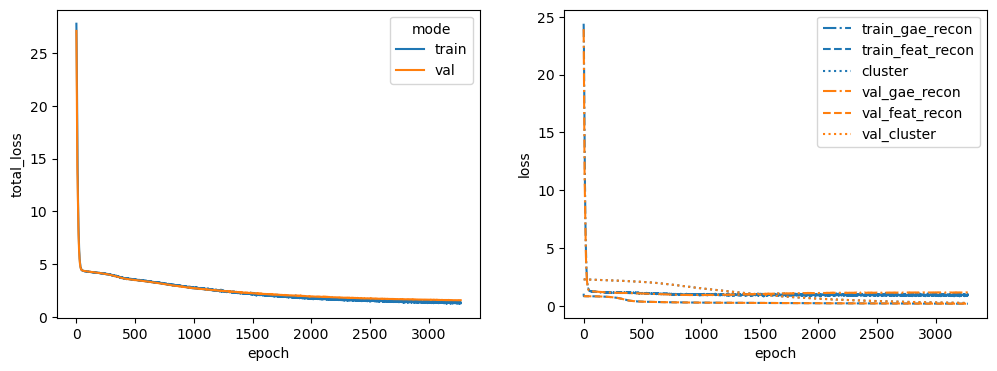

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 48%|████▊     | 4836/10000 [01:40<01:46, 48.28it/s]


Training stopped after 4837 epochs
Best model found at epoch 4735
------------------------------------------------------------
TEST AUC: 0.8016326530612247 AP: 0.7751771374748984
TRAIN loss: 1.1338858604431152
VAL loss: 1.5334404706954956
TEST loss: 1.6099610328674316
TEST AUC: 0.8016326530612247 	 AP: 0.7751771374748984


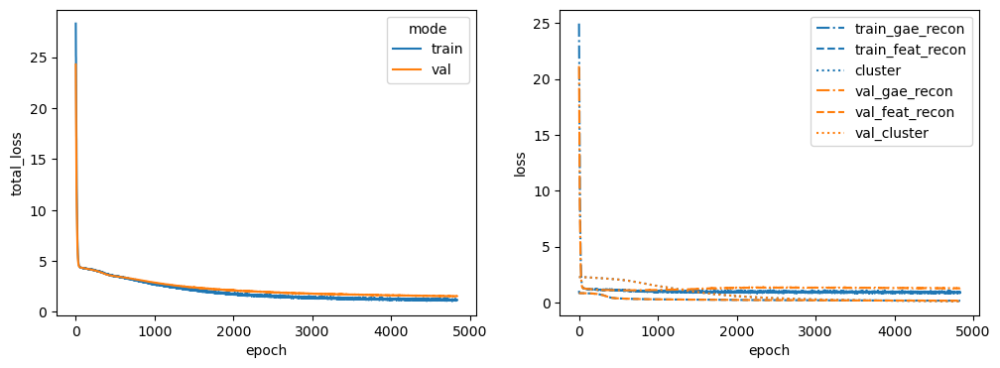

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 35%|███▌      | 3503/10000 [01:13<02:15, 47.79it/s]


Training stopped after 3504 epochs
Best model found at epoch 3402
------------------------------------------------------------
TEST AUC: 0.8032653061224491 AP: 0.7960342689909957
TRAIN loss: 1.3139702081680298
VAL loss: 1.66340970993042
TEST loss: 1.755941390991211
TEST AUC: 0.8032653061224491 	 AP: 0.7960342689909957


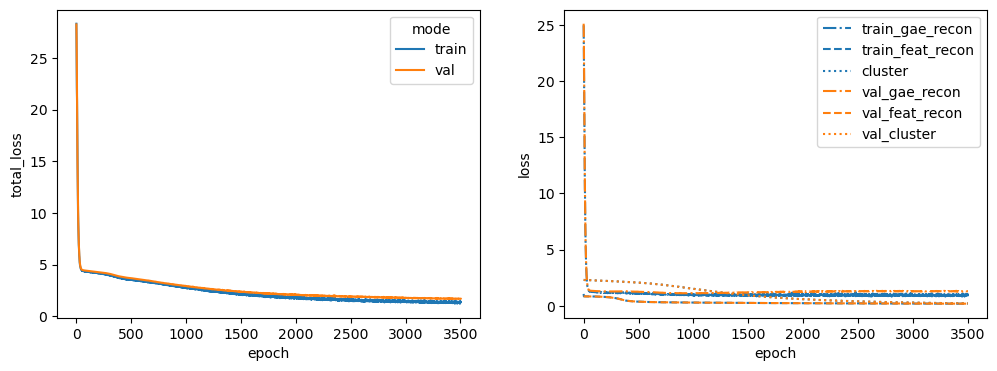

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 62%|██████▏   | 6225/10000 [02:09<01:18, 48.04it/s]


Training stopped after 6226 epochs
Best model found at epoch 6124
------------------------------------------------------------
TEST AUC: 0.7702494331065759 AP: 0.7676546345773948
TRAIN loss: 1.1165918111801147
VAL loss: 1.370207667350769
TEST loss: 1.6288396120071411
TEST AUC: 0.7702494331065759 	 AP: 0.7676546345773948


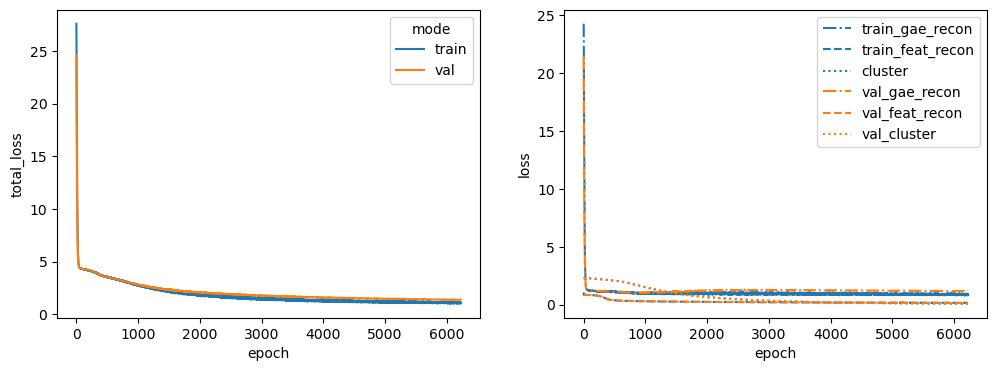

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 50%|█████     | 5030/10000 [01:46<01:45, 47.21it/s]


Training stopped after 5031 epochs
Best model found at epoch 4929
------------------------------------------------------------
TEST AUC: 0.8227664399092971 AP: 0.8592818941905144
TRAIN loss: 1.0913238525390625
VAL loss: 1.3323874473571777
TEST loss: 1.4957820177078247
TEST AUC: 0.8227664399092971 	 AP: 0.8592818941905144


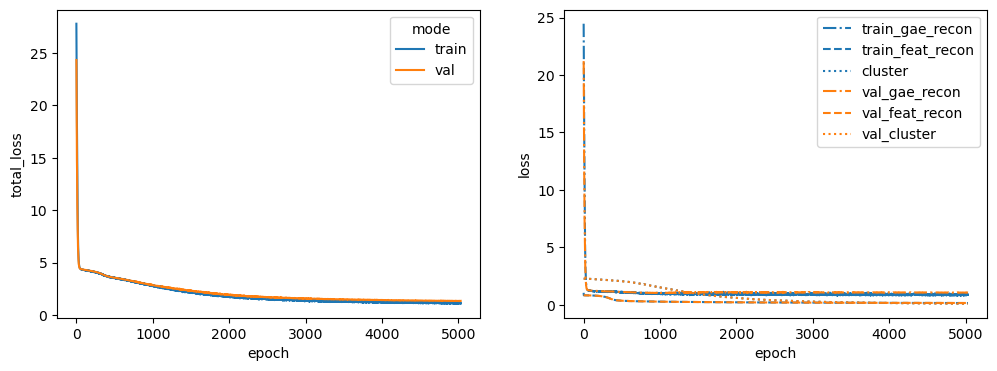

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 46%|████▌     | 4576/10000 [01:36<01:54, 47.34it/s]


Training stopped after 4577 epochs
Best model found at epoch 4475
------------------------------------------------------------
TEST AUC: 0.8193197278911565 AP: 0.8516488332149428
TRAIN loss: 1.2258610725402832
VAL loss: 1.5985230207443237
TEST loss: 1.4971137046813965
TEST AUC: 0.8193197278911565 	 AP: 0.8516488332149428


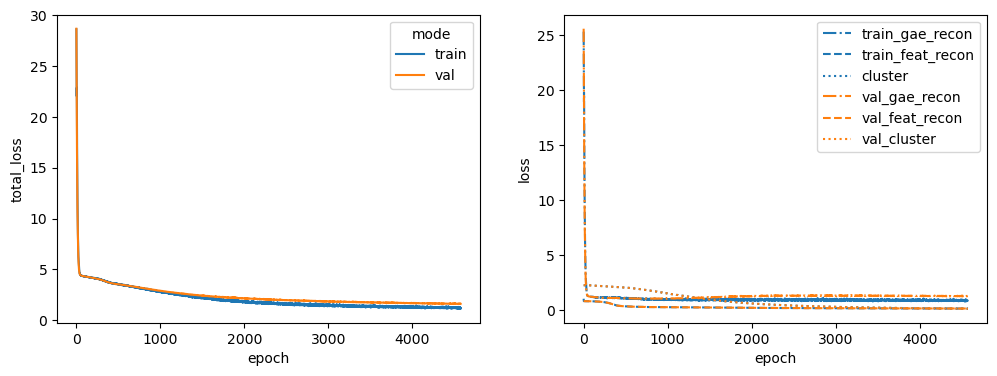

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 62%|██████▏   | 6233/10000 [02:10<01:18, 47.84it/s]


Training stopped after 6234 epochs
Best model found at epoch 6132
------------------------------------------------------------
TEST AUC: 0.7887528344671202 AP: 0.8124942673424507
TRAIN loss: 1.3382596969604492
VAL loss: 1.9385207891464233
TEST loss: 1.826006531715393
TEST AUC: 0.7887528344671202 	 AP: 0.8124942673424507


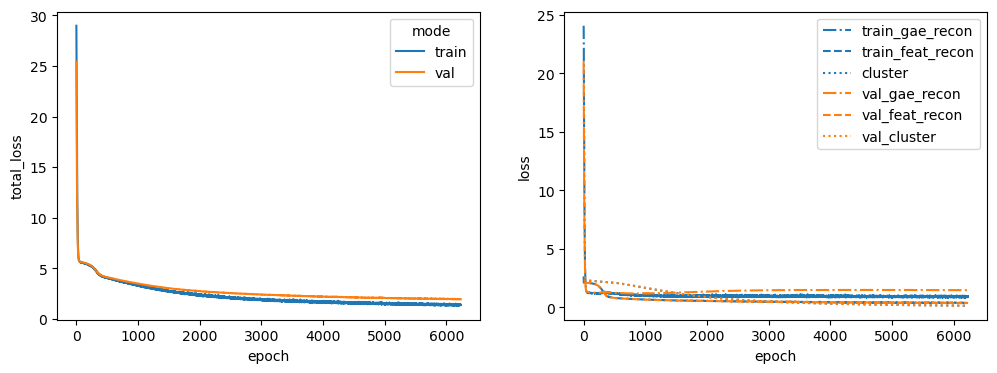

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 67%|██████▋   | 6747/10000 [02:22<01:08, 47.39it/s]


Training stopped after 6748 epochs
Best model found at epoch 6646
------------------------------------------------------------
TEST AUC: 0.782312925170068 AP: 0.7981579238481993
TRAIN loss: 1.3017055988311768
VAL loss: 1.4718550443649292
TEST loss: 1.839970350265503
TEST AUC: 0.782312925170068 	 AP: 0.7981579238481993


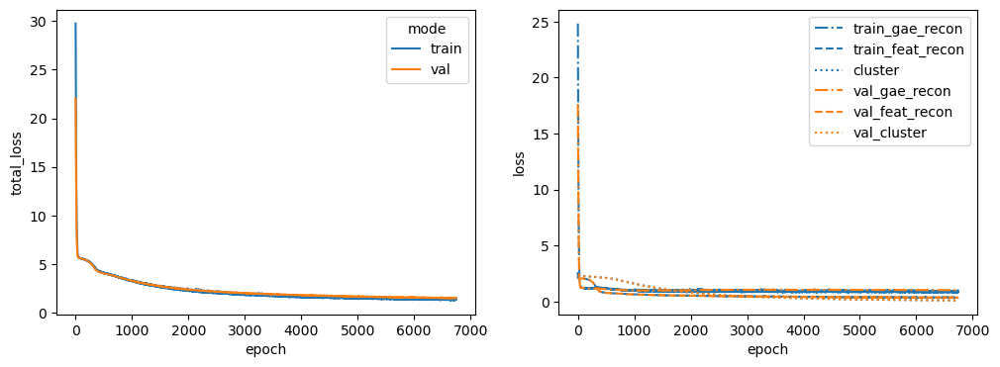

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 58%|█████▊    | 5817/10000 [02:02<01:27, 47.61it/s]


Training stopped after 5818 epochs
Best model found at epoch 5716
------------------------------------------------------------
TEST AUC: 0.8092517006802722 AP: 0.8267145671824377
TRAIN loss: 1.394489049911499
VAL loss: 1.867145299911499
TEST loss: 1.803909420967102
TEST AUC: 0.8092517006802722 	 AP: 0.8267145671824377


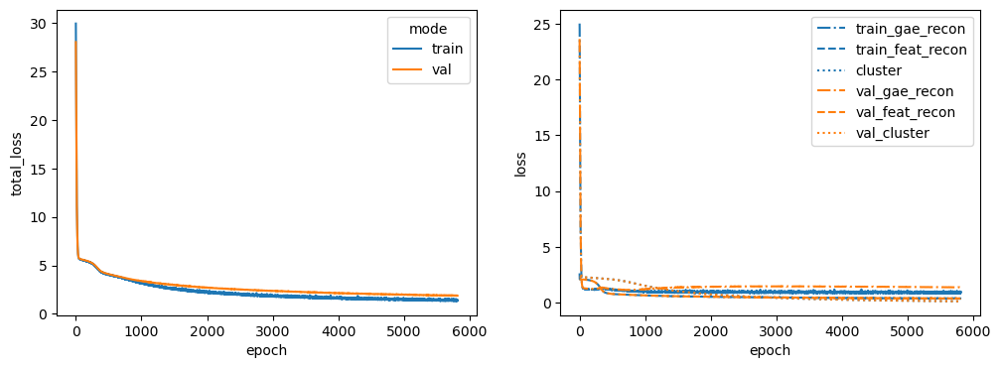

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 52%|█████▏    | 5196/10000 [01:49<01:41, 47.27it/s]


Training stopped after 5197 epochs
Best model found at epoch 5095
------------------------------------------------------------
TEST AUC: 0.8048072562358277 AP: 0.8506128935833793
TRAIN loss: 1.448110580444336
VAL loss: 1.989890217781067
TEST loss: 1.8559900522232056
TEST AUC: 0.8048072562358277 	 AP: 0.8506128935833793


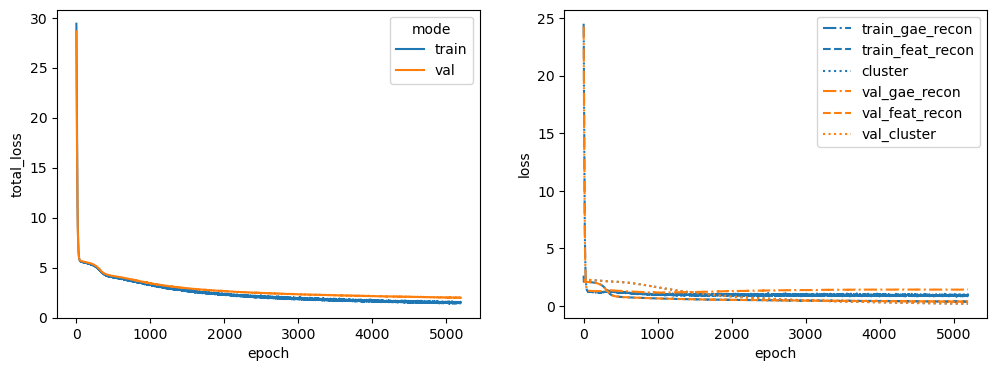

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 52%|█████▏    | 5152/10000 [01:47<01:40, 48.04it/s]


Training stopped after 5153 epochs
Best model found at epoch 5051
------------------------------------------------------------
TEST AUC: 0.81297052154195 AP: 0.8464662955336524
TRAIN loss: 1.475282073020935
VAL loss: 1.721606731414795
TEST loss: 1.8448501825332642
TEST AUC: 0.81297052154195 	 AP: 0.8464662955336524


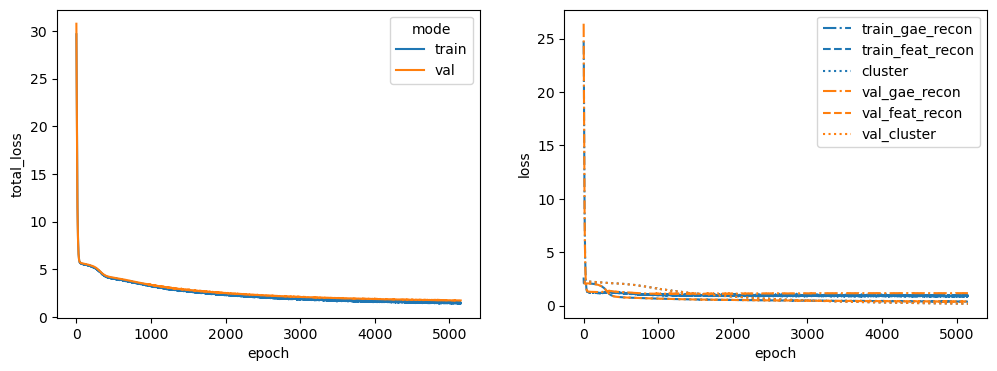

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 42%|████▏     | 4168/10000 [01:27<02:02, 47.54it/s]


Training stopped after 4169 epochs
Best model found at epoch 4067
------------------------------------------------------------
TEST AUC: 0.8027210884353743 AP: 0.7940063384749657
TRAIN loss: 1.6281510591506958
VAL loss: 2.0049080848693848
TEST loss: 2.05009126663208
TEST AUC: 0.8027210884353743 	 AP: 0.7940063384749657


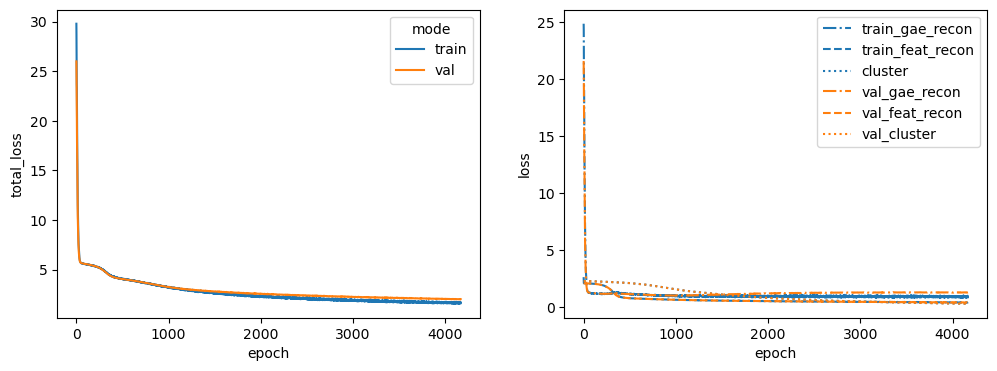

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 65%|██████▌   | 6537/10000 [02:16<01:12, 47.75it/s]


Training stopped after 6538 epochs
Best model found at epoch 6436
------------------------------------------------------------
TEST AUC: 0.7954648526077097 AP: 0.8009763507465874
TRAIN loss: 1.2771836519241333
VAL loss: 1.5692001581192017
TEST loss: 1.7955474853515625
TEST AUC: 0.7954648526077097 	 AP: 0.8009763507465874


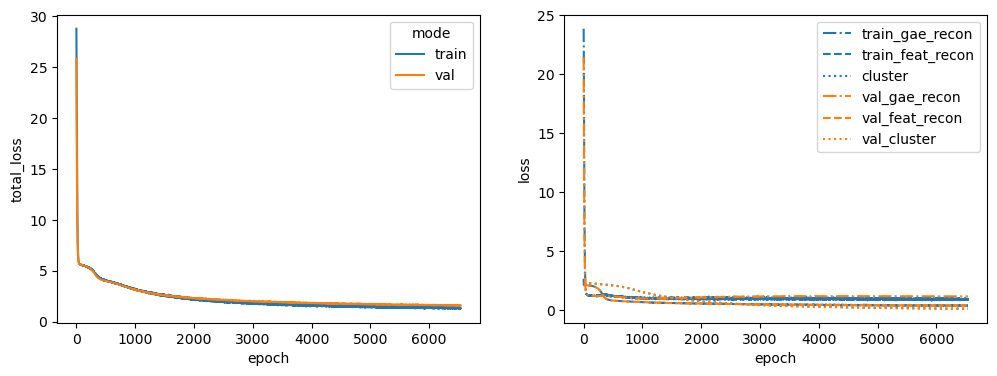

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 61%|██████    | 6103/10000 [02:06<01:20, 48.16it/s]


Training stopped after 6104 epochs
Best model found at epoch 6002
------------------------------------------------------------
TEST AUC: 0.8052607709750567 AP: 0.8298898379237141
TRAIN loss: 1.372672438621521
VAL loss: 1.6021724939346313
TEST loss: 1.7395051717758179
TEST AUC: 0.8052607709750567 	 AP: 0.8298898379237141


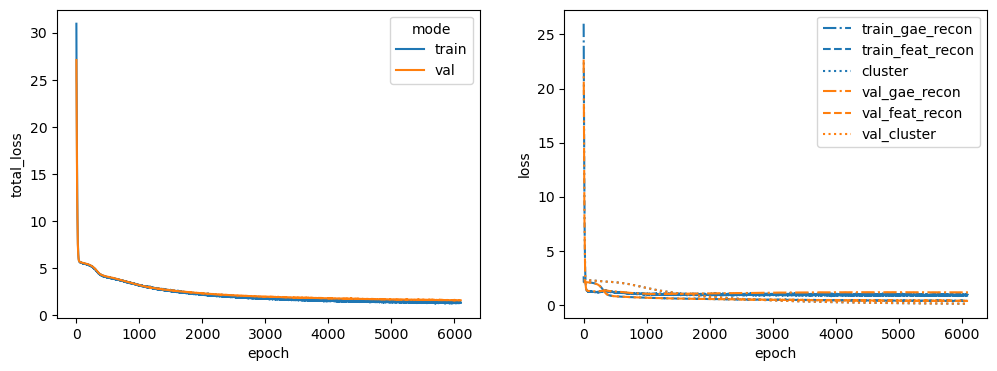

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 42%|████▏     | 4195/10000 [01:28<02:02, 47.33it/s]


Training stopped after 4196 epochs
Best model found at epoch 4094
------------------------------------------------------------
TEST AUC: 0.8196825396825397 AP: 0.8406589185564435
TRAIN loss: 1.6095818281173706
VAL loss: 2.250197172164917
TEST loss: 1.9060392379760742
TEST AUC: 0.8196825396825397 	 AP: 0.8406589185564435


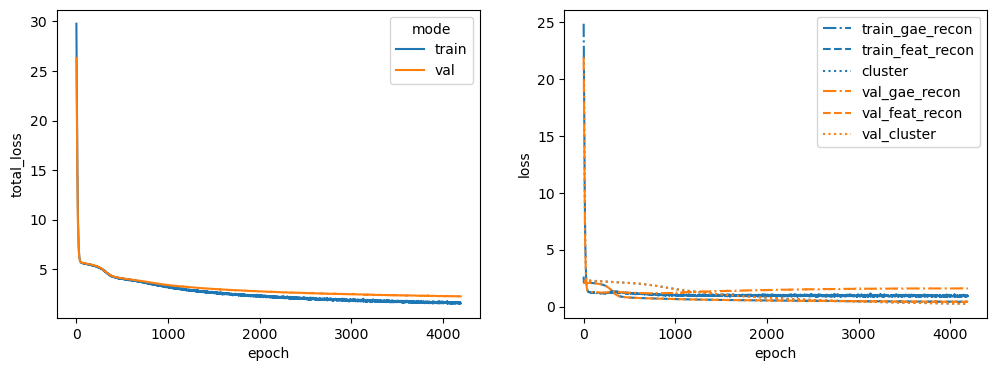

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 65%|██████▍   | 6497/10000 [02:15<01:12, 48.06it/s]


Training stopped after 6498 epochs
Best model found at epoch 6396
------------------------------------------------------------
TEST AUC: 0.7787755102040816 AP: 0.7846350630302708
TRAIN loss: 1.3273711204528809
VAL loss: 2.008450746536255
TEST loss: 1.8719592094421387
TEST AUC: 0.7787755102040816 	 AP: 0.7846350630302708


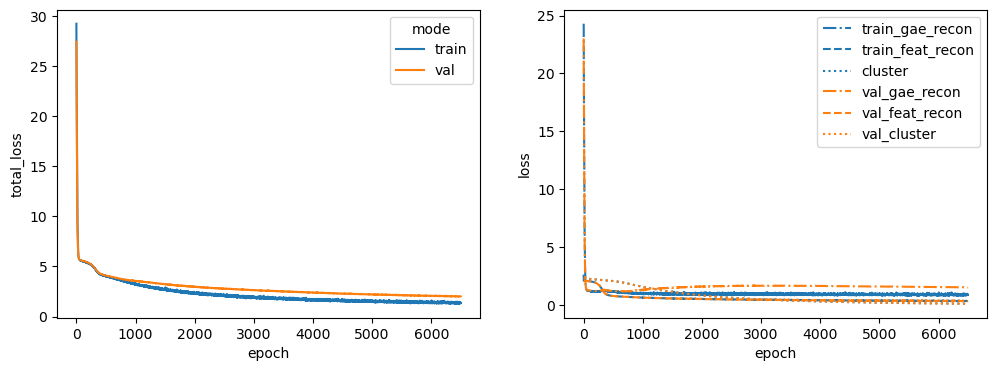

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 43%|████▎     | 4279/10000 [01:30<02:00, 47.52it/s]


Training stopped after 4280 epochs
Best model found at epoch 4178
------------------------------------------------------------
TEST AUC: 0.7773242630385487 AP: 0.8118305065523531
TRAIN loss: 1.549085021018982
VAL loss: 1.767738938331604
TEST loss: 1.9972981214523315
TEST AUC: 0.7773242630385487 	 AP: 0.8118305065523531


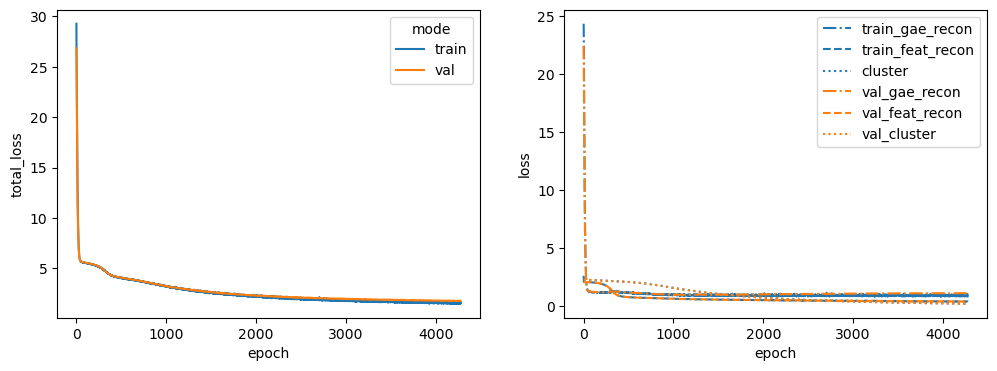

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 66%|██████▌   | 6597/10000 [02:17<01:11, 47.90it/s]


Training stopped after 6598 epochs
Best model found at epoch 6496
------------------------------------------------------------
TEST AUC: 0.7980045351473922 AP: 0.8305798963028727
TRAIN loss: 1.346733808517456
VAL loss: 1.6161891222000122
TEST loss: 1.7485077381134033
TEST AUC: 0.7980045351473922 	 AP: 0.8305798963028727


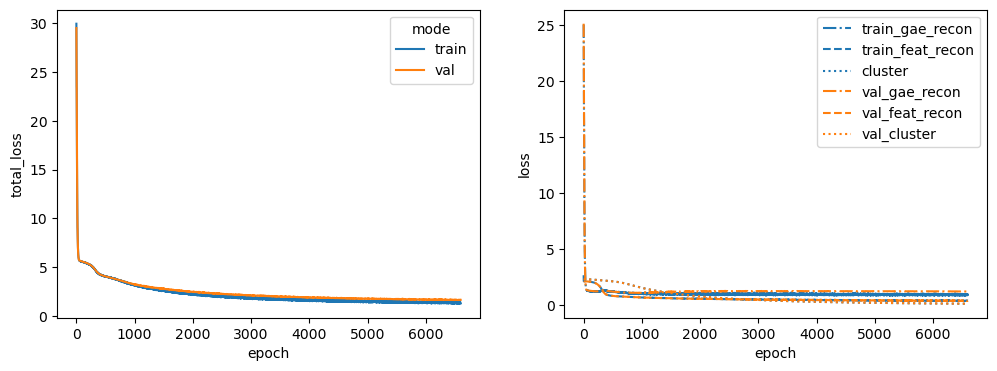

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 51%|█████▏    | 5127/10000 [01:47<01:42, 47.72it/s]


Training stopped after 5128 epochs
Best model found at epoch 5026
------------------------------------------------------------
TEST AUC: 0.7931972789115646 AP: 0.8201998840987281
TRAIN loss: 1.4544081687927246
VAL loss: 2.0085771083831787
TEST loss: 1.8841586112976074
TEST AUC: 0.7931972789115646 	 AP: 0.8201998840987281


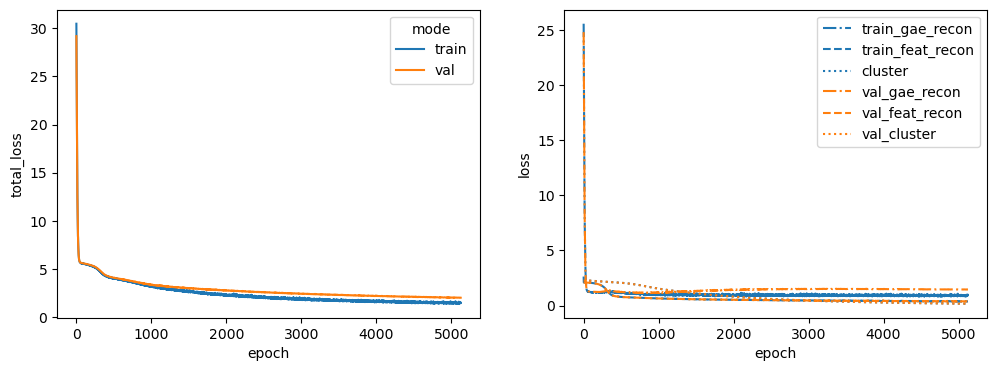

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 65%|██████▌   | 6538/10000 [02:18<01:13, 47.32it/s]


Training stopped after 6539 epochs
Best model found at epoch 6437
------------------------------------------------------------
TEST AUC: 0.8085260770975056 AP: 0.8166318015491794
TRAIN loss: 1.3294754028320312
VAL loss: 1.7141155004501343
TEST loss: 1.7295151948928833
TEST AUC: 0.8085260770975056 	 AP: 0.8166318015491794


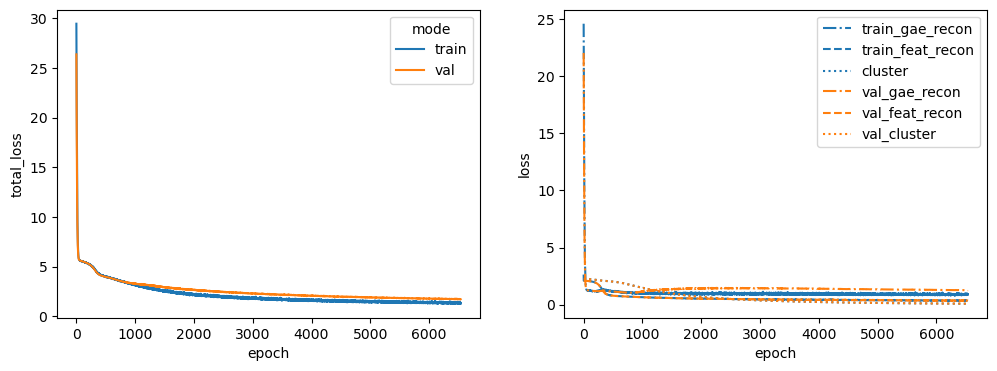

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 51%|█████     | 5112/10000 [01:45<01:41, 48.27it/s]


Training stopped after 5113 epochs
Best model found at epoch 5011
------------------------------------------------------------
TEST AUC: 0.769251700680272 AP: 0.794207639676359
TRAIN loss: 1.5237846374511719
VAL loss: 1.9924912452697754
TEST loss: 1.9959344863891602
TEST AUC: 0.769251700680272 	 AP: 0.794207639676359


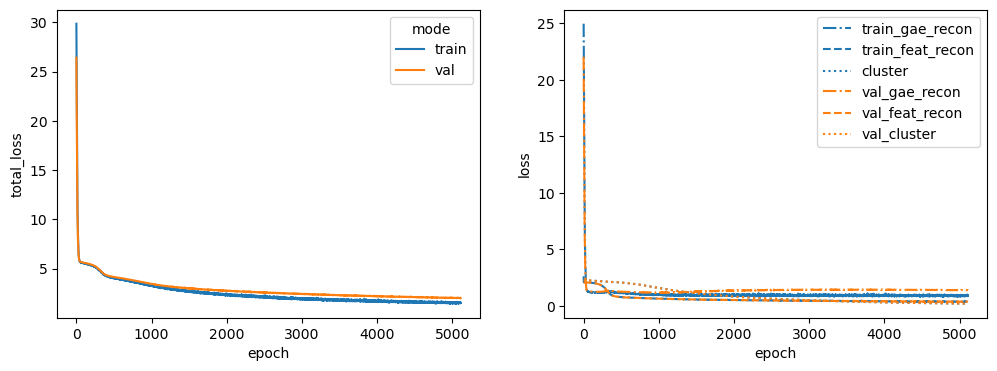

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 60%|█████▉    | 5955/10000 [02:06<01:25, 47.04it/s]


Training stopped after 5956 epochs
Best model found at epoch 5854
------------------------------------------------------------
TEST AUC: 0.8049886621315193 AP: 0.8257913593865435
TRAIN loss: 1.4957982301712036
VAL loss: 1.8914635181427002
TEST loss: 1.8365075588226318
TEST AUC: 0.8049886621315193 	 AP: 0.8257913593865435


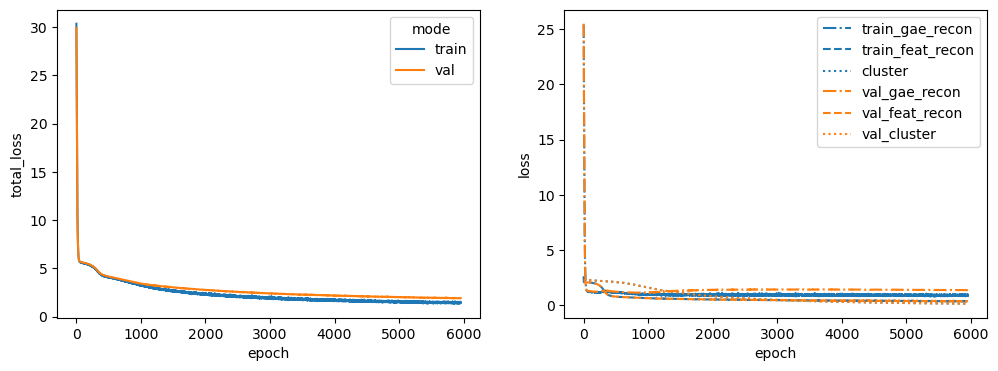

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 57%|█████▋    | 5678/10000 [01:59<01:30, 47.71it/s]


Training stopped after 5679 epochs
Best model found at epoch 5577
------------------------------------------------------------
TEST AUC: 0.8220408163265307 AP: 0.8463963498607017
TRAIN loss: 1.4340764284133911
VAL loss: 2.050996780395508
TEST loss: 1.754963755607605
TEST AUC: 0.8220408163265307 	 AP: 0.8463963498607017


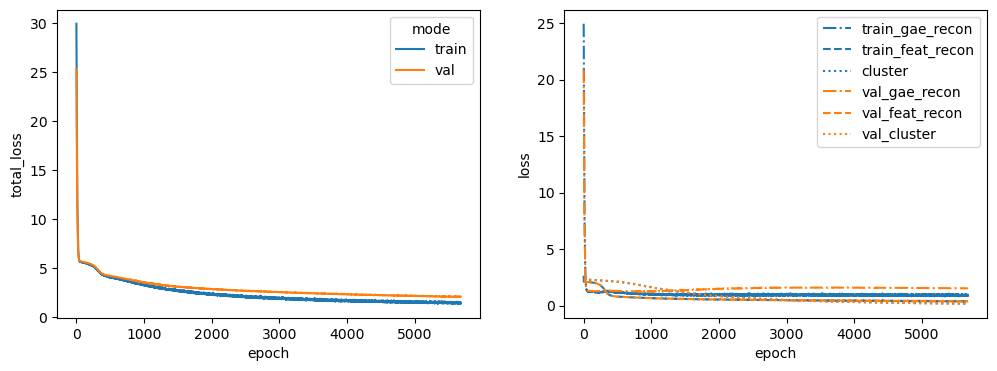

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 53%|█████▎    | 5316/10000 [01:50<01:37, 48.02it/s]


Training stopped after 5317 epochs
Best model found at epoch 5215
------------------------------------------------------------
TEST AUC: 0.8349206349206348 AP: 0.8464340584903444
TRAIN loss: 1.4309009313583374
VAL loss: 1.5304912328720093
TEST loss: 1.7440859079360962
TEST AUC: 0.8349206349206348 	 AP: 0.8464340584903444


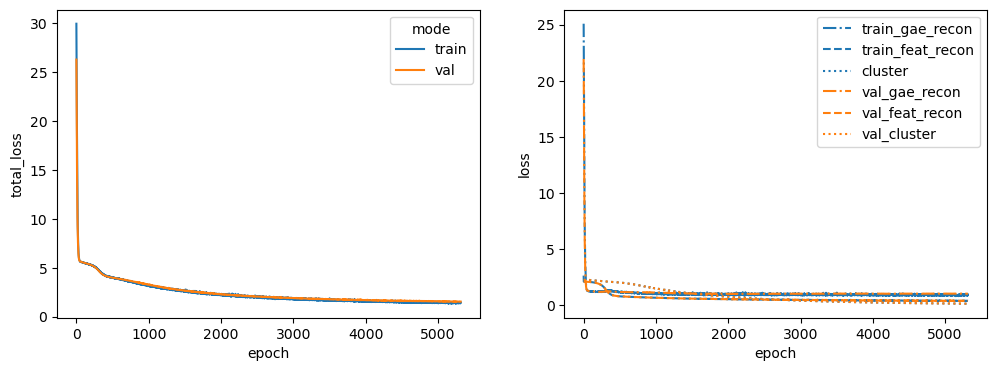

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 13%|█▎        | 1297/10000 [00:27<03:04, 47.18it/s]


Training stopped after 1298 epochs
Best model found at epoch 1196
------------------------------------------------------------
TEST AUC: 0.8189569160997733 AP: 0.7921460928507393
TRAIN loss: 2.910588502883911
VAL loss: 3.4427175521850586
TEST loss: 3.2455713748931885
TEST AUC: 0.8189569160997733 	 AP: 0.7921460928507393


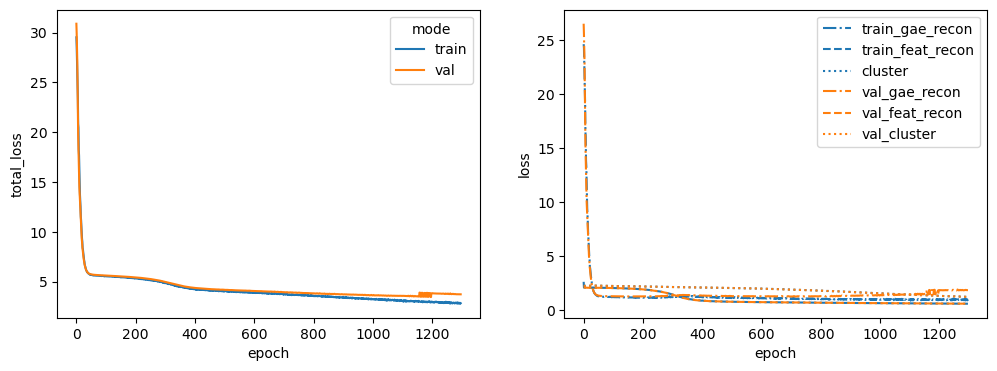

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 73%|███████▎  | 7306/10000 [02:30<00:55, 48.42it/s]


Training stopped after 7307 epochs
Best model found at epoch 7205
------------------------------------------------------------
TEST AUC: 0.8152380952380952 AP: 0.8526108916879833
TRAIN loss: 1.293238639831543
VAL loss: 1.8699188232421875
TEST loss: 1.658873200416565
TEST AUC: 0.8152380952380952 	 AP: 0.8526108916879833


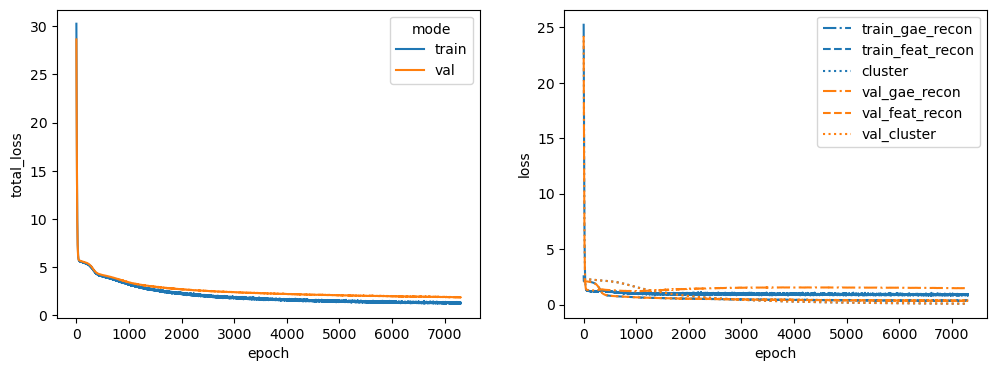

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 72%|███████▏  | 7194/10000 [02:29<00:58, 48.11it/s]


Training stopped after 7195 epochs
Best model found at epoch 7093
------------------------------------------------------------
TEST AUC: 0.8215873015873015 AP: 0.8154714073073221
TRAIN loss: 1.2478331327438354
VAL loss: 1.6642825603485107
TEST loss: 1.6687400341033936
TEST AUC: 0.8215873015873015 	 AP: 0.8154714073073221


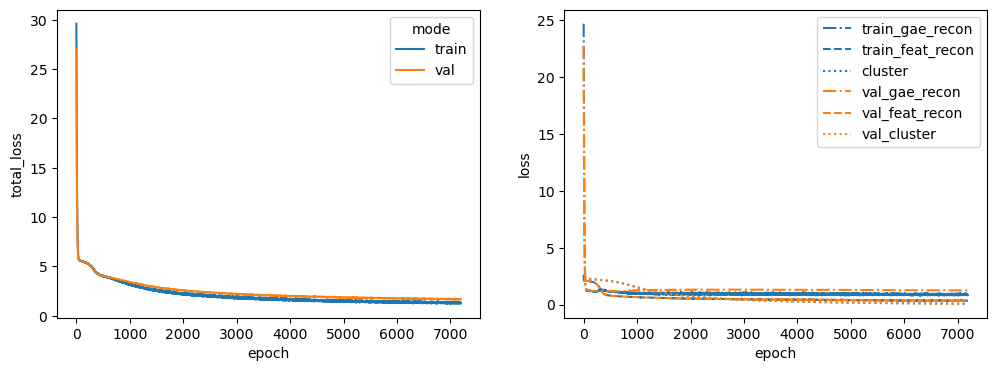

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 54%|█████▎    | 5351/10000 [01:51<01:37, 47.82it/s]


Training stopped after 5352 epochs
Best model found at epoch 5250
------------------------------------------------------------
TEST AUC: 0.7633560090702948 AP: 0.7772223264186137
TRAIN loss: 1.426455020904541
VAL loss: 1.7146391868591309
TEST loss: 1.9836077690124512
TEST AUC: 0.7633560090702948 	 AP: 0.7772223264186137


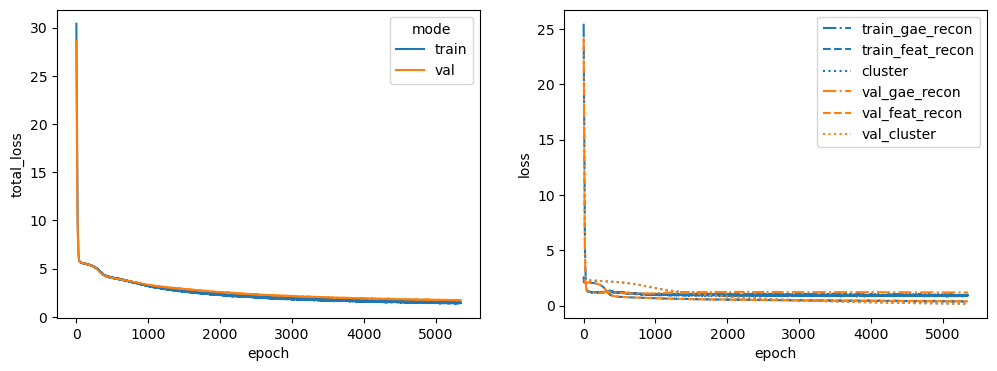

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 51%|█████     | 5098/10000 [01:46<01:42, 47.74it/s]


Training stopped after 5099 epochs
Best model found at epoch 4997
------------------------------------------------------------
TEST AUC: 0.8130612244897958 AP: 0.81316166267054
TRAIN loss: 1.5843873023986816
VAL loss: 1.8819732666015625
TEST loss: 1.9010753631591797
TEST AUC: 0.8130612244897958 	 AP: 0.81316166267054


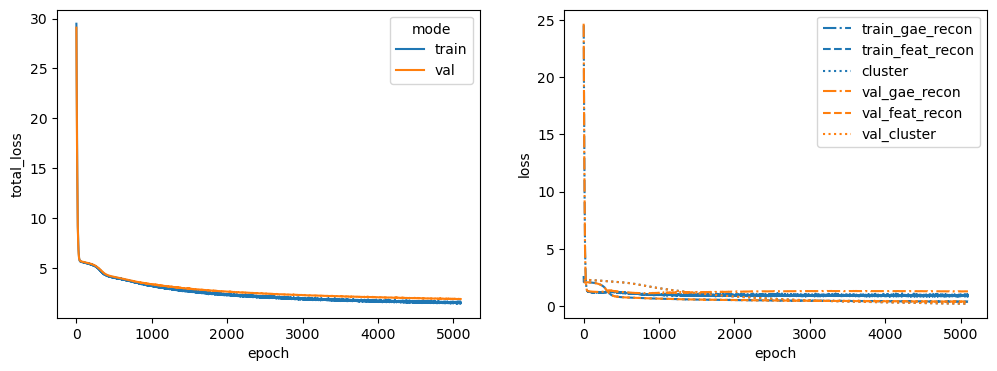

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 52%|█████▏    | 5193/10000 [01:49<01:41, 47.43it/s]


Training stopped after 5194 epochs
Best model found at epoch 5092
------------------------------------------------------------
TEST AUC: 0.783219954648526 AP: 0.7704497685344408
TRAIN loss: 1.4522637128829956
VAL loss: 1.6347941160202026
TEST loss: 1.97896409034729
TEST AUC: 0.783219954648526 	 AP: 0.7704497685344408


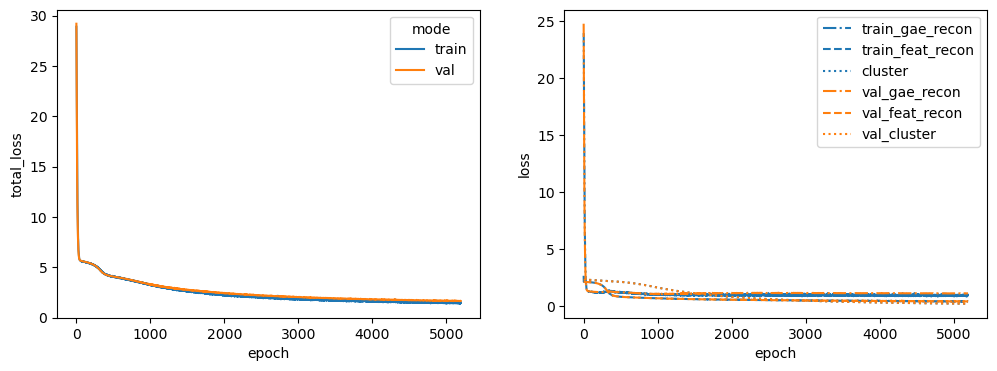

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 31%|███       | 3093/10000 [01:05<02:25, 47.35it/s]


Training stopped after 3094 epochs
Best model found at epoch 2992
------------------------------------------------------------
TEST AUC: 0.7759637188208616 AP: 0.8236848795072373
TRAIN loss: 1.857313632965088
VAL loss: 2.3825106620788574
TEST loss: 2.3220677375793457
TEST AUC: 0.7759637188208616 	 AP: 0.8236848795072373


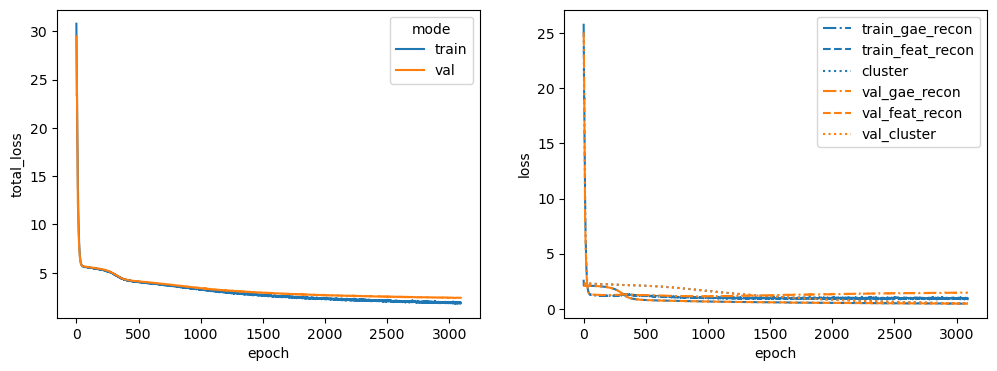

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 46%|████▋     | 4642/10000 [01:37<01:53, 47.38it/s]


Training stopped after 4643 epochs
Best model found at epoch 4541
------------------------------------------------------------
TEST AUC: 0.79156462585034 AP: 0.8167500268463677
TRAIN loss: 1.591428518295288
VAL loss: 1.698952078819275
TEST loss: 1.9706463813781738
TEST AUC: 0.79156462585034 	 AP: 0.8167500268463677


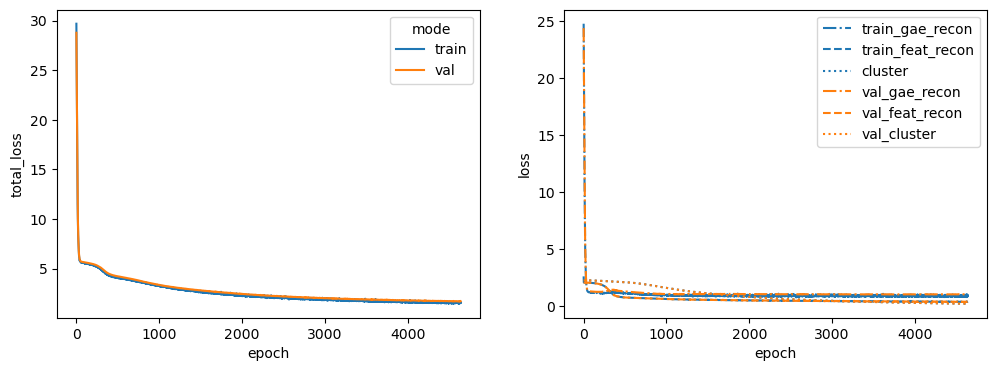

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 60%|██████    | 6035/10000 [02:08<01:24, 47.13it/s]


Training stopped after 6036 epochs
Best model found at epoch 5934
------------------------------------------------------------
TEST AUC: 0.8155102040816327 AP: 0.850997154701798
TRAIN loss: 1.3421695232391357
VAL loss: 1.6258474588394165
TEST loss: 1.7227561473846436
TEST AUC: 0.8155102040816327 	 AP: 0.850997154701798


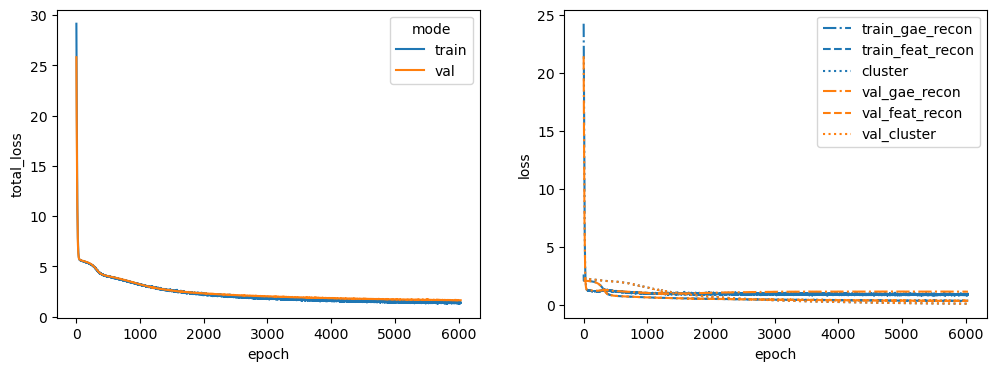

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 51%|█████     | 5114/10000 [01:47<01:42, 47.52it/s]


Training stopped after 5115 epochs
Best model found at epoch 5013
------------------------------------------------------------
TEST AUC: 0.8008163265306123 AP: 0.8434087646057926
TRAIN loss: 1.5365862846374512
VAL loss: 1.9559029340744019
TEST loss: 1.8705580234527588
TEST AUC: 0.8008163265306123 	 AP: 0.8434087646057926


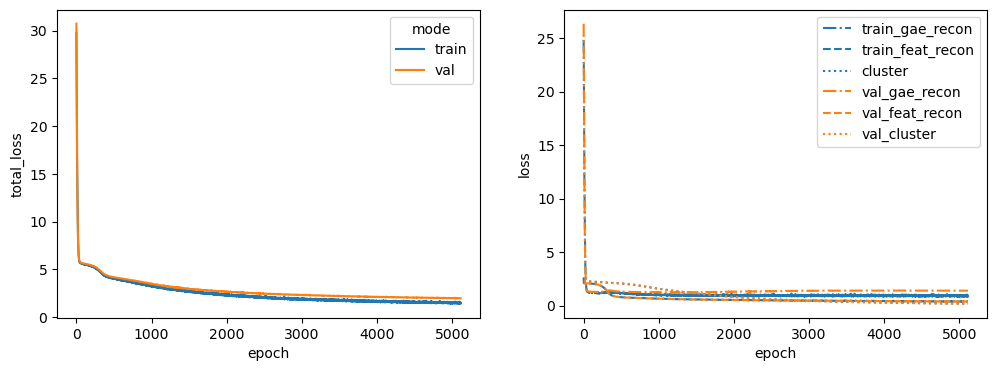

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 51%|█████     | 5082/10000 [01:47<01:44, 47.23it/s]


Training stopped after 5083 epochs
Best model found at epoch 4981
------------------------------------------------------------
TEST AUC: 0.8042630385487529 AP: 0.8287293030492563
TRAIN loss: 1.4527539014816284
VAL loss: 2.0025455951690674
TEST loss: 1.8606218099594116
TEST AUC: 0.8042630385487529 	 AP: 0.8287293030492563


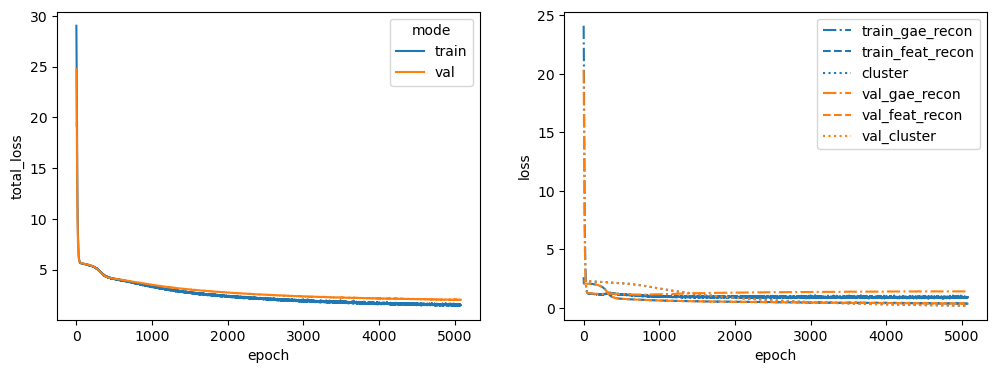

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 56%|█████▌    | 5566/10000 [01:57<01:33, 47.51it/s]


Training stopped after 5567 epochs
Best model found at epoch 5465
------------------------------------------------------------
TEST AUC: 0.7861224489795919 AP: 0.7952726394254912
TRAIN loss: 1.4018522500991821
VAL loss: 1.8613640069961548
TEST loss: 1.909350037574768
TEST AUC: 0.7861224489795919 	 AP: 0.7952726394254912


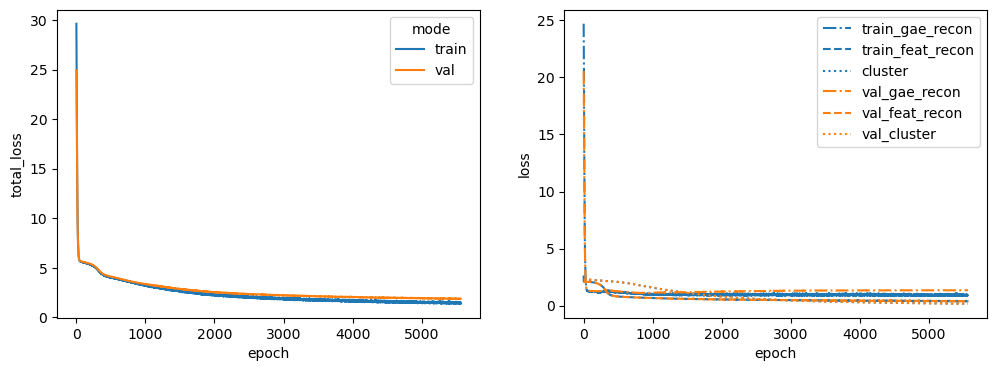

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 29%|██▉       | 2900/10000 [01:01<02:30, 47.14it/s]


Training stopped after 2901 epochs
Best model found at epoch 2799
------------------------------------------------------------
TEST AUC: 0.8144217687074828 AP: 0.8354592144421704
TRAIN loss: 1.8741581439971924
VAL loss: 2.25639009475708
TEST loss: 2.199159622192383
TEST AUC: 0.8144217687074828 	 AP: 0.8354592144421704


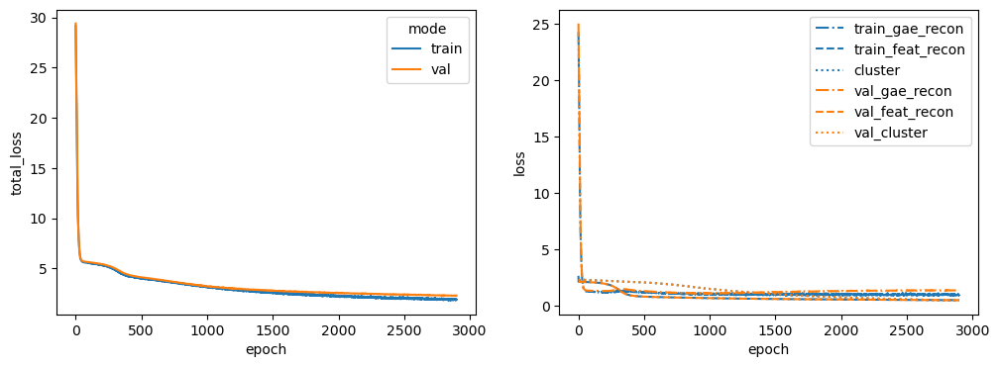

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 37%|███▋      | 3742/10000 [01:19<02:13, 46.97it/s]


Training stopped after 3743 epochs
Best model found at epoch 3641
------------------------------------------------------------
TEST AUC: 0.7608163265306123 AP: 0.7622640771427267
TRAIN loss: 1.736873984336853
VAL loss: 2.060337781906128
TEST loss: 2.2290492057800293
TEST AUC: 0.7608163265306123 	 AP: 0.7622640771427267


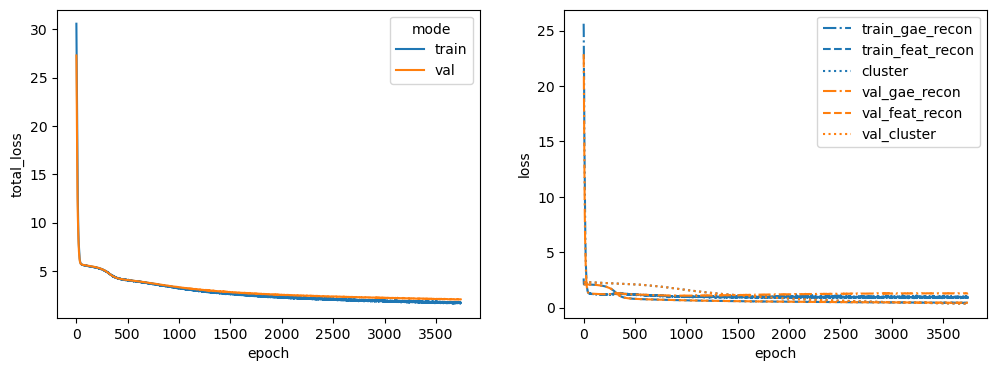

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 68%|██████▊   | 6850/10000 [02:21<01:05, 48.28it/s]


Training stopped after 6851 epochs
Best model found at epoch 6749
------------------------------------------------------------
TEST AUC: 0.8183219954648526 AP: 0.8304901460527111
TRAIN loss: 1.3394520282745361
VAL loss: 1.7353366613388062
TEST loss: 1.7477667331695557
TEST AUC: 0.8183219954648526 	 AP: 0.8304901460527111


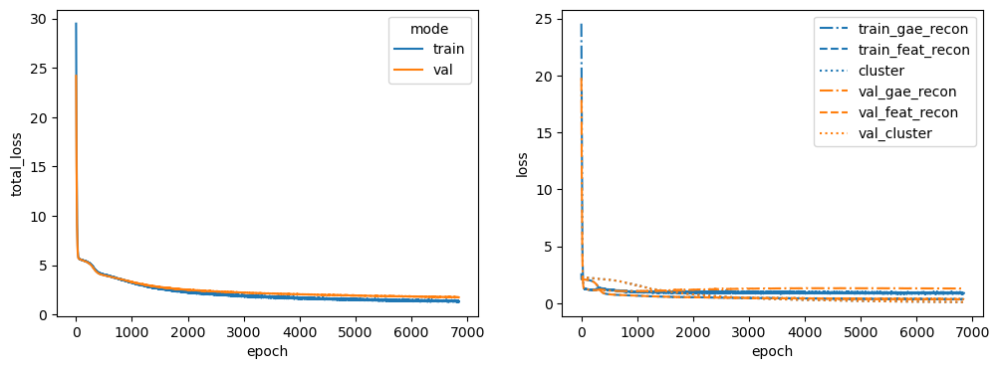

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 53%|█████▎    | 5331/10000 [01:51<01:37, 47.68it/s]


Training stopped after 5332 epochs
Best model found at epoch 5230
------------------------------------------------------------
TEST AUC: 0.8161451247165533 AP: 0.8453574511971165
TRAIN loss: 1.464789867401123
VAL loss: 1.924120306968689
TEST loss: 1.8268101215362549
TEST AUC: 0.8161451247165533 	 AP: 0.8453574511971165


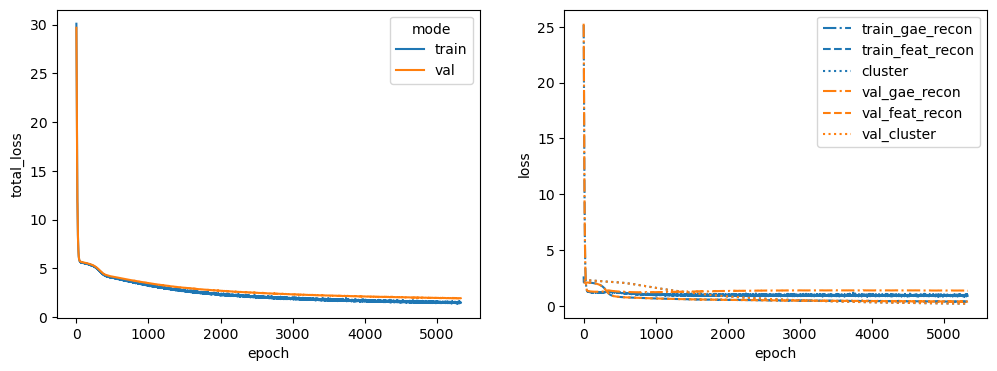

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 45%|████▍     | 4456/10000 [01:34<01:58, 46.92it/s]


Training stopped after 4457 epochs
Best model found at epoch 4355
------------------------------------------------------------
TEST AUC: 0.8051700680272109 AP: 0.8426919430493076
TRAIN loss: 1.5806877613067627
VAL loss: 1.8537437915802002
TEST loss: 1.986224889755249
TEST AUC: 0.8051700680272109 	 AP: 0.8426919430493076


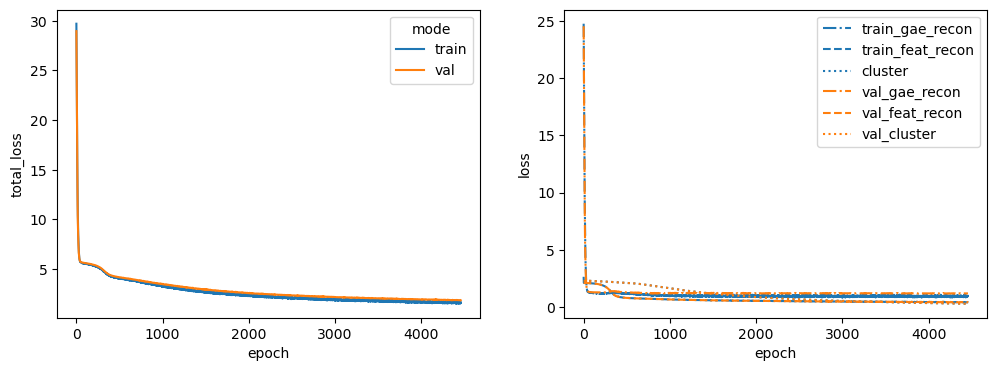

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 74%|███████▍  | 7410/10000 [02:34<00:53, 48.07it/s]


Training stopped after 7411 epochs
Best model found at epoch 7309
------------------------------------------------------------
TEST AUC: 0.8245804988662131 AP: 0.8303993245750514
TRAIN loss: 1.3270466327667236
VAL loss: 1.4280266761779785
TEST loss: 1.669952630996704
TEST AUC: 0.8245804988662131 	 AP: 0.8303993245750514


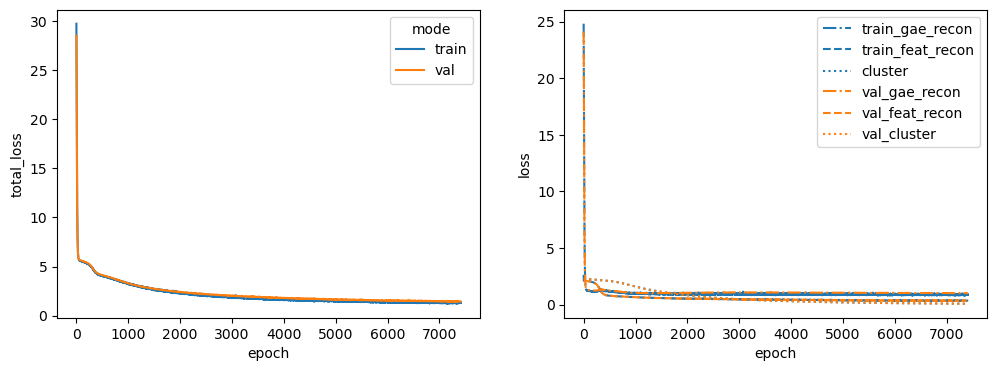

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 53%|█████▎    | 5343/10000 [01:50<01:36, 48.25it/s]


Training stopped after 5344 epochs
Best model found at epoch 5242
------------------------------------------------------------
TEST AUC: 0.7949206349206348 AP: 0.785172309263551
TRAIN loss: 1.4308311939239502
VAL loss: 1.6321941614151
TEST loss: 1.9447020292282104
TEST AUC: 0.7949206349206348 	 AP: 0.785172309263551


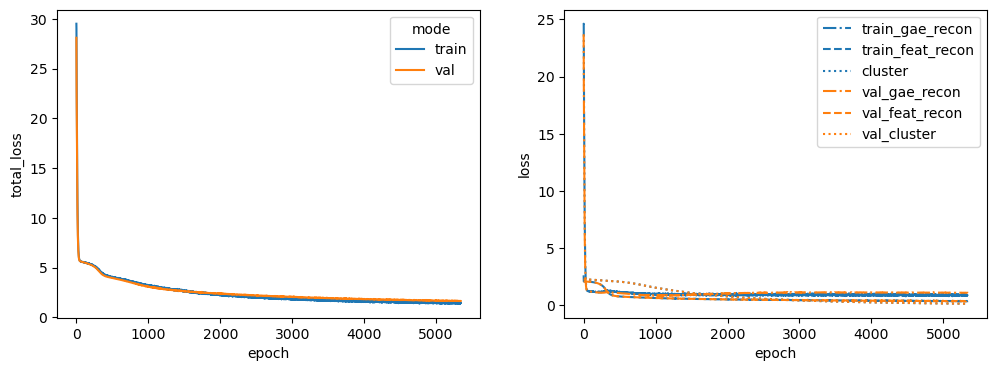

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 60%|█████▉    | 5995/10000 [02:05<01:23, 47.92it/s]


Training stopped after 5996 epochs
Best model found at epoch 5894
------------------------------------------------------------
TEST AUC: 0.8180498866213151 AP: 0.8115150474764548
TRAIN loss: 1.3680622577667236
VAL loss: 1.787199854850769
TEST loss: 1.7766118049621582
TEST AUC: 0.8180498866213151 	 AP: 0.8115150474764548


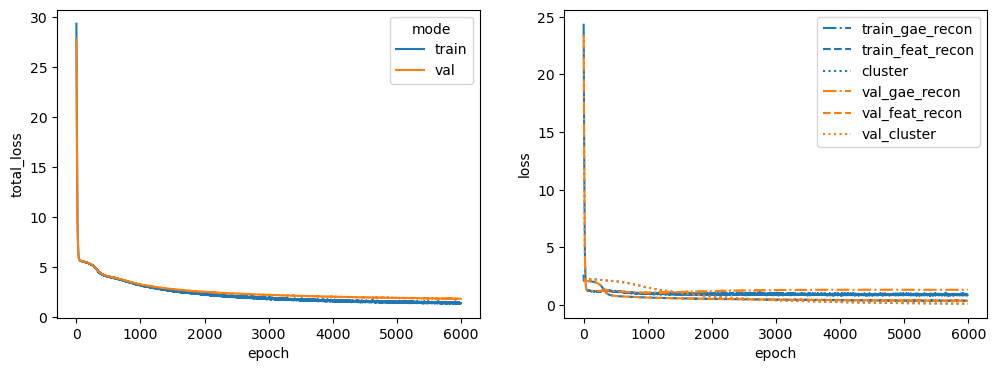

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 41%|████      | 4061/10000 [01:24<02:04, 47.89it/s]


Training stopped after 4062 epochs
Best model found at epoch 3960
------------------------------------------------------------
TEST AUC: 0.8211337868480726 AP: 0.8463732670817057
TRAIN loss: 1.6593014001846313
VAL loss: 2.144327402114868
TEST loss: 1.9475983381271362
TEST AUC: 0.8211337868480726 	 AP: 0.8463732670817057


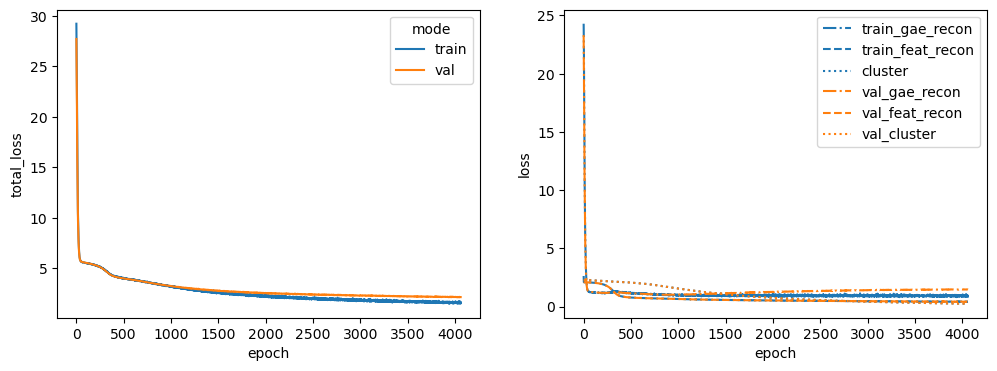

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 45%|████▌     | 4536/10000 [01:34<01:53, 48.09it/s]


Training stopped after 4537 epochs
Best model found at epoch 4435
------------------------------------------------------------
TEST AUC: 0.807891156462585 AP: 0.8453067749704914
TRAIN loss: 1.589739441871643
VAL loss: 1.8893977403640747
TEST loss: 1.9302406311035156
TEST AUC: 0.807891156462585 	 AP: 0.8453067749704914


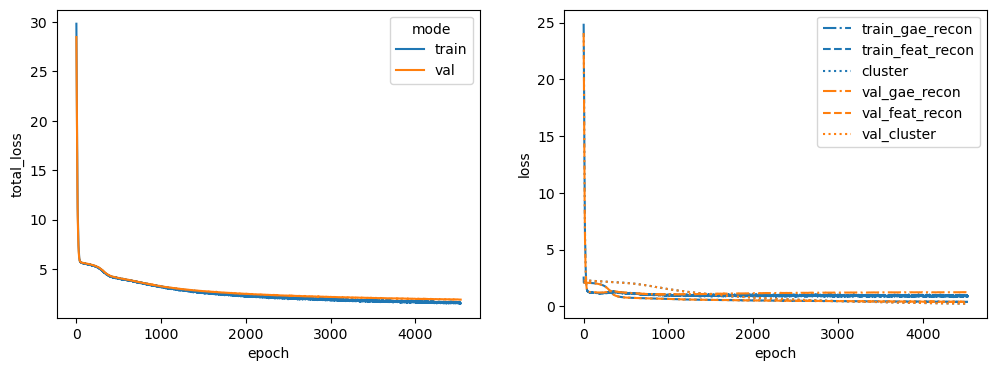

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 74%|███████▎  | 7370/10000 [02:33<00:54, 48.16it/s]


Training stopped after 7371 epochs
Best model found at epoch 7269
------------------------------------------------------------
TEST AUC: 0.8354648526077098 AP: 0.8293608613857117
TRAIN loss: 1.2991136312484741
VAL loss: 1.6432727575302124
TEST loss: 1.6887866258621216
TEST AUC: 0.8354648526077098 	 AP: 0.8293608613857117


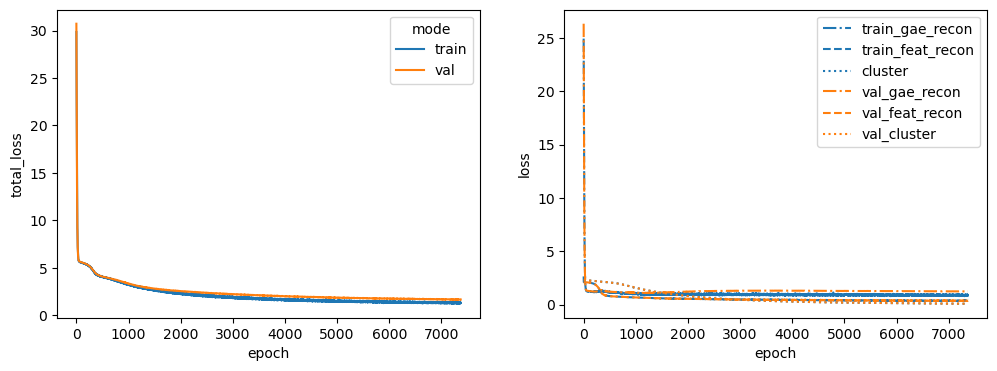

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 60%|██████    | 6048/10000 [02:05<01:22, 48.10it/s]


Training stopped after 6049 epochs
Best model found at epoch 5947
------------------------------------------------------------
TEST AUC: 0.8066213151927437 AP: 0.8276276496325986
TRAIN loss: 1.4402190446853638
VAL loss: 1.6792668104171753
TEST loss: 1.7947819232940674
TEST AUC: 0.8066213151927437 	 AP: 0.8276276496325986


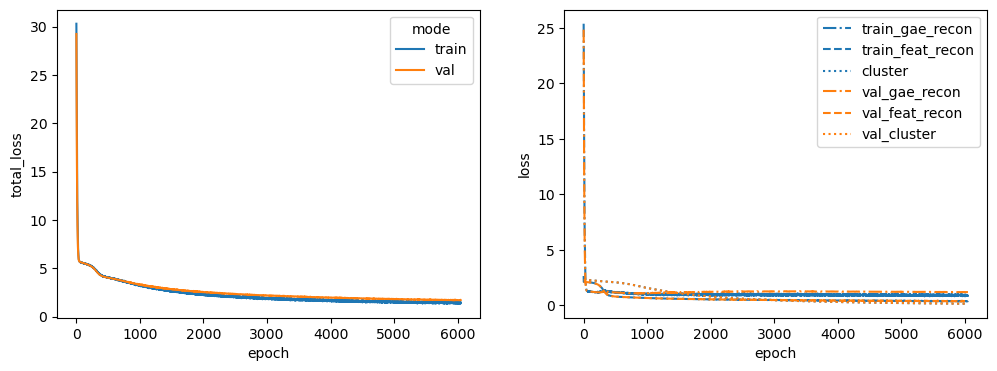

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [15]:
for alpha, beta, gamma in alpha_beta_gamma_opts:
    run_reg_space_loto_exp(
        root_output_dir=root_output_dir,
        oe_targets=oe_targets,
        interactome=spearman_interactome,
        physical_cluster_dict=physical_cluster_dict,
        physical_full_cluster_dict=physical_full_cluster_dict,
        cmap_clusters=cmap_clusters,
        cluster_opt=cluster_opt,
        graph_opt=graph_opt,
        alpha=alpha,
        beta=beta,
        gamma=gamma,
        n_classes=10,
        seed=1234,
        node_feature_key="sc_gex_hallmark",
        input_dim=1176,
        latent_dim=1024,
        early_stopping=100,
        neg_edge_ratio=1,
        lr=0.00001,
    )

dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 64%|██████▎   | 6367/10000 [02:16<01:17, 46.69it/s]


Training stopped after 6368 epochs
Best model found at epoch 6266
------------------------------------------------------------
TEST AUC: 0.7788662131519274 AP: 0.8039454522442175
TRAIN loss: 1.0735704898834229
VAL loss: 1.3311115503311157
TEST loss: 1.4325217008590698
TEST AUC: 0.7788662131519274 	 AP: 0.8039454522442175


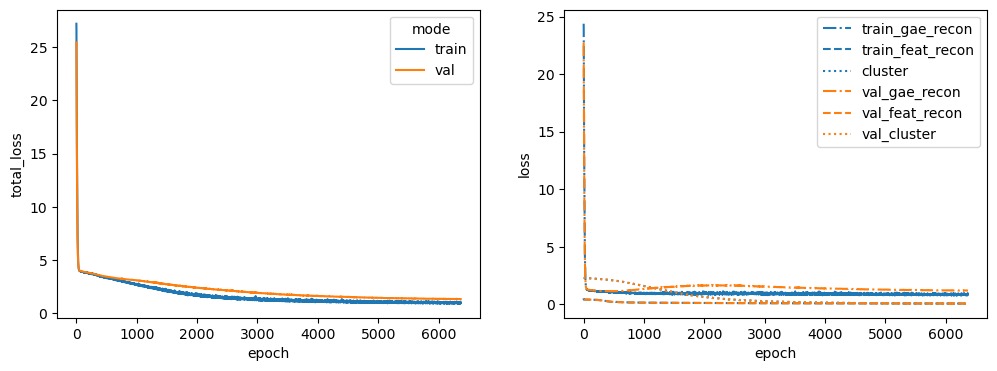

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 22%|██▏       | 2206/10000 [00:41<02:27, 52.90it/s]


Training stopped after 2207 epochs
Best model found at epoch 2105
------------------------------------------------------------
TEST AUC: 0.8093424036281179 AP: 0.7939095137315685
TRAIN loss: 1.517746925354004
VAL loss: 1.90423583984375
TEST loss: 1.9390411376953125
TEST AUC: 0.8093424036281179 	 AP: 0.7939095137315685


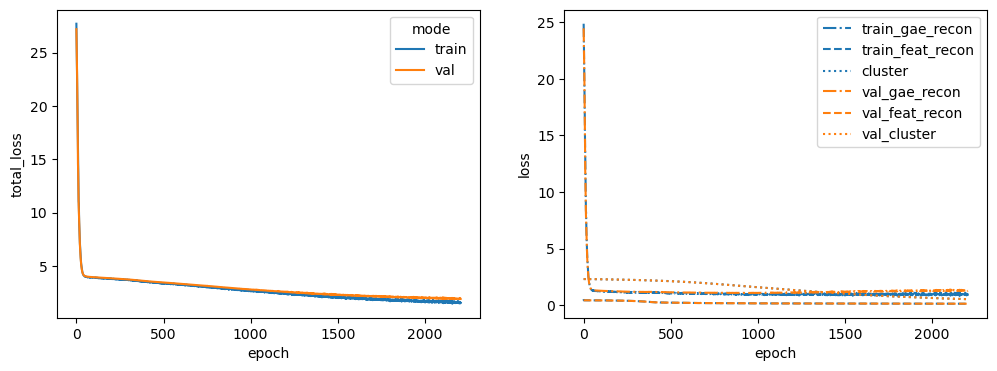

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 35%|███▍      | 3489/10000 [01:15<02:20, 46.28it/s]


Training stopped after 3490 epochs
Best model found at epoch 3388
------------------------------------------------------------
TEST AUC: 0.7941043083900227 AP: 0.8233767397009182
TRAIN loss: 1.262175440788269
VAL loss: 1.8157795667648315
TEST loss: 1.5766501426696777
TEST AUC: 0.7941043083900227 	 AP: 0.8233767397009182


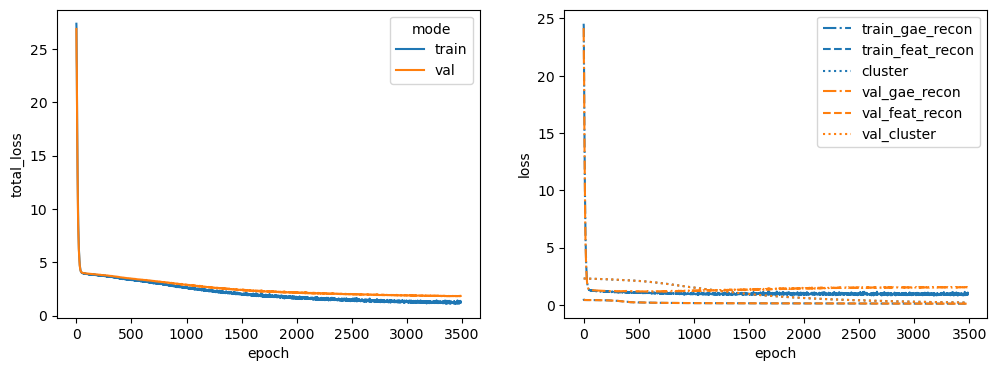

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 37%|███▋      | 3689/10000 [01:22<02:20, 44.89it/s]


Training stopped after 3690 epochs
Best model found at epoch 3588
------------------------------------------------------------
TEST AUC: 0.7648072562358277 AP: 0.7873935159308636
TRAIN loss: 1.3017714023590088
VAL loss: 1.7590526342391968
TEST loss: 1.688416600227356
TEST AUC: 0.7648072562358277 	 AP: 0.7873935159308636


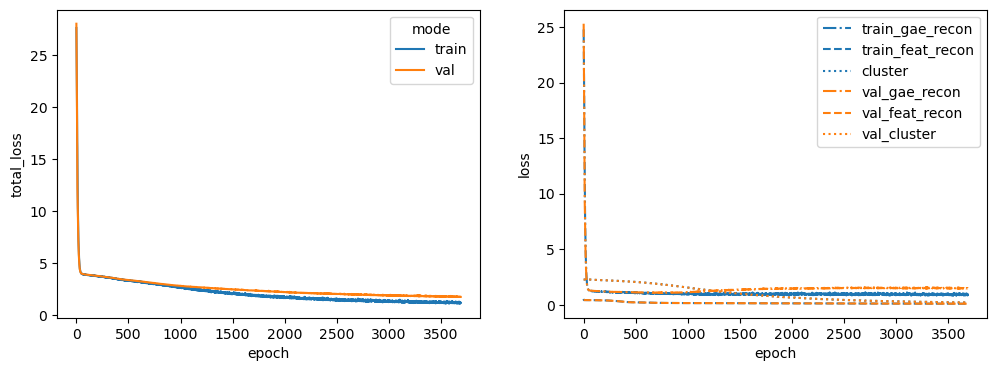

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 27%|██▋       | 2725/10000 [01:02<02:45, 43.86it/s]


Training stopped after 2726 epochs
Best model found at epoch 2624
------------------------------------------------------------
TEST AUC: 0.7749659863945578 AP: 0.7754903651888759
TRAIN loss: 1.4632749557495117
VAL loss: 1.7406795024871826
TEST loss: 1.836835503578186
TEST AUC: 0.7749659863945578 	 AP: 0.7754903651888759


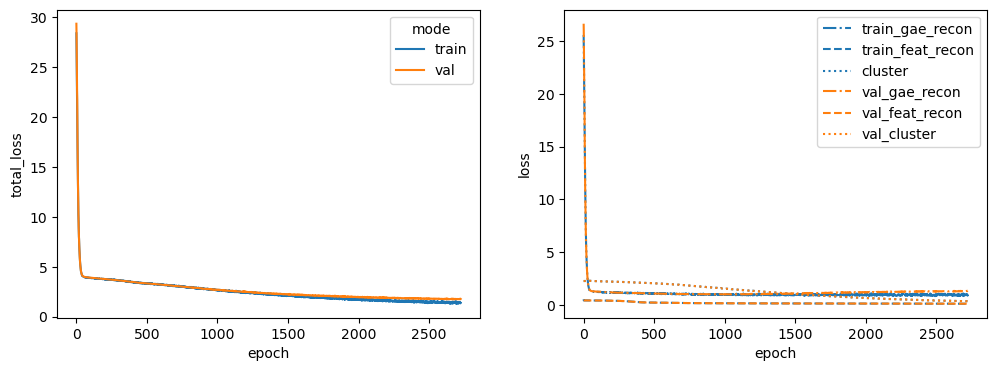

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 46%|████▌     | 4568/10000 [01:48<02:08, 42.22it/s]


Training stopped after 4569 epochs
Best model found at epoch 4467
------------------------------------------------------------
TEST AUC: 0.8095238095238096 AP: 0.8502414800758211
TRAIN loss: 1.1377004384994507
VAL loss: 1.7218765020370483
TEST loss: 1.4136134386062622
TEST AUC: 0.8095238095238096 	 AP: 0.8502414800758211


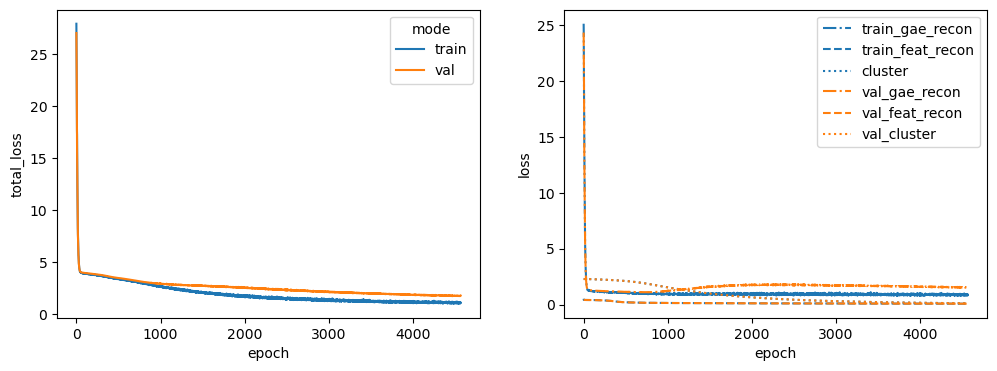

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 42%|████▏     | 4228/10000 [01:42<02:19, 41.37it/s]


Training stopped after 4229 epochs
Best model found at epoch 4127
------------------------------------------------------------
TEST AUC: 0.7980045351473922 AP: 0.790105806769551
TRAIN loss: 1.1547017097473145
VAL loss: 1.375331997871399
TEST loss: 1.5371428728103638
TEST AUC: 0.7980045351473922 	 AP: 0.790105806769551


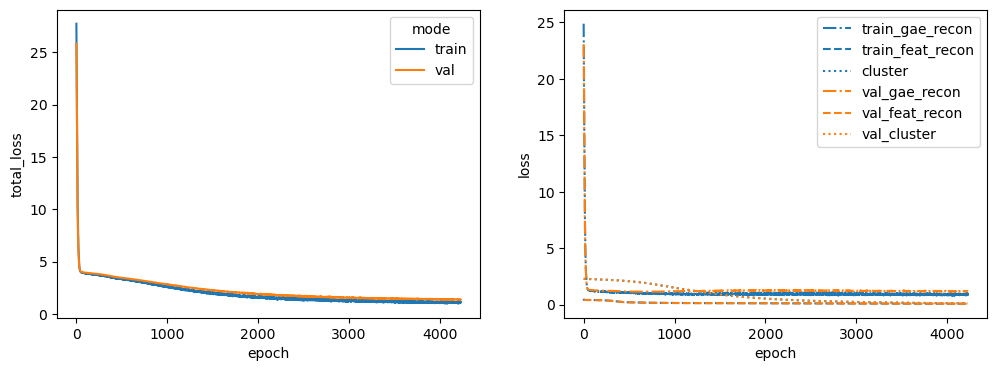

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 50%|████▉     | 4951/10000 [02:00<02:02, 41.22it/s]


Training stopped after 4952 epochs
Best model found at epoch 4850
------------------------------------------------------------
TEST AUC: 0.8215873015873015 AP: 0.8199648481245231
TRAIN loss: 1.0330206155776978
VAL loss: 1.3262532949447632
TEST loss: 1.3938302993774414
TEST AUC: 0.8215873015873015 	 AP: 0.8199648481245231


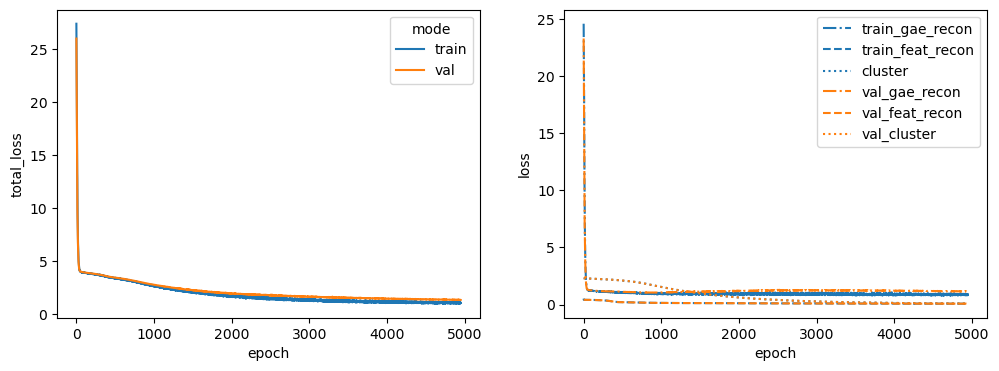

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 44%|████▍     | 4417/10000 [01:47<02:15, 41.18it/s]


Training stopped after 4418 epochs
Best model found at epoch 4316
------------------------------------------------------------
TEST AUC: 0.7787755102040818 AP: 0.7359531199452165
TRAIN loss: 1.1577870845794678
VAL loss: 1.2906781435012817
TEST loss: 1.704185128211975
TEST AUC: 0.7787755102040818 	 AP: 0.7359531199452165


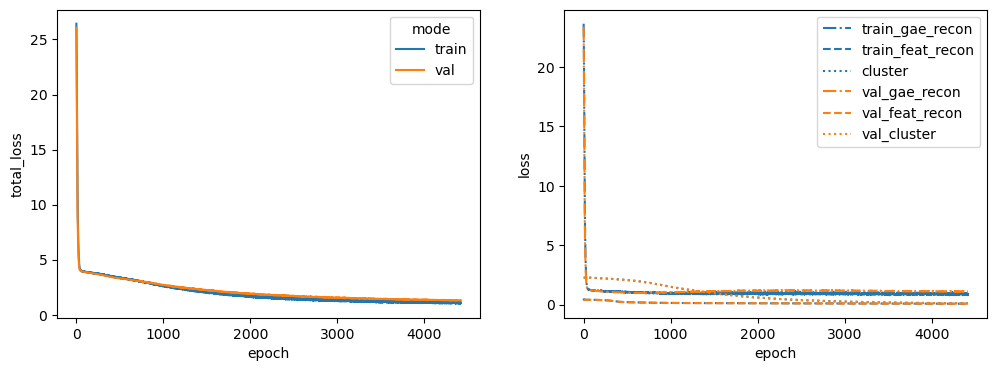

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 56%|█████▌    | 5566/10000 [02:11<01:45, 42.20it/s]


Training stopped after 5567 epochs
Best model found at epoch 5465
------------------------------------------------------------
TEST AUC: 0.7919274376417235 AP: 0.8080674063552321
TRAIN loss: 1.0656574964523315
VAL loss: 1.213150143623352
TEST loss: 1.436050295829773
TEST AUC: 0.7919274376417235 	 AP: 0.8080674063552321


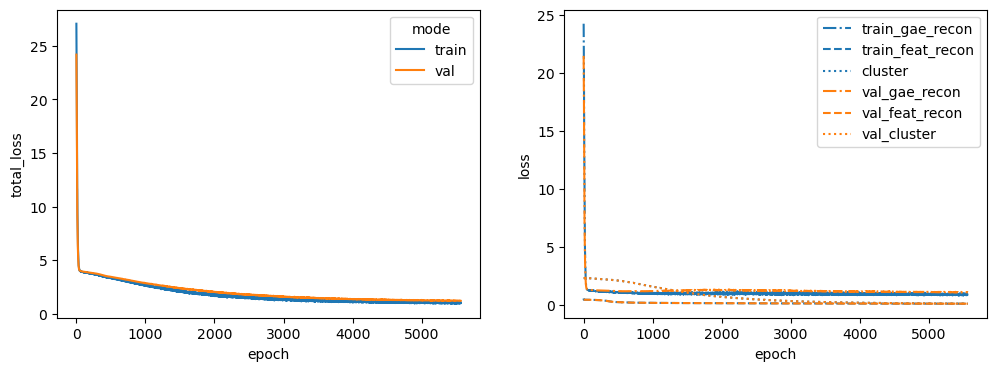

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 41%|████      | 4060/10000 [01:37<02:21, 41.84it/s]


Training stopped after 4061 epochs
Best model found at epoch 3959
------------------------------------------------------------
TEST AUC: 0.7816780045351474 AP: 0.7949853191651859
TRAIN loss: 1.114303708076477
VAL loss: 1.3343037366867065
TEST loss: 1.5428104400634766
TEST AUC: 0.7816780045351474 	 AP: 0.7949853191651859


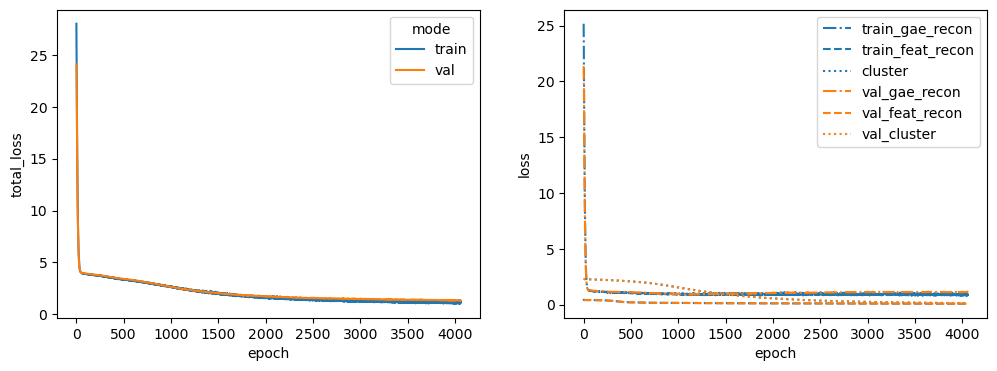

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 48%|████▊     | 4760/10000 [01:52<02:04, 42.18it/s]


Training stopped after 4761 epochs
Best model found at epoch 4659
------------------------------------------------------------
TEST AUC: 0.8159637188208616 AP: 0.8320556757959927
TRAIN loss: 1.0938376188278198
VAL loss: 1.5039782524108887
TEST loss: 1.3865660429000854
TEST AUC: 0.8159637188208616 	 AP: 0.8320556757959927


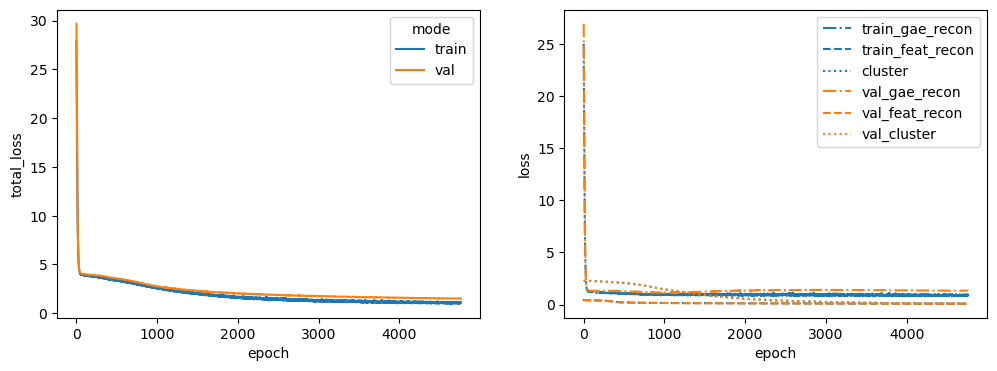

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 28%|██▊       | 2750/10000 [01:05<02:51, 42.23it/s]


Training stopped after 2751 epochs
Best model found at epoch 2649
------------------------------------------------------------
TEST AUC: 0.8377324263038548 AP: 0.8393855205321441
TRAIN loss: 1.3825637102127075
VAL loss: 1.8868775367736816
TEST loss: 1.6150298118591309
TEST AUC: 0.8377324263038548 	 AP: 0.8393855205321441


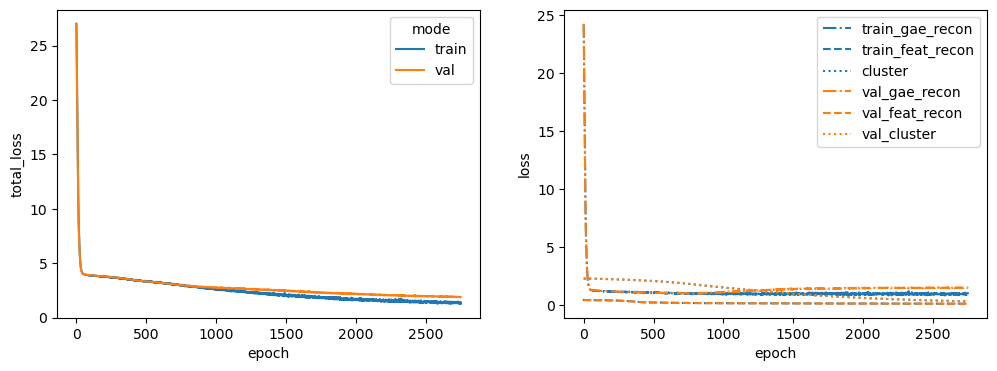

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 18%|█▊        | 1831/10000 [00:43<03:11, 42.58it/s]


Training stopped after 1832 epochs
Best model found at epoch 1730
------------------------------------------------------------
TEST AUC: 0.7515646258503401 AP: 0.7396027936686451
TRAIN loss: 1.787016749382019
VAL loss: 2.2891910076141357
TEST loss: 2.38118314743042
TEST AUC: 0.7515646258503401 	 AP: 0.7396027936686451


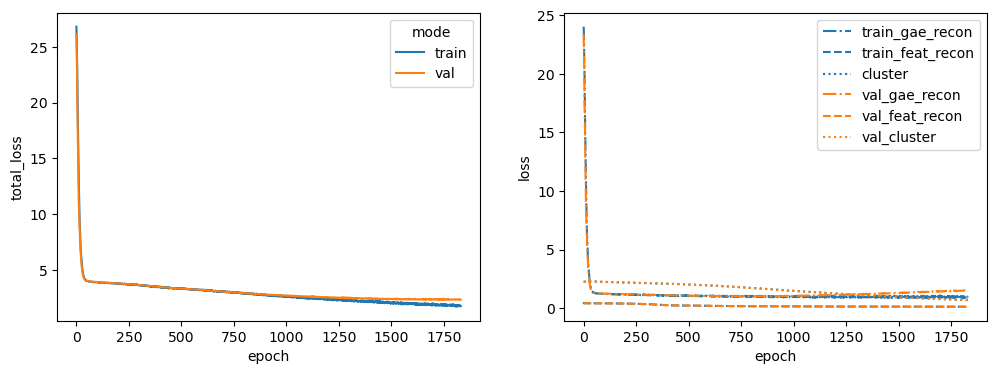

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 35%|███▌      | 3520/10000 [01:16<02:20, 46.03it/s]


Training stopped after 3521 epochs
Best model found at epoch 3419
------------------------------------------------------------
TEST AUC: 0.7610884353741497 AP: 0.7545258602809054
TRAIN loss: 1.2517470121383667
VAL loss: 1.4229168891906738
TEST loss: 1.7375454902648926
TEST AUC: 0.7610884353741497 	 AP: 0.7545258602809054


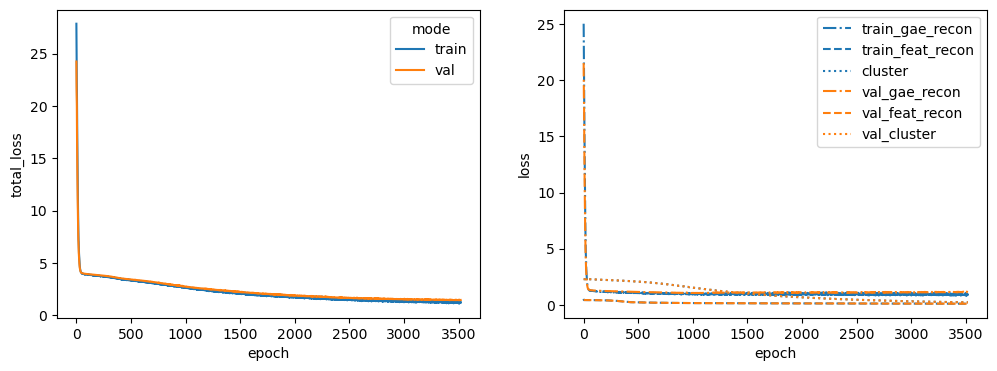

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 50%|█████     | 5035/10000 [01:47<01:45, 46.85it/s]


Training stopped after 5036 epochs
Best model found at epoch 4934
------------------------------------------------------------
TEST AUC: 0.7980045351473923 AP: 0.8308230474348421
TRAIN loss: 1.0228075981140137
VAL loss: 1.367221474647522
TEST loss: 1.416701316833496
TEST AUC: 0.7980045351473923 	 AP: 0.8308230474348421


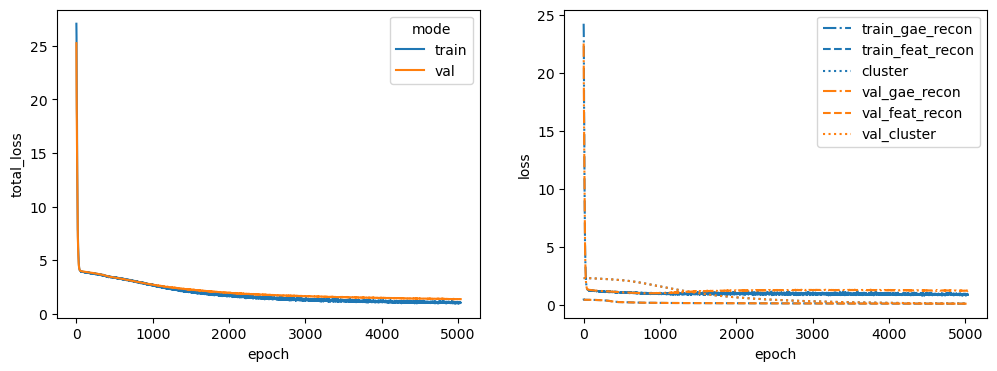

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 61%|██████    | 6119/10000 [02:08<01:21, 47.61it/s]


Training stopped after 6120 epochs
Best model found at epoch 6018
------------------------------------------------------------
TEST AUC: 0.7788662131519274 AP: 0.7409940507931846
TRAIN loss: 1.0086126327514648
VAL loss: 1.344657301902771
TEST loss: 1.5711315870285034
TEST AUC: 0.7788662131519274 	 AP: 0.7409940507931846


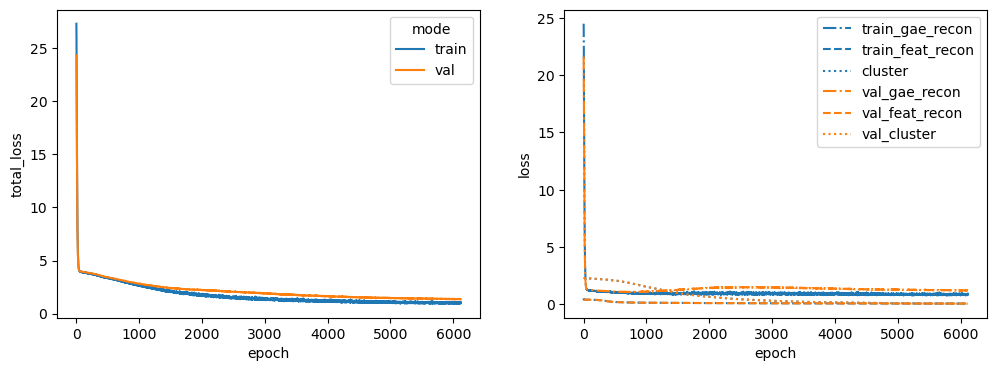

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 48%|████▊     | 4766/10000 [01:40<01:50, 47.53it/s]


Training stopped after 4767 epochs
Best model found at epoch 4665
------------------------------------------------------------
TEST AUC: 0.8199546485260771 AP: 0.831531035740654
TRAIN loss: 0.99235600233078
VAL loss: 1.3822886943817139
TEST loss: 1.4275317192077637
TEST AUC: 0.8199546485260771 	 AP: 0.831531035740654


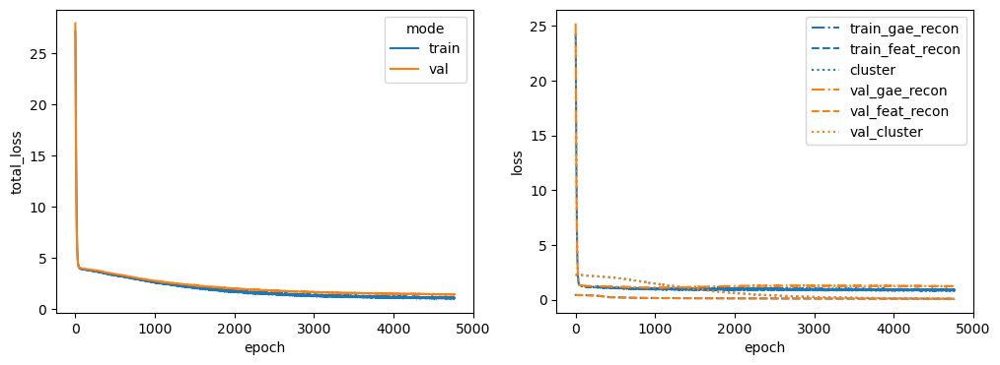

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 44%|████▎     | 4362/10000 [01:32<01:59, 47.31it/s]


Training stopped after 4363 epochs
Best model found at epoch 4261
------------------------------------------------------------
TEST AUC: 0.8168707482993197 AP: 0.8294456689163594
TRAIN loss: 1.0830057859420776
VAL loss: 1.3355021476745605
TEST loss: 1.4606554508209229
TEST AUC: 0.8168707482993197 	 AP: 0.8294456689163594


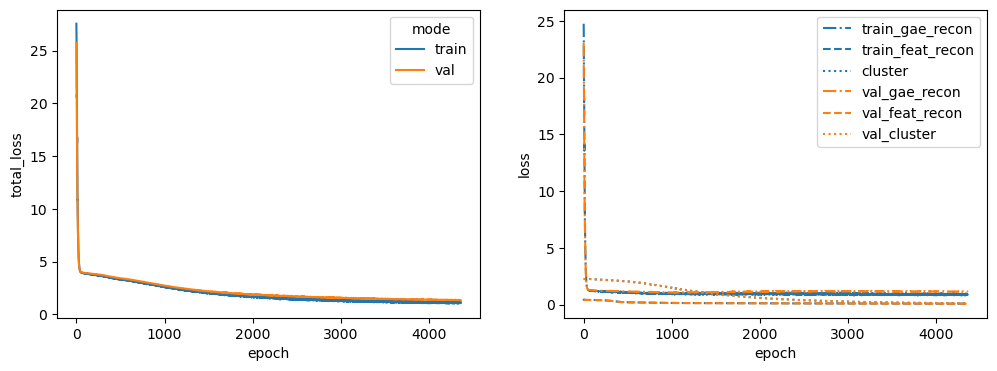

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 52%|█████▏    | 5166/10000 [01:48<01:41, 47.41it/s]


Training stopped after 5167 epochs
Best model found at epoch 5065
------------------------------------------------------------
TEST AUC: 0.7585487528344671 AP: 0.7707775358726381
TRAIN loss: 0.9897318482398987
VAL loss: 1.4288504123687744
TEST loss: 1.5474648475646973
TEST AUC: 0.7585487528344671 	 AP: 0.7707775358726381


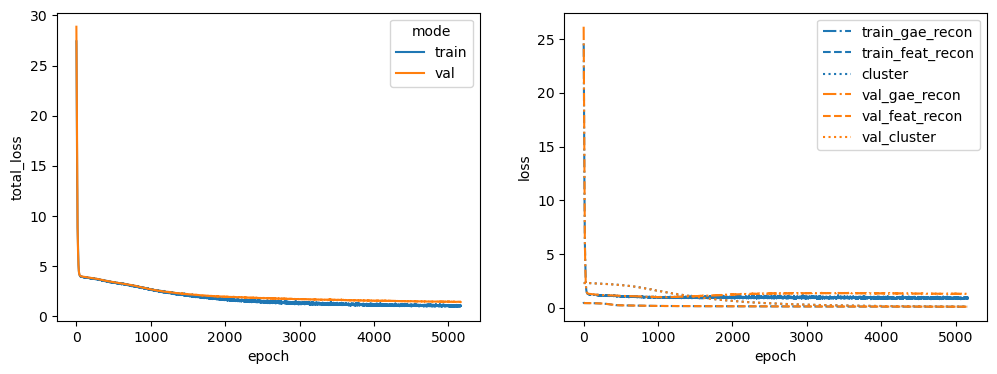

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 41%|████      | 4052/10000 [01:31<02:14, 44.22it/s]


Training stopped after 4053 epochs
Best model found at epoch 3951
------------------------------------------------------------
TEST AUC: 0.8384580498866214 AP: 0.8500563745452047
TRAIN loss: 1.1579583883285522
VAL loss: 1.4072201251983643
TEST loss: 1.3187280893325806
TEST AUC: 0.8384580498866214 	 AP: 0.8500563745452047


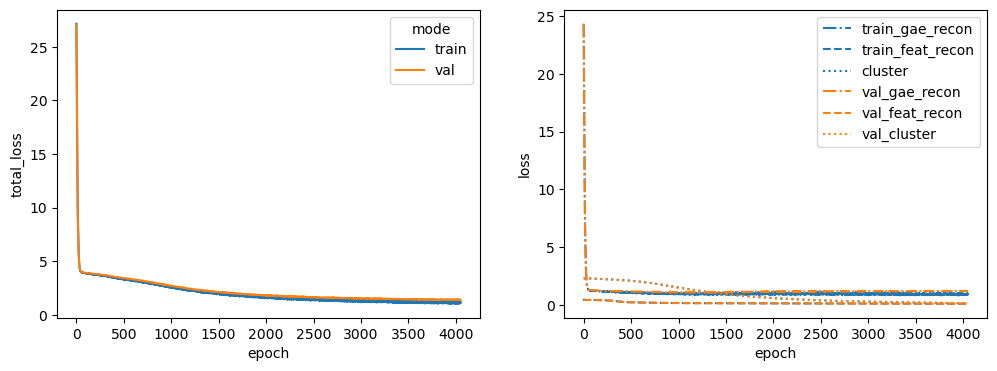

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 57%|█████▋    | 5677/10000 [02:00<01:31, 47.31it/s]


Training stopped after 5678 epochs
Best model found at epoch 5576
------------------------------------------------------------
TEST AUC: 0.8237641723356008 AP: 0.871193669826982
TRAIN loss: 1.0333404541015625
VAL loss: 1.1809803247451782
TEST loss: 1.2852158546447754
TEST AUC: 0.8237641723356008 	 AP: 0.871193669826982


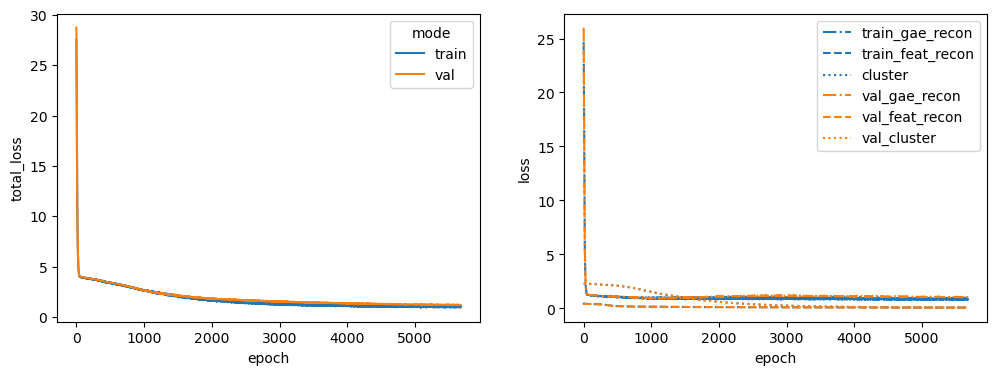

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 52%|█████▏    | 5246/10000 [01:51<01:40, 47.10it/s]


Training stopped after 5247 epochs
Best model found at epoch 5145
------------------------------------------------------------
TEST AUC: 0.789750566893424 AP: 0.7889305625211751
TRAIN loss: 1.0835886001586914
VAL loss: 1.5161961317062378
TEST loss: 1.435890555381775
TEST AUC: 0.789750566893424 	 AP: 0.7889305625211751


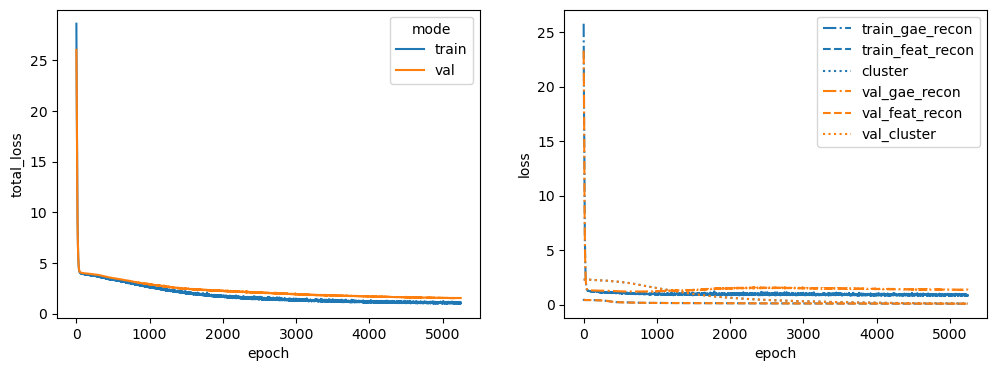

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 45%|████▌     | 4516/10000 [01:34<01:55, 47.56it/s]


Training stopped after 4517 epochs
Best model found at epoch 4415
------------------------------------------------------------
TEST AUC: 0.8139682539682539 AP: 0.8128573943356228
TRAIN loss: 1.1046016216278076
VAL loss: 1.2803305387496948
TEST loss: 1.4521344900131226
TEST AUC: 0.8139682539682539 	 AP: 0.8128573943356228


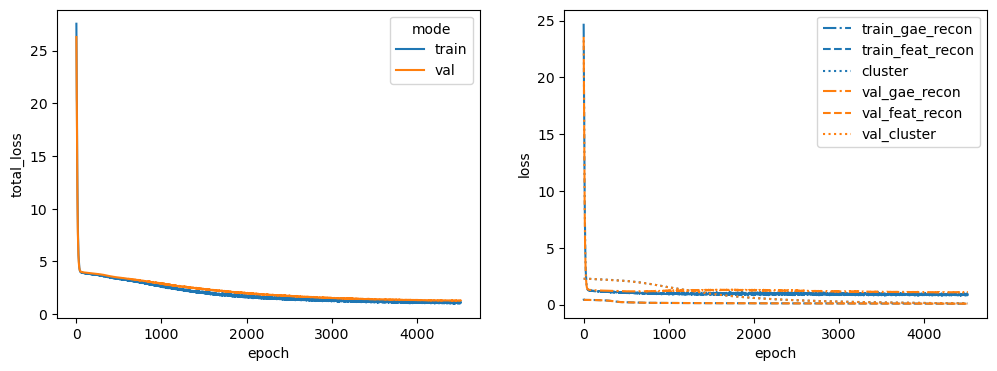

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 46%|████▌     | 4596/10000 [01:37<01:54, 47.27it/s]


Training stopped after 4597 epochs
Best model found at epoch 4495
------------------------------------------------------------
TEST AUC: 0.8213151927437642 AP: 0.8493497527012834
TRAIN loss: 1.1073718070983887
VAL loss: 1.3073636293411255
TEST loss: 1.4223638772964478
TEST AUC: 0.8213151927437642 	 AP: 0.8493497527012834


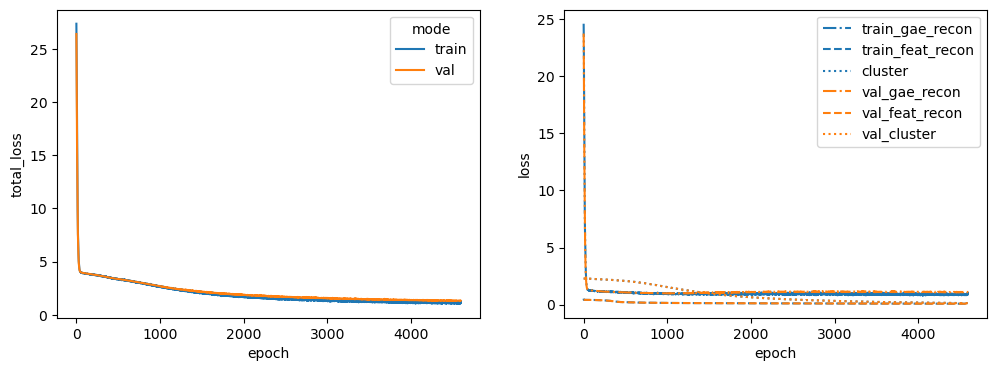

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 43%|████▎     | 4315/10000 [01:35<02:05, 45.33it/s]


Training stopped after 4316 epochs
Best model found at epoch 4214
------------------------------------------------------------
TEST AUC: 0.8134240362811791 AP: 0.8224122193509061
TRAIN loss: 1.1376657485961914
VAL loss: 1.328000545501709
TEST loss: 1.4349689483642578
TEST AUC: 0.8134240362811791 	 AP: 0.8224122193509061


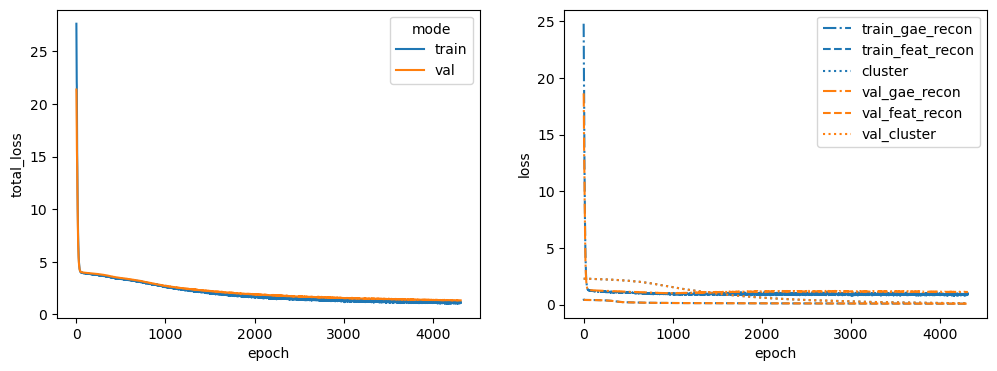

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 44%|████▍     | 4432/10000 [01:33<01:57, 47.32it/s]


Training stopped after 4433 epochs
Best model found at epoch 4331
------------------------------------------------------------
TEST AUC: 0.7780498866213151 AP: 0.769865650283537
TRAIN loss: 1.1282689571380615
VAL loss: 1.402583122253418
TEST loss: 1.5429562330245972
TEST AUC: 0.7780498866213151 	 AP: 0.769865650283537


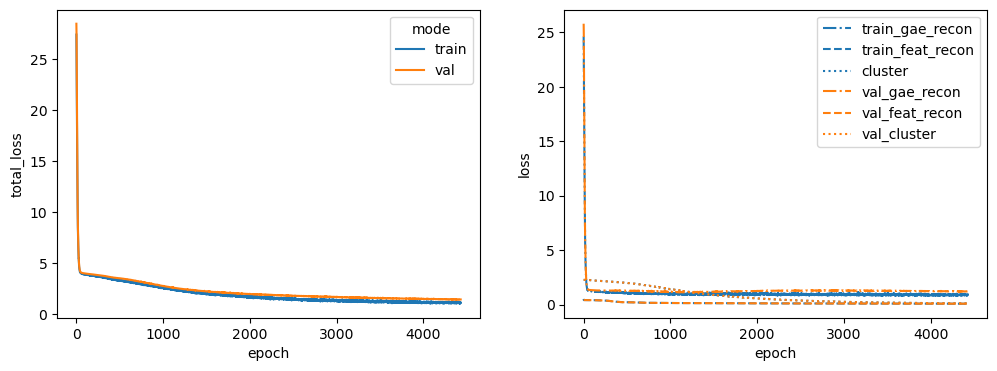

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 41%|████      | 4071/10000 [01:26<02:06, 46.96it/s]


Training stopped after 4072 epochs
Best model found at epoch 3970
------------------------------------------------------------
TEST AUC: 0.817687074829932 AP: 0.853639338478899
TRAIN loss: 1.141449213027954
VAL loss: 1.433296799659729
TEST loss: 1.4279569387435913
TEST AUC: 0.817687074829932 	 AP: 0.853639338478899


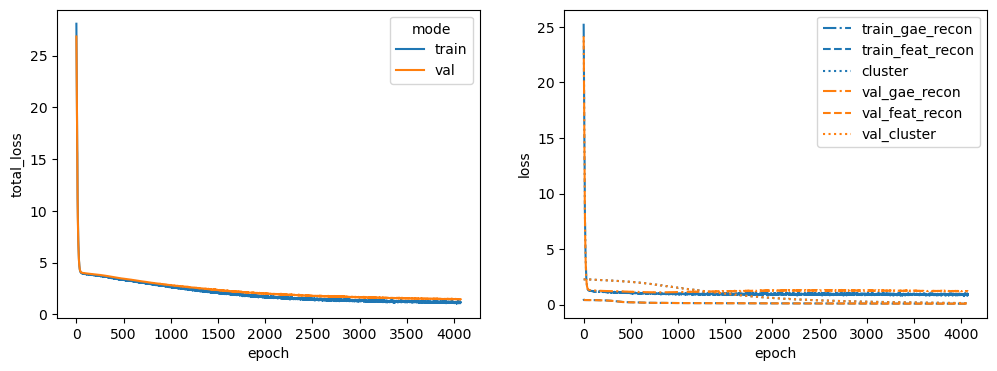

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 31%|███       | 3095/10000 [01:06<02:29, 46.31it/s]


Training stopped after 3096 epochs
Best model found at epoch 2994
------------------------------------------------------------
TEST AUC: 0.7569160997732426 AP: 0.7361551055734881
TRAIN loss: 1.414614200592041
VAL loss: 1.757529377937317
TEST loss: 1.795129418373108
TEST AUC: 0.7569160997732426 	 AP: 0.7361551055734881


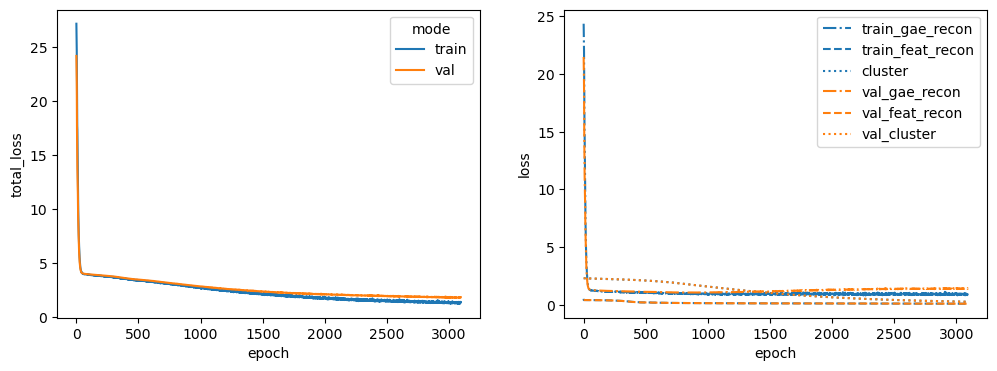

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 42%|████▏     | 4159/10000 [01:28<02:03, 47.19it/s]


Training stopped after 4160 epochs
Best model found at epoch 4058
------------------------------------------------------------
TEST AUC: 0.7794104308390022 AP: 0.7659562491924605
TRAIN loss: 1.150495171546936
VAL loss: 1.63076651096344
TEST loss: 1.6150305271148682
TEST AUC: 0.7794104308390022 	 AP: 0.7659562491924605


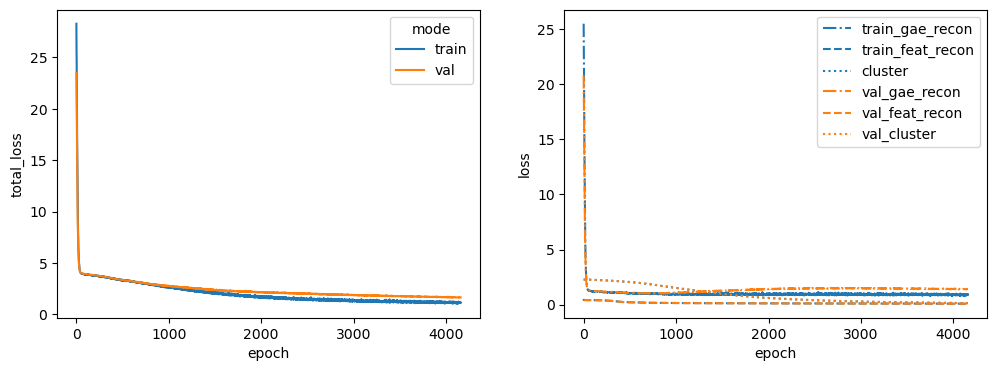

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 45%|████▍     | 4457/10000 [01:34<01:57, 47.19it/s]


Training stopped after 4458 epochs
Best model found at epoch 4356
------------------------------------------------------------
TEST AUC: 0.8008163265306122 AP: 0.8229084521659696
TRAIN loss: 1.111504316329956
VAL loss: 1.3318678140640259
TEST loss: 1.4613415002822876
TEST AUC: 0.8008163265306122 	 AP: 0.8229084521659696


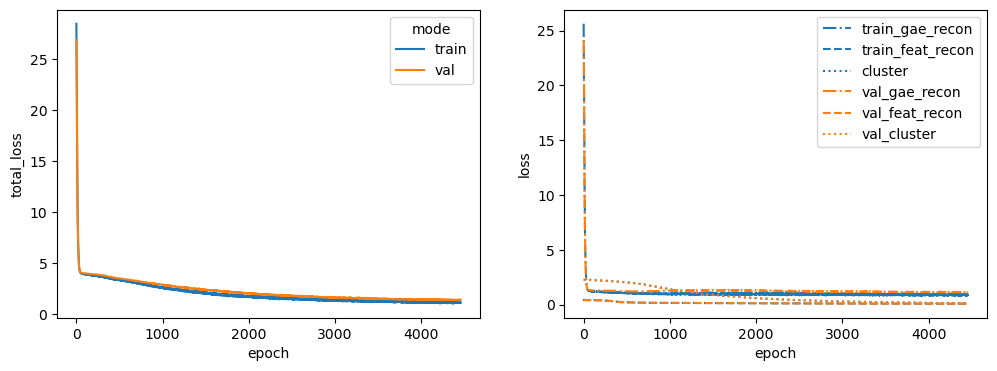

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 46%|████▋     | 4638/10000 [01:38<01:53, 47.27it/s]


Training stopped after 4639 epochs
Best model found at epoch 4537
------------------------------------------------------------
TEST AUC: 0.8271201814058957 AP: 0.8637280850013107
TRAIN loss: 1.0571492910385132
VAL loss: 1.3789610862731934
TEST loss: 1.382224202156067
TEST AUC: 0.8271201814058957 	 AP: 0.8637280850013107


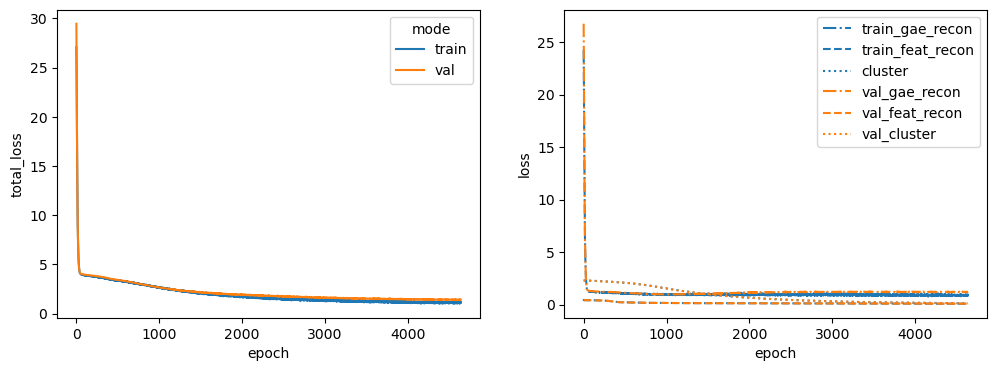

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 36%|███▋      | 3649/10000 [01:17<02:14, 47.08it/s]


Training stopped after 3650 epochs
Best model found at epoch 3548
------------------------------------------------------------
TEST AUC: 0.7938321995464852 AP: 0.7849089657396509
TRAIN loss: 1.2198704481124878
VAL loss: 1.6020832061767578
TEST loss: 1.8947643041610718
TEST AUC: 0.7938321995464852 	 AP: 0.7849089657396509


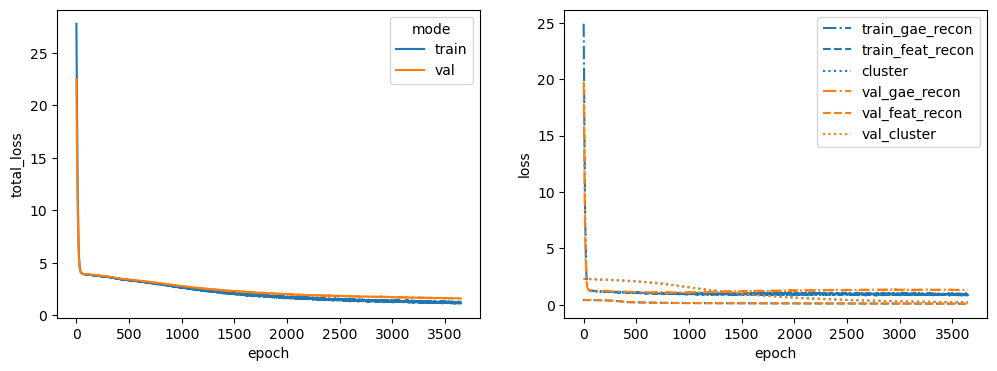

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 32%|███▏      | 3186/10000 [01:08<02:25, 46.83it/s]


Training stopped after 3187 epochs
Best model found at epoch 3085
------------------------------------------------------------
TEST AUC: 0.7556462585034014 AP: 0.7709994935150485
TRAIN loss: 1.3596404790878296
VAL loss: 1.615889549255371
TEST loss: 1.825218915939331
TEST AUC: 0.7556462585034014 	 AP: 0.7709994935150485


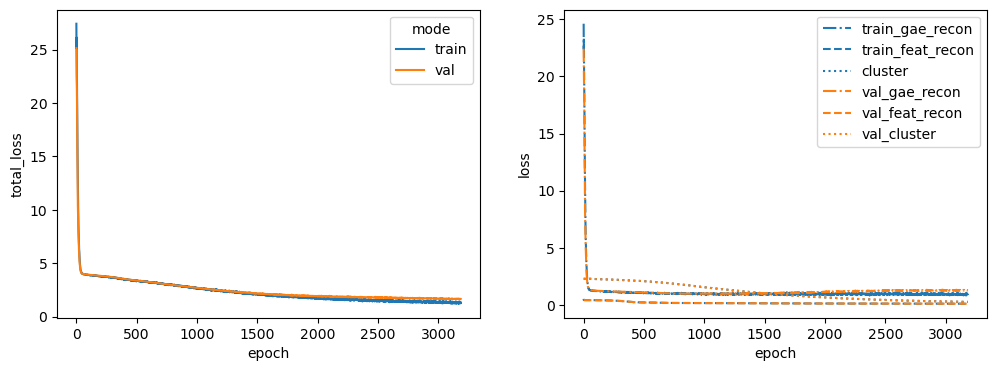

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 45%|████▌     | 4518/10000 [01:35<01:55, 47.49it/s]


Training stopped after 4519 epochs
Best model found at epoch 4417
------------------------------------------------------------
TEST AUC: 0.8229478458049886 AP: 0.8531366106569447
TRAIN loss: 1.0313993692398071
VAL loss: 1.4188530445098877
TEST loss: 1.360914945602417
TEST AUC: 0.8229478458049886 	 AP: 0.8531366106569447


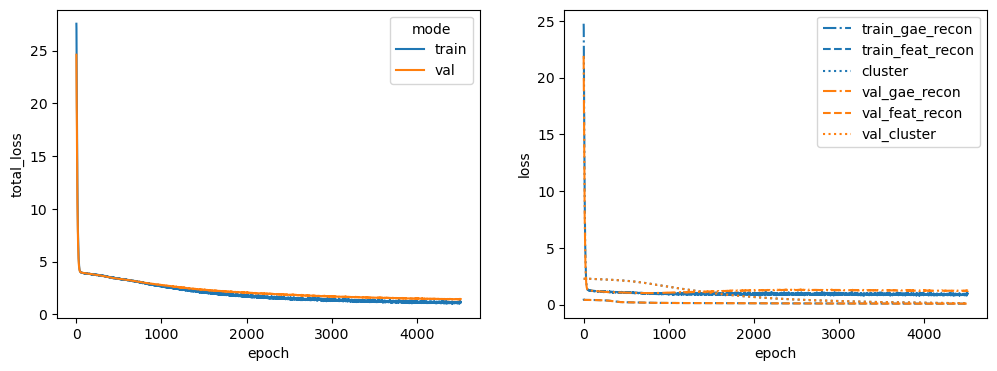

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 54%|█████▍    | 5443/10000 [01:54<01:36, 47.43it/s]


Training stopped after 5444 epochs
Best model found at epoch 5342
------------------------------------------------------------
TEST AUC: 0.8121541950113378 AP: 0.8250575930132973
TRAIN loss: 0.992036759853363
VAL loss: 1.537651538848877
TEST loss: 1.3613860607147217
TEST AUC: 0.8121541950113378 	 AP: 0.8250575930132973


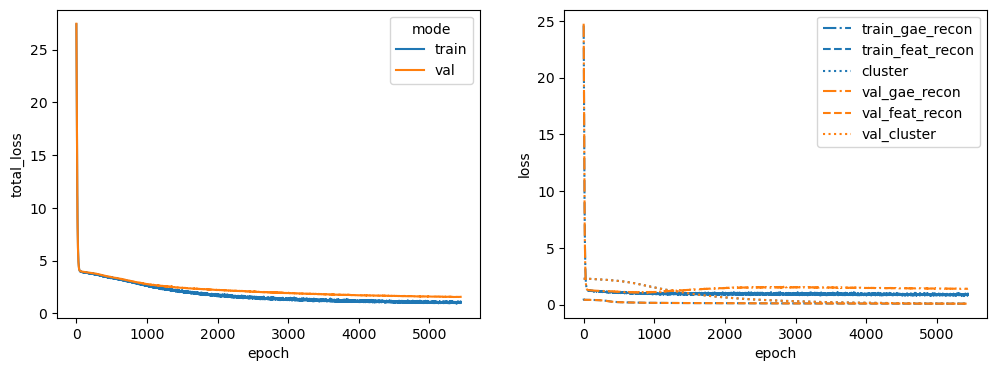

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 45%|████▍     | 4478/10000 [01:32<01:54, 48.25it/s]


Training stopped after 4479 epochs
Best model found at epoch 4377
------------------------------------------------------------
TEST AUC: 0.8366439909297052 AP: 0.8267553022084954
TRAIN loss: 1.050038456916809
VAL loss: 1.54920494556427
TEST loss: 1.3824684619903564
TEST AUC: 0.8366439909297052 	 AP: 0.8267553022084954


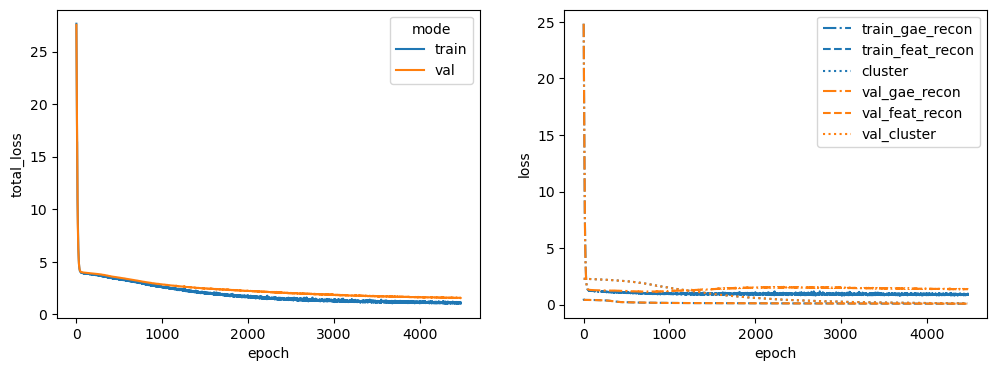

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 39%|███▉      | 3888/10000 [01:22<02:09, 47.06it/s]


Training stopped after 3889 epochs
Best model found at epoch 3787
------------------------------------------------------------
TEST AUC: 0.7756916099773242 AP: 0.7704639495516628
TRAIN loss: 1.216599464416504
VAL loss: 1.4253097772598267
TEST loss: 1.6216880083084106
TEST AUC: 0.7756916099773242 	 AP: 0.7704639495516628


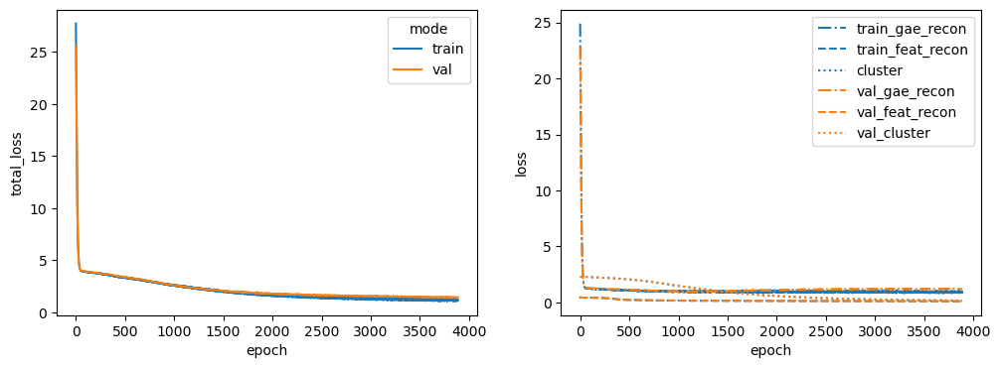

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 36%|███▋      | 3646/10000 [01:17<02:15, 46.84it/s]


Training stopped after 3647 epochs
Best model found at epoch 3545
------------------------------------------------------------
TEST AUC: 0.7954648526077097 AP: 0.7967761383812842
TRAIN loss: 1.1531752347946167
VAL loss: 1.3703458309173584
TEST loss: 1.6057484149932861
TEST AUC: 0.7954648526077097 	 AP: 0.7967761383812842


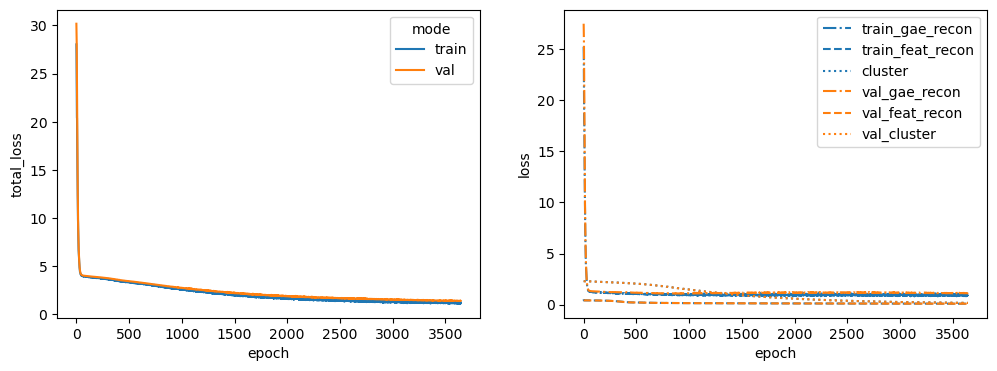

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 55%|█████▌    | 5509/10000 [01:56<01:34, 47.32it/s]


Training stopped after 5510 epochs
Best model found at epoch 5408
------------------------------------------------------------
TEST AUC: 0.781859410430839 AP: 0.7989735421635011
TRAIN loss: 1.03548264503479
VAL loss: 1.4516974687576294
TEST loss: 1.4851183891296387
TEST AUC: 0.781859410430839 	 AP: 0.7989735421635011


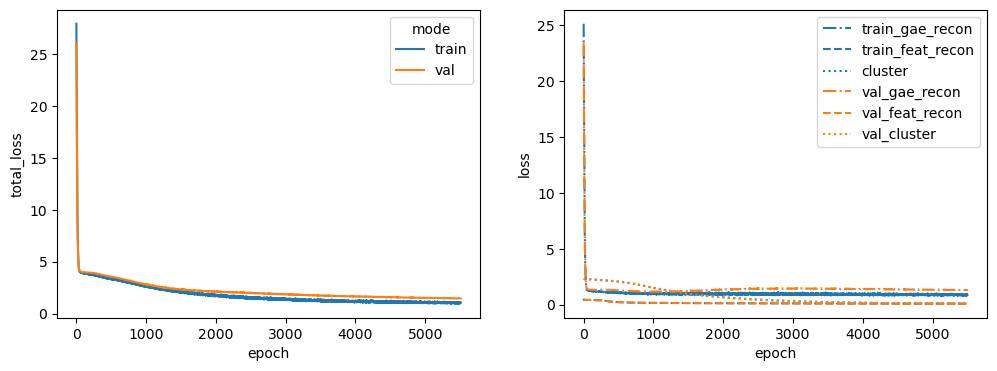

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 32%|███▏      | 3155/10000 [01:06<02:24, 47.42it/s]


Training stopped after 3156 epochs
Best model found at epoch 3054
------------------------------------------------------------
TEST AUC: 0.7838548752834467 AP: 0.7665186813582578
TRAIN loss: 1.267547607421875
VAL loss: 1.7554177045822144
TEST loss: 1.7910269498825073
TEST AUC: 0.7838548752834467 	 AP: 0.7665186813582578


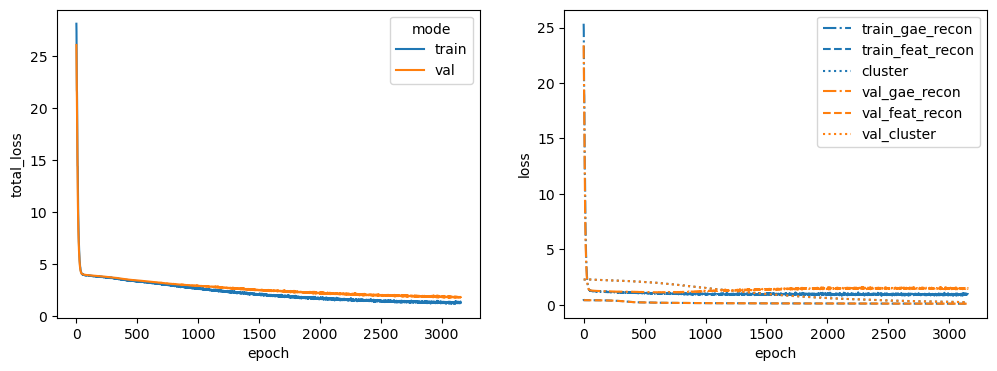

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 41%|████      | 4122/10000 [01:27<02:04, 47.08it/s]


Training stopped after 4123 epochs
Best model found at epoch 4021
------------------------------------------------------------
TEST AUC: 0.7921088435374151 AP: 0.8229565037312343
TRAIN loss: 1.1914396286010742
VAL loss: 1.32810378074646
TEST loss: 1.5109119415283203
TEST AUC: 0.7921088435374151 	 AP: 0.8229565037312343


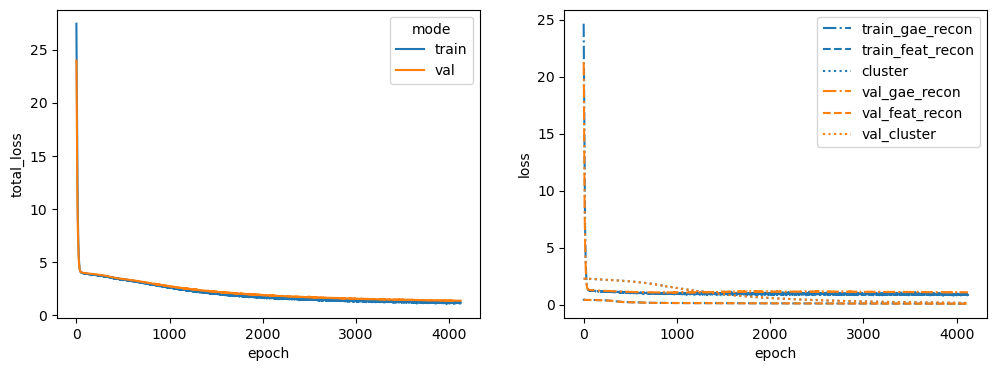

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 22%|██▏       | 2229/10000 [00:47<02:46, 46.61it/s]


Training stopped after 2230 epochs
Best model found at epoch 2128
------------------------------------------------------------
TEST AUC: 0.801360544217687 AP: 0.7955439369733464
TRAIN loss: 1.5957393646240234
VAL loss: 1.9001903533935547
TEST loss: 2.0144667625427246
TEST AUC: 0.801360544217687 	 AP: 0.7955439369733464


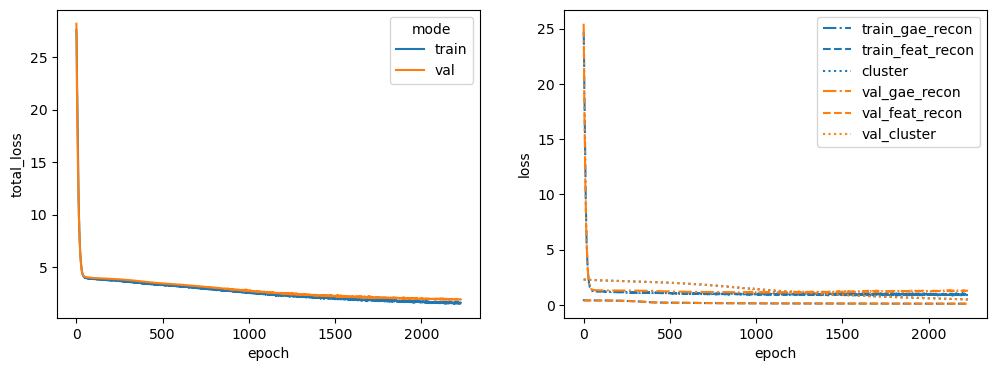

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 50%|█████     | 5045/10000 [01:47<01:45, 47.03it/s]


Training stopped after 5046 epochs
Best model found at epoch 4944
------------------------------------------------------------
TEST AUC: 0.809795918367347 AP: 0.8382105432036544
TRAIN loss: 1.0519880056381226
VAL loss: 1.3403289318084717
TEST loss: 1.3781516551971436
TEST AUC: 0.809795918367347 	 AP: 0.8382105432036544


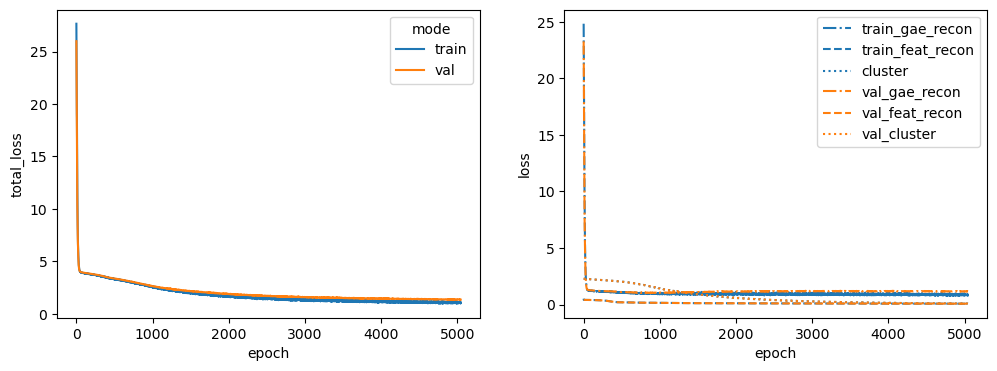

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 55%|█████▌    | 5538/10000 [01:58<01:35, 46.66it/s]


Training stopped after 5539 epochs
Best model found at epoch 5437
------------------------------------------------------------
TEST AUC: 0.7991836734693878 AP: 0.7994569993653384
TRAIN loss: 1.0048668384552002
VAL loss: 1.4851967096328735
TEST loss: 1.4454677104949951
TEST AUC: 0.7991836734693878 	 AP: 0.7994569993653384


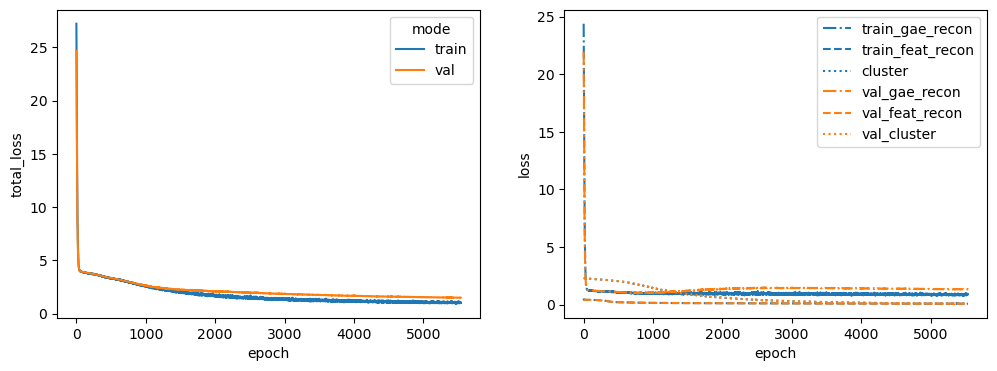

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 38%|███▊      | 3836/10000 [01:22<02:12, 46.62it/s]


Training stopped after 3837 epochs
Best model found at epoch 3735
------------------------------------------------------------
TEST AUC: 0.8000907029478458 AP: 0.7859195751313504
TRAIN loss: 1.2095409631729126
VAL loss: 1.5023815631866455
TEST loss: 1.598923921585083
TEST AUC: 0.8000907029478458 	 AP: 0.7859195751313504


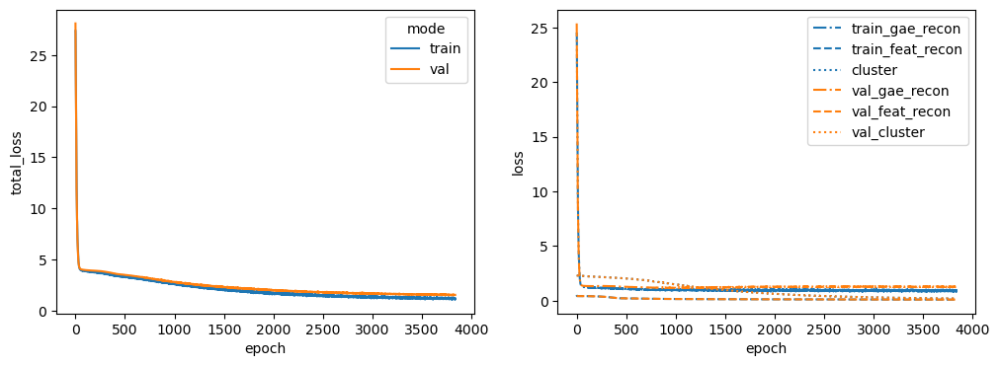

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 35%|███▌      | 3529/10000 [01:14<02:16, 47.28it/s]


Training stopped after 3530 epochs
Best model found at epoch 3428
------------------------------------------------------------
TEST AUC: 0.8406349206349206 AP: 0.8581542088404533
TRAIN loss: 1.2879749536514282
VAL loss: 1.6866151094436646
TEST loss: 1.4551136493682861
TEST AUC: 0.8406349206349206 	 AP: 0.8581542088404533


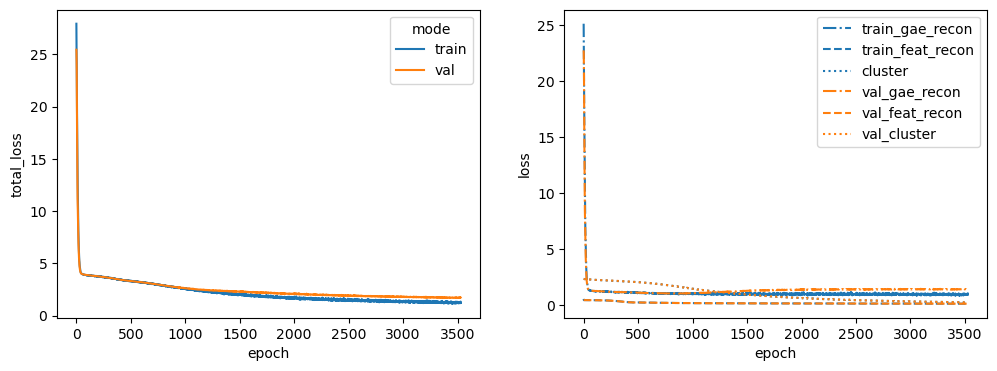

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 48%|████▊     | 4848/10000 [01:42<01:49, 47.20it/s]


Training stopped after 4849 epochs
Best model found at epoch 4747
------------------------------------------------------------
TEST AUC: 0.8448979591836734 AP: 0.8488490620112329
TRAIN loss: 1.1267443895339966
VAL loss: 1.325224757194519
TEST loss: 1.35560142993927
TEST AUC: 0.8448979591836734 	 AP: 0.8488490620112329


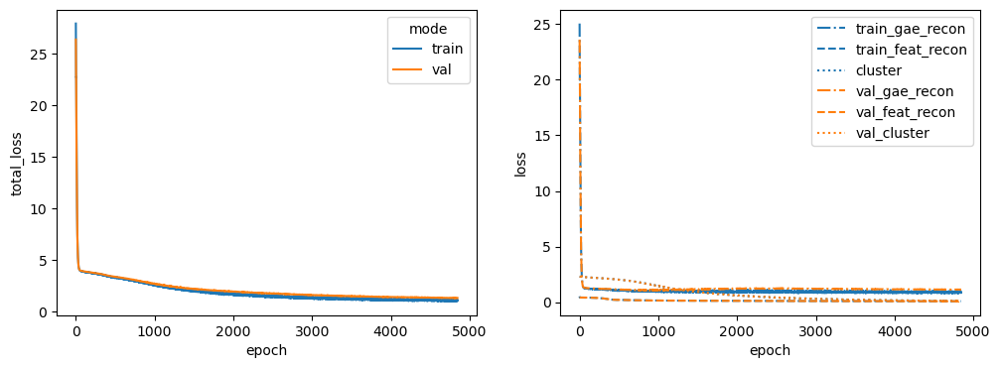

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 49%|████▉     | 4897/10000 [01:43<01:48, 47.24it/s]


Training stopped after 4898 epochs
Best model found at epoch 4796
------------------------------------------------------------
TEST AUC: 0.8443537414965986 AP: 0.8727269776969133
TRAIN loss: 1.0811121463775635
VAL loss: 1.509925365447998
TEST loss: 1.312646746635437
TEST AUC: 0.8443537414965986 	 AP: 0.8727269776969133


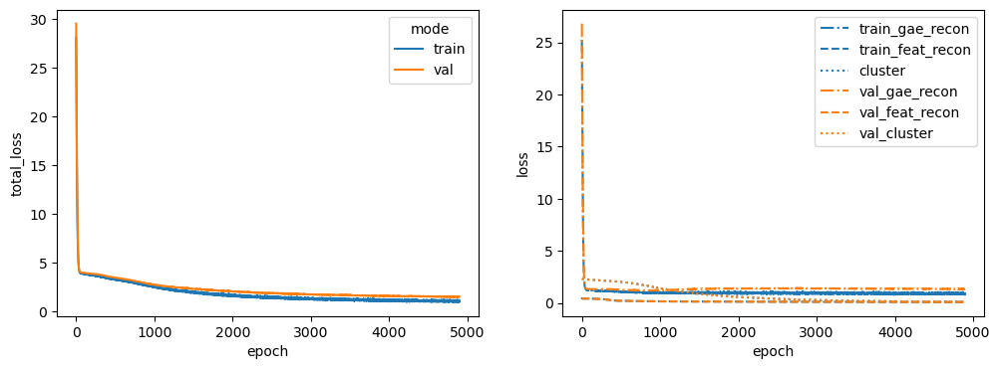

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 42%|████▏     | 4182/10000 [01:28<02:03, 47.26it/s]


Training stopped after 4183 epochs
Best model found at epoch 4081
------------------------------------------------------------
TEST AUC: 0.8263038548752834 AP: 0.8380839892051204
TRAIN loss: 1.1494706869125366
VAL loss: 1.6792782545089722
TEST loss: 1.4496612548828125
TEST AUC: 0.8263038548752834 	 AP: 0.8380839892051204


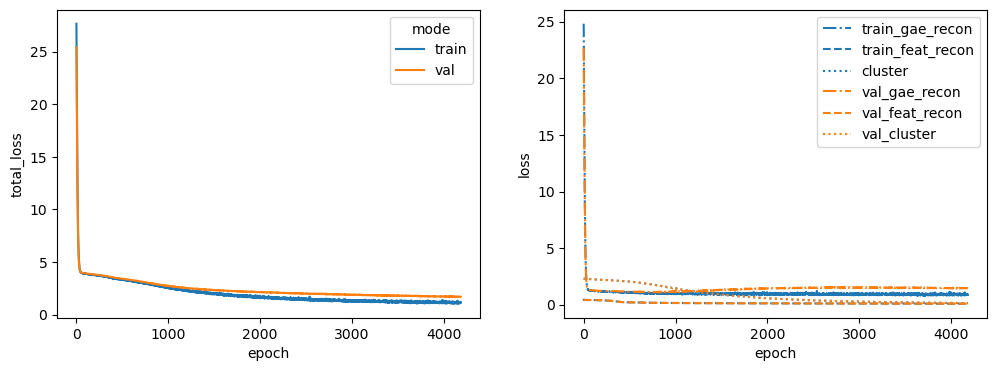

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 46%|████▌     | 4557/10000 [01:37<01:56, 46.83it/s]


Training stopped after 4558 epochs
Best model found at epoch 4456
------------------------------------------------------------
TEST AUC: 0.8079818594104309 AP: 0.8169075644717005
TRAIN loss: 1.2461001873016357
VAL loss: 1.4183648824691772
TEST loss: 1.4576798677444458
TEST AUC: 0.8079818594104309 	 AP: 0.8169075644717005


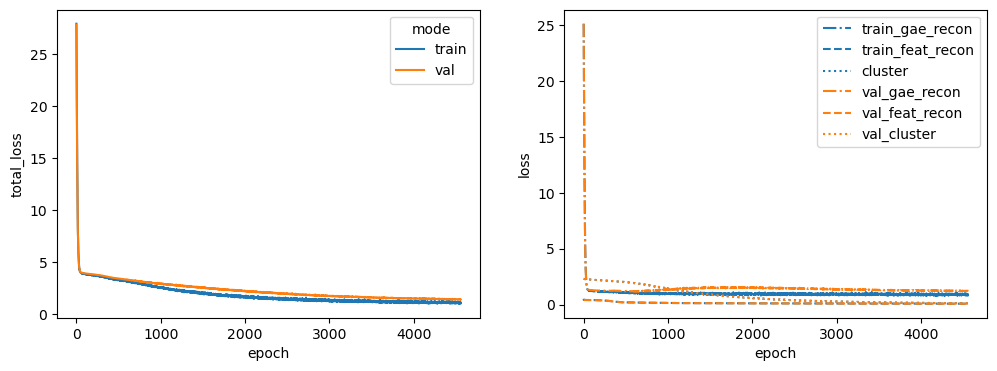

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 31%|███       | 3124/10000 [01:07<02:28, 46.44it/s]


Training stopped after 3125 epochs
Best model found at epoch 3023
------------------------------------------------------------
TEST AUC: 0.8049886621315193 AP: 0.8002391958449875
TRAIN loss: 1.3280470371246338
VAL loss: 2.048539161682129
TEST loss: 1.7159390449523926
TEST AUC: 0.8049886621315193 	 AP: 0.8002391958449875


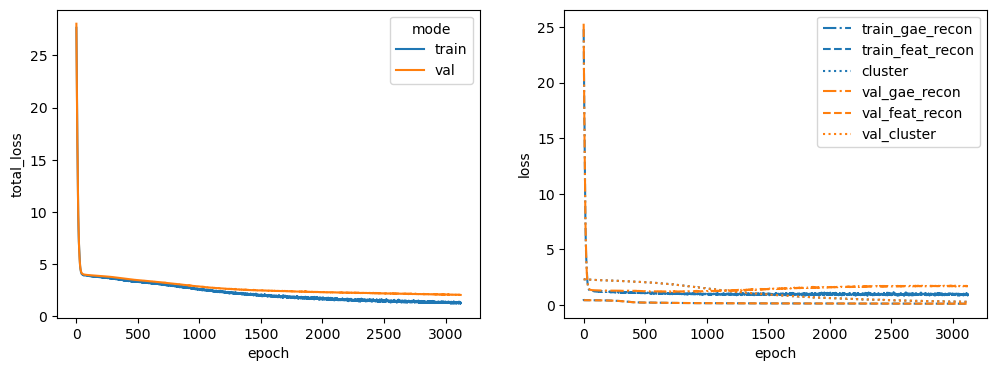

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 51%|█████     | 5094/10000 [01:47<01:43, 47.21it/s]


Training stopped after 5095 epochs
Best model found at epoch 4993
------------------------------------------------------------
TEST AUC: 0.8271201814058957 AP: 0.8252033523824657
TRAIN loss: 1.028388261795044
VAL loss: 1.3051191568374634
TEST loss: 1.3895552158355713
TEST AUC: 0.8271201814058957 	 AP: 0.8252033523824657


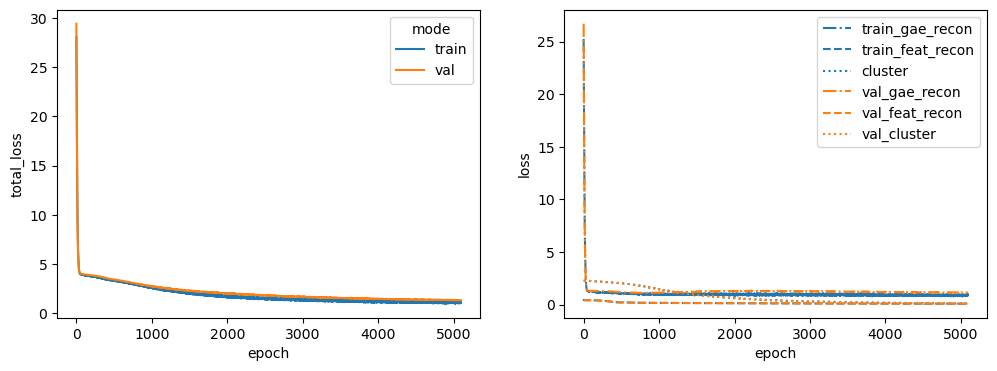

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 36%|███▌      | 3612/10000 [01:17<02:16, 46.72it/s]


Training stopped after 3613 epochs
Best model found at epoch 3511
------------------------------------------------------------
TEST AUC: 0.8333786848072562 AP: 0.8466827120410395
TRAIN loss: 1.2568849325180054
VAL loss: 1.3962186574935913
TEST loss: 1.4786334037780762
TEST AUC: 0.8333786848072562 	 AP: 0.8466827120410395


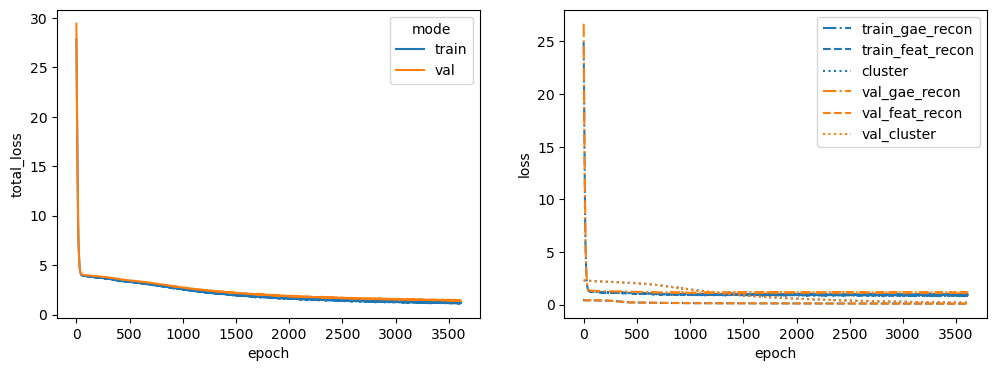

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 36%|███▋      | 3628/10000 [01:17<02:15, 46.96it/s]


Training stopped after 3629 epochs
Best model found at epoch 3527
------------------------------------------------------------
TEST AUC: 0.8014512471655328 AP: 0.8022819788734346
TRAIN loss: 1.1877580881118774
VAL loss: 1.58962881565094
TEST loss: 1.5954957008361816
TEST AUC: 0.8014512471655328 	 AP: 0.8022819788734346


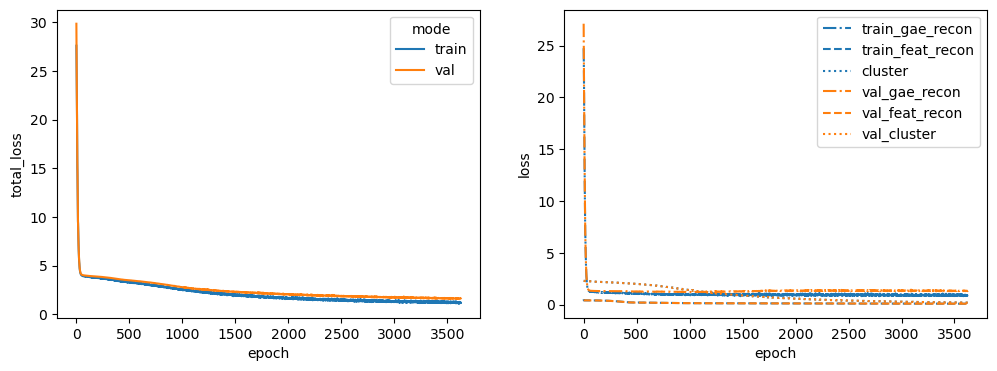

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 35%|███▍      | 3457/10000 [01:14<02:20, 46.61it/s]


Training stopped after 3458 epochs
Best model found at epoch 3356
------------------------------------------------------------
TEST AUC: 0.829297052154195 AP: 0.8440941326565832
TRAIN loss: 1.2610148191452026
VAL loss: 1.8698930740356445
TEST loss: 1.5263373851776123
TEST AUC: 0.829297052154195 	 AP: 0.8440941326565832


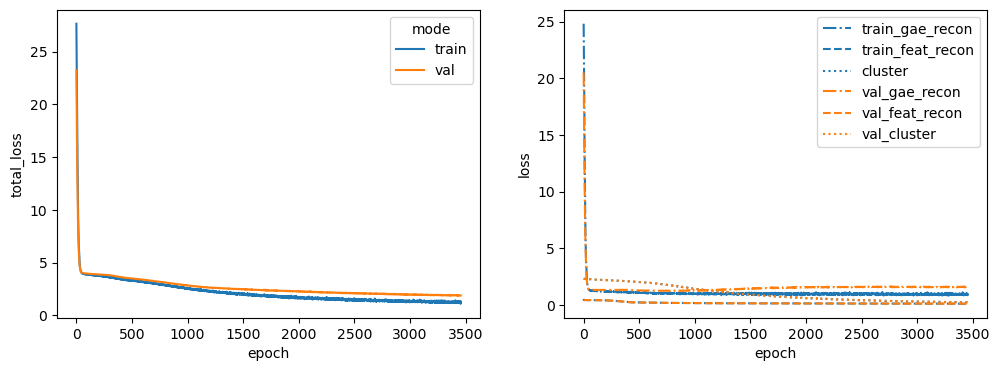

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 59%|█████▊    | 5873/10000 [02:04<01:27, 47.22it/s]


Training stopped after 5874 epochs
Best model found at epoch 5772
------------------------------------------------------------
TEST AUC: 0.8154195011337868 AP: 0.8496931031940524
TRAIN loss: 1.0123704671859741
VAL loss: 1.35378897190094
TEST loss: 1.337181806564331
TEST AUC: 0.8154195011337868 	 AP: 0.8496931031940524


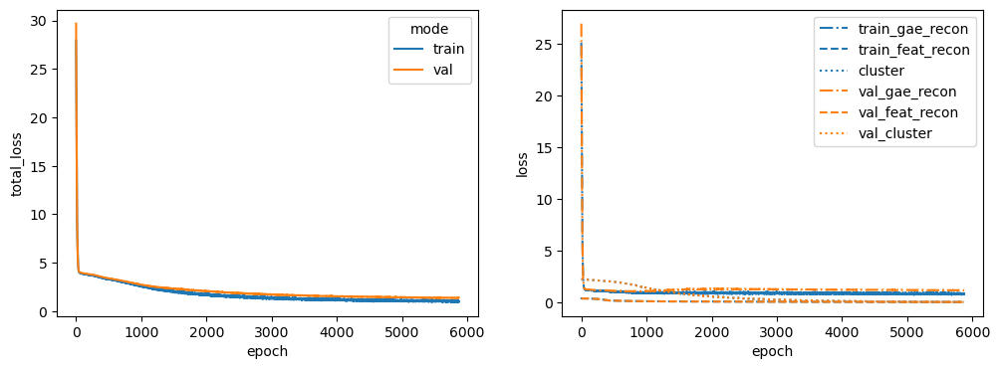

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 47%|████▋     | 4664/10000 [01:41<01:55, 46.04it/s]


Training stopped after 4665 epochs
Best model found at epoch 4563
------------------------------------------------------------
TEST AUC: 0.812063492063492 AP: 0.8103597763739012
TRAIN loss: 1.0614982843399048
VAL loss: 1.4181911945343018
TEST loss: 1.5048868656158447
TEST AUC: 0.812063492063492 	 AP: 0.8103597763739012


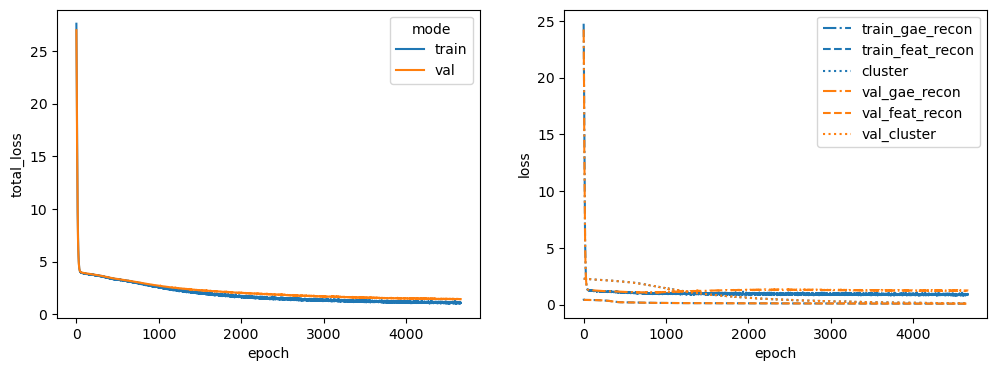

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 35%|███▌      | 3534/10000 [01:16<02:19, 46.48it/s]


Training stopped after 3535 epochs
Best model found at epoch 3433
------------------------------------------------------------
TEST AUC: 0.8416326530612245 AP: 0.8599363295444766
TRAIN loss: 1.2333658933639526
VAL loss: 1.4055466651916504
TEST loss: 1.4711958169937134
TEST AUC: 0.8416326530612245 	 AP: 0.8599363295444766


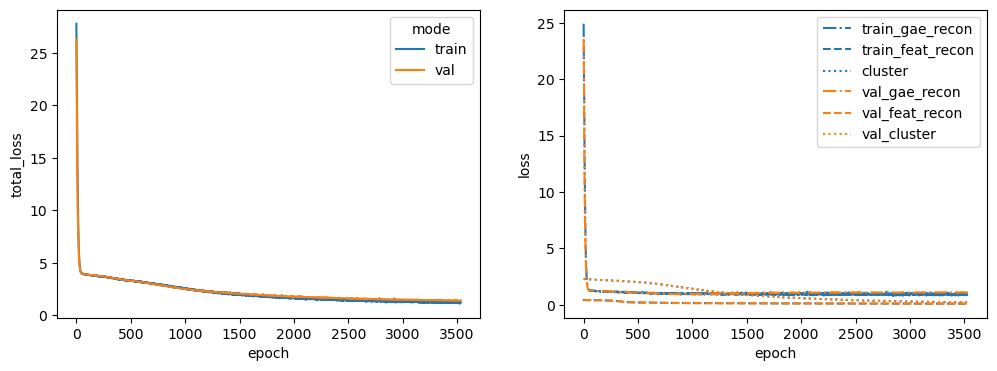

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 45%|████▌     | 4505/10000 [01:35<01:56, 46.99it/s]


Training stopped after 4506 epochs
Best model found at epoch 4404
------------------------------------------------------------
TEST AUC: 0.8053514739229025 AP: 0.8093184920635577
TRAIN loss: 1.1137601137161255
VAL loss: 1.3707301616668701
TEST loss: 1.7803678512573242
TEST AUC: 0.8053514739229025 	 AP: 0.8093184920635577


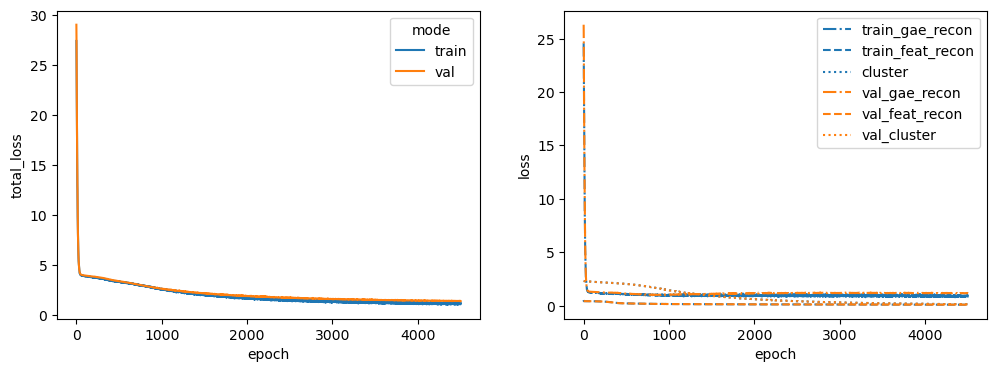

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 34%|███▍      | 3430/10000 [01:13<02:20, 46.62it/s]


Training stopped after 3431 epochs
Best model found at epoch 3329
------------------------------------------------------------
TEST AUC: 0.799546485260771 AP: 0.8330950969633456
TRAIN loss: 1.2133653163909912
VAL loss: 1.4042010307312012
TEST loss: 1.5983279943466187
TEST AUC: 0.799546485260771 	 AP: 0.8330950969633456


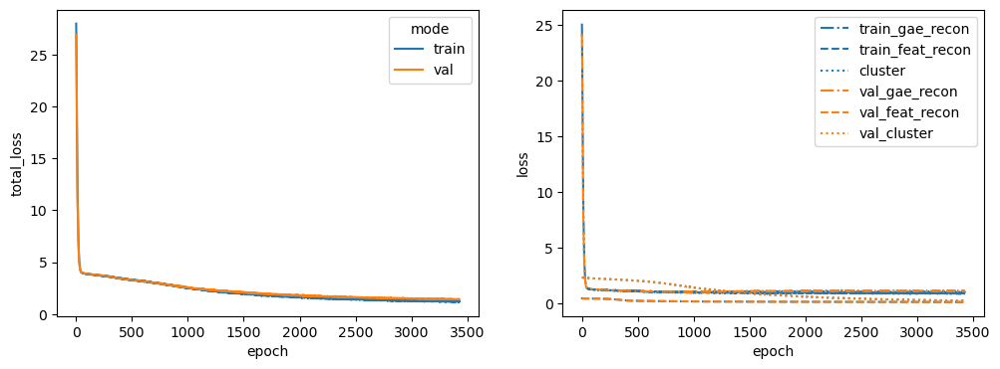

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 60%|█████▉    | 5994/10000 [02:07<01:25, 46.87it/s]


Training stopped after 5995 epochs
Best model found at epoch 5893
------------------------------------------------------------
TEST AUC: 0.7924716553287983 AP: 0.7897464285067625
TRAIN loss: 1.0372282266616821
VAL loss: 1.4130277633666992
TEST loss: 1.4829264879226685
TEST AUC: 0.7924716553287983 	 AP: 0.7897464285067625


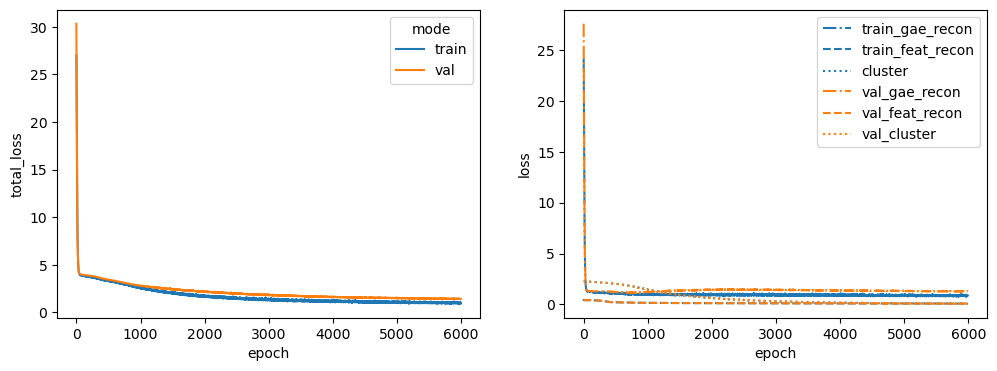

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 43%|████▎     | 4340/10000 [01:33<02:02, 46.32it/s]


Training stopped after 4341 epochs
Best model found at epoch 4239
------------------------------------------------------------
TEST AUC: 0.8071655328798186 AP: 0.82882051886756
TRAIN loss: 1.1014071702957153
VAL loss: 1.3742845058441162
TEST loss: 1.4748547077178955
TEST AUC: 0.8071655328798186 	 AP: 0.82882051886756


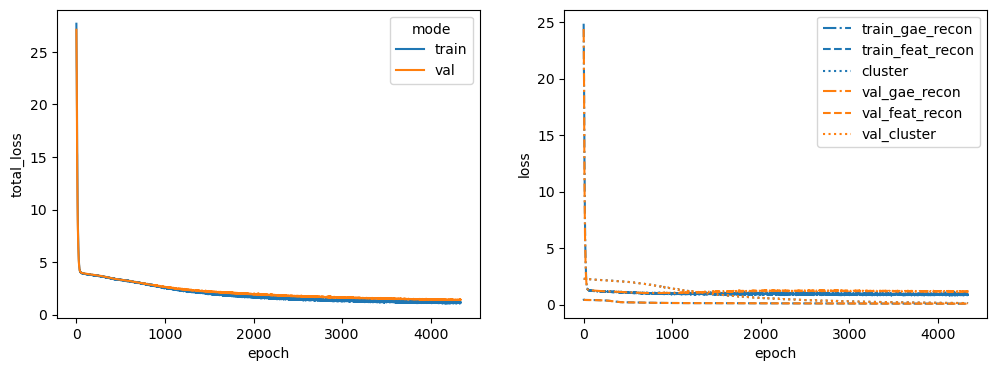

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 49%|████▉     | 4917/10000 [01:45<01:49, 46.52it/s]


Training stopped after 4918 epochs
Best model found at epoch 4816
------------------------------------------------------------
TEST AUC: 0.7984580498866214 AP: 0.7945590041857288
TRAIN loss: 1.084723949432373
VAL loss: 1.4459559917449951
TEST loss: 1.4736618995666504
TEST AUC: 0.7984580498866214 	 AP: 0.7945590041857288


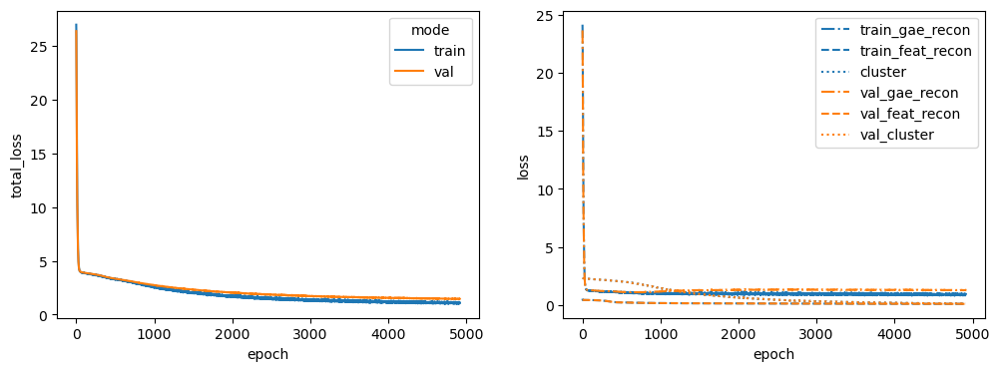

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 48%|████▊     | 4826/10000 [01:43<01:51, 46.43it/s]


Training stopped after 4827 epochs
Best model found at epoch 4725
------------------------------------------------------------
TEST AUC: 0.8034467120181406 AP: 0.8223296645270701
TRAIN loss: 1.1334844827651978
VAL loss: 1.3259172439575195
TEST loss: 1.4631446599960327
TEST AUC: 0.8034467120181406 	 AP: 0.8223296645270701


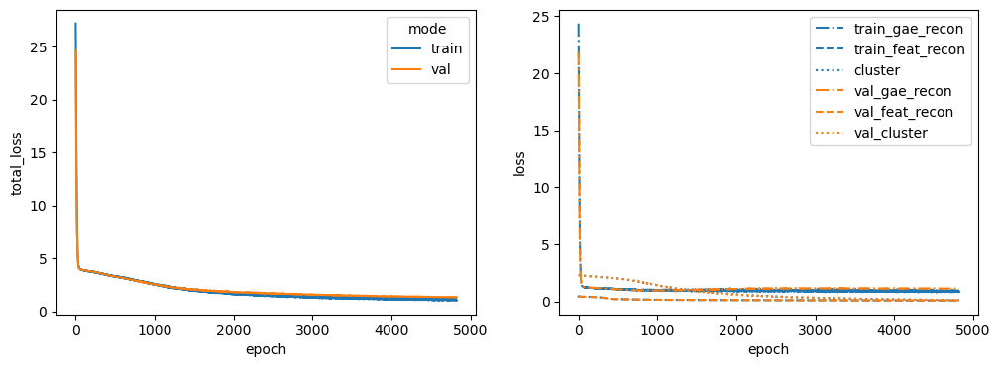

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 54%|█████▍    | 5417/10000 [01:56<01:38, 46.41it/s]


Training stopped after 5418 epochs
Best model found at epoch 5316
------------------------------------------------------------
TEST AUC: 0.7963718820861677 AP: 0.8019557448983375
TRAIN loss: 1.16337251663208
VAL loss: 1.2222694158554077
TEST loss: 1.4607161283493042
TEST AUC: 0.7963718820861677 	 AP: 0.8019557448983375


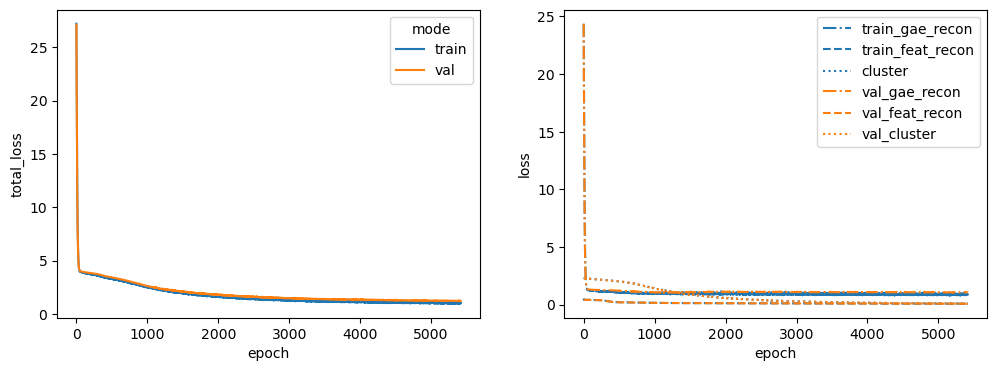

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 41%|████      | 4114/10000 [01:30<02:09, 45.58it/s]


Training stopped after 4115 epochs
Best model found at epoch 4013
------------------------------------------------------------
TEST AUC: 0.8007256235827664 AP: 0.7679665908328047
TRAIN loss: 1.1232463121414185
VAL loss: 1.9043523073196411
TEST loss: 1.624578595161438
TEST AUC: 0.8007256235827664 	 AP: 0.7679665908328047


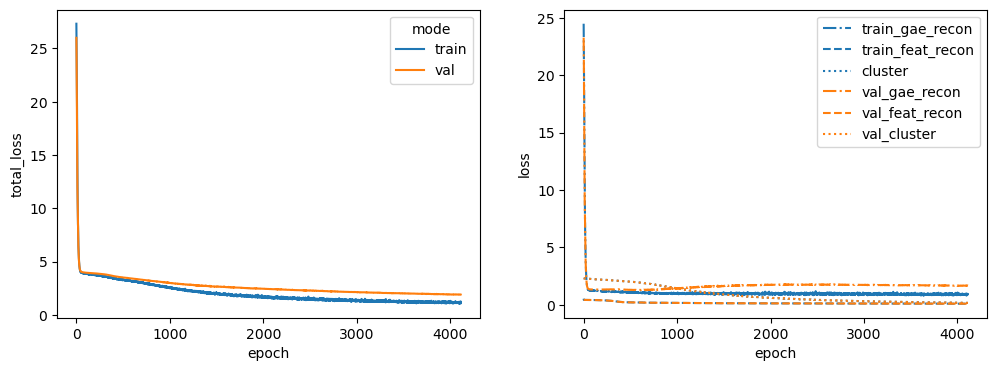

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 42%|████▏     | 4220/10000 [01:30<02:04, 46.43it/s]


Training stopped after 4221 epochs
Best model found at epoch 4119
------------------------------------------------------------
TEST AUC: 0.8262131519274377 AP: 0.8258991050830445
TRAIN loss: 1.1851776838302612
VAL loss: 1.423708438873291
TEST loss: 1.4773848056793213
TEST AUC: 0.8262131519274377 	 AP: 0.8258991050830445


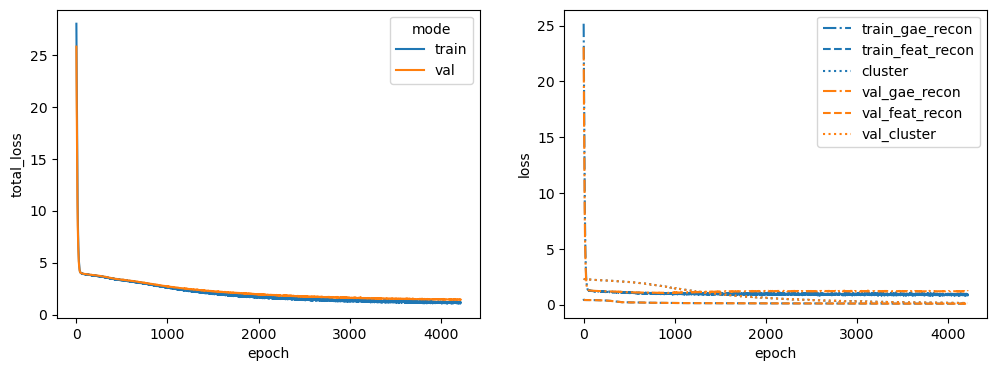

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 35%|███▌      | 3519/10000 [01:16<02:20, 46.27it/s]


Training stopped after 3520 epochs
Best model found at epoch 3418
------------------------------------------------------------
TEST AUC: 0.7912925170068027 AP: 0.7959071190258037
TRAIN loss: 1.2473210096359253
VAL loss: 1.382469892501831
TEST loss: 1.6523783206939697
TEST AUC: 0.7912925170068027 	 AP: 0.7959071190258037


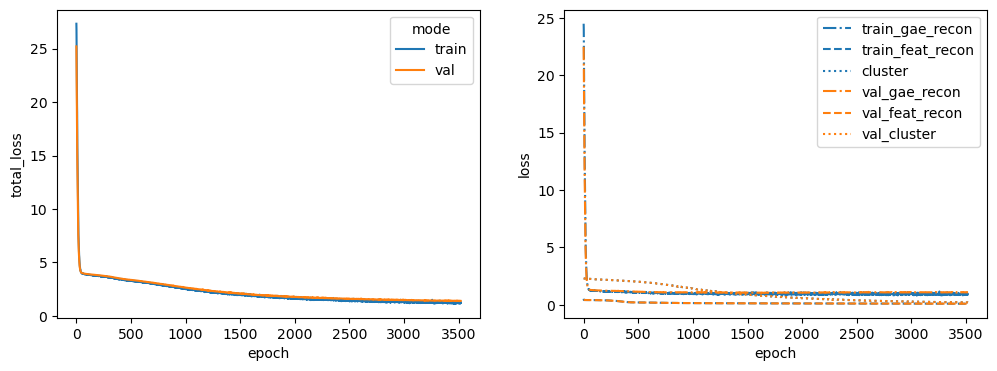

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 34%|███▍      | 3407/10000 [01:12<02:21, 46.71it/s]


Training stopped after 3408 epochs
Best model found at epoch 3306
------------------------------------------------------------
TEST AUC: 0.8184126984126985 AP: 0.8223599824509635
TRAIN loss: 1.3135833740234375
VAL loss: 1.8627148866653442
TEST loss: 1.6049214601516724
TEST AUC: 0.8184126984126985 	 AP: 0.8223599824509635


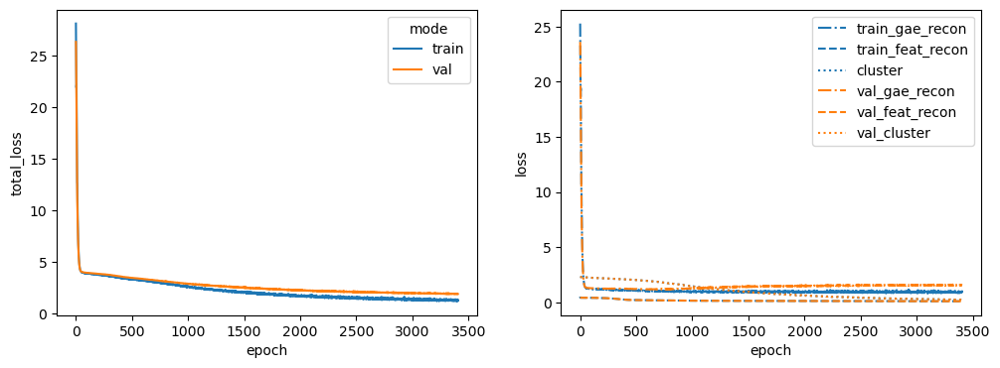

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 44%|████▎     | 4369/10000 [01:32<01:59, 47.07it/s]


Training stopped after 4370 epochs
Best model found at epoch 4268
------------------------------------------------------------
TEST AUC: 0.8336507936507936 AP: 0.8226567817128423
TRAIN loss: 1.1193712949752808
VAL loss: 1.3873099088668823
TEST loss: 1.4401026964187622
TEST AUC: 0.8336507936507936 	 AP: 0.8226567817128423


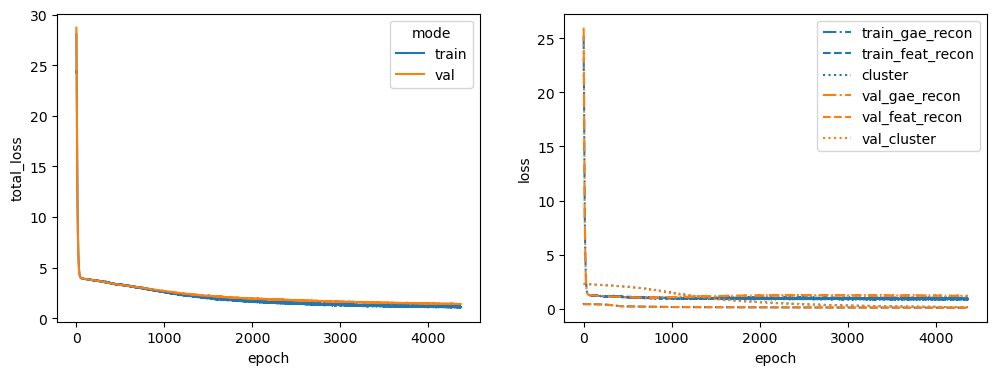

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 25%|██▍       | 2467/10000 [00:54<02:46, 45.17it/s]


Training stopped after 2468 epochs
Best model found at epoch 2366
------------------------------------------------------------
TEST AUC: 0.8275736961451247 AP: 0.8198700438505959
TRAIN loss: 1.5045160055160522
VAL loss: 1.8947807550430298
TEST loss: 1.781753420829773
TEST AUC: 0.8275736961451247 	 AP: 0.8198700438505959


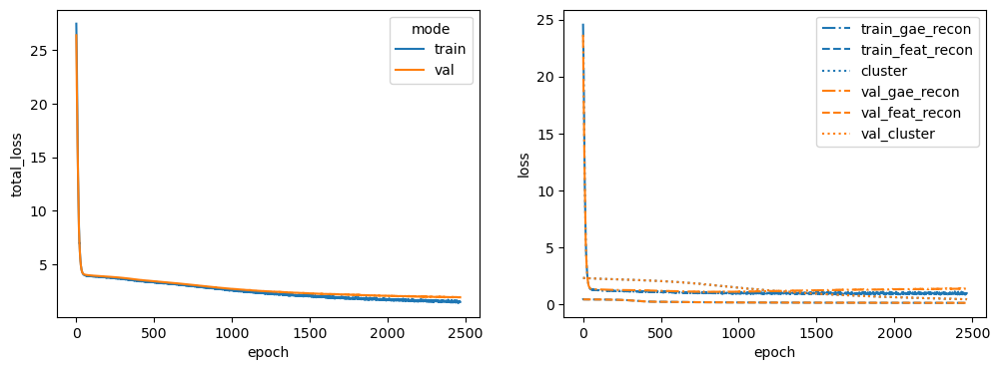

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 37%|███▋      | 3669/10000 [01:19<02:16, 46.34it/s]


Training stopped after 3670 epochs
Best model found at epoch 3568
------------------------------------------------------------
TEST AUC: 0.8161451247165533 AP: 0.8294867099854376
TRAIN loss: 1.1664836406707764
VAL loss: 1.5007480382919312
TEST loss: 1.535578966140747
TEST AUC: 0.8161451247165533 	 AP: 0.8294867099854376


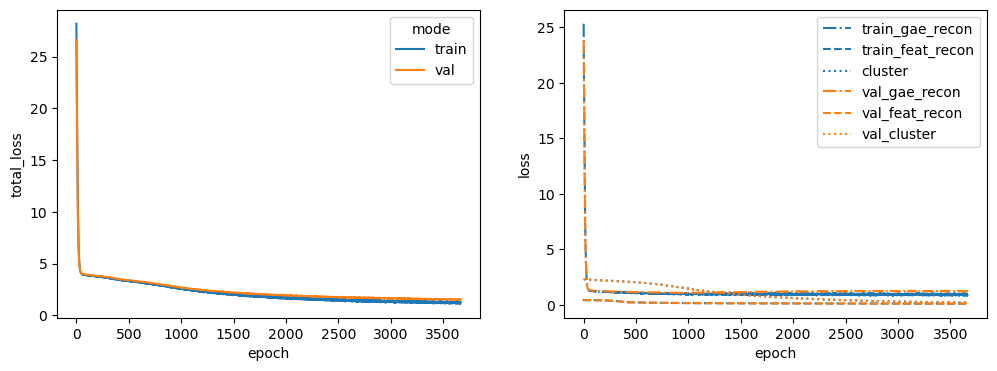

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 43%|████▎     | 4294/10000 [01:31<02:02, 46.71it/s]


Training stopped after 4295 epochs
Best model found at epoch 4193
------------------------------------------------------------
TEST AUC: 0.7997278911564625 AP: 0.8046026696254449
TRAIN loss: 1.1498379707336426
VAL loss: 1.5925569534301758
TEST loss: 1.5426218509674072
TEST AUC: 0.7997278911564625 	 AP: 0.8046026696254449


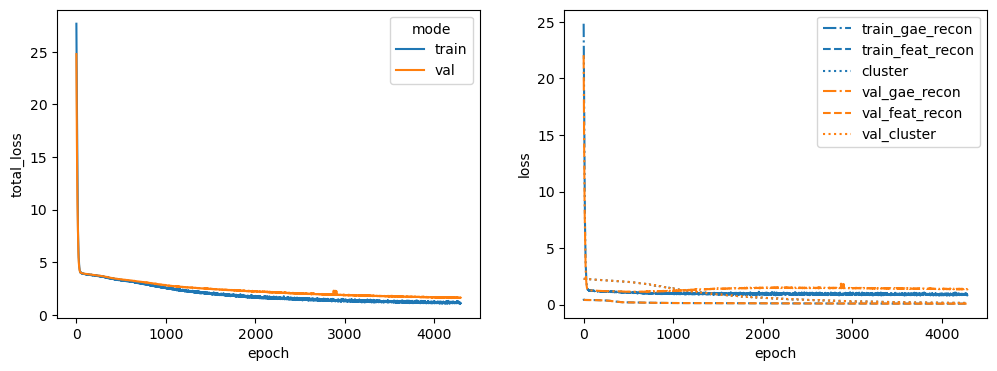

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 47%|████▋     | 4698/10000 [01:39<01:52, 46.99it/s]


Training stopped after 4699 epochs
Best model found at epoch 4597
------------------------------------------------------------
TEST AUC: 0.8134240362811792 AP: 0.8091521144407279
TRAIN loss: 1.0710525512695312
VAL loss: 1.4078972339630127
TEST loss: 1.4930444955825806
TEST AUC: 0.8134240362811792 	 AP: 0.8091521144407279


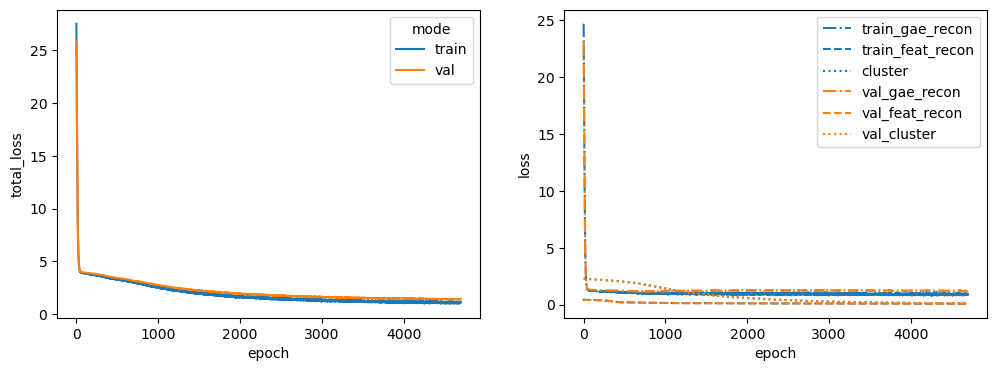

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 41%|████      | 4057/10000 [01:27<02:08, 46.42it/s]


Training stopped after 4058 epochs
Best model found at epoch 3956
------------------------------------------------------------
TEST AUC: 0.8114285714285714 AP: 0.7937646416575503
TRAIN loss: 1.3137471675872803
VAL loss: 1.4471673965454102
TEST loss: 1.5358070135116577
TEST AUC: 0.8114285714285714 	 AP: 0.7937646416575503


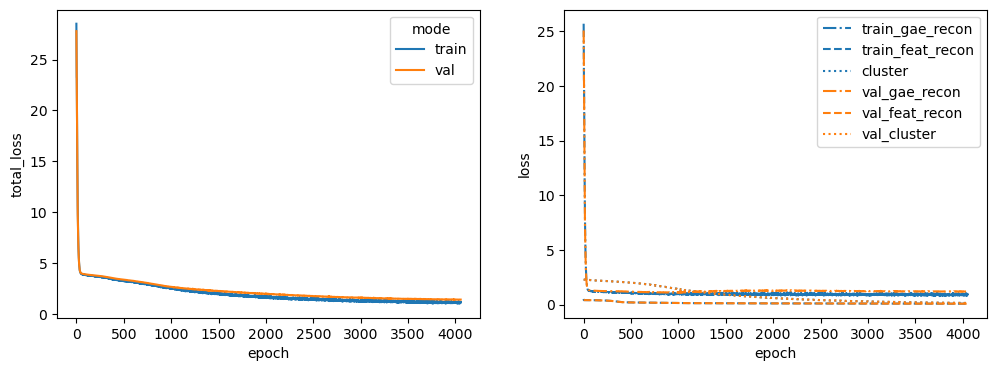

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 40%|███▉      | 3951/10000 [01:24<02:08, 46.89it/s]


Training stopped after 3952 epochs
Best model found at epoch 3850
------------------------------------------------------------
TEST AUC: 0.8312925170068027 AP: 0.8418128975407546
TRAIN loss: 1.2378946542739868
VAL loss: 1.3909651041030884
TEST loss: 1.46284818649292
TEST AUC: 0.8312925170068027 	 AP: 0.8418128975407546


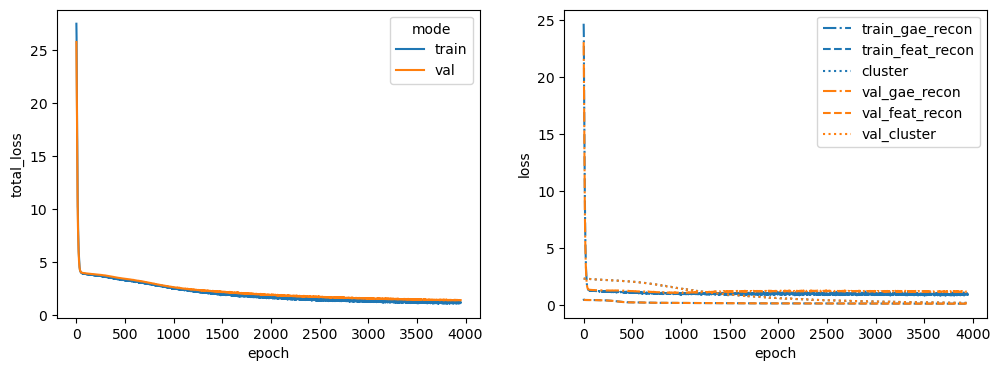

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 46%|████▌     | 4579/10000 [01:41<01:59, 45.28it/s]


Training stopped after 4580 epochs
Best model found at epoch 4478
------------------------------------------------------------
TEST AUC: 0.831111111111111 AP: 0.8453053664591266
TRAIN loss: 1.0914185047149658
VAL loss: 1.4942562580108643
TEST loss: 1.4075844287872314
TEST AUC: 0.831111111111111 	 AP: 0.8453053664591266


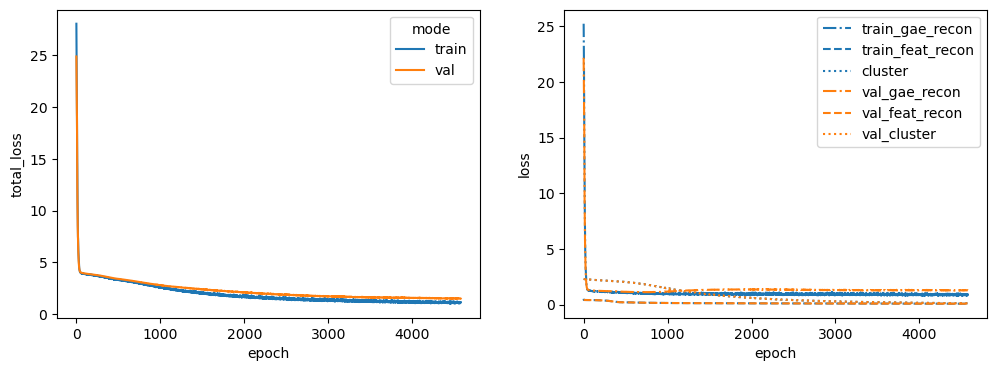

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 36%|███▌      | 3586/10000 [01:22<02:27, 43.36it/s]


Training stopped after 3587 epochs
Best model found at epoch 3485
------------------------------------------------------------
TEST AUC: 0.8346485260770975 AP: 0.8383788532948977
TRAIN loss: 1.270795464515686
VAL loss: 1.566373348236084
TEST loss: 1.4825812578201294
TEST AUC: 0.8346485260770975 	 AP: 0.8383788532948977


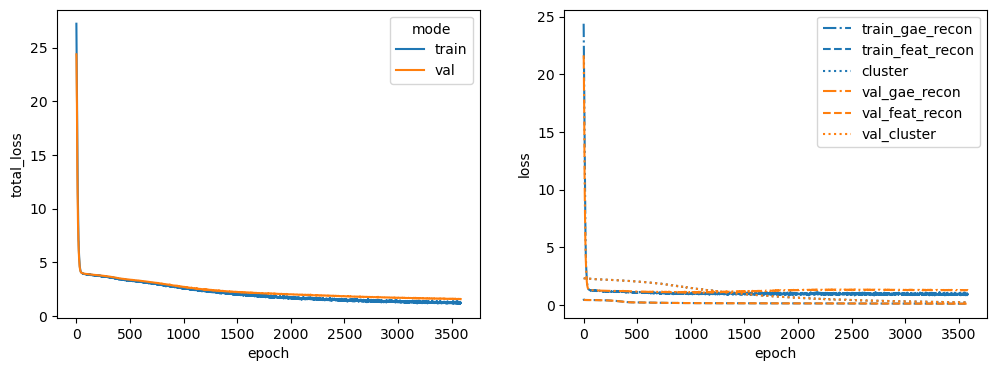

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 40%|███▉      | 3974/10000 [01:32<02:19, 43.13it/s]


Training stopped after 3975 epochs
Best model found at epoch 3873
------------------------------------------------------------
TEST AUC: 0.7974603174603174 AP: 0.8206041475155599
TRAIN loss: 1.1816569566726685
VAL loss: 1.3162034749984741
TEST loss: 1.554370641708374
TEST AUC: 0.7974603174603174 	 AP: 0.8206041475155599


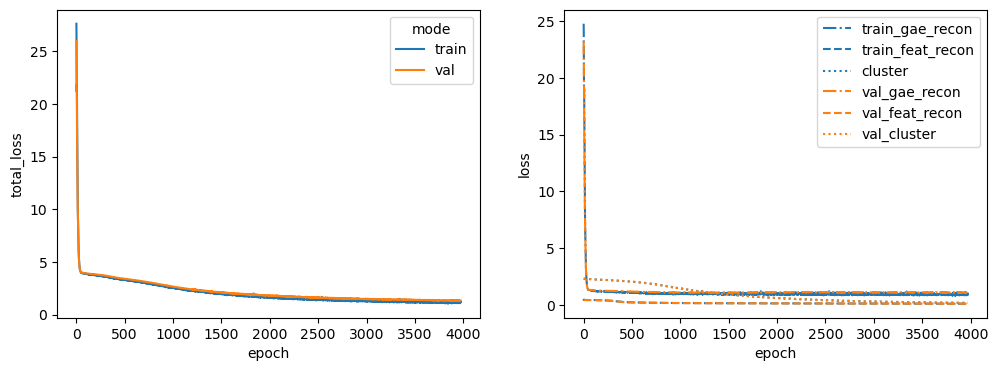

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 26%|██▌       | 2607/10000 [00:59<02:50, 43.47it/s]


Training stopped after 2608 epochs
Best model found at epoch 2506
------------------------------------------------------------
TEST AUC: 0.7909297052154195 AP: 0.7584811098096307
TRAIN loss: 1.4838049411773682
VAL loss: 1.8311384916305542
TEST loss: 1.9582035541534424
TEST AUC: 0.7909297052154195 	 AP: 0.7584811098096307


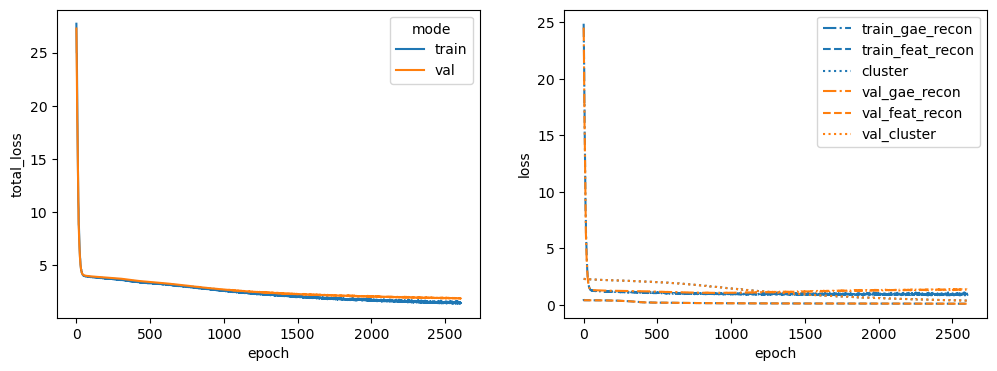

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 29%|██▊       | 2873/10000 [01:07<02:46, 42.70it/s]


Training stopped after 2874 epochs
Best model found at epoch 2772
------------------------------------------------------------
TEST AUC: 0.785578231292517 AP: 0.7754338771305581
TRAIN loss: 1.4177610874176025
VAL loss: 1.491789698600769
TEST loss: 1.8357892036437988
TEST AUC: 0.785578231292517 	 AP: 0.7754338771305581


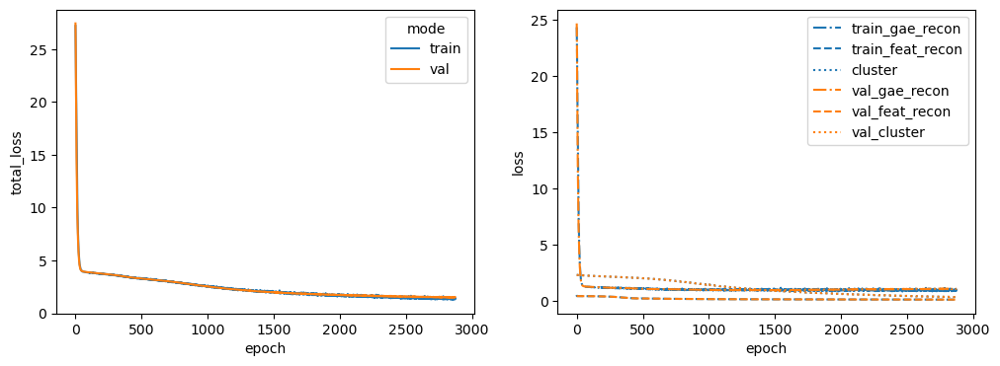

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 46%|████▋     | 4645/10000 [01:47<02:03, 43.37it/s]


Training stopped after 4646 epochs
Best model found at epoch 4544
------------------------------------------------------------
TEST AUC: 0.8068934240362812 AP: 0.8142536249503576
TRAIN loss: 1.1082364320755005
VAL loss: 1.4788438081741333
TEST loss: 1.469576120376587
TEST AUC: 0.8068934240362812 	 AP: 0.8142536249503576


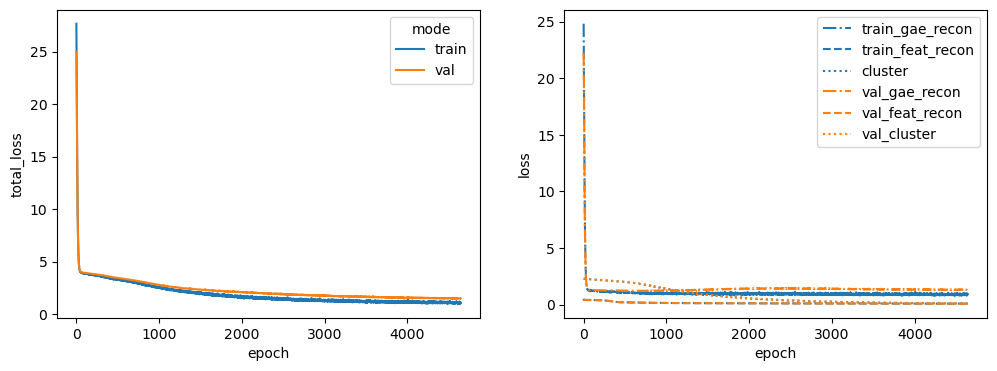

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 37%|███▋      | 3714/10000 [01:27<02:27, 42.57it/s]


Training stopped after 3715 epochs
Best model found at epoch 3613
------------------------------------------------------------
TEST AUC: 0.8243990929705215 AP: 0.8160831866489809
TRAIN loss: 1.1586661338806152
VAL loss: 1.5512374639511108
TEST loss: 1.4893826246261597
TEST AUC: 0.8243990929705215 	 AP: 0.8160831866489809


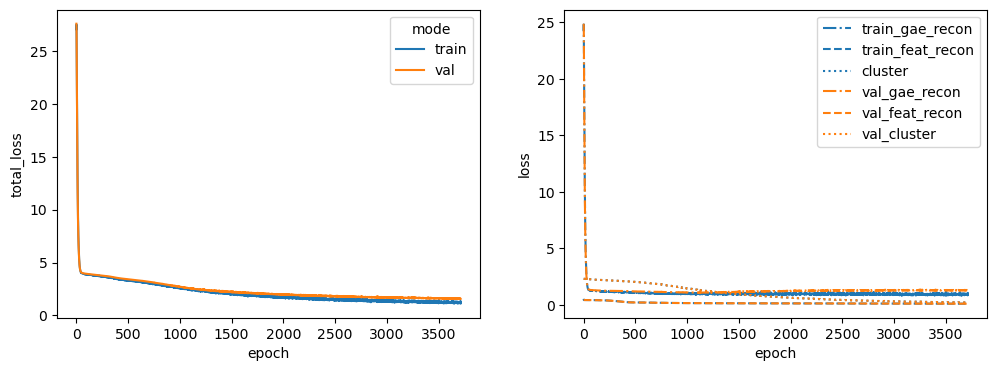

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


dict_keys(['AKT1S1', 'ATF4', 'BAX', 'BCL2L11', 'BRAF', 'CASP8', 'CDC42', 'CDKN1A', 'CEBPA', 'CREB1', 'CXXC4', 'DIABLO', 'E2F1', 'ELK1', 'EMPTY', 'ERG', 'FGFR3', 'FOXO1', 'GLI1', 'HRAS', 'IRAK4', 'JUN', 'MAP2K3', 'MAP3K2', 'MAP3K5', 'MAP3K9', 'MAPK7', 'MOS', 'MYD88', 'PIK3R2', 'PRKACA', 'PRKCE', 'RAF1', 'RELB', 'RHOA', 'SMAD4', 'SMO', 'SRC', 'SREBF1', 'TRAF2', 'TSC2', 'WWTR1'])
AKT1S1


 30%|███       | 3036/10000 [01:09<02:38, 43.83it/s]


Training stopped after 3037 epochs
Best model found at epoch 2935
------------------------------------------------------------
TEST AUC: 0.8141496598639456 AP: 0.8389622529920853
TRAIN loss: 1.386170744895935
VAL loss: 1.7391376495361328
TEST loss: 1.6349854469299316
TEST AUC: 0.8141496598639456 	 AP: 0.8389622529920853


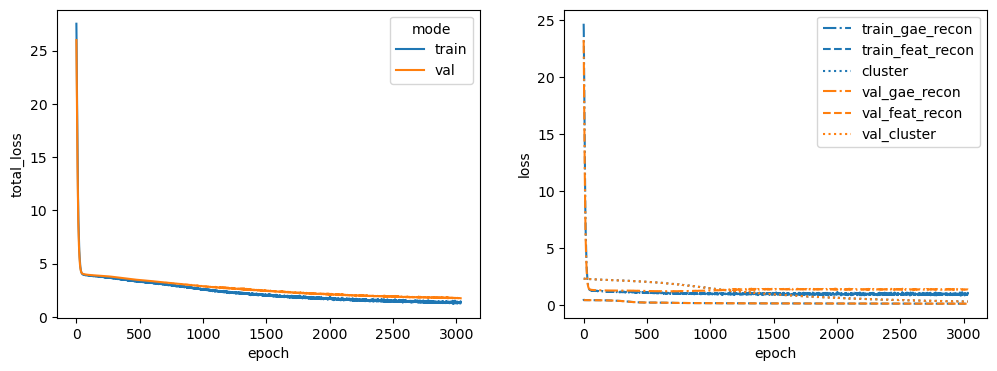

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ATF4


 30%|███       | 3007/10000 [01:08<02:40, 43.62it/s]


Training stopped after 3008 epochs
Best model found at epoch 2906
------------------------------------------------------------
TEST AUC: 0.7788662131519274 AP: 0.7459631754559661
TRAIN loss: 1.427708387374878
VAL loss: 1.6161692142486572
TEST loss: 1.8481860160827637
TEST AUC: 0.7788662131519274 	 AP: 0.7459631754559661


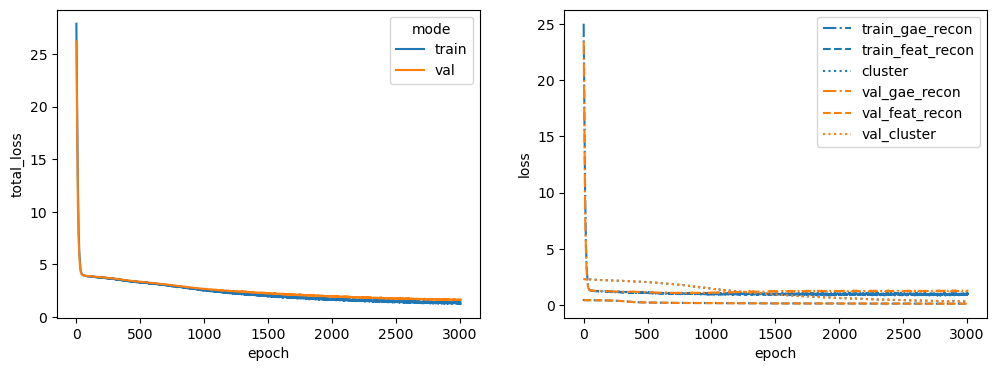

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BAX


 37%|███▋      | 3709/10000 [01:26<02:26, 43.07it/s]


Training stopped after 3710 epochs
Best model found at epoch 3608
------------------------------------------------------------
TEST AUC: 0.7873015873015873 AP: 0.7993482845607011
TRAIN loss: 1.2481595277786255
VAL loss: 1.5000699758529663
TEST loss: 1.6338860988616943
TEST AUC: 0.7873015873015873 	 AP: 0.7993482845607012


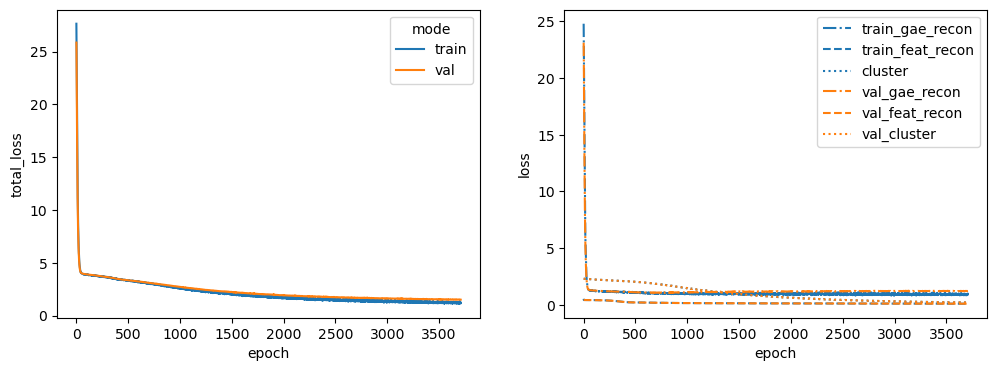

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BCL2L11


 55%|█████▍    | 5458/10000 [02:05<01:44, 43.43it/s]


Training stopped after 5459 epochs
Best model found at epoch 5357
------------------------------------------------------------
TEST AUC: 0.812063492063492 AP: 0.8304171258855237
TRAIN loss: 1.013180136680603
VAL loss: 1.4621398448944092
TEST loss: 1.4161556959152222
TEST AUC: 0.812063492063492 	 AP: 0.8304171258855237


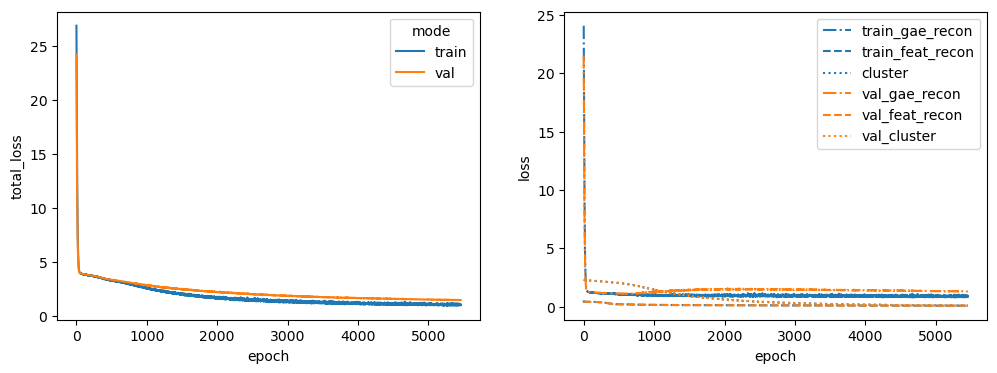

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


BRAF


 31%|███       | 3060/10000 [01:10<02:40, 43.18it/s]


Training stopped after 3061 epochs
Best model found at epoch 2959
------------------------------------------------------------
TEST AUC: 0.8136961451247164 AP: 0.8130596878596386
TRAIN loss: 1.3843107223510742
VAL loss: 1.7018136978149414
TEST loss: 1.6496868133544922
TEST AUC: 0.8136961451247164 	 AP: 0.8130596878596386


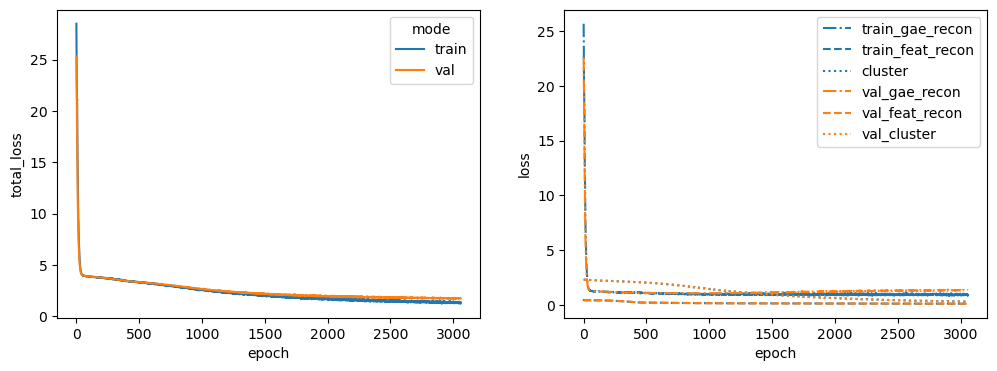

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CASP8


 38%|███▊      | 3843/10000 [01:28<02:22, 43.35it/s]


Training stopped after 3844 epochs
Best model found at epoch 3742
------------------------------------------------------------
TEST AUC: 0.8415419501133786 AP: 0.8530641311214288
TRAIN loss: 1.262762188911438
VAL loss: 1.4182519912719727
TEST loss: 1.4240458011627197
TEST AUC: 0.8415419501133786 	 AP: 0.8530641311214288


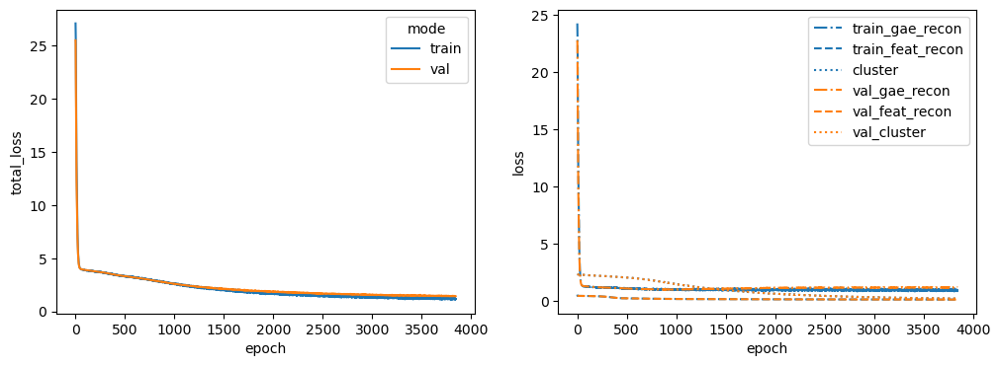

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDC42


 33%|███▎      | 3349/10000 [01:17<02:34, 43.09it/s]


Training stopped after 3350 epochs
Best model found at epoch 3248
------------------------------------------------------------
TEST AUC: 0.8208616780045351 AP: 0.8292167867703881
TRAIN loss: 1.3759195804595947
VAL loss: 1.456829309463501
TEST loss: 1.5733484029769897
TEST AUC: 0.8208616780045351 	 AP: 0.8292167867703881


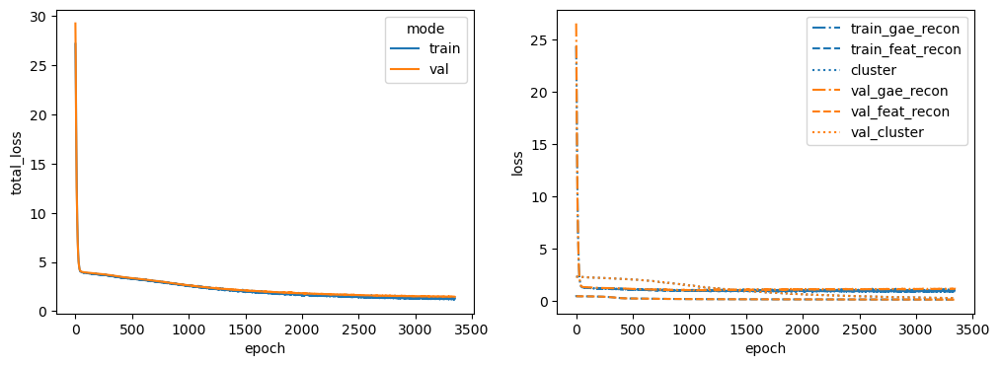

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CDKN1A


 27%|██▋       | 2740/10000 [01:02<02:46, 43.61it/s]


Training stopped after 2741 epochs
Best model found at epoch 2639
------------------------------------------------------------
TEST AUC: 0.8357369614512471 AP: 0.8563372793188457
TRAIN loss: 1.4388759136199951
VAL loss: 2.0211617946624756
TEST loss: 1.6382455825805664
TEST AUC: 0.8357369614512471 	 AP: 0.8563372793188457


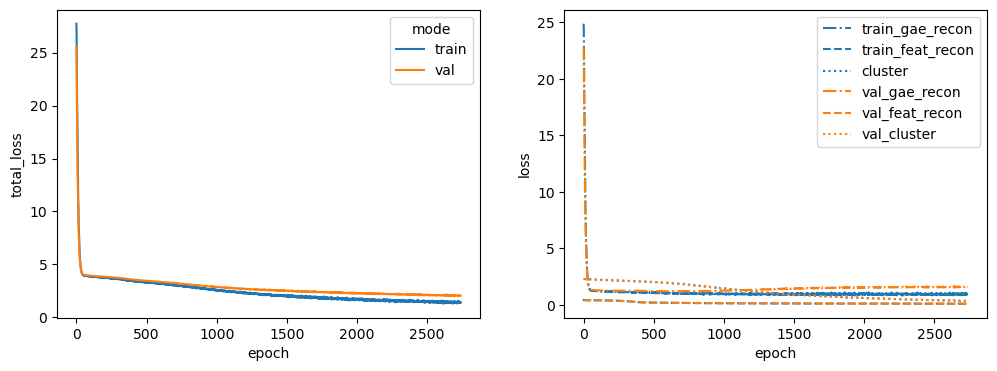

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CEBPA


 46%|████▋     | 4645/10000 [01:45<02:02, 43.89it/s]


Training stopped after 4646 epochs
Best model found at epoch 4544
------------------------------------------------------------
TEST AUC: 0.8423582766439909 AP: 0.843749649939187
TRAIN loss: 1.0772106647491455
VAL loss: 1.4866712093353271
TEST loss: 1.367220163345337
TEST AUC: 0.8423582766439909 	 AP: 0.843749649939187


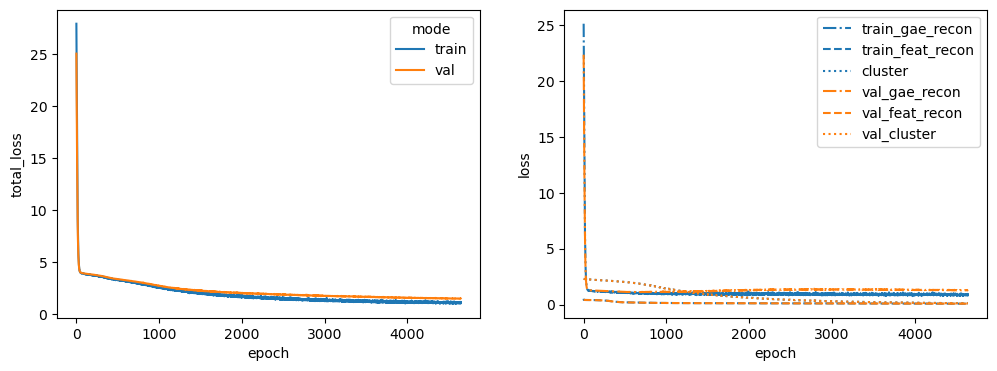

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CREB1


 31%|███       | 3121/10000 [01:12<02:39, 43.21it/s]


Training stopped after 3122 epochs
Best model found at epoch 3020
------------------------------------------------------------
TEST AUC: 0.7942857142857143 AP: 0.7881842706891039
TRAIN loss: 1.2676453590393066
VAL loss: 1.6448715925216675
TEST loss: 1.743916630744934
TEST AUC: 0.7942857142857143 	 AP: 0.7881842706891039


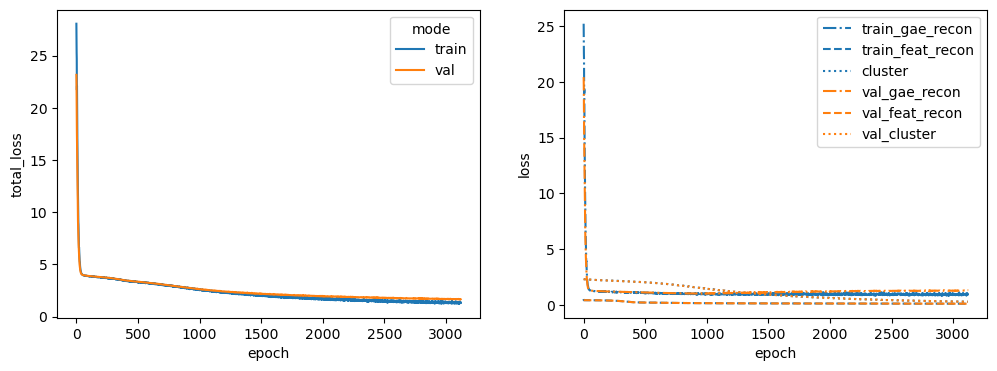

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


CXXC4


 26%|██▌       | 2551/10000 [00:59<02:54, 42.73it/s]


Training stopped after 2552 epochs
Best model found at epoch 2450
------------------------------------------------------------
TEST AUC: 0.8 AP: 0.7894349434391752
TRAIN loss: 1.443514108657837
VAL loss: 1.7014864683151245
TEST loss: 1.8783729076385498
TEST AUC: 0.8 	 AP: 0.7894349434391752


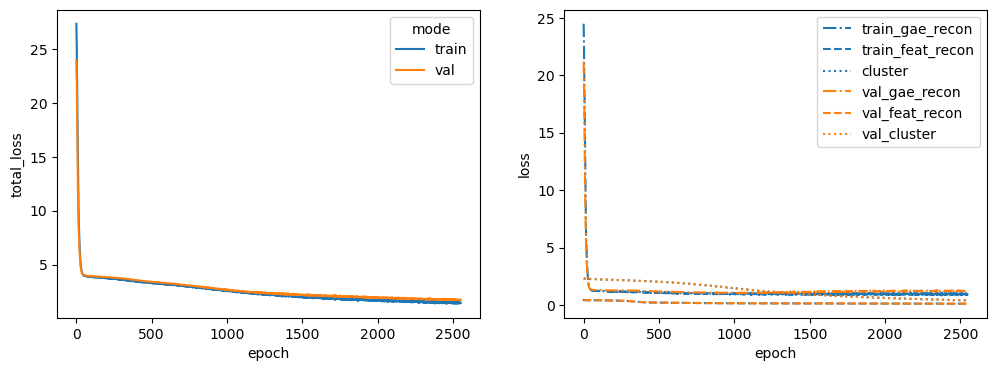

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


DIABLO


 31%|███       | 3108/10000 [01:11<02:37, 43.67it/s]


Training stopped after 3109 epochs
Best model found at epoch 3007
------------------------------------------------------------
TEST AUC: 0.8255782312925168 AP: 0.8170374739923818
TRAIN loss: 1.264317274093628
VAL loss: 1.6177605390548706
TEST loss: 1.6257023811340332
TEST AUC: 0.8255782312925168 	 AP: 0.8170374739923818


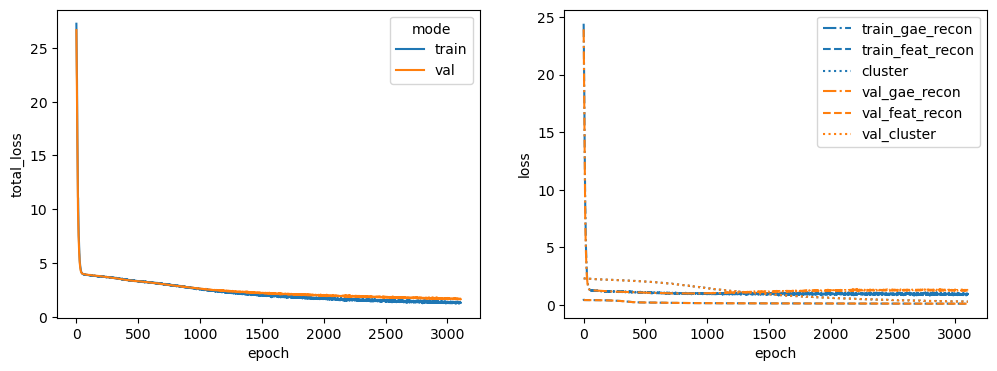

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


E2F1


 56%|█████▌    | 5567/10000 [02:07<01:41, 43.57it/s]


Training stopped after 5568 epochs
Best model found at epoch 5466
------------------------------------------------------------
TEST AUC: 0.7869387755102041 AP: 0.762728976815287
TRAIN loss: 1.0046335458755493
VAL loss: 1.2780486345291138
TEST loss: 1.7784174680709839
TEST AUC: 0.7869387755102041 	 AP: 0.762728976815287


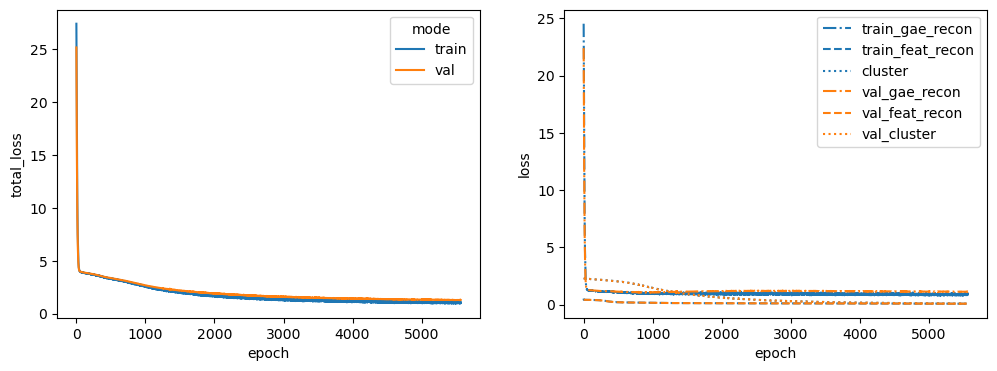

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ELK1


 38%|███▊      | 3837/10000 [01:27<02:20, 43.95it/s]


Training stopped after 3838 epochs
Best model found at epoch 3736
------------------------------------------------------------
TEST AUC: 0.8150566893424035 AP: 0.8227822696535051
TRAIN loss: 1.246677279472351
VAL loss: 1.489726185798645
TEST loss: 1.5323516130447388
TEST AUC: 0.8150566893424035 	 AP: 0.8227822696535051


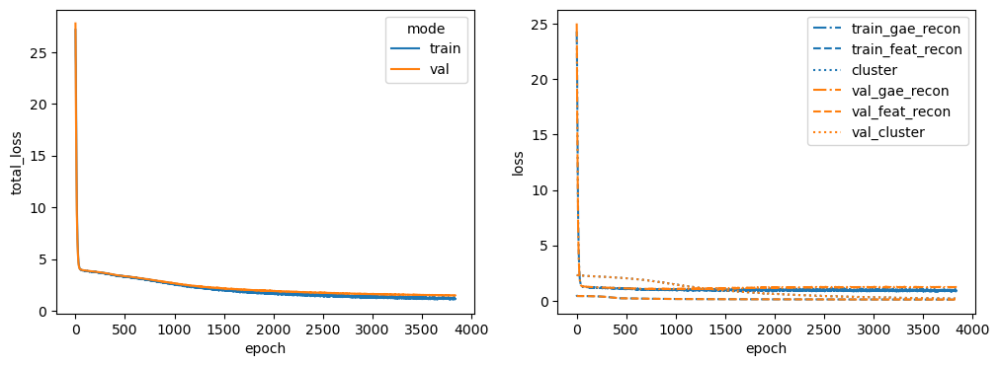

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


EMPTY


 42%|████▏     | 4205/10000 [01:36<02:13, 43.48it/s]


Training stopped after 4206 epochs
Best model found at epoch 4104
------------------------------------------------------------
TEST AUC: 0.8031746031746032 AP: 0.7975396737862689
TRAIN loss: 1.1119123697280884
VAL loss: 1.3829723596572876
TEST loss: 1.5968515872955322
TEST AUC: 0.8031746031746032 	 AP: 0.7975396737862689


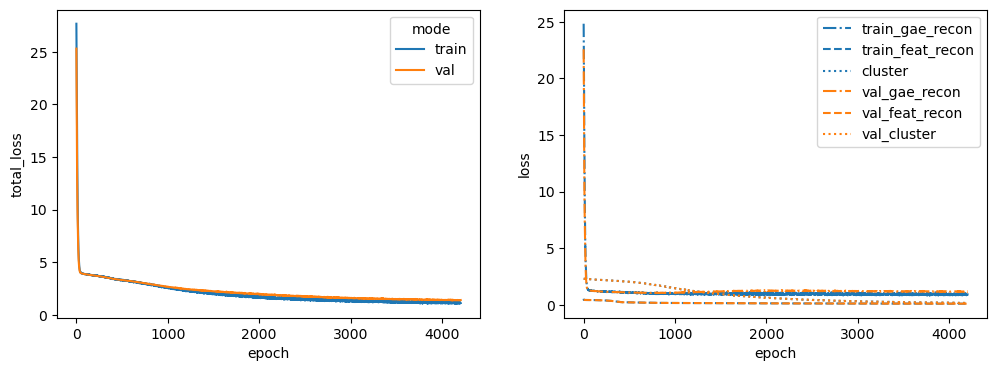

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


ERG


 43%|████▎     | 4297/10000 [01:39<02:12, 43.06it/s]


Training stopped after 4298 epochs
Best model found at epoch 4196
------------------------------------------------------------
TEST AUC: 0.8180498866213153 AP: 0.8325786028934703
TRAIN loss: 1.1217907667160034
VAL loss: 1.5055032968521118
TEST loss: 1.4814413785934448
TEST AUC: 0.8180498866213153 	 AP: 0.8325786028934703


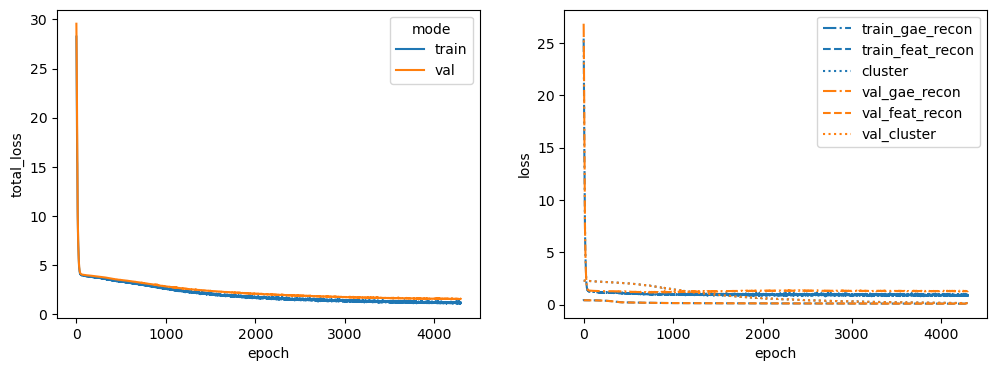

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FGFR3


 33%|███▎      | 3291/10000 [01:15<02:34, 43.32it/s]


Training stopped after 3292 epochs
Best model found at epoch 3190
------------------------------------------------------------
TEST AUC: 0.8175056689342404 AP: 0.812098264487175
TRAIN loss: 1.2147409915924072
VAL loss: 1.5280885696411133
TEST loss: 1.619900107383728
TEST AUC: 0.8175056689342404 	 AP: 0.812098264487175


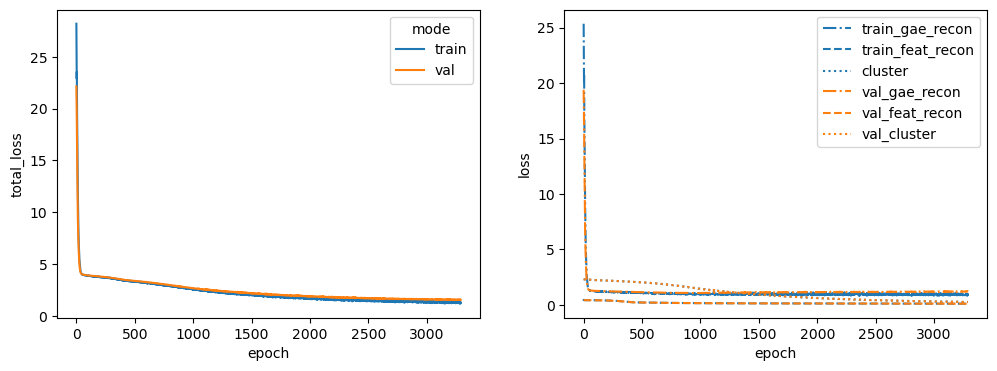

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


FOXO1


 47%|████▋     | 4701/10000 [01:48<02:02, 43.28it/s]


Training stopped after 4702 epochs
Best model found at epoch 4600
------------------------------------------------------------
TEST AUC: 0.8187755102040816 AP: 0.823446230340212
TRAIN loss: 1.134992241859436
VAL loss: 1.7190656661987305
TEST loss: 1.4406063556671143
TEST AUC: 0.8187755102040816 	 AP: 0.823446230340212


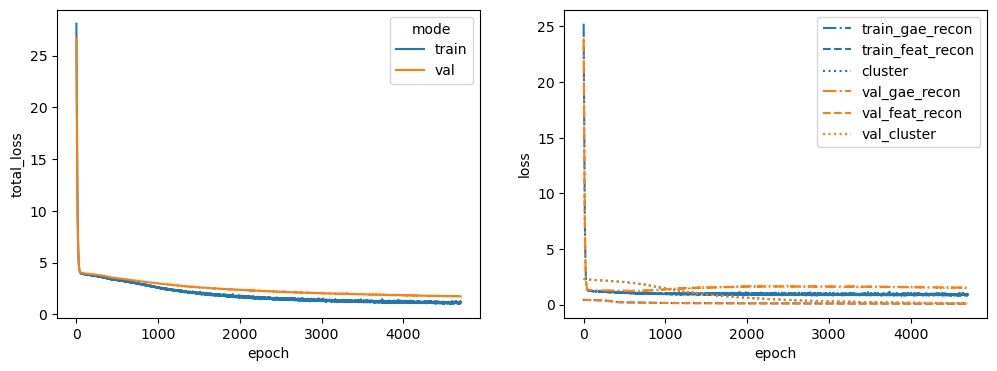

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


GLI1


 33%|███▎      | 3301/10000 [01:11<02:24, 46.42it/s]


Training stopped after 3302 epochs
Best model found at epoch 3200
------------------------------------------------------------
TEST AUC: 0.8183219954648526 AP: 0.806373152513808
TRAIN loss: 1.3272650241851807
VAL loss: 1.5392258167266846
TEST loss: 1.670257329940796
TEST AUC: 0.8183219954648526 	 AP: 0.806373152513808


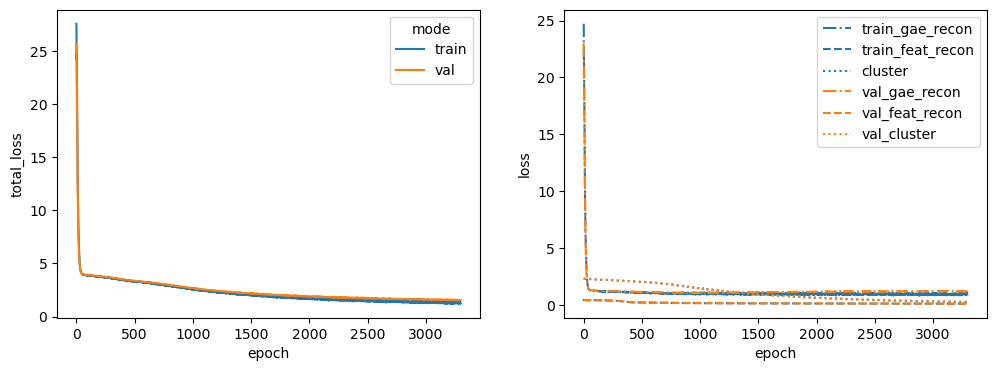

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


HRAS


 42%|████▏     | 4152/10000 [01:23<01:56, 50.02it/s]


Training stopped after 4153 epochs
Best model found at epoch 4051
------------------------------------------------------------
TEST AUC: 0.7737868480725624 AP: 0.7543066214714479
TRAIN loss: 1.173149824142456
VAL loss: 1.4611625671386719
TEST loss: 1.7237032651901245
TEST AUC: 0.7737868480725624 	 AP: 0.7543066214714479


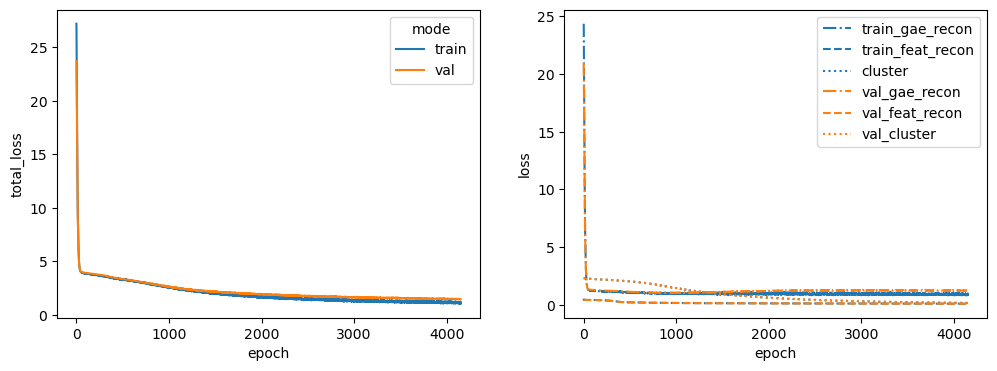

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


IRAK4


 29%|██▉       | 2893/10000 [00:58<02:22, 49.72it/s]


Training stopped after 2894 epochs
Best model found at epoch 2792
------------------------------------------------------------
TEST AUC: 0.7760544217687074 AP: 0.7645019818361274
TRAIN loss: 1.3395037651062012
VAL loss: 1.8290863037109375
TEST loss: 1.8636006116867065
TEST AUC: 0.7760544217687074 	 AP: 0.7645019818361274


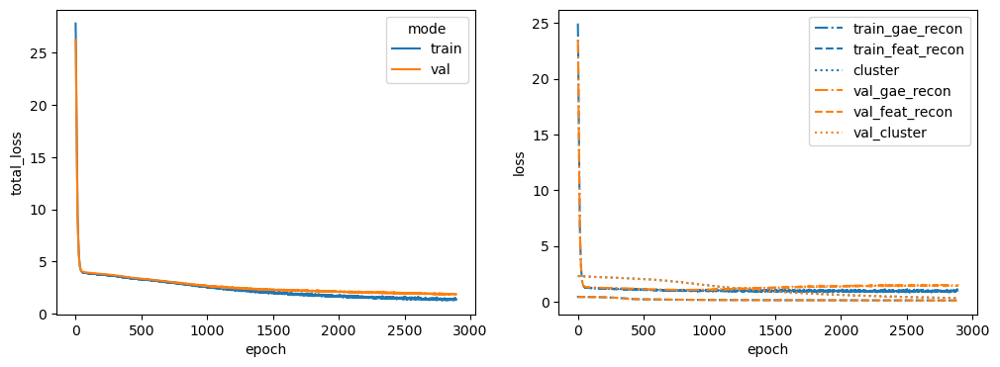

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


JUN


 33%|███▎      | 3254/10000 [01:06<02:17, 49.12it/s]


Training stopped after 3255 epochs
Best model found at epoch 3153
------------------------------------------------------------
TEST AUC: 0.8281179138321996 AP: 0.8109635311893516
TRAIN loss: 1.3038389682769775
VAL loss: 1.5562256574630737
TEST loss: 1.587456226348877
TEST AUC: 0.8281179138321996 	 AP: 0.8109635311893516


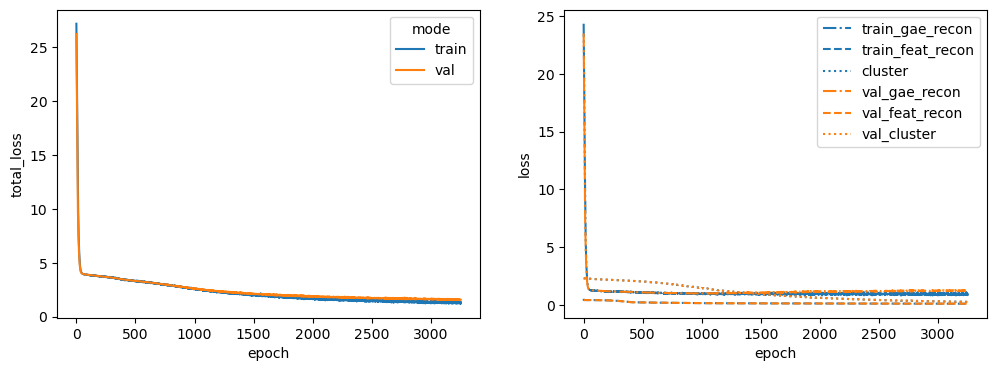

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP2K3


 54%|█████▍    | 5447/10000 [01:49<01:31, 49.67it/s]


Training stopped after 5448 epochs
Best model found at epoch 5346
------------------------------------------------------------
TEST AUC: 0.7969160997732426 AP: 0.78899823728296
TRAIN loss: 1.0328420400619507
VAL loss: 1.4556481838226318
TEST loss: 1.4767175912857056
TEST AUC: 0.7969160997732426 	 AP: 0.78899823728296


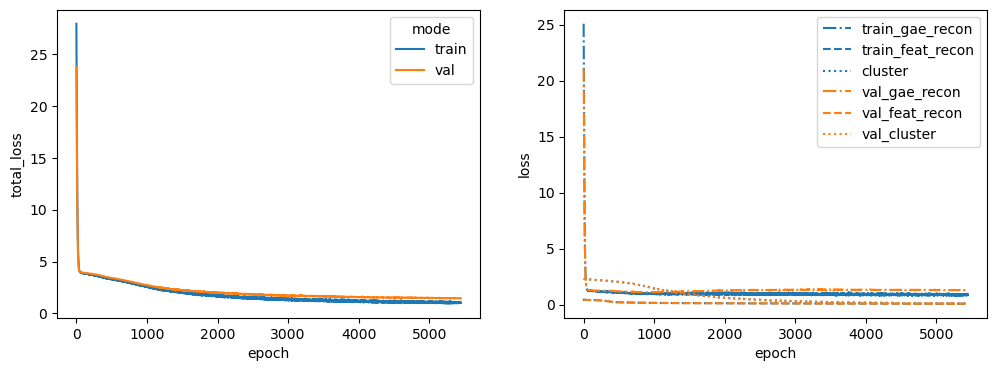

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K2


 36%|███▌      | 3618/10000 [01:12<02:08, 49.65it/s]


Training stopped after 3619 epochs
Best model found at epoch 3517
------------------------------------------------------------
TEST AUC: 0.8166893424036281 AP: 0.8096316065219548
TRAIN loss: 1.2238860130310059
VAL loss: 1.6681790351867676
TEST loss: 1.571035385131836
TEST AUC: 0.8166893424036281 	 AP: 0.8096316065219548


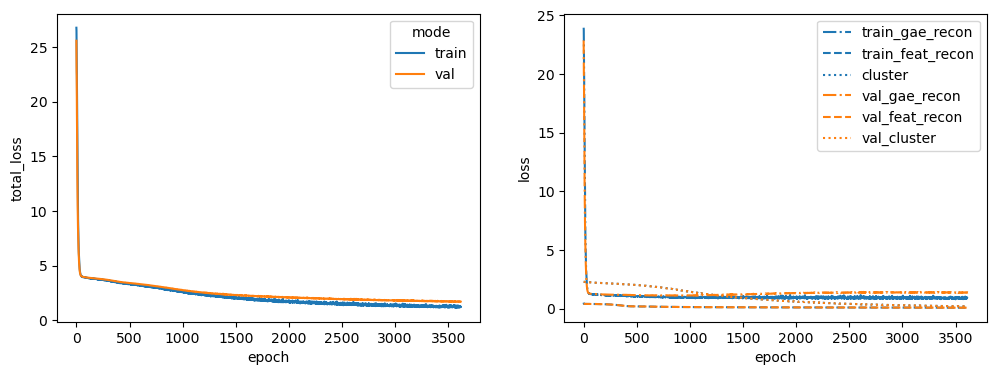

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K5


 32%|███▏      | 3218/10000 [01:04<02:16, 49.68it/s]


Training stopped after 3219 epochs
Best model found at epoch 3117
------------------------------------------------------------
TEST AUC: 0.8171428571428572 AP: 0.8335023941891153
TRAIN loss: 1.357645034790039
VAL loss: 1.6314070224761963
TEST loss: 1.5989147424697876
TEST AUC: 0.8171428571428572 	 AP: 0.8335023941891153


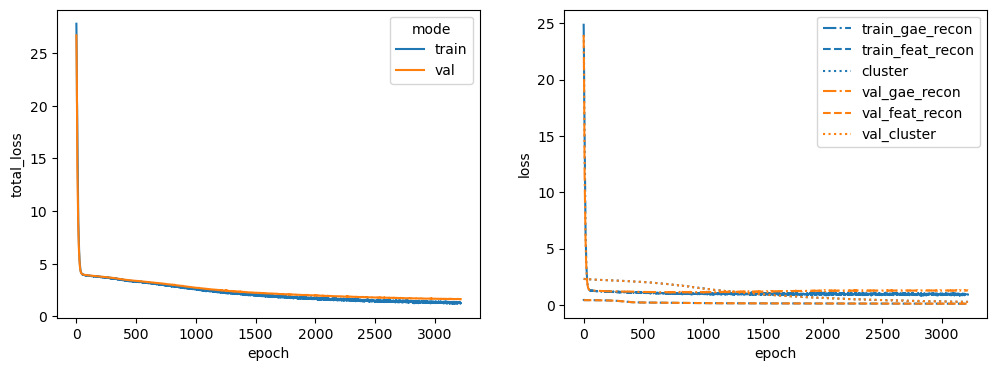

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAP3K9


 30%|██▉       | 2966/10000 [01:00<02:23, 48.87it/s]


Training stopped after 2967 epochs
Best model found at epoch 2865
------------------------------------------------------------
TEST AUC: 0.8091609977324263 AP: 0.8134821134931463
TRAIN loss: 1.3045246601104736
VAL loss: 1.7148404121398926
TEST loss: 1.688876986503601
TEST AUC: 0.8091609977324263 	 AP: 0.8134821134931463


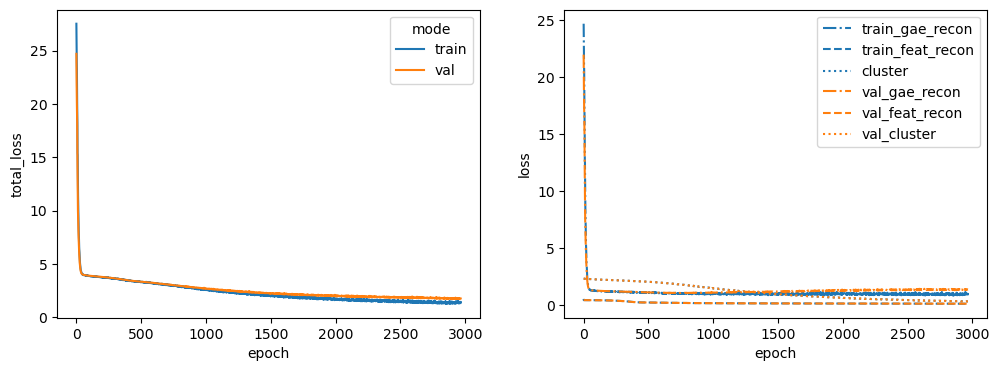

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MAPK7


 53%|█████▎    | 5269/10000 [01:45<01:34, 49.87it/s]


Training stopped after 5270 epochs
Best model found at epoch 5168
------------------------------------------------------------
TEST AUC: 0.8242176870748299 AP: 0.839775110451049
TRAIN loss: 1.0895516872406006
VAL loss: 1.3205254077911377
TEST loss: 1.3810020685195923
TEST AUC: 0.8242176870748299 	 AP: 0.839775110451049


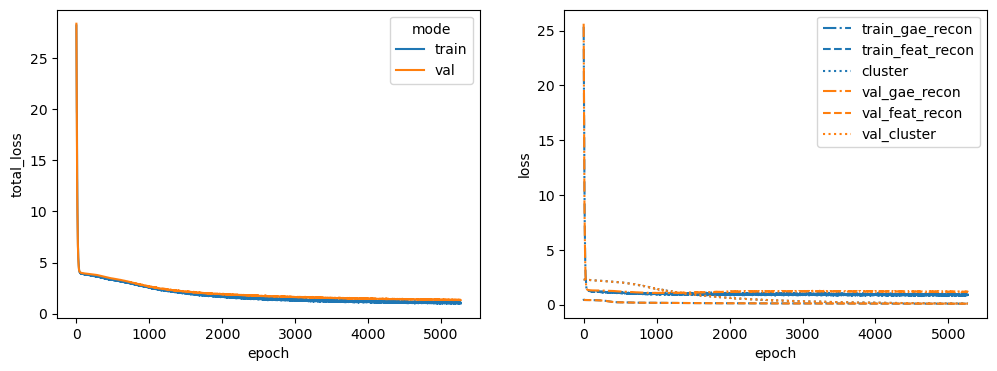

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MOS


 44%|████▎     | 4353/10000 [01:27<01:54, 49.48it/s]


Training stopped after 4354 epochs
Best model found at epoch 4252
------------------------------------------------------------
TEST AUC: 0.7834920634920635 AP: 0.7466640396155466
TRAIN loss: 1.0831328630447388
VAL loss: 1.7075821161270142
TEST loss: 1.7013243436813354
TEST AUC: 0.7834920634920635 	 AP: 0.7466640396155466


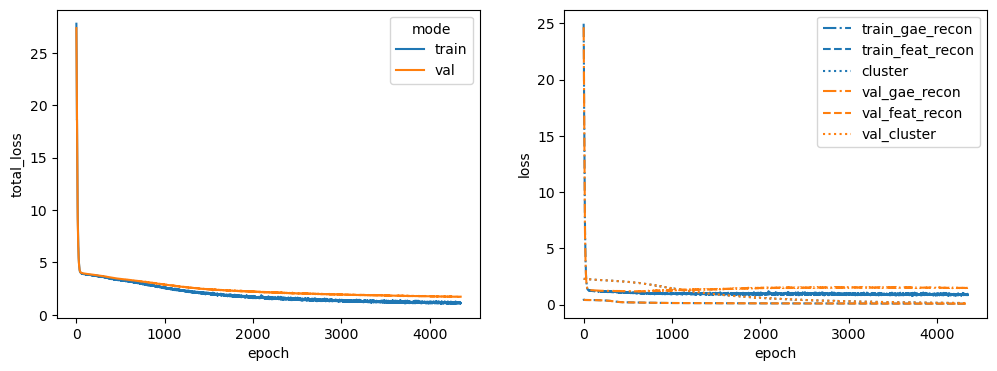

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


MYD88


 40%|███▉      | 3991/10000 [01:20<02:01, 49.49it/s]


Training stopped after 3992 epochs
Best model found at epoch 3890
------------------------------------------------------------
TEST AUC: 0.8053514739229025 AP: 0.7993011132415047
TRAIN loss: 1.1602632999420166
VAL loss: 1.3802129030227661
TEST loss: 1.6278043985366821
TEST AUC: 0.8053514739229025 	 AP: 0.7993011132415047


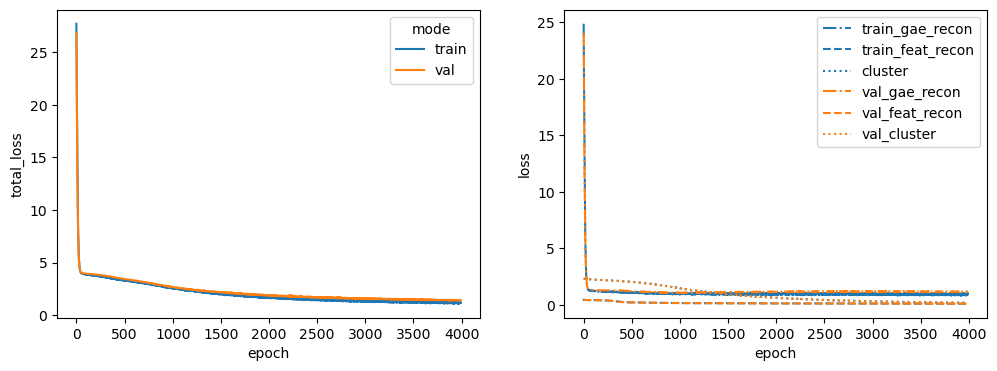

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PIK3R2


 40%|███▉      | 3982/10000 [01:21<02:03, 48.85it/s]


Training stopped after 3983 epochs
Best model found at epoch 3881
------------------------------------------------------------
TEST AUC: 0.7944671201814058 AP: 0.7867646505278474
TRAIN loss: 1.1549938917160034
VAL loss: 1.6871654987335205
TEST loss: 1.584265947341919
TEST AUC: 0.7944671201814058 	 AP: 0.7867646505278474


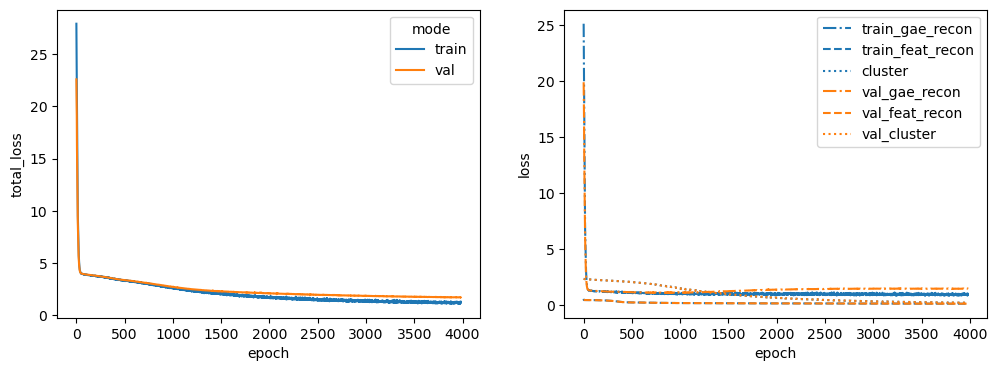

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKACA


 31%|███       | 3099/10000 [01:03<02:21, 48.64it/s]


Training stopped after 3100 epochs
Best model found at epoch 2998
------------------------------------------------------------
TEST AUC: 0.8089795918367346 AP: 0.8230779265269195
TRAIN loss: 1.395844578742981
VAL loss: 1.5210142135620117
TEST loss: 1.654683232307434
TEST AUC: 0.8089795918367346 	 AP: 0.8230779265269195


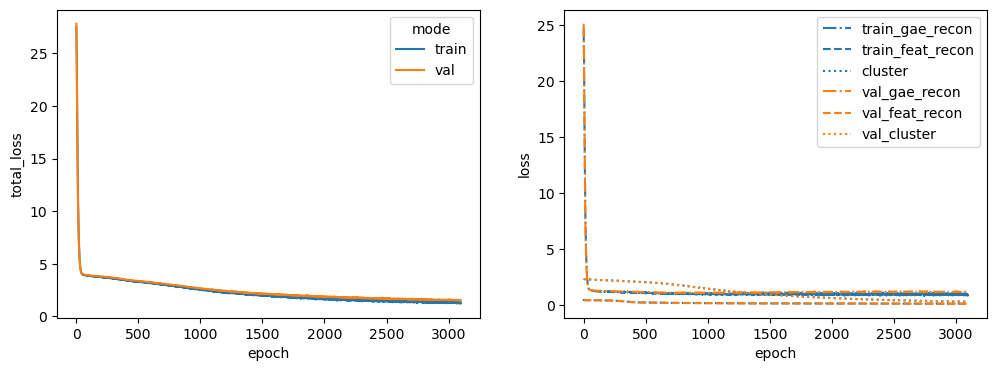

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


PRKCE


 39%|███▉      | 3879/10000 [01:18<02:04, 49.18it/s]


Training stopped after 3880 epochs
Best model found at epoch 3778
------------------------------------------------------------
TEST AUC: 0.8049886621315191 AP: 0.8180721808905486
TRAIN loss: 1.2227379083633423
VAL loss: 1.5313339233398438
TEST loss: 1.5358054637908936
TEST AUC: 0.8049886621315191 	 AP: 0.8180721808905486


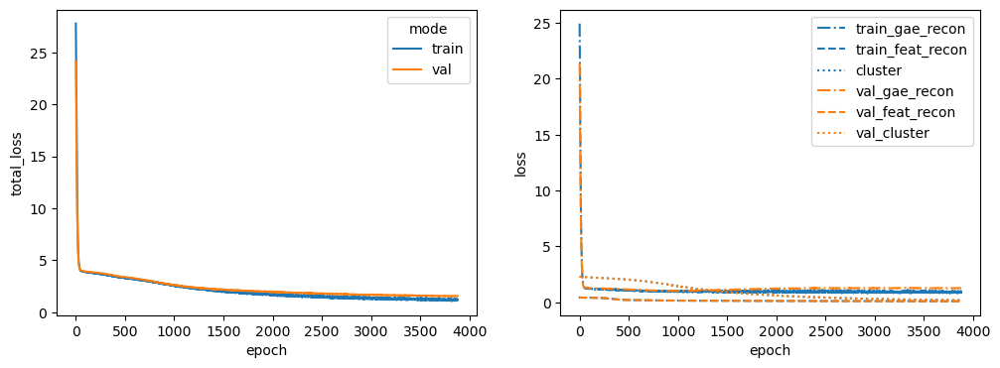

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RAF1


 42%|████▏     | 4194/10000 [01:24<01:56, 49.70it/s]


Training stopped after 4195 epochs
Best model found at epoch 4093
------------------------------------------------------------
TEST AUC: 0.8210430839002268 AP: 0.8337599517449075
TRAIN loss: 1.1990089416503906
VAL loss: 1.5980730056762695
TEST loss: 1.4779152870178223
TEST AUC: 0.8210430839002268 	 AP: 0.8337599517449075


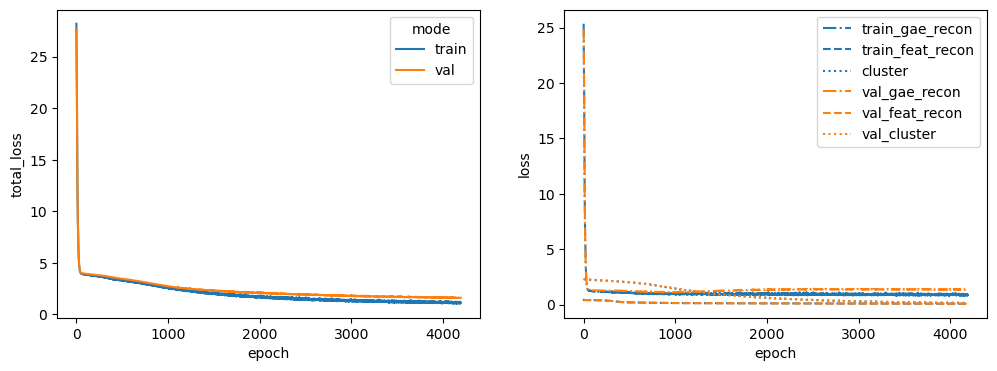

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RELB


 50%|████▉     | 4953/10000 [01:40<01:42, 49.20it/s]


Training stopped after 4954 epochs
Best model found at epoch 4852
------------------------------------------------------------
TEST AUC: 0.8057142857142857 AP: 0.8116072969417691
TRAIN loss: 1.137948751449585
VAL loss: 1.4998689889907837
TEST loss: 1.571484923362732
TEST AUC: 0.8057142857142857 	 AP: 0.8116072969417691


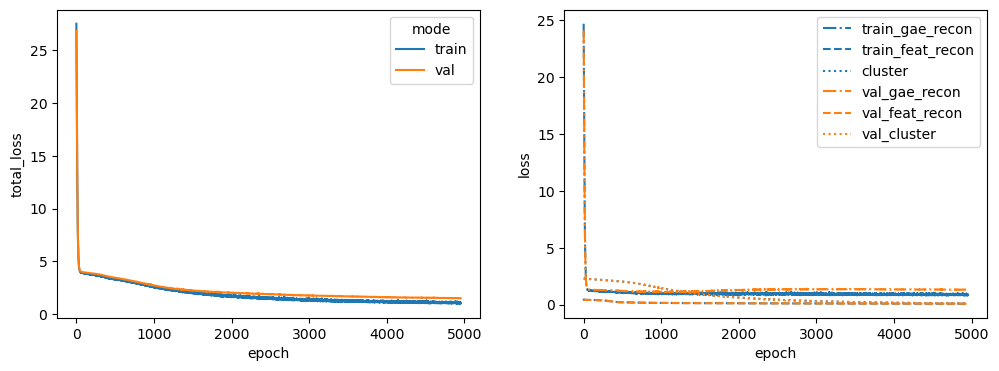

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


RHOA


 39%|███▉      | 3901/10000 [01:20<02:05, 48.63it/s]


Training stopped after 3902 epochs
Best model found at epoch 3800
------------------------------------------------------------
TEST AUC: 0.8420861678004534 AP: 0.8694904586435656
TRAIN loss: 1.1745059490203857
VAL loss: 1.6011078357696533
TEST loss: 1.4064993858337402
TEST AUC: 0.8420861678004534 	 AP: 0.8694904586435656


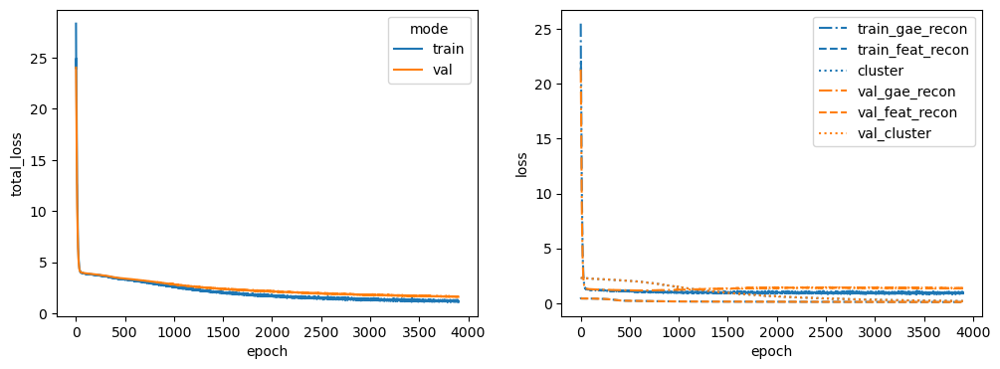

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMAD4


 49%|████▉     | 4911/10000 [01:45<01:49, 46.58it/s]


Training stopped after 4912 epochs
Best model found at epoch 4810
------------------------------------------------------------
TEST AUC: 0.801451247165533 AP: 0.8182526436975966
TRAIN loss: 1.1171226501464844
VAL loss: 1.3417202234268188
TEST loss: 1.4807463884353638
TEST AUC: 0.801451247165533 	 AP: 0.8182526436975966


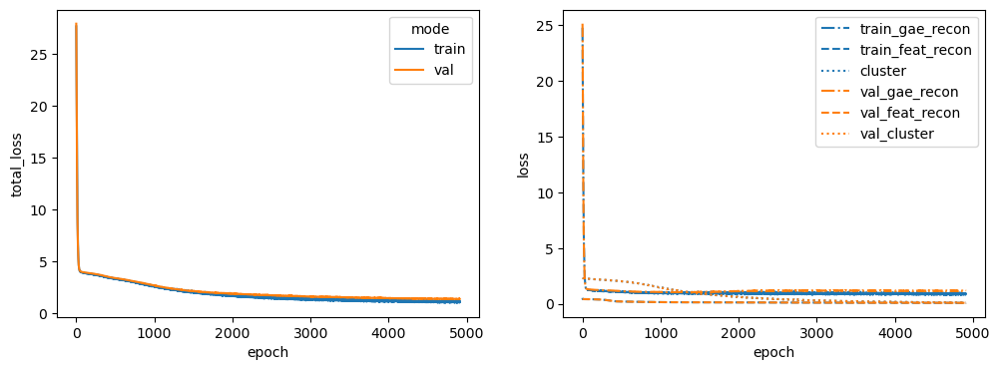

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SMO


 50%|█████     | 5006/10000 [01:49<01:49, 45.65it/s]


Training stopped after 5007 epochs
Best model found at epoch 4905
------------------------------------------------------------
TEST AUC: 0.7867573696145125 AP: 0.7628874366199674
TRAIN loss: 1.0797455310821533
VAL loss: 1.453594446182251
TEST loss: 1.6329668760299683
TEST AUC: 0.7867573696145125 	 AP: 0.7628874366199674


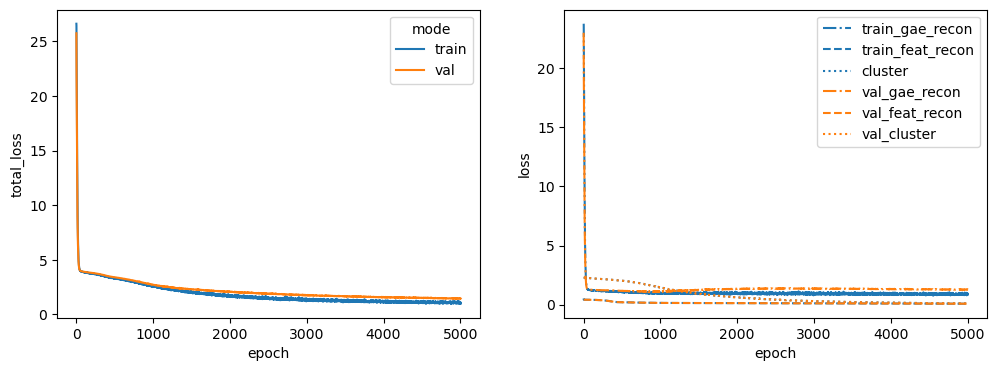

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SRC


 38%|███▊      | 3751/10000 [01:24<02:20, 44.48it/s]


Training stopped after 3752 epochs
Best model found at epoch 3650
------------------------------------------------------------
TEST AUC: 0.7951020408163265 AP: 0.7275628986134405
TRAIN loss: 1.2235374450683594
VAL loss: 1.6298069953918457
TEST loss: 1.9841232299804688
TEST AUC: 0.7951020408163265 	 AP: 0.7275628986134405


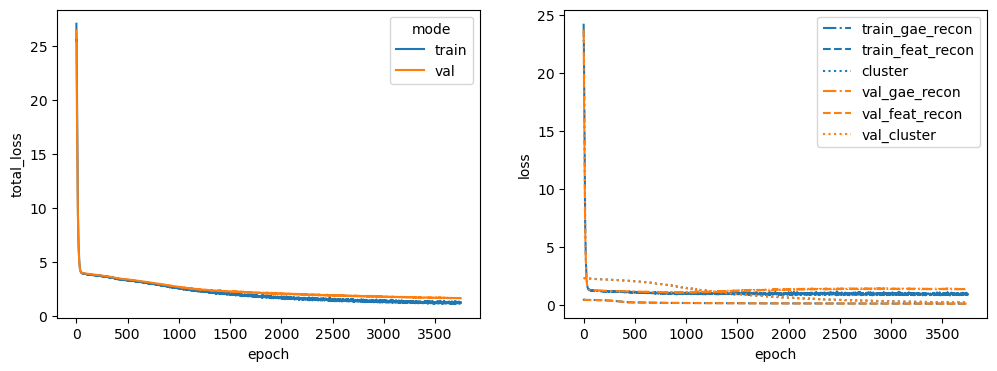

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


SREBF1


 36%|███▌      | 3615/10000 [01:18<02:18, 45.97it/s]


Training stopped after 3616 epochs
Best model found at epoch 3514
------------------------------------------------------------
TEST AUC: 0.8326530612244897 AP: 0.8440616830831402
TRAIN loss: 1.1911628246307373
VAL loss: 1.5346601009368896
TEST loss: 1.494791865348816
TEST AUC: 0.8326530612244897 	 AP: 0.8440616830831402


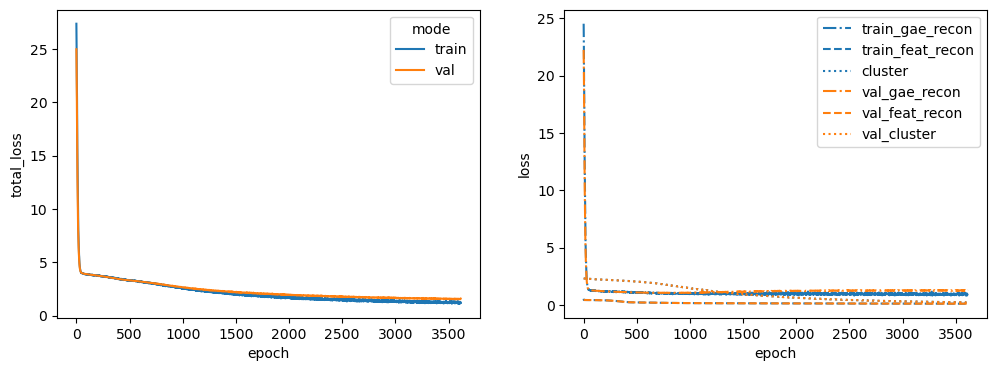

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TRAF2


 46%|████▌     | 4572/10000 [01:38<01:56, 46.50it/s]


Training stopped after 4573 epochs
Best model found at epoch 4471
------------------------------------------------------------
TEST AUC: 0.8085260770975057 AP: 0.8413566169998037
TRAIN loss: 1.1180636882781982
VAL loss: 1.6379592418670654
TEST loss: 1.4569873809814453
TEST AUC: 0.8085260770975057 	 AP: 0.8413566169998037


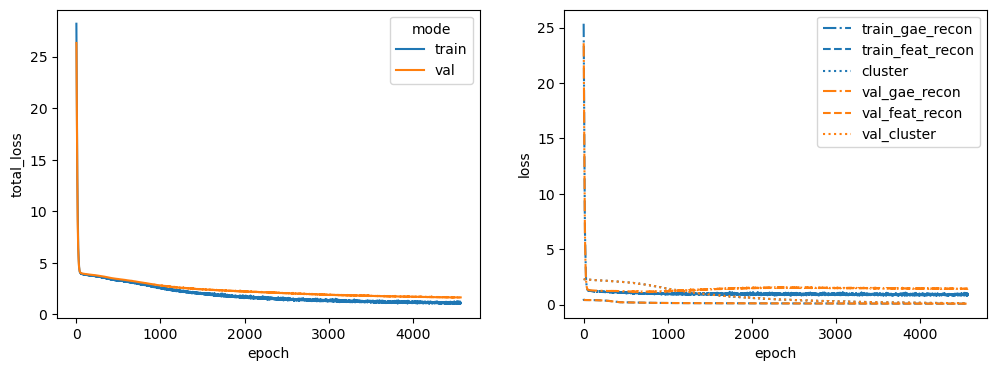

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


TSC2


 46%|████▌     | 4581/10000 [01:39<01:57, 46.00it/s]


Training stopped after 4582 epochs
Best model found at epoch 4480
------------------------------------------------------------
TEST AUC: 0.833015873015873 AP: 0.8569407338994475
TRAIN loss: 1.0859313011169434
VAL loss: 1.4035018682479858
TEST loss: 1.375171422958374
TEST AUC: 0.833015873015873 	 AP: 0.8569407338994475


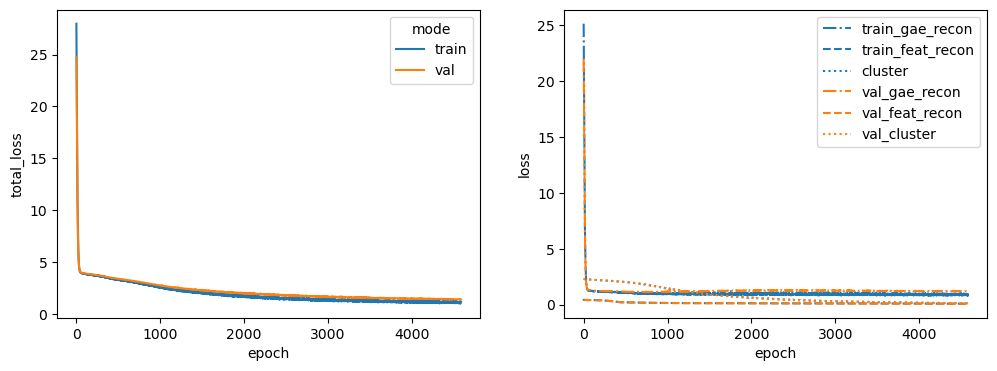

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


WWTR1


 35%|███▍      | 3482/10000 [01:14<02:20, 46.46it/s]


Training stopped after 3483 epochs
Best model found at epoch 3381
------------------------------------------------------------
TEST AUC: 0.8151473922902495 AP: 0.8257445489627041
TRAIN loss: 1.2063463926315308
VAL loss: 1.4688901901245117
TEST loss: 1.5509051084518433
TEST AUC: 0.8151473922902495 	 AP: 0.8257445489627041


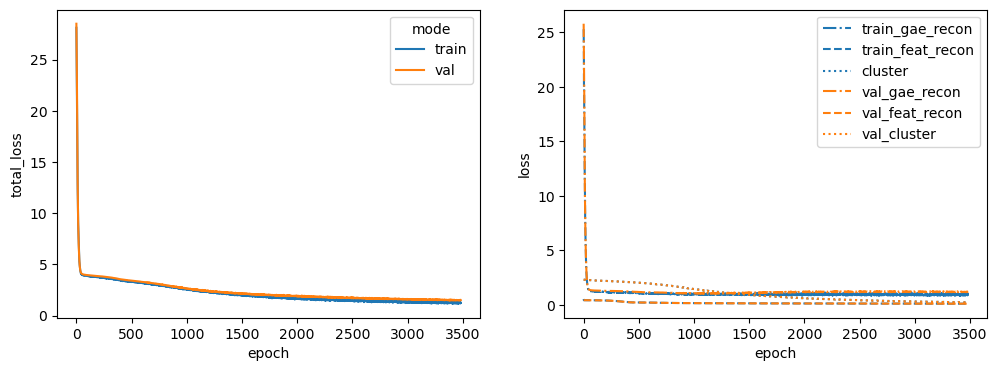

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [26]:
cluster_opts = ["physical_full", "cmap", "cmap_full"]
for cluster_opt in cluster_opts:
    run_reg_space_loto_exp(
        root_output_dir=root_output_dir,
        oe_targets=oe_targets,
        interactome=spearman_interactome,
        physical_cluster_dict=physical_cluster_dict,
        physical_full_cluster_dict=physical_full_cluster_dict,
        cmap_clusters=cmap_clusters,
        cluster_opt=cluster_opt,
        graph_opt=graph_opt,
        alpha=1,
        beta=1,
        gamma=1,
        n_classes=10,
        seed=1234,
        node_feature_key="sc_gex_hallmark",
        input_dim=1176,
        latent_dim=1024,
        early_stopping=100,
        neg_edge_ratio=1,
        lr=0.00001,
    )

---

## 3. Full regulatory space modelling

For the figure shown in the main paper, we also require to infer the regulatory space using the cluster structure of the physical space not trained in a leave-one-out-setting and transferring the full cluster structure.
In the following we will run an according experiment for the setup of $(\alpha, \beta, \gamma) = (1,0,1)$ and using a graph split into training, validation and test set as before.

### 3.1. Train GAE on full graph with full physical cluster structure including controls

In [15]:
physical_all_clusters = pd.read_csv(
    "../../../data/other/mean_physical_clusters.csv", index_col=0
)

<IPython.core.display.Javascript object>

In [167]:
output_dir = "../../../data/other/all_reg_embs_2"
os.makedirs(output_dir, exist_ok=True)

<IPython.core.display.Javascript object>

In [168]:
all_graph = spearman_interactome.copy()
for node in all_graph.nodes(data=True):
    node[-1]["sc_gex"] = np.array(gex_data_z.loc[:, node[0]])
    node[-1]["sc_gex"] = node[-1]["sc_gex"]
    if node[0] in physical_all_clusters.index:
        node[-1]["label"] = physical_all_clusters.loc[node[0], "cluster"]
        node[-1]["label_mask"] = True
    else:
        node[-1]["label"] = -1
        node[-1]["label_mask"] = False

    node[-1]["name"] = node[0]
    node[-1]["spec_target"] = node[0] in oe_targets

    gene_memberships = []
    for geneset in hallmark_geneset_dict.values():
        if node[0] in geneset:
            gene_memberships.append(1.0)
        else:
            gene_memberships.append(0.0)

    node[-1]["hallmark"] = np.array(gene_memberships)
    node[-1]["sc_gex_hallmark"] = np.concatenate(
        [node[-1]["sc_gex"], node[-1]["hallmark"]]
    )

<IPython.core.display.Javascript object>

In [18]:
all_clusters = get_colored_clusters(physical_all_clusters)

<IPython.core.display.Javascript object>

ALL


 38%|███▊      | 3837/10000 [01:15<02:00, 51.04it/s]


Training stopped after 3838 epochs
Best model found at epoch 3736
------------------------------------------------------------
TEST AUC: 0.8036281179138323 AP: 0.8212821261165021
TRAIN loss: 1.042241096496582
VAL loss: 1.2513443231582642
TEST loss: 1.395155906677246
TEST AUC: 0.8036281179138323 	 AP: 0.8212821261165021


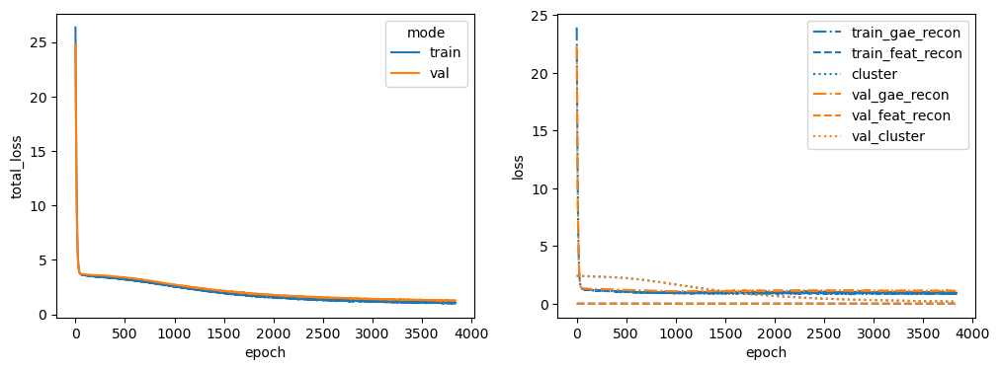

<IPython.core.display.Javascript object>

In [181]:
latents_dict, loss_hist_dict, graph_data = run_loto_inference(
            graph=all_graph,
            oe_target="ALL",
            output_dir=output_dir,
            cluster_opt="all_clusters",
            alpha=1,
            beta=0,
            gamma=1,
            n_classes=11,
            node_feature_key="sc_gex_hallmark",
            input_dim=1176,
            latent_dim=1024,
            graph_opt="split_graph",
            seed=1234,
            lr=0.00001,
            early_stopping=100,
            neg_edge_ratio=1,
            n_epochs=10000,
            device="cpu",
        )


In [182]:
latents = latents_dict[seed]
node_names = getattr(graph_data, "name")
st_memberships = getattr(graph_data, "spec_target")
latents = pd.DataFrame(latents, index=node_names)

<IPython.core.display.Javascript object>

In [183]:
save_and_visualize_latents(
    latents=latents,
    output_dir=output_dir,
    clusters=all_clusters,
    oe_targets=oe_targets,
    st_memberships=st_memberships,
    random_state=1234,
)
latents.to_csv(
    os.path.join(
        output_dir,
        "all_node_embs.csv",
    )
)

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


<IPython.core.display.Javascript object>

In [5]:
latents = pd.read_csv("../../../data/other/all_reg_embs/all_node_embs.csv", index_col =0)

---

### 3.2. Plot co-clustering of regulatory and physical space

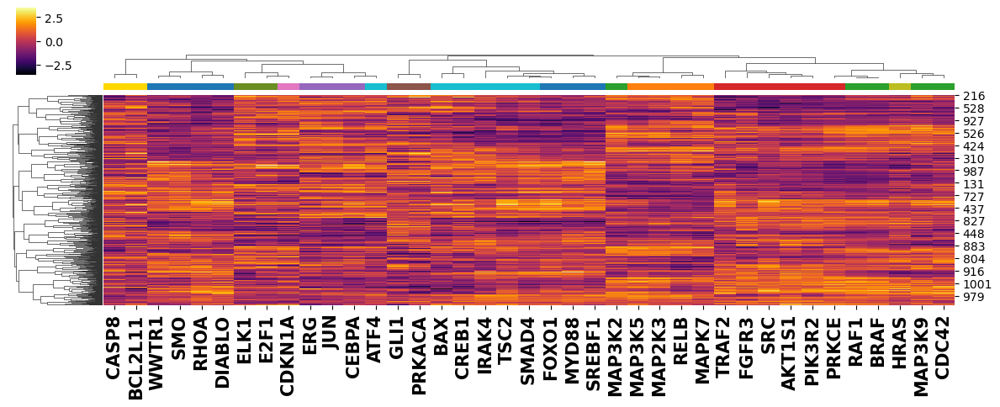

<IPython.core.display.Javascript object>

In [184]:
ax = sns.clustermap(
    latents.loc[set(oe_targets).intersection(latents.index)].transpose(),
    figsize=[12, 4],
    metric="cosine",
    method="complete",
    cmap="inferno",
    col_colors=np.array(
        all_clusters.loc[set(oe_targets).intersection(latents.index), "color"]
    ).ravel(),
    dendrogram_ratio=0.1,
    z_score=1,
)
x0, _y0, _w, _h = ax.cbar_pos

ax.ax_cbar.set_position([0.02, 0.9, 0.02, 0.2])
ax.ax_heatmap.set_xticklabels(
    ax.ax_heatmap.get_xmajorticklabels(),
    fontsize=15,
    fontweight="bold",
)

plt.show()

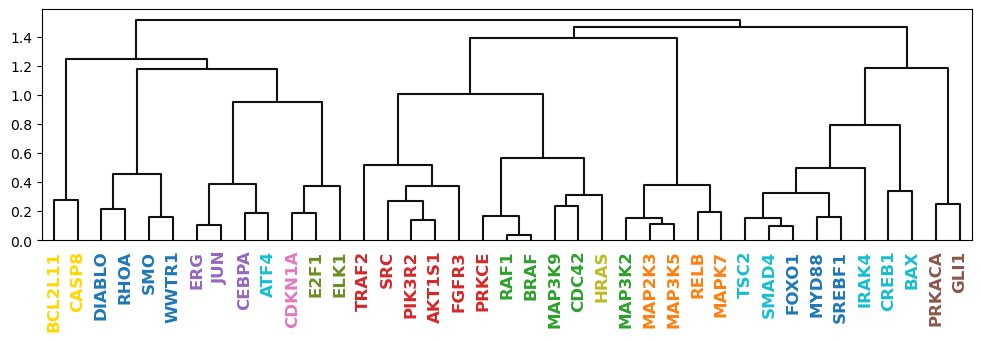

<IPython.core.display.Javascript object>

In [185]:
fig, ax = plt.subplots(figsize=[12, 3])
linkage_mtx = hc.linkage(
    latents.loc[set(oe_targets).intersection(latents.index)],
    method="complete",
    metric="cosine",
    optimal_ordering=True,
)
_ = hc.dendrogram(
    linkage_mtx,
    labels=latents.loc[set(oe_targets).intersection(latents.index)].index,
    leaf_rotation=90,
    color_threshold=0,
    ax=ax,
    above_threshold_color="k",
)
ax.set_xticklabels(
    ax.get_xmajorticklabels(),
    fontsize=12,
    fontweight="bold",
)
xtick_labels = ax.get_xticklabels()
for xtick_label in xtick_labels:
    label = xtick_label.get_text()
    xtick_label.set_color(all_clusters.loc[label, "color"])
plt.show()

# Show the graph
# plt.show()

/home/paysan_d/miniconda3/envs/image2reg/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


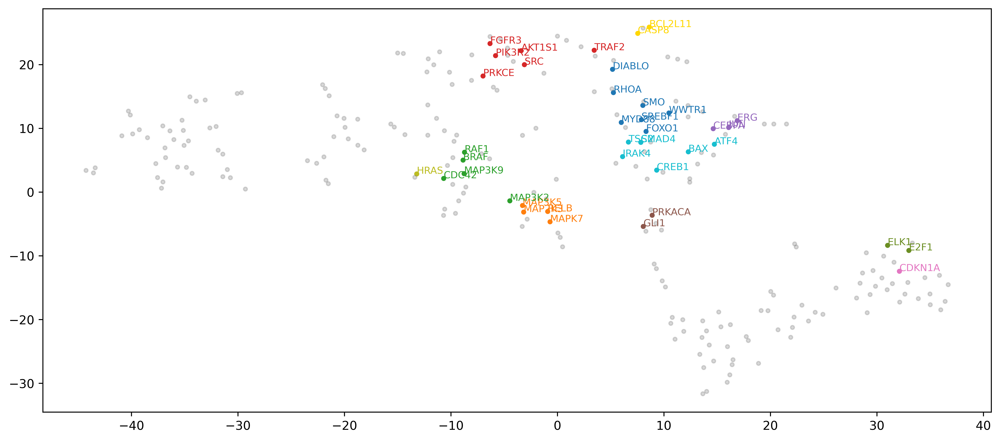

<IPython.core.display.Javascript object>

In [20]:
normalized_latents = pd.DataFrame(
    normalize(latents), index=latents.index, columns=latents.columns
)
tsne = TSNE(
    random_state=1234,
    perplexity=np.ceil(np.sqrt(len(normalized_latents))),
    init="pca",
    learning_rate=200,
)
embs = tsne.fit_transform(normalized_latents)
embs = pd.DataFrame(embs, index=normalized_latents.index, columns=["tsne_0", "tsne_1"])

fig, ax = plt.subplots(figsize=[14, 6])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]
    if label in oe_targets:
        c = all_clusters.loc[label, "color"]
        alpha = 1
        ax.text(x + 0.01, y + 0.01, label, {"size": 8, "c": c})
    else:
        c = "grey"
        alpha = 0.3
    ax.scatter(x, y, c=c, alpha=alpha, s=10)

plt.show()

----

### 3.3. Visualization of the inferred regulatory space

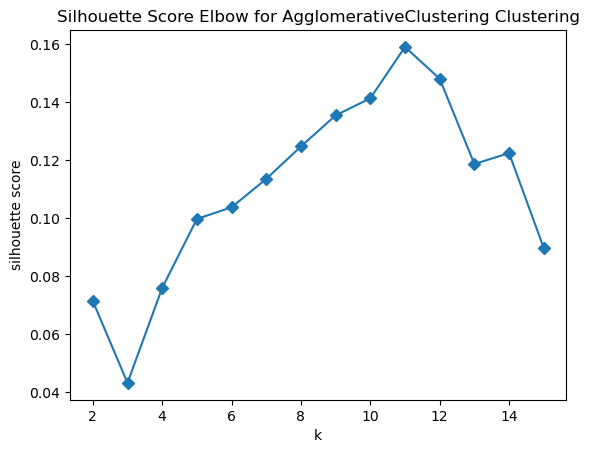

<IPython.core.display.Javascript object>

In [187]:
model = AgglomerativeClustering(affinity="cosine", linkage="complete")
visualizer = KElbowVisualizer(
    model, k=15, metric="silhouette", timings=False, locate_elbow=False
)

visualizer.fit(latents)
ax = visualizer.show()

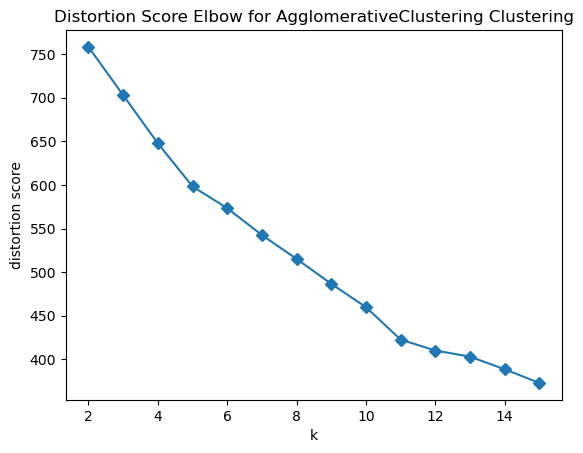

<IPython.core.display.Javascript object>

In [188]:
visualizer = KElbowVisualizer(
    model, k=15, metric="distortion", timings=False, locate_elbow=False
)

visualizer.fit(latents)
ax = visualizer.show()

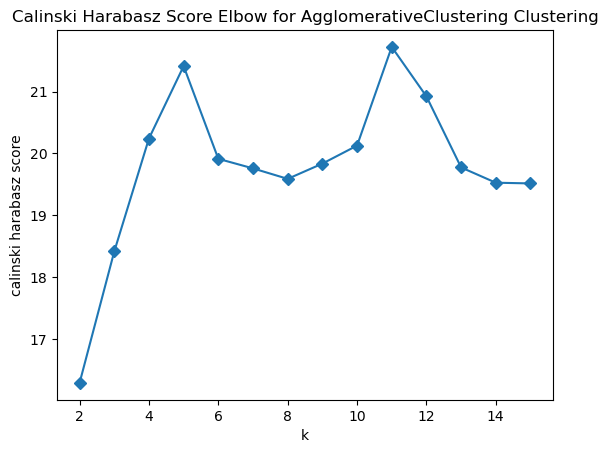

<IPython.core.display.Javascript object>

In [189]:
visualizer = KElbowVisualizer(
    model, k=15, metric="calinski_harabasz", timings=False, locate_elbow=False
)

visualizer.fit(latents)
ax = visualizer.show()

Based on the plots above we select k=8.

In [190]:
print(sorted(list(latents.index)))

['ACAN', 'AKT1S1', 'ALOX5', 'AMPH', 'APPBP2', 'AQP1', 'ARMCX2', 'ATF4', 'ATXN7', 'AURKA', 'AURKB', 'AXL', 'BAX', 'BCL2L11', 'BCR', 'BEX1', 'BIRC5', 'BMP4', 'BRAF', 'BUB1', 'BUB1B', 'C1QL1', 'CASP8', 'CCNA2', 'CCNB1', 'CCNB2', 'CCND2', 'CCNE1', 'CCNF', 'CD40', 'CDC20', 'CDC42', 'CDC42EP1', 'CDC45', 'CDC6', 'CDCA2', 'CDCA3', 'CDCA8', 'CDK1', 'CDK14', 'CDK2', 'CDK6', 'CDKN1A', 'CEBPA', 'CENPA', 'CENPE', 'CEP192', 'CKS2', 'CLSPN', 'CLU', 'CNN1', 'COL1A1', 'COL4A1', 'COL4A2', 'COL5A1', 'CREB1', 'CRMP1', 'CRYAB', 'CYBA', 'DHRS2', 'DIABLO', 'DNMT3B', 'DSP', 'DUSP6', 'E2F1', 'EEF1A2', 'EFEMP1', 'ELK1', 'EPB41L3', 'ERG', 'EXO1', 'FBLN1', 'FBN1', 'FBN2', 'FEN1', 'FGF1', 'FGFR2', 'FGFR3', 'FHL2', 'FKBP4', 'FN1', 'FOS', 'FOXM1', 'FOXO1', 'FSTL1', 'GABRB3', 'GIT1', 'GLI1', 'GLI2', 'GNAQ', 'GSK3B', 'GTSE1', 'HAPLN1', 'HJURP', 'HK2', 'HRAS', 'HSP90AB1', 'HSPA1B', 'HSPB1', 'HSPG2', 'IGF2', 'IGFBP5', 'INHBA', 'IRAK4', 'IRF7', 'JUN', 'KIF15', 'KIF23', 'KIF2C', 'KIF4A', 'KLK6', 'KPNA2', 'KRT15', 'KRT18',

<IPython.core.display.Javascript object>

In [192]:
model = model = AgglomerativeClustering(
    affinity="cosine", linkage="complete", n_clusters=11
)
cluster_labels = model.fit_predict(latents)
cluster_dict = {}
for cluster_label in np.unique(cluster_labels):
    cluster_dict[cluster_label] = list(
        np.array(list(latents.index))[cluster_labels == cluster_label]
    )
for k, v in cluster_dict.items():
    print("Cluster {}: {}".format(k, sorted(v)))
    print("")

Cluster 0: ['BCR', 'BRAF', 'CDC42', 'CDC42EP1', 'CDK14', 'CNN1', 'CYBA', 'EPB41L3', 'FKBP4', 'HRAS', 'HSP90AB1', 'HSPA1B', 'HSPB1', 'KPNA2', 'KRT18', 'KRT8', 'LDOC1', 'LGALS1', 'MAGEA1', 'MAGED1', 'MAP3K9', 'MDFI', 'MYL2', 'NCF2', 'PAK2', 'PRKCE', 'RAF1', 'RHOA', 'S100A2', 'SDC1', 'SDC2', 'SDC3', 'SFN', 'SRC', 'THRA', 'TNNT1', 'TPM1', 'TPM2', 'TUBA1A', 'TUBB', 'TUBB6', 'YWHAQ']

Cluster 1: ['ALOX5', 'C1QL1', 'CRYAB', 'GABRB3', 'GIT1', 'GLI1', 'LBH', 'LOXL4', 'LZTS2', 'NOTCH3', 'PARP2', 'PCLO', 'PRKACA', 'PRKCA', 'PTN', 'RPS6KB1', 'STAC', 'STC2', 'SUV39H1', 'TNNT2', 'YES1']

Cluster 2: ['AURKA', 'AURKB', 'BIRC5', 'BUB1', 'BUB1B', 'CCNB1', 'CCNB2', 'CCNF', 'CDC20', 'CDCA2', 'CDCA8', 'CDK1', 'CENPA', 'CENPE', 'CEP192', 'CKS2', 'DNMT3B', 'GTSE1', 'HJURP', 'KIF15', 'KIF23', 'KIF2C', 'KIF4A', 'MKI67', 'NCAPH', 'NDC80', 'NEK2', 'NUF2', 'PLK1', 'PRC1', 'PRSS23', 'RACGAP1', 'RRM2', 'SPC24', 'SPC25', 'TNNC1', 'TPX2', 'TTK', 'UBE2C', 'UBE2S', 'WEE1', 'ZWINT']

Cluster 3: ['AMPH', 'BEX1', 'DUSP6',

<IPython.core.display.Javascript object>

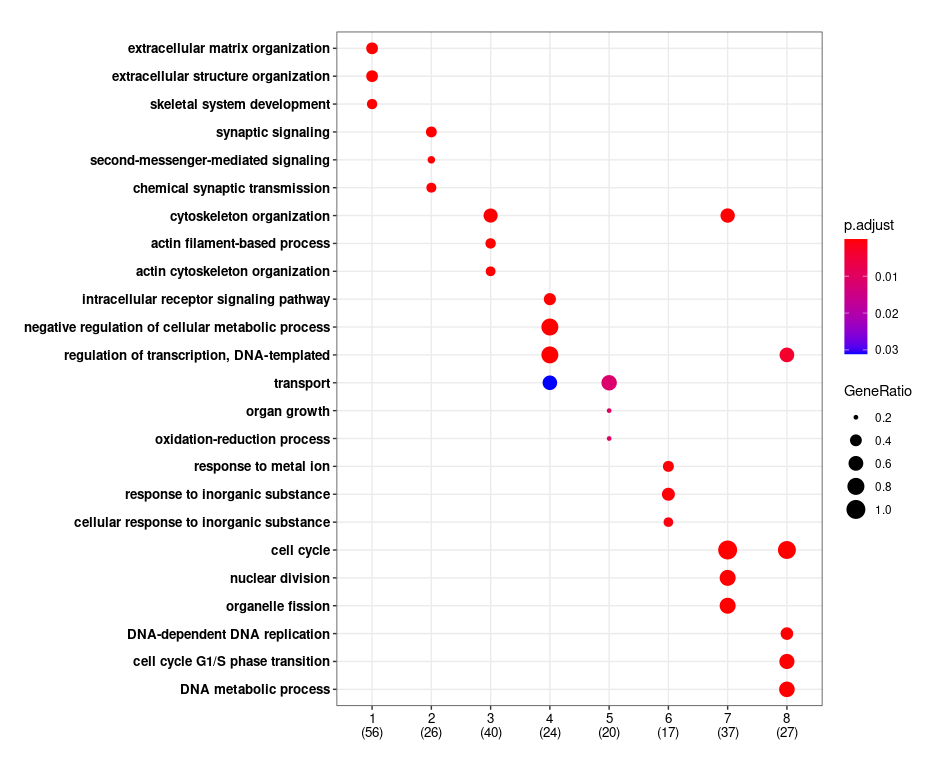

<IPython.core.display.Javascript object>

In [64]:
Image(
    filename="../../../data/figures/reg_space_full_physical_cluster_agglo_cosine_complete_8clusters.png"
)

---

## 4. Visualization of the regulatory and physical space for selected LOTO settings

In [17]:
root_dir = (
    "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings"
)
exp_dir = "spearman_sol"
gae_exp = "gae_exp_a1_b0_g1_split_graph_physical"
phy_embs_dict_101_s_phy, reg_embs_dict_101_s_phy = read_in_loto_embs(
    root_dir=root_dir,
    exp_dir=exp_dir,
    gae_exp=gae_exp,
    avg_phy_embs=True,
    normalize_reg_embs=True,
    exclude_ctrl=True,
)

100%|██████████| 42/42 [01:31<00:00,  2.18s/it]


<IPython.core.display.Javascript object>

#### Held-out JUN

In [18]:
target = "JUN"
highlight = ["CEBPA", "ERG"]
pca = PCA(n_components=2, random_state=1234)

<IPython.core.display.Javascript object>

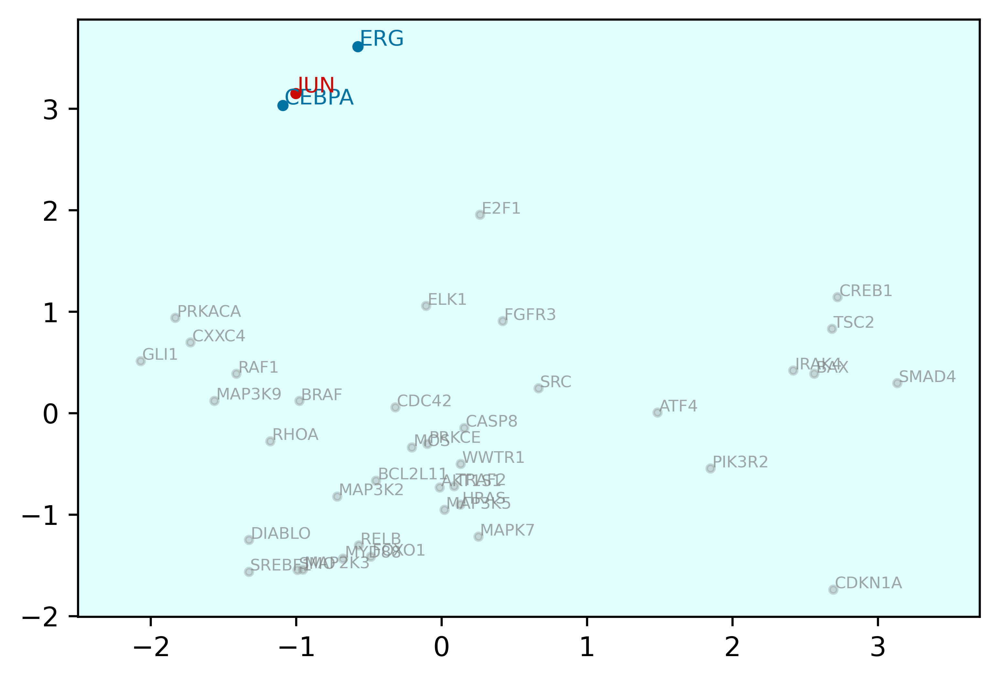

<IPython.core.display.Javascript object>

In [19]:
# Physical space
target_latents = phy_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_xlim([-2.5, 3.7])
    ax.set_facecolor("lightcyan")
plt.show()

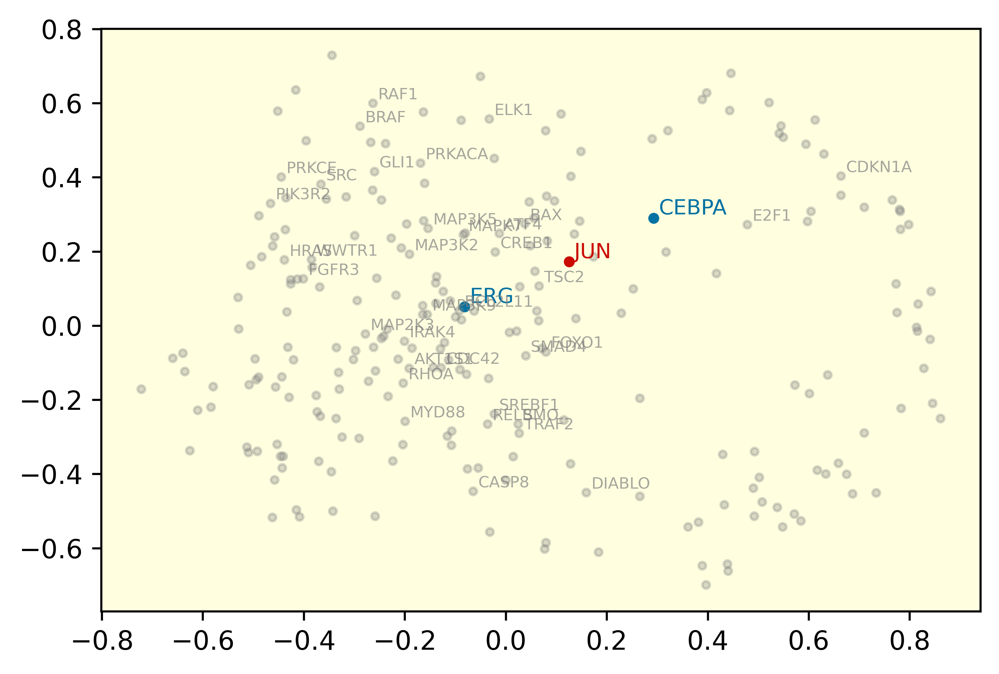

<IPython.core.display.Javascript object>

In [20]:
## Regulatory space

target_latents = reg_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_facecolor("lightyellow")
plt.show()

---

#### MAP3K9

In [21]:
target = "MAP3K9"
highlight = ["BRAF", "RAF1", "MAP3K2", "CDC42"]
pca = PCA(n_components=2, random_state=1234)

<IPython.core.display.Javascript object>

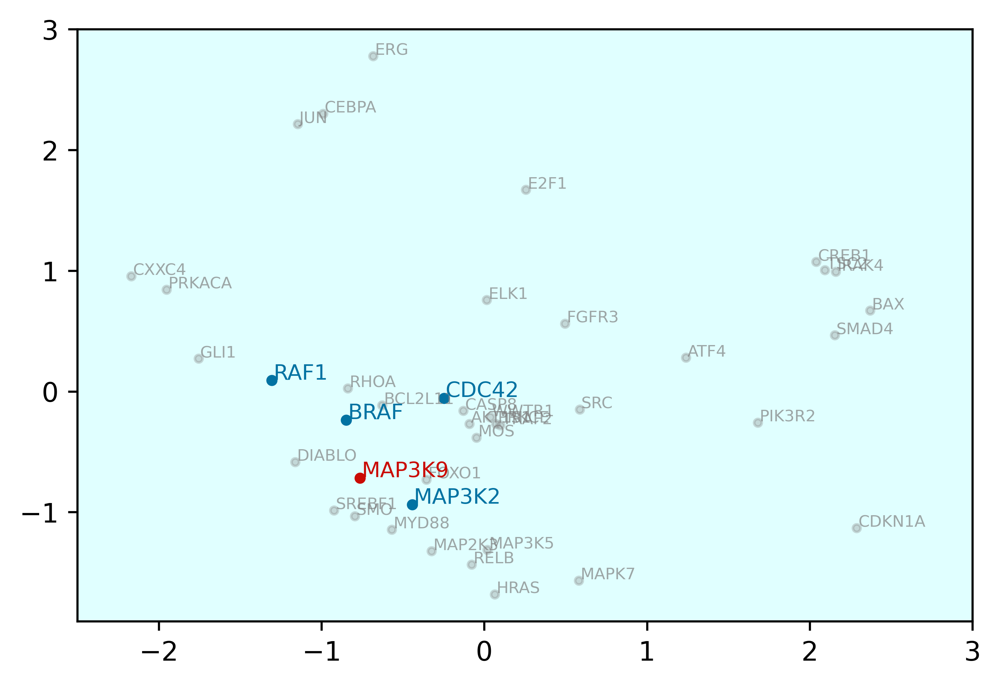

<IPython.core.display.Javascript object>

In [22]:
## Physical space

target_latents = phy_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_xlim([-2.5, 3])
    ax.set_facecolor("lightcyan")
plt.show()

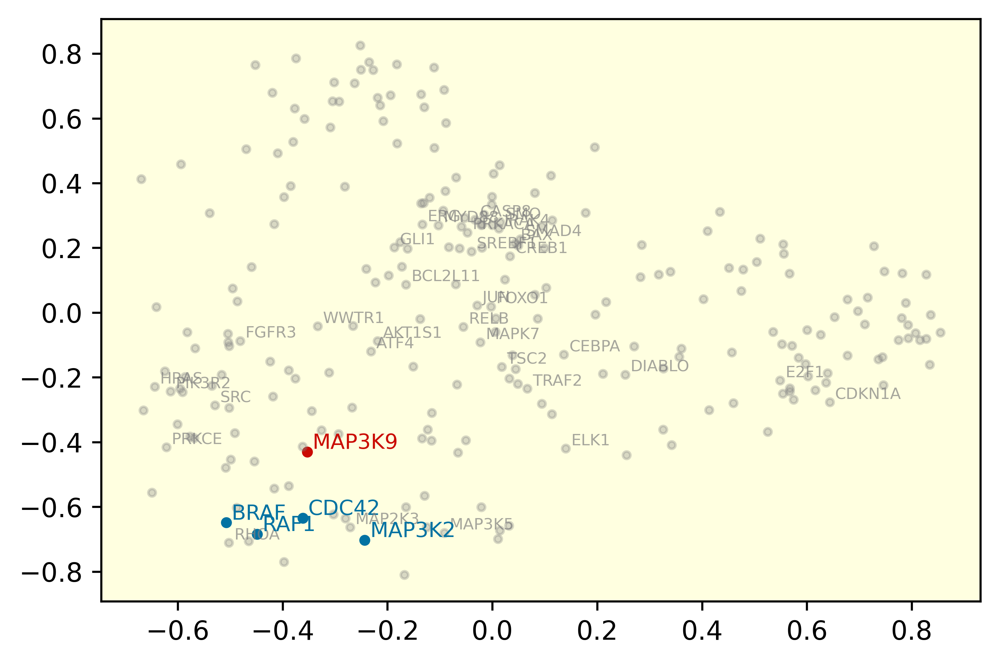

<IPython.core.display.Javascript object>

In [23]:
7  ## Regulatory space

target_latents = reg_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_facecolor("lightyellow")
plt.show()

#### Held-out CASP8

In [30]:
target = "CASP8"
highlight = ["BCL2L11"]
pca = PCA(n_components=2, random_state=1234)

<IPython.core.display.Javascript object>

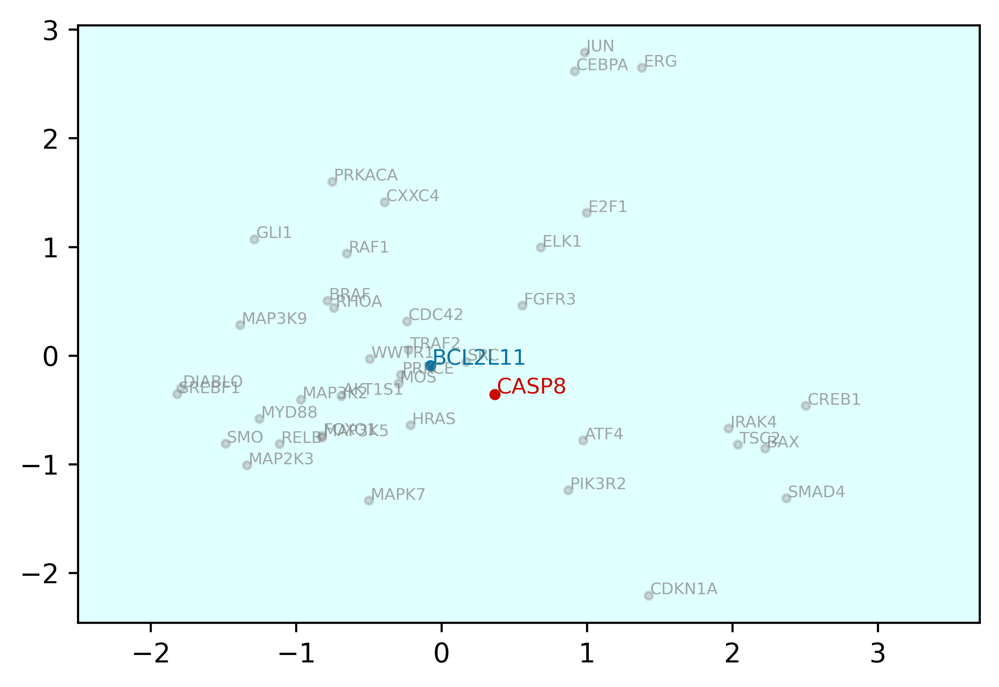

<IPython.core.display.Javascript object>

In [31]:
# Physical space
target_latents = phy_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_xlim([-2.5, 3.7])
    ax.set_facecolor("lightcyan")
plt.show()

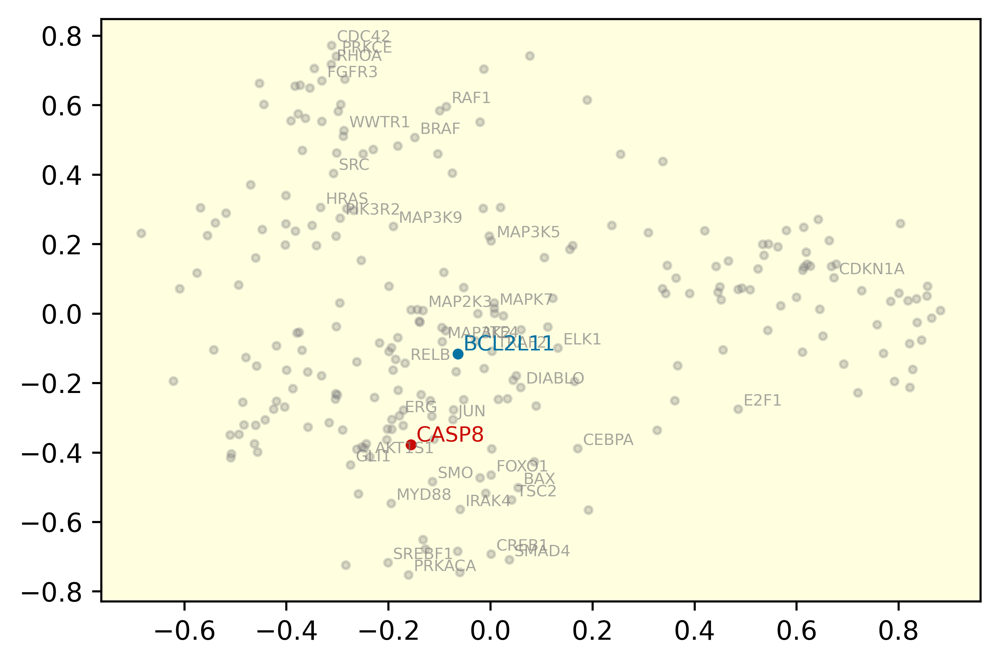

<IPython.core.display.Javascript object>

In [32]:
## Regulatory space

target_latents = reg_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_facecolor("lightyellow")
plt.show()

---

#### AKT1S1

In [37]:
target = "AKT1S1"
highlight = ["TRAF1", "PRKCE", "SRC", "MOS", "FGFR3", "PIK3R2"]
pca = PCA(n_components=2, random_state=1234)

<IPython.core.display.Javascript object>

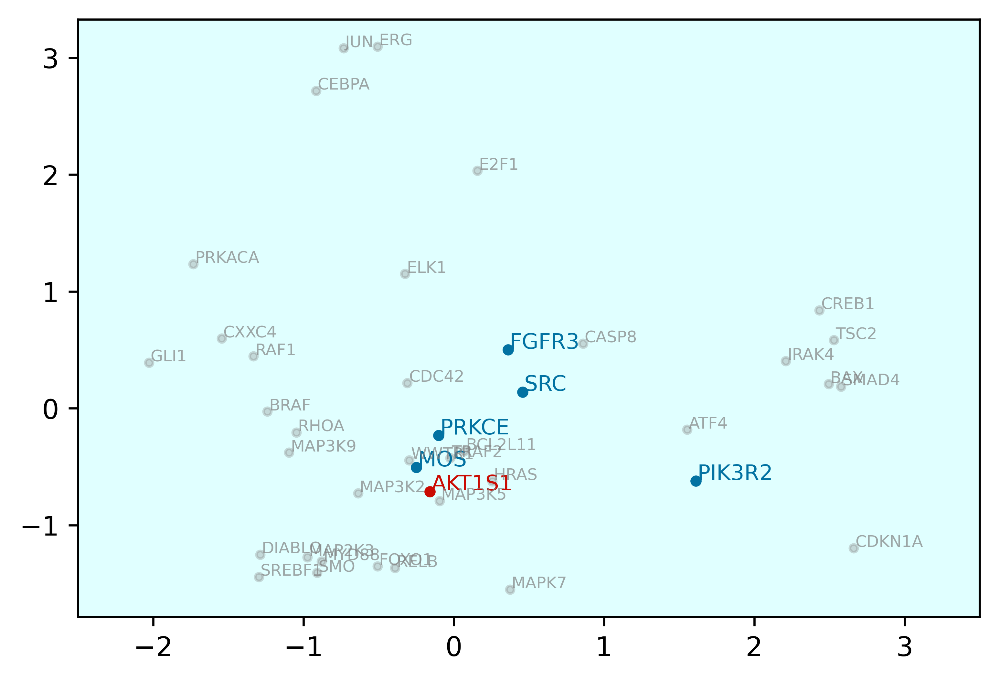

<IPython.core.display.Javascript object>

In [39]:
## Physical space

target_latents = phy_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_xlim([-2.5, 3.5])
    ax.set_facecolor("lightcyan")
plt.show()

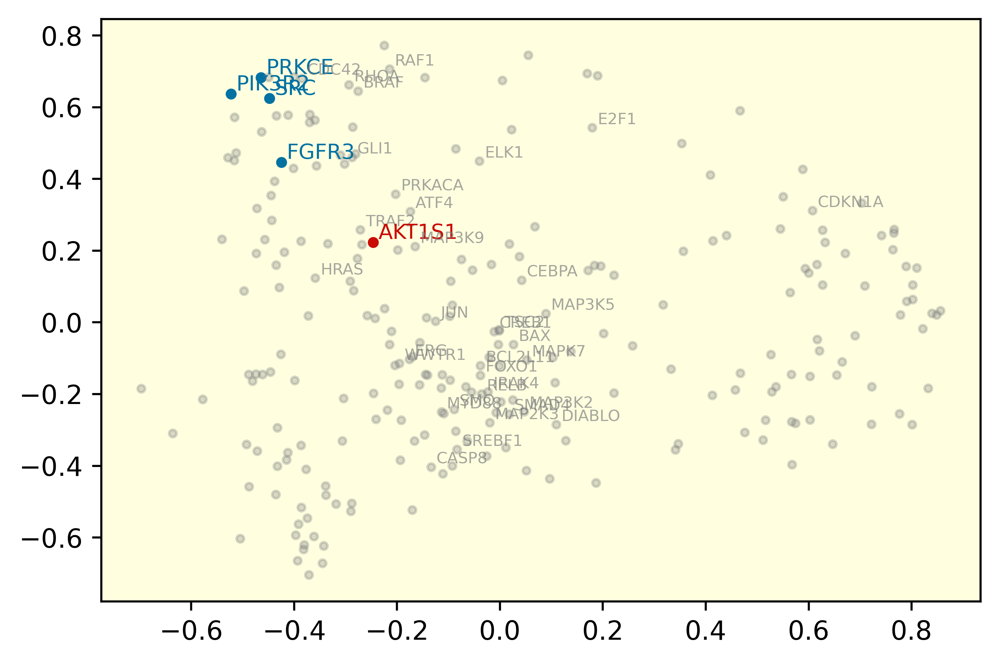

<IPython.core.display.Javascript object>

In [40]:
## Regulatory space

target_latents = reg_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_facecolor("lightyellow")
plt.show()

----


#### Held-out CEBPA

In [24]:
target = "CEBPA"
highlight = ["JUN", "ERG"]
pca = PCA(n_components=2, random_state=1234)

<IPython.core.display.Javascript object>

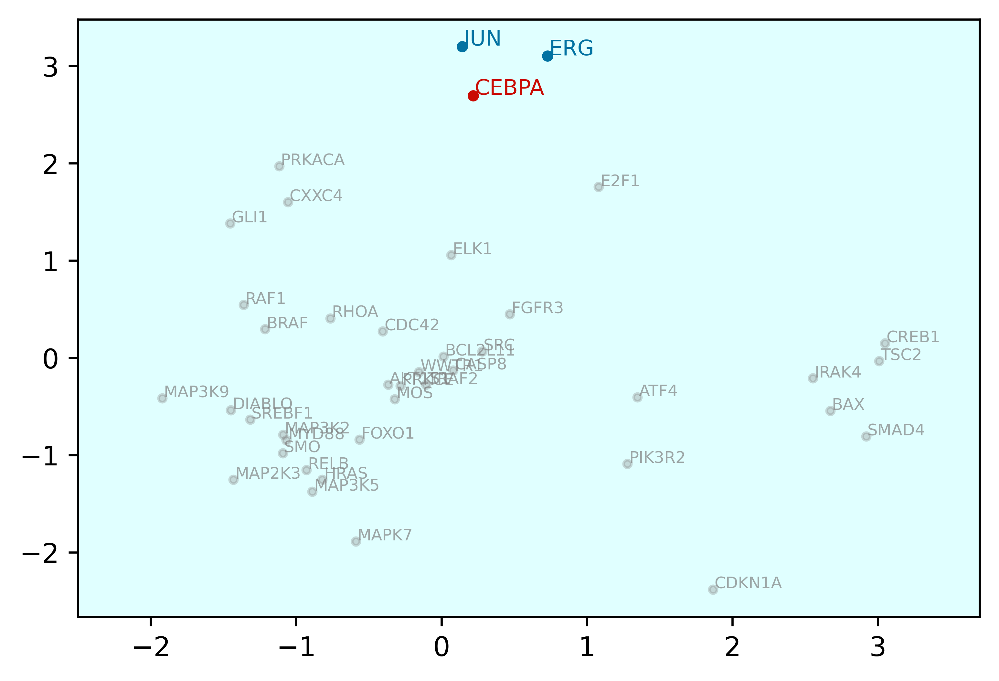

<IPython.core.display.Javascript object>

In [25]:
# Physical space
target_latents = phy_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_xlim([-2.5, 3.7])
    ax.set_facecolor("lightcyan")
plt.show()

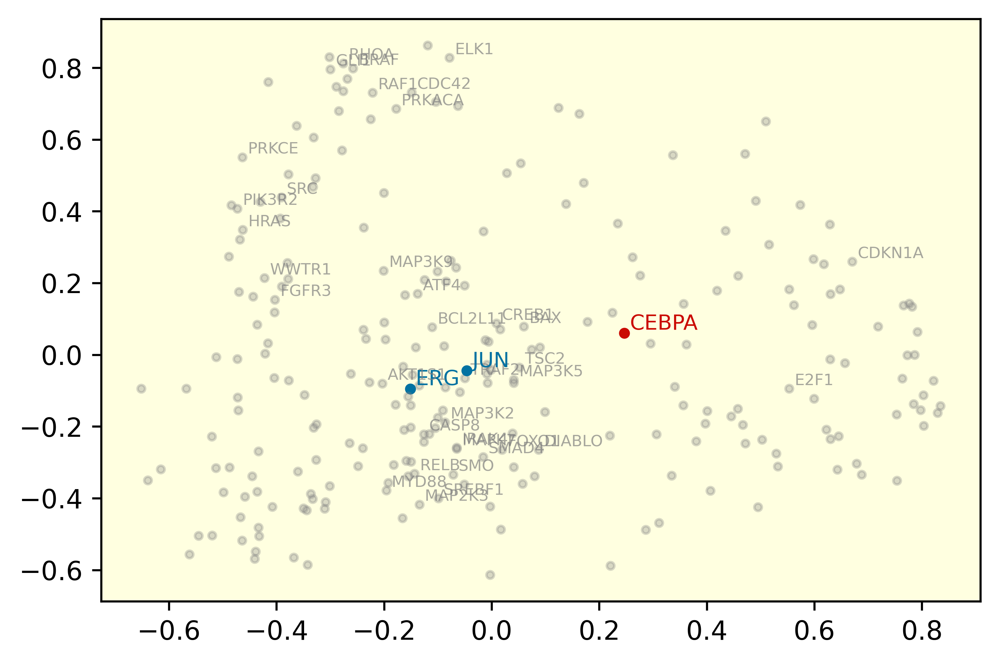

<IPython.core.display.Javascript object>

In [26]:
## Regulatory space

target_latents = reg_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_facecolor("lightyellow")
plt.show()

---

#### RAF1

In [50]:
target = "RAF1"
highlight = ["BRAF", "MAP3K9", "MAP3K2", "CDC42"]
pca = PCA(n_components=2, random_state=1234)

<IPython.core.display.Javascript object>

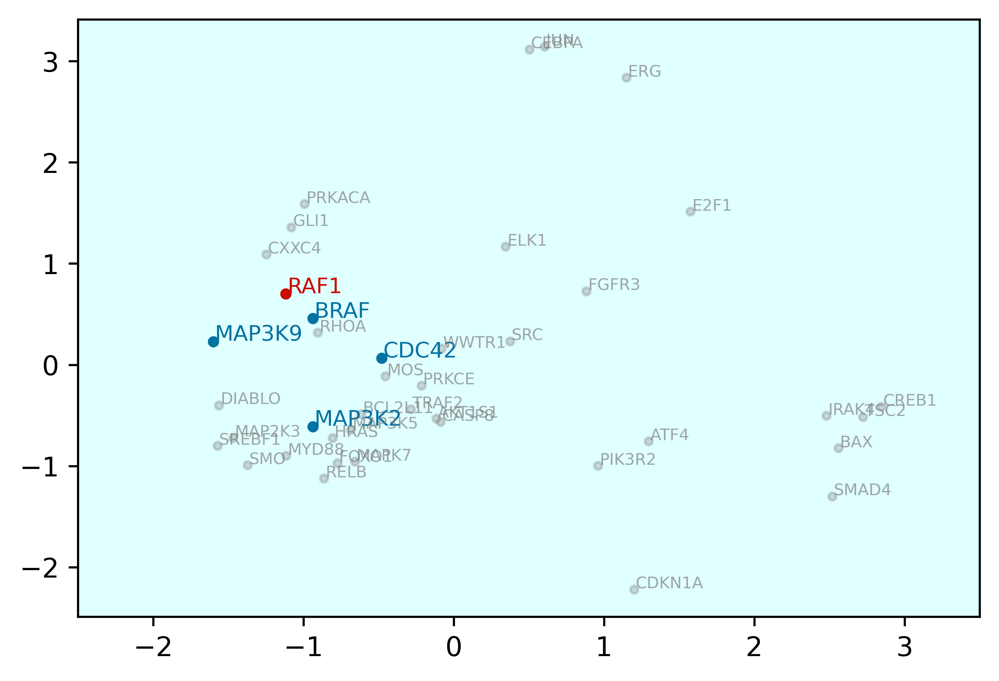

<IPython.core.display.Javascript object>

In [51]:
## Physical space

target_latents = phy_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_xlim([-2.5, 3.5])
    ax.set_facecolor("lightcyan")
plt.show()

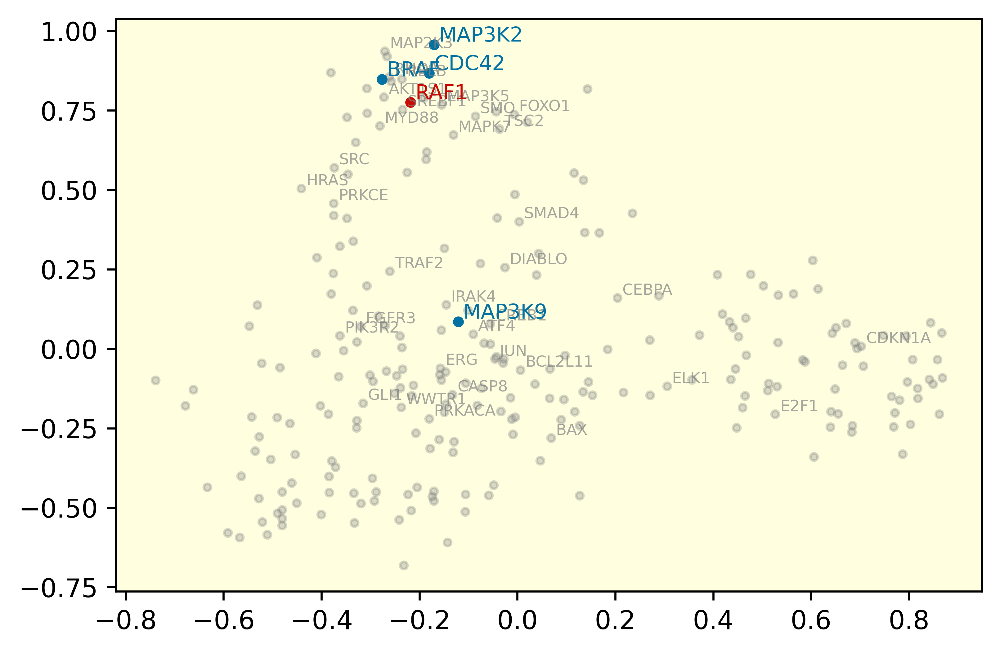

<IPython.core.display.Javascript object>

In [29]:
## Regulatory space

target_latents = reg_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_facecolor("lightyellow")
plt.show()

----


#### Held-out TSC2

In [42]:
target = "TSC2"
highlight = ["ATF4", "SMAD4", "BAX", "CREB1", "IRAK4"]
pca = PCA(n_components=2, random_state=1234)

<IPython.core.display.Javascript object>

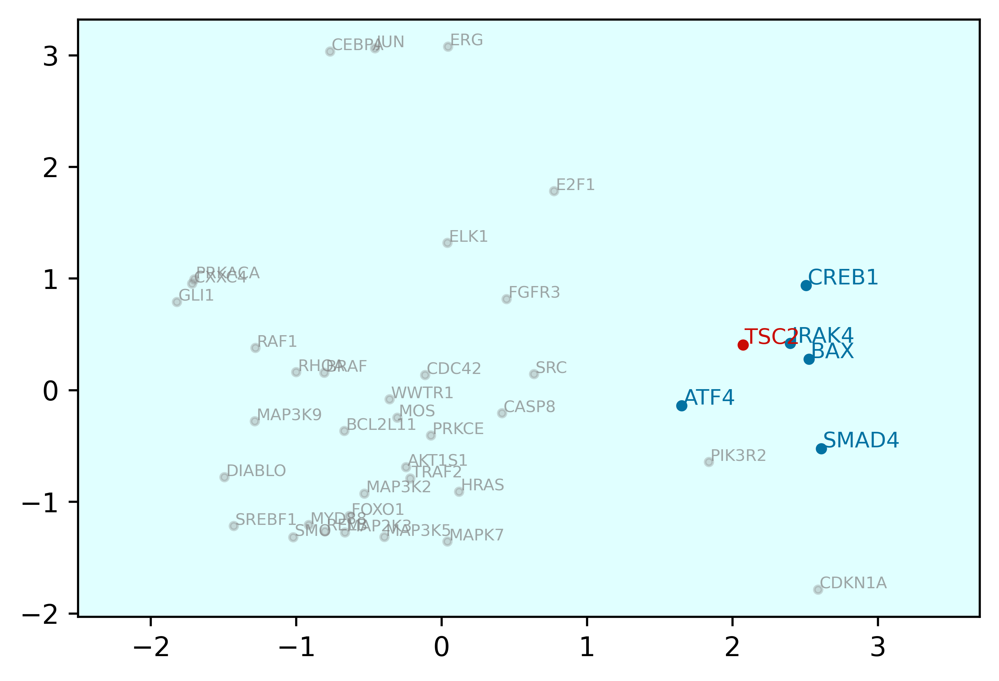

<IPython.core.display.Javascript object>

In [43]:
# Physical space
target_latents = phy_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_xlim([-2.5, 3.7])
    ax.set_facecolor("lightcyan")
plt.show()

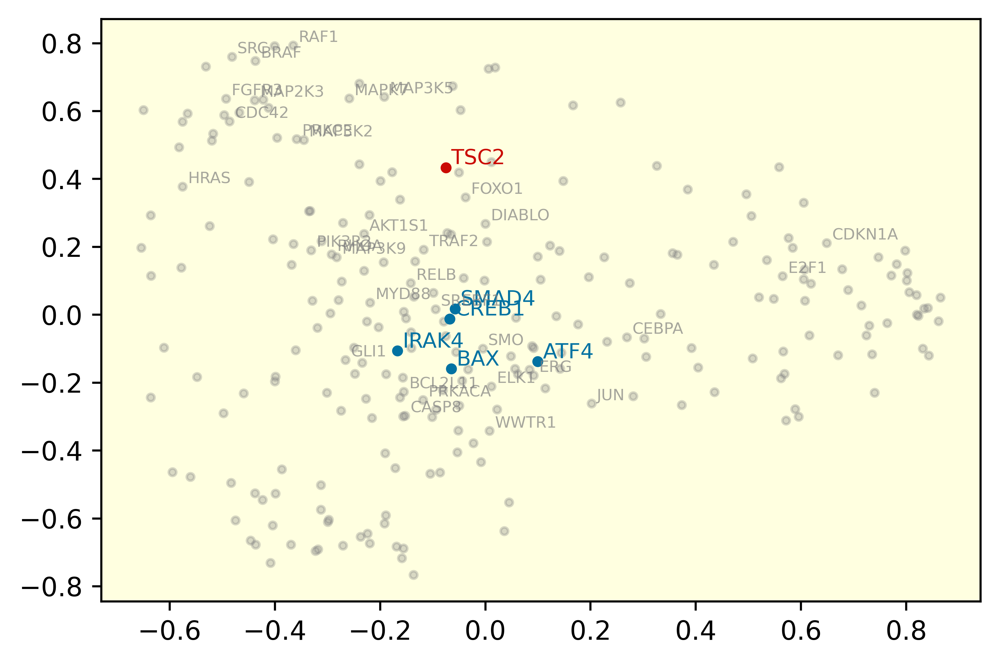

<IPython.core.display.Javascript object>

In [44]:
## Regulatory space

target_latents = reg_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_facecolor("lightyellow")
plt.show()

---

#### CDKN1A

In [45]:
target = "CDKN1A"
highlight = []
pca = PCA(n_components=2, random_state=1234)

<IPython.core.display.Javascript object>

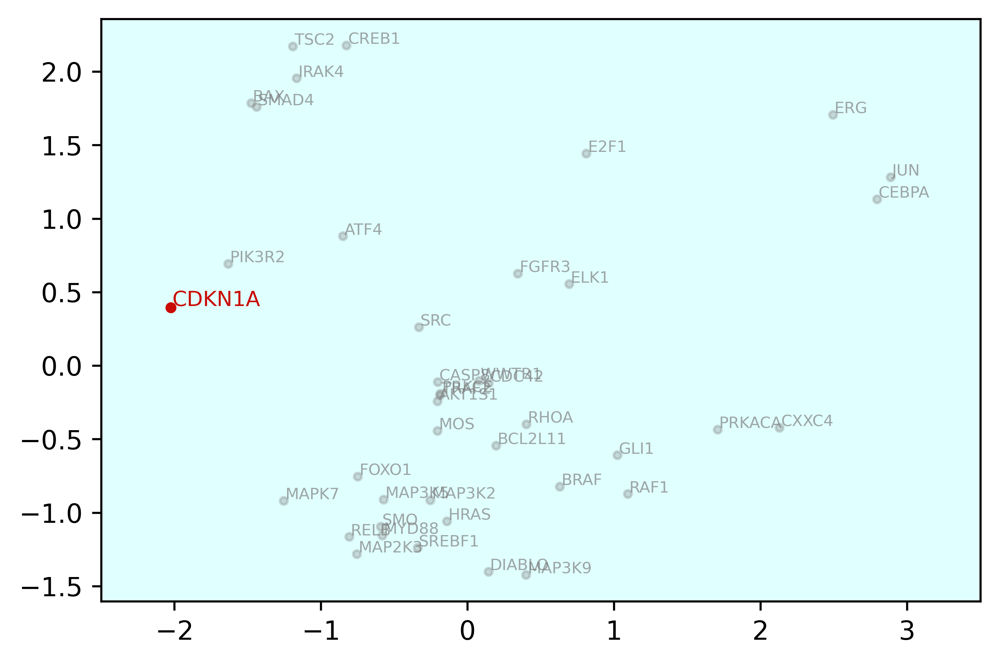

<IPython.core.display.Javascript object>

In [48]:
## Physical space

target_latents = phy_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_xlim([-2.5, 3.5])
    ax.set_facecolor("lightcyan")
plt.show()

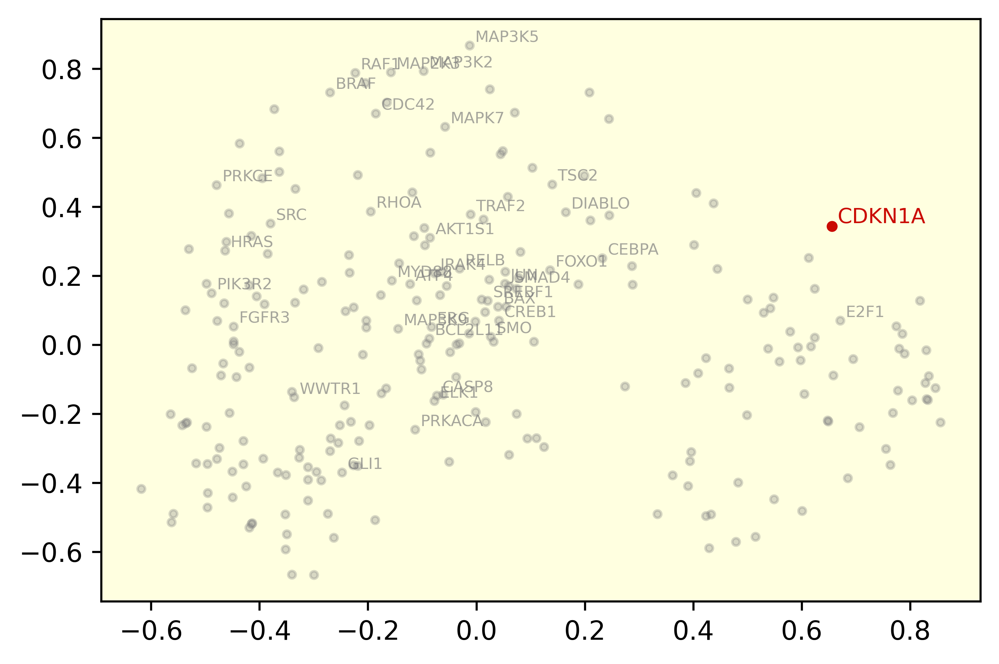

<IPython.core.display.Javascript object>

In [47]:
## Regulatory space

target_latents = reg_embs_dict_101_s_phy[target]
embs = pca.fit_transform(target_latents)
embs = pd.DataFrame(embs, index=target_latents.index, columns=["pc_0", "pc_1"])

fig, ax = plt.subplots(figsize=[6, 4])
for i in range(len(embs)):
    x = embs.iloc[i, 0]
    y = embs.iloc[i, 1]
    label = list(embs.index)[i]

    if label == target:
        s = 10
        ts = 8
        c = "r"
        alpha = 1
        talpha = 1
    elif label in highlight:
        s = 10
        ts = 8
        c = "b"
        alpha = 1
        talpha = 1
    else:
        s = 8
        ts = 6
        c = "grey"
        alpha = 0.3
        talpha = 0.7

    ax.scatter(x, y, c=c, s=s, alpha=alpha)
    if label in oe_targets:
        ax.text(x + 0.01, y + 0.01, label, {"size": ts, "c": c, "alpha": talpha})
    ax.set_facecolor("lightyellow")
plt.show()

----


----
